# Measuring all 5 protocols and 4 player sizes (720p+) (quality auto) on the seven vantage points -- 2 videos, one resolver per video

In [516]:
import pandas as pd
import sqlite3
import datetime
import numpy as np
import matplotlib as mpl
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.ticker import PercentFormatter
import math
import Cdf
import Pmf
from urllib.parse import urlparse, parse_qs
mpl.rcParams['figure.dpi'] = 200
okabe_ito = ["#000000", "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7"]
sns.set_context('paper')
sns.set_palette(sns.color_palette(okabe_ito))
#https://stackoverflow.com/a/45846841
def human_format(num):
    num = float('{:.3g}'.format(num))
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return '{}{}'.format('{:f}'.format(num).rstrip('0').rstrip('.'), ['', 'K', 'M', 'B', 'T'][magnitude])
def make_cdf(series):
    return series.value_counts(normalize=True).sort_index().cumsum()
def make_pdf(series):
    return series.value_counts(normalize=True).sort_index()
from mpl_toolkits.axes_grid1 import make_axes_locatable
from datetime import datetime
mpl.rcParams['figure.dpi'] = 100

In [2]:
conn = sqlite3.connect('first-msm-run-on-all-vms/web-performance-youtube-merged.db')

#### remove measurements where googlevideo subdomain changed

In [3]:
googlevideo_subdomains = pd.read_sql_query("SELECT msm_id, name FROM page_resources", conn)
googlevideo_subdomains['googlevideo'] = googlevideo_subdomains.name.str.split('/').str[2]

In [4]:
googlevideo_subdomains.groupby('msm_id', as_index=False).agg({'googlevideo':pd.Series.nunique}).sort_values('googlevideo').googlevideo.value_counts()

1    43179
2     2040
3      391
Name: googlevideo, dtype: int64

In [5]:
msm_ids_to_remove = googlevideo_subdomains.groupby('msm_id', as_index=False).filter(lambda x: pd.Series.nunique(x['googlevideo']) > 1).msm_id.unique().tolist()

#### remove measurement runs where resolution failed in the lookups table -- sadly the timestamps of dnsproxy are not reliable, so we cannot know from just looking at the lookups at which point of playback it failed -- in this run no googlevideo.com resolution failed, however removing them anyway in case it skews results -- also all errors happened over DoUDP

In [6]:
failed_lookups = pd.read_sql_query('SELECT measurement_id as msm_id FROM lookups WHERE status <> "NOERROR"', conn).msm_id.tolist()

In [437]:
len(failed_lookups)

468

In [7]:
msm_ids_to_remove.extend(failed_lookups)

In [8]:
#conn = sqlite3.connect('web-performance-youtube-two-videos.db')
measurements = pd.read_sql_query("SELECT * FROM measurements", conn)
measurements
#conn.close()

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error
0,a019d80e-bda1-6022-2330-422d0ff0b319,-1,-1.000000e+00,-1.000000e+00,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,2022-03-07 17:18:09.937705,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,failed loading player for cache warming ### Me...
1,ed2ebf9a-57a5-ed44-5b2a-012b8fb3755c,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:38.140803,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
2,544b9c53-fb16-e2fe-5fb0-0268b693a586,1646673799468697071,1.646674e+12,1.646674e+12,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:43.846963,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
3,30b40159-f0f0-88d6-3bc6-a1ea77c5ef1f,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:21.023793,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
4,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1646673842497402384,1.646674e+12,1.646674e+12,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:26.657266,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91280,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,1647019205270106451,1.647019e+12,1.647019e+12,udp,94.140.14.59,lqiN98z6Dak,US West,2022-03-11 17:19:32.132535,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
91281,8d824311-0532-2739-6458-1e70eb882457,-1,-1.000000e+00,-1.000000e+00,udp,94.140.14.59,aqz-KE-bpKQ,US West,2022-03-11 17:20:10.098199,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
91282,56af1487-6749-bd28-f721-9be5884aa401,1647019246530548347,1.647019e+12,1.647019e+12,udp,94.140.14.59,aqz-KE-bpKQ,US West,2022-03-11 17:20:13.116694,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
91283,cff87838-75c4-4543-e7ba-078cc05e71da,-1,-1.000000e+00,-1.000000e+00,udp,94.140.14.59,lqiN98z6Dak,US West,2022-03-11 17:20:48.257590,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,


In [107]:
measurements = measurements[measurements.timestamp < '2022-03-11 17:30']

# data pre-processing

In [9]:
measurements.groupby(['cacheWarming', 'error']).agg({'msm_id':pd.Series.nunique})

msm_id
cacheWarming error                                                     
0                                                                 45610
             failed loading player ### Message: \n                    1
             failed loading player ### Message: javascript e...       1
             failed switching selenium focus to youtube ifra...      17
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
1                                                                 45642
             failed loading player for cache warming ### Mes...       2

In [10]:
measurements = measurements[measurements.error == '']

remove cache warming runs early to reduce processing later on

In [11]:
measurements = measurements[measurements.cacheWarming == 0]

In [392]:
measurements.groupby('vantagePoint', as_index=False).agg({'msm_id':pd.Series.nunique})

,vantagePoint,msm_id
0,Africa South,4223
1,Asia Pacific Northeast,6408
2,Asia Pacific Southeast,6346
3,Europe Central,6483
4,South America East,6263
5,US East,6317
6,US West,6437


In [422]:
measurements[measurements.vantagePoint == 'Africa South'].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          DoH           66
                              DoQ           64
                              DoT           63
                              DoTCP         64
                              DoUDP         64
            1920x1080         DoH           67
                              DoQ           65
                              DoT           64
                              DoTCP         65
                              DoUDP         58
            2560x1440         DoH           66
                              DoQ           64
                              DoT           62
                              DoTCP         62
                              DoUDP         63
            3840x2160         DoH           60
                              DoQ           64
                              DoT           63
                              DoTCP         61
                              DoUDP         57
lqiN98z6Dak 1280x720          DoH          158
                              DoQ          155
                              DoT          153
                              DoTCP        155
                              DoUDP        154
            1920x1080         DoH          151
                              DoQ          154
                              DoT          153
                              DoTCP        157
                              DoUDP        149
            2560x1440         DoH          144
                              DoQ          140
                              DoT          139
                              DoTCP        144
                              DoUDP        141
            3840x2160         DoH          146
                              DoQ          144
                              DoT          138
                              DoTCP        140
                              DoUDP        146

In [429]:
measurements[measurements.vantagePoint == 'Europe Central'].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          DoH          161
                              DoQ          163
                              DoT          163
                              DoTCP        161
                              DoUDP        163
            1920x1080         DoH          161
                              DoQ          163
                              DoT          161
                              DoTCP        162
                              DoUDP        163
            2560x1440         DoH          161
                              DoQ          163
                              DoT          162
                              DoTCP        163
                              DoUDP        162
            3840x2160         DoH          159
                              DoQ          161
                              DoT          161
                              DoTCP        161
                              DoUDP        158
lqiN98z6Dak 1280x720          DoH          162
                              DoQ          163
                              DoT          163
                              DoTCP        163
                              DoUDP        163
            1920x1080         DoH          163
                              DoQ          163
                              DoT          163
                              DoTCP        162
                              DoUDP        163
            2560x1440         DoH          163
                              DoQ          162
                              DoT          162
                              DoTCP        163
                              DoUDP        162
            3840x2160         DoH          163
                              DoQ          162
                              DoT          163
                              DoTCP        161
                              DoUDP        162

In [424]:
af_measurements = pd.read_sql_query("SELECT * FROM measurements WHERE vantagePoint = 'Africa South'", conn)
af_measurements

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error
0,a019d80e-bda1-6022-2330-422d0ff0b319,-1,-1.000000e+00,-1.000000e+00,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,2022-03-07 17:18:09.937705,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,failed loading player for cache warming ### Me...
1,ed2ebf9a-57a5-ed44-5b2a-012b8fb3755c,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:38.140803,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
2,544b9c53-fb16-e2fe-5fb0-0268b693a586,1646673799468697071,1.646674e+12,1.646674e+12,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:43.846963,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
3,30b40159-f0f0-88d6-3bc6-a1ea77c5ef1f,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:21.023793,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
4,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1646673842497402384,1.646674e+12,1.646674e+12,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:26.657266,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13039,573d5eb5-d86e-7214-e10a-fba09294c189,-1,-1.000000e+00,-1.000000e+00,udp,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-11 17:23:58.314362,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
13040,501d76ca-5b69-c052-2475-56b35ad23c5d,1647019480239368934,1.647019e+12,1.647019e+12,udp,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-11 17:24:03.716271,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
13041,dfe43ddb-f97c-dae6-fa4f-1c95c1f89837,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-11 17:30:04.652979,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
13042,5a9ac31e-0efe-e97e-abb8-d96238b99dbb,1647019845946506533,1.647020e+12,1.647020e+12,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-11 17:30:10.265650,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,


In [434]:
af_measurements['player_width'] = af_measurements['player_width'].astype(str)
af_measurements['player_height'] = af_measurements['player_height'].astype(str)
af_measurements['player_dimensions'] = af_measurements['player_width']+"x"+af_measurements['player_height']
af_measurements[af_measurements.cacheWarming == 0].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https        163
                              quic         163
                              tcp          163
                              tls          164
                              udp          163
            1920x1080         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            2560x1440         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            3840x2160         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
lqiN98z6Dak 1280x720          https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            1920x1080         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            2560x1440         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            3840x2160         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163

In [471]:
af_measurements['timestamp'] = pd.to_datetime(af_measurements['timestamp'])

In [435]:
af_measurements[(af_measurements.error == '') & (af_measurements.cacheWarming == 0)].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https        162
                              quic         160
                              tcp          160
                              tls          163
                              udp          162
            1920x1080         https        163
                              quic         163
                              tcp          162
                              tls          163
                              udp          163
            2560x1440         https        162
                              quic         162
                              tcp          163
                              tls          162
                              udp          163
            3840x2160         https        162
                              quic         163
                              tcp          163
                              tls          163
                              udp          162
lqiN98z6Dak 1280x720          https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            1920x1080         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            2560x1440         https        163
                              quic         163
                              tcp          163
                              tls          163
                              udp          163
            3840x2160         https        162
                              quic         163
                              tcp          163
                              tls          163
                              udp          163

#### runs where the googlevideo subdomain changed -> no clear trend

In [12]:
measurements[measurements.msm_id.isin(msm_ids_to_remove)].groupby(['domain', 'player_width', 'player_height']).size()

domain       player_width  player_height
aqz-KE-bpKQ  1280          720              549
             1920          1080             540
             2560          1440             564
             3840          2160             566
lqiN98z6Dak  1280          720               95
             1920          1080             128
             2560          1440             159
             3840          2160             164
dtype: int64

In [13]:
measurements.msm_id.nunique()

45610

In [14]:
measurements = measurements[~measurements.msm_id.isin(msm_ids_to_remove)]

In [15]:
measurements.msm_id.nunique()

42845

In [445]:
measurements['timestamp'] = pd.to_datetime(measurements['timestamp'])

In [16]:
measurements['player_width'] = measurements['player_width'].astype(str)
measurements['player_height'] = measurements['player_height'].astype(str)
measurements['player_dimensions'] = measurements['player_width']+"x"+measurements['player_height']

In [17]:
measurements['protocol'] = measurements['protocol'].str.upper()

In [18]:
dns_proto_mapping = {'QUIC':'DoQ', 'HTTPS':'DoH', 'TLS':'DoT', 'TCP':'DoTCP', 'UDP':'DoUDP'}
def map_proto_to_dns(x):
    return dns_proto_mapping[x]
measurements['protocol'] = measurements['protocol'].map(map_proto_to_dns)

In [454]:
cache_warming_failed = pd.read_sql_query("SELECT msm_id as cw_msm_id, protocol, server, domain, vantagePoint, suggested_quality, (player_width || 'x' || player_height) as player_dimensions, timestamp, start_time, play_time, video_ids FROM measurements WHERE error <> '' AND cacheWarming = 1", conn)
cache_warming_failed['timestamp'] = pd.to_datetime(cache_warming_failed['timestamp'])
cache_warming_failed

,cw_msm_id,protocol,server,domain,vantagePoint,suggested_quality,player_dimensions,timestamp,start_time,play_time,video_ids
0,a019d80e-bda1-6022-2330-422d0ff0b319,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,auto,1280x720,2022-03-07 17:18:09.937705,0,30,"aqz-KE-bpKQ, lqiN98z6Dak"
1,c73e8abd-f126-6bae-d417-30fbbf8e5c0e,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,auto,1280x720,2022-03-09 12:15:04.771172,0,30,"aqz-KE-bpKQ, lqiN98z6Dak"


In [479]:
measurements_to_remove_due_to_failed_cachewarming = pd.merge_asof(cache_warming_failed.sort_values('timestamp'), measurements.sort_values('timestamp'), by=['protocol', 'server', 'domain', 'vantagePoint', 'suggested_quality', 'player_dimensions', 'start_time', 'play_time', 'video_ids'], on='timestamp', direction='forward', tolerance=pd.Timedelta("30s")).dropna().msm_id.unique().tolist()
if len(measurements_to_remove_due_to_failed_cachewarming) > 0:
    measurements = measurements[~measurements.msm_id.isin(measurements_to_remove_due_to_failed_cachewarming)]

In [ ]:
#af_measurements[af_measurements.timestamp >= datetime.strptime('2022-03-07 17:18:09.937705', "%Y-%m-%d %H:%M:%S.%f")].sort_values('timestamp')

## find the optimal resolution as determined by the youtube player for each run

In [197]:
df_optimal_resolutions = pd.read_sql_query("""
SELECT msm_id, resolution, time FROM nerd_stats
""", conn)

In [198]:
df_optimal_resolutions['current_res'] = df_optimal_resolutions['resolution'].str.split(' / ').str[0]
df_optimal_resolutions['current_res'] = df_optimal_resolutions['current_res'].str.split('@').str[0]
df_optimal_resolutions['optimal_res'] = df_optimal_resolutions['resolution'].str.split(' / ').str[1]
df_optimal_resolutions['optimal_res'] = df_optimal_resolutions['optimal_res'].str.split('@').str[0]
df_optimal_resolutions['time'] = pd.to_datetime(df_optimal_resolutions['time'], unit='ms', origin='unix')

In [199]:
df_optimal_resolutions = df_optimal_resolutions[['msm_id','optimal_res', 'time', 'current_res']]

In [200]:
df_optimal_resolutions.groupby('msm_id').optimal_res.nunique().sort_values()

msm_id
0000c85d-710c-e4df-8f0d-f4bc64dbac17    1
aafa6d72-6cfb-4c60-992f-c648c6f3b4da    1
aafb0bd6-5a62-1328-457b-bbbc359da7b9    1
aafba982-cd3a-122b-bdcf-dea07689af9f    1
aafe2fc0-f866-966c-fe68-762b5ff6c82c    1
                                       ..
6961d20d-33db-3fa0-7816-b0e7ca049660    2
5d381914-bd54-ce30-3912-be19589f64ab    2
fd9ff1ac-37e8-af58-7dee-e951d151ef3d    2
87355508-0241-b2b5-6842-c351c9054fc3    2
6fa4c2bf-7cf0-4fde-60dc-4fc0e3bb1f95    2
Name: optimal_res, Length: 45610, dtype: int64

### filter out measurements where the player changes the optimal resolution within the run (mostly from 4k to 1440p)

In [201]:
s_filter_msm = df_optimal_resolutions.groupby('msm_id').optimal_res.nunique()

In [202]:
s_filter_msm[s_filter_msm > 1].index.tolist()

['0359dd3d-f503-a641-2e8c-929026059ee7',
 '041b17ed-be65-626c-7231-de4512ac5061',
 '05b6f059-9eb9-5498-6f8f-0d2b79afa3ad',
 '082068eb-4499-30db-a7f8-b9f6f4a57ecc',
 '0a14b025-3020-a7cd-56b3-bc8d9a532c8e',
 '0a89e88b-0a93-4784-39f7-d79977f155ee',
 '0ae33cac-34b3-30f0-ef02-a70d3df72915',
 '0b0f9b94-c67a-d4eb-cbf5-2c19581d87fa',
 '0b65606a-9ded-964a-5742-fff05d876742',
 '0c09ff96-2a4a-d1ac-fb31-266c6accdb7f',
 '0ccfc993-0b81-340d-58f3-ff49e0002cb2',
 '0e20dc63-9ecc-060a-9c45-440ce4321cf2',
 '1020dab6-00a0-089b-4673-67d4e703b86c',
 '118e543c-fa33-129c-bead-baece558454e',
 '121f1793-7829-ecbf-1e4e-1f4ee374fc72',
 '123bdfba-2858-8fca-6fc5-5636f37d68c1',
 '12639718-fc76-7a9c-51c6-77c8e3199285',
 '12b6ffd3-48d7-c2f0-ff3c-171dca508c7c',
 '142e0738-449c-67c6-7761-0b95c3b08dfa',
 '1627bf74-5b0b-8092-1d30-fbdd8ee495ba',
 '1781cb95-0979-8dde-0f2f-4c334413a6bf',
 '180fd90d-1805-2868-66ea-aadc5e7325f9',
 '186d51c1-7de5-0c46-8666-91f91c3e11e8',
 '192121c9-11b0-5bd2-4d63-5e61b5388ab2',
 '192cea10-455b-

In [203]:
df_optimal_resolutions[df_optimal_resolutions.msm_id.isin(s_filter_msm[s_filter_msm > 1].index.tolist())].sort_values('time').groupby(['msm_id', 'optimal_res']).agg({'time':'min'}).sort_values('time')

time
msm_id                               optimal_res                              
5ef8a03a-06a9-02cc-cd81-0feb1e2979b1 3840x2160   2022-03-07 19:00:09.670900224
                                     2560x1440   2022-03-07 19:00:27.889999872
05b6f059-9eb9-5498-6f8f-0d2b79afa3ad 3840x2160   2022-03-07 20:29:33.564300032
                                     2560x1440   2022-03-07 20:30:03.950800128
7b682e43-4460-71c2-b6d0-2c088244fd73 3840x2160   2022-03-07 20:45:24.246100224
...                                                                        ...
56af1487-6749-bd28-f721-9be5884aa401 3840x2160   2022-03-11 17:20:16.190500096
3370954f-4268-1421-cdbe-010a243c4816 2560x1440   2022-03-11 17:20:34.759500032
2368ef06-6ec9-d6a2-312a-3d1167a15436 3840x2160   2022-03-11 17:20:38.937999872
56af1487-6749-bd28-f721-9be5884aa401 2560x1440   2022-03-11 17:20:42.401899776
2368ef06-6ec9-d6a2-312a-3d1167a15436 2560x1440   2022-03-11 17:21:05.319200000

[628 rows x 1 columns]

first idea: we take the nerd stats optimal res at the end of playback (i.e. the furthest in terms of video playback) as the "true" optimal res  ------ probably dumb idea, see example above, for now just filter out the ones with multiple optimal resolutions?

In [204]:
#assert set(df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].msm_id.value_counts().values) == {1}
#assert df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].msm_id.nunique() == measurements.msm_id.nunique()
#df_optimal_resolutions = df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].reset_index(drop=True)


In [205]:
df_msms_with_multiple_opt_res = df_optimal_resolutions.groupby('msm_id', as_index=False).agg(opt_res_num=('optimal_res',pd.Series.nunique), opt_res_list=('optimal_res',pd.Series.unique)).sort_values('opt_res_num')

In [206]:
df_msms_with_multiple_opt_res[df_msms_with_multiple_opt_res.opt_res_num > 1]

,msm_id,opt_res_num,opt_res_list
39874,e0789fd9-3aa9-a3fd-81f6-0a072a28ac51,2,"[3840x2160, 2560x1440]"
4281,180fd90d-1805-2868-66ea-aadc5e7325f9,2,"[3840x2160, 2560x1440]"
41404,e912d47f-9de3-eb6e-7e33-1d06e56c8372,2,"[3840x2160, 2560x1440]"
8546,2f976c16-db4a-d6f7-e312-f48f30911f4a,2,"[3840x2160, 2560x1440]"
4474,192121c9-11b0-5bd2-4d63-5e61b5388ab2,2,"[3840x2160, 2560x1440]"
...,...,...,...
18758,6961d20d-33db-3fa0-7816-b0e7ca049660,2,"[3840x2160, 2560x1440]"
16589,5d381914-bd54-ce30-3912-be19589f64ab,2,"[3840x2160, 2560x1440]"
45165,fd9ff1ac-37e8-af58-7dee-e951d151ef3d,2,"[3840x2160, 2560x1440]"
23919,87355508-0241-b2b5-6842-c351c9054fc3,2,"[3840x2160, 2560x1440]"


In [207]:
measurements_to_remove = df_msms_with_multiple_opt_res[df_msms_with_multiple_opt_res.opt_res_num > 1].msm_id.unique().tolist()

In [208]:
measurements_to_remove

['e0789fd9-3aa9-a3fd-81f6-0a072a28ac51',
 '180fd90d-1805-2868-66ea-aadc5e7325f9',
 'e912d47f-9de3-eb6e-7e33-1d06e56c8372',
 '2f976c16-db4a-d6f7-e312-f48f30911f4a',
 '192121c9-11b0-5bd2-4d63-5e61b5388ab2',
 'ef676b32-3063-09f3-0d88-d2a2c9bb56ec',
 'fee568e3-e417-2d64-0a1d-25df862c54a4',
 'b72a5ee1-269d-e049-2e1a-29e3bc6e732f',
 'dfd11587-c103-2e7e-8eeb-54dc0af32f01',
 'd0181923-91a2-79c1-5cff-41a3078e4a7e',
 '9f46eb9b-c212-d117-090a-58c7076cbf1c',
 '7f506895-461f-60f9-7acb-7b263a22ab60',
 'c947b3f4-1966-b9f5-2e63-c3dfad608fc6',
 '204ffc35-ca8a-58ca-5c01-00e9714b4ca0',
 '903f0014-b97a-c515-86fb-b7347e289d02',
 'c08dba36-538f-28b9-9cde-4947f2eccd32',
 '118e543c-fa33-129c-bead-baece558454e',
 'bffb5006-acac-ead3-44c7-9049cb3d5b31',
 'fff544b7-7913-3329-9224-3b980c45c9a1',
 '1fa2278f-19d8-ece3-bbf7-07ee8ed42bbc',
 'c853d50a-7908-6542-3830-71b7befd0537',
 '97b42cd4-a33d-2adc-9de4-d7885a2e27a3',
 '1fe53601-8c41-143b-5f96-105a1ba0c387',
 '277e020a-5b08-79c6-8f9c-a81ecec42130',
 '7fb1a399-7803-

In [209]:
measurements[measurements.msm_id.isin(measurements_to_remove)].player_dimensions.value_counts()

Series([], Name: player_dimensions, dtype: int64)

In [210]:
measurements[measurements.msm_id.isin(measurements_to_remove)].protocol.value_counts()

Series([], Name: protocol, dtype: int64)

In [211]:
measurements[measurements.player_dimensions == "3840x2160"].protocol.value_counts()

DoH      2095
DoT      2088
DoQ      2087
DoTCP    2080
DoUDP    1986
Name: protocol, dtype: int64

In [212]:
measurements = measurements[~measurements.msm_id.isin(measurements_to_remove)]

In [213]:
df_optimal_resolutions = df_optimal_resolutions[~df_optimal_resolutions.msm_id.isin(measurements_to_remove)][['msm_id', 'optimal_res']].drop_duplicates().reset_index().drop('index', axis=1)

In [214]:
df_optimal_resolutions

,msm_id,optimal_res
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,1280x720
1,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1280x720
2,e2576b0d-50a9-f803-e475-4d880109c675,1920x1080
3,22cb024f-8247-54be-730f-b2b57f8a4074,1920x1080
4,150bdff4-3e93-9c75-8236-5c550ea665e1,2560x1440
...,...,...
45291,3f991d4a-a10a-a4e0-acd9-7652db51d9ef,1920x1080
45292,d69c8678-55ea-9af6-c143-2703524b25b7,1920x1080
45293,4c99015d-0706-7c10-f577-686b2e9dacfa,2560x1440
45294,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,2560x1440


In [215]:
df_optimal_resolutions = pd.merge(df_optimal_resolutions, measurements[['msm_id', 'player_dimensions']], on='msm_id')
df_optimal_resolutions

,msm_id,optimal_res,player_dimensions
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,1280x720,1280x720
1,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1280x720,1280x720
2,e2576b0d-50a9-f803-e475-4d880109c675,1920x1080,1920x1080
3,22cb024f-8247-54be-730f-b2b57f8a4074,1920x1080,1920x1080
4,150bdff4-3e93-9c75-8236-5c550ea665e1,2560x1440,2560x1440
...,...,...,...
42472,3f991d4a-a10a-a4e0-acd9-7652db51d9ef,1920x1080,1920x1080
42473,d69c8678-55ea-9af6-c143-2703524b25b7,1920x1080,1920x1080
42474,4c99015d-0706-7c10-f577-686b2e9dacfa,2560x1440,2560x1440
42475,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,2560x1440,2560x1440


### make sure the optimal resolutions match what we set as the player size

In [216]:
df_optimal_resolutions[df_optimal_resolutions.optimal_res != df_optimal_resolutions.player_dimensions]

,msm_id,optimal_res,player_dimensions


### make sure each run has a start playing event that fired before 1s of playtime passed (there seems to always be a little bit of playtime (i.e. the curr play time when the event fires is never zero) presumably due to the delay from javascript execution between getting the playback time within the callback)

In [217]:
df_player_state_playing = pd.read_sql_query("select time, msm_id, curr_play_time from iframe_api where event_type = 'PlayerStatePLAYING'", conn)

In [218]:
df_player_state_playing[df_player_state_playing.curr_play_time > 1].curr_play_time.describe()

count    13768.000000
mean        20.429023
std          3.502404
min          3.157333
25%         18.037097
50%         19.352215
75%         22.763667
max         30.529000
Name: curr_play_time, dtype: float64

In [219]:
df_player_state_playing[df_player_state_playing.curr_play_time < 1].curr_play_time.describe()

count    45609.000000
mean         0.024584
std          0.017438
min          0.002395
25%          0.017848
50%          0.021270
75%          0.025542
max          0.423909
Name: curr_play_time, dtype: float64

In [220]:
df_player_state_intial_playback = df_player_state_playing[(df_player_state_playing.curr_play_time < 1) & 
                                    (df_player_state_playing.msm_id.isin(measurements.msm_id.unique()))]

make sure each measurement only has one corresponding initial playing state event and that all measurements have such an event

In [221]:
assert set(df_player_state_intial_playback.msm_id.value_counts().values) == {1}
assert pd.Series.nunique(df_player_state_intial_playback.msm_id.value_counts().index) == \
pd.Series.nunique(measurements['msm_id'])

### if the 1s metric produced a unique start playing state event for each run, we can use it to calculate the startup delay between when we tell the player to start playing and when it actually plays

In [222]:
df_start_time = pd.read_sql_query("""
SELECT start_time, play_time, msm_id, current_quality AS initial_quality FROM
(SELECT time AS start_time, msm_id FROM iframe_api WHERE event_type = 'PlayStartedFromFunction')
JOIN
(SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time < 1)
USING (msm_id);
""", conn)
df_start_time = df_start_time[df_start_time.msm_id.isin(measurements.msm_id.unique())]

df_start_time['start_time'] = pd.to_datetime(df_start_time['start_time'], unit='ms', origin='unix')
df_start_time['play_time'] = pd.to_datetime(df_start_time['play_time'], unit='ms', origin='unix')

df_start_time['startup_delay'] = (df_start_time['play_time'] - df_start_time['start_time']).dt.total_seconds()

In [223]:
df_start_time

,start_time,play_time,msm_id,initial_quality,startup_delay
0,2022-03-07 17:22:48.808699904,2022-03-07 17:22:50.372699904,544b9c53-fb16-e2fe-5fb0-0268b693a586,medium,1.5640
1,2022-03-07 17:23:31.761400064,2022-03-07 17:23:33.217299968,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,large,1.4559
2,2022-03-07 17:24:17.763799808,2022-03-07 17:24:20.984399872,e2576b0d-50a9-f803-e475-4d880109c675,hd720,3.2206
3,2022-03-07 17:25:00.748999936,2022-03-07 17:25:02.334400000,22cb024f-8247-54be-730f-b2b57f8a4074,large,1.5854
4,2022-03-07 17:25:46.862300160,2022-03-07 17:25:48.305100032,150bdff4-3e93-9c75-8236-5c550ea665e1,medium,1.4428
...,...,...,...,...,...
45603,2022-03-11 17:17:37.171800064,2022-03-11 17:17:37.532800000,3f991d4a-a10a-a4e0-acd9-7652db51d9ef,hd1080,0.3610
45604,2022-03-11 17:18:15.162200064,2022-03-11 17:18:15.507699968,d69c8678-55ea-9af6-c143-2703524b25b7,hd1080,0.3455
45605,2022-03-11 17:18:56.399400192,2022-03-11 17:18:56.864800000,4c99015d-0706-7c10-f577-686b2e9dacfa,large,0.4654
45606,2022-03-11 17:19:34.318599936,2022-03-11 17:19:34.752899840,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,hd1440,0.4343


### for each measurement we call getQuality when the player fires the start playing callback, however this seems to again be susceptible to some delay, some measurements have quality change events for that resolution fire __after__ the recorded timestamp for the playing event ---> thus we figure out the quality change event that happened closest to the timestamp of the start playing event but still happened before it

In [224]:
df_player_quality_change_event = pd.read_sql_query("select msm_id, time, curr_play_time, current_quality from iframe_api where event_type LIKE 'QualityChange%'", conn)
df_player_quality_change_event = df_player_quality_change_event[df_player_quality_change_event.msm_id.isin(measurements.msm_id.unique())]

In [225]:
df_player_quality_change_event['time'] = pd.to_datetime(df_player_quality_change_event['time'], unit='ms', origin='unix')

In [226]:
df_player_quality_change_event.curr_play_time.value_counts().sort_index()

0.000000     78812
0.007959         1
0.008187         1
0.008442         1
0.008531         1
             ...  
27.970494        1
28.232737        1
28.506468        1
29.120218        1
30.413892        1
Name: curr_play_time, Length: 17010, dtype: int64

In [227]:
df_player_quality_change_event[df_player_quality_change_event.curr_play_time == 0].msm_id.value_counts()

228d2e9f-7db7-f213-4349-881d0d6bf5d9    3
2b52d4c7-c93a-4235-c3f5-32ebb962ab0e    3
c3758ff9-de93-10bb-3adf-c59dfeaf49e4    3
462d74d1-1fa6-37e5-0f19-7b005885321e    3
de142f66-0561-4118-f9f0-1c10807a294b    3
                                       ..
49e6e512-234d-34a6-257f-99e927bf3f8b    1
5fcea8bc-0ad9-6347-9b06-1aabc309a903    1
9c565329-302b-d5c1-d836-67cbe8e02246    1
887c17e2-acf5-1cf3-80a2-1771b44c4bb8    1
544b9c53-fb16-e2fe-5fb0-0268b693a586    1
Name: msm_id, Length: 42477, dtype: int64

In [228]:
df_player_quality_change_event[df_player_quality_change_event.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,time,curr_play_time,current_quality


In [229]:
measurements[measurements.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error,player_dimensions


In [230]:
df_start_time[df_start_time.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,start_time,play_time,msm_id,initial_quality,startup_delay


In [231]:
df_true_initial_quality = pd.merge(df_start_time[['msm_id', 'play_time', 'initial_quality']], df_player_quality_change_event[df_player_quality_change_event.curr_play_time < 1][['time', 'current_quality', 'msm_id']], on='msm_id')


In [232]:
df_true_initial_quality['delay_to_play_time'] = (df_true_initial_quality['play_time'] - df_true_initial_quality['time']).dt.total_seconds()

In [233]:
df_true_initial_quality[df_true_initial_quality.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,play_time,initial_quality,time,current_quality,delay_to_play_time


In [234]:
df_true_initial_quality = df_true_initial_quality[df_true_initial_quality.delay_to_play_time > 0]

In [235]:
df_true_initial_quality = df_true_initial_quality.loc[df_true_initial_quality.groupby('msm_id').delay_to_play_time.idxmin()].reset_index(drop=True)

In [236]:
df_true_initial_quality[df_true_initial_quality.initial_quality != df_true_initial_quality.current_quality]

,msm_id,play_time,initial_quality,time,current_quality,delay_to_play_time
51,0044080f-435c-a956-90b8-8fe4a432bd72,2022-03-10 00:23:43.795700224,hd1440,2022-03-10 00:23:43.678600192,medium,0.1171
81,0082ed0c-79dc-c632-ab03-9afdbaeae4b9,2022-03-09 08:15:18.692000000,hd1440,2022-03-09 08:15:18.476000000,large,0.2160
102,00a5abfe-ca2e-5f94-bf5e-d5c4a41b15cd,2022-03-08 11:10:27.507500032,hd720,2022-03-08 11:10:27.375000064,medium,0.1325
105,00ace685-1b7c-7841-0661-db7ca6daad55,2022-03-09 03:15:51.420300032,hd2160,2022-03-09 03:15:51.289199872,large,0.1311
110,00be6000-0511-55b0-37b8-a8ce03111e40,2022-03-08 03:51:43.772600064,hd1440,2022-03-08 03:51:43.282899968,large,0.4897
...,...,...,...,...,...,...
42370,ff6989c6-e2a0-d4e3-9f2a-4eb36083320f,2022-03-10 03:36:55.150300160,hd720,2022-03-10 03:36:54.850899968,large,0.2994
42384,ff82f922-0a20-3c04-8f19-04bd0cc6769f,2022-03-07 23:08:29.014200064,hd1080,2022-03-07 23:08:28.805600000,large,0.2086
42410,ffa0cb63-428b-2d5b-6d9e-890b6185e8a0,2022-03-08 11:05:49.412399872,hd720,2022-03-08 11:05:49.291500032,large,0.1209
42413,ffa33107-dae1-9924-da9d-091d27a5fb3a,2022-03-08 10:06:19.481799680,hd720,2022-03-08 10:06:19.398000128,large,0.0838


In [237]:
df_true_initial_quality.rename(columns=lambda x: x.replace('current_quality', 'true_initial_quality'), inplace=True)

In [238]:
df_true_initial_quality

,msm_id,play_time,initial_quality,time,true_initial_quality,delay_to_play_time
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,2022-03-10 04:26:46.704599808,hd1440,2022-03-10 04:26:46.677499904,hd1440,0.0271
1,0000ca8c-557d-f4c0-f38f-9ab4f628316f,2022-03-08 11:56:15.965900032,hd720,2022-03-08 11:56:15.950200064,hd720,0.0157
2,0001402c-2c01-8135-e4c9-a91107183767,2022-03-10 16:55:10.684399872,hd720,2022-03-10 16:55:10.599000064,hd720,0.0854
3,00016162-7fd0-7bad-e433-9b925952d80e,2022-03-09 13:15:48.493899776,hd1080,2022-03-09 13:15:48.488000000,hd1080,0.0059
4,0001ebad-5702-6c7a-ecfb-b3f6b75d2563,2022-03-11 17:14:32.500999936,hd1080,2022-03-11 17:14:32.465299968,hd1080,0.0357
...,...,...,...,...,...,...
42472,fff91fc5-d7ea-f6a4-4021-c02882311d11,2022-03-09 17:08:42.490300160,hd720,2022-03-09 17:08:41.582100224,hd720,0.9082
42473,fffb4bf1-cf69-04c9-0bb1-c6546f2571e4,2022-03-09 15:13:07.064999936,hd1440,2022-03-09 15:13:06.979200000,hd1440,0.0858
42474,fffbc4d3-c081-c9e3-8970-aae83393cf3e,2022-03-09 03:20:43.827699968,hd1080,2022-03-09 03:20:43.789299968,hd1080,0.0384
42475,fffead2c-a9a9-4ad7-b84d-402e40fcee08,2022-03-10 04:44:35.901599744,hd720,2022-03-10 04:44:35.824099840,hd720,0.0775


### helper functions

In [239]:
res_to_quality = {
    "unknown":"auto","256x144":"tiny", "426x240": "small", "640x360": "medium", "854x480": "large",
    "1280x720": "hd720", "1920x1080": "hd1080", "2560x1440": "hd1440", "3840x2160": "hd2160"
}

quality_to_res = {v: k for k, v in res_to_quality.items()}

def map_quality_to_res(quality):
    return quality_to_res[quality]
def map_res_to_quality(resolution):
    return res_to_quality[resolution]

def make_quality_column_sortable(df_, col_name_):
    df_[col_name_] = pd.Categorical(df_[col_name_], ['auto', 'tiny', 'small', 'medium', 'large', 'hd720', 'hd1080', 'highres', 'hd1440', 'hd2160'])

def make_res_column_sortable(df_, col_name_):
    df_[col_name_] = pd.Categorical(df_[col_name_], ['256x144', '426x240', '640x360', '854x480', '1280x720', '1920x1080', '2560x1440', '3840x2160'])

In [240]:
quality_to_res

{'auto': 'unknown',
 'tiny': '256x144',
 'small': '426x240',
 'medium': '640x360',
 'large': '854x480',
 'hd720': '1280x720',
 'hd1080': '1920x1080',
 'hd1440': '2560x1440',
 'hd2160': '3840x2160'}

In [241]:
df_resource_timing = pd.read_sql_query("SELECT msm_id, name, nextHopProtocol, domainLookupStart, domainLookupEnd FROM page_resources", conn)
#df_resource_timing = df_resource_timing[df_resource_timing.msm_id.isin(measurements.msm_id.unique())]

In [242]:
df_resource_timing['googlevideo'] = df_resource_timing.name.str.split('/').str[2]

In [243]:
df_resource_timing.googlevideo.unique()

array(['rr2---sn-5hnekn7z.googlevideo.com',
       'rr4---sn-5hnekn7k.googlevideo.com',
       'rr4---sn-5hne6nz6.googlevideo.com',
       'rr2---sn-5hne6nsr.googlevideo.com',
       'rr4---sn-woc7ln7y.googlevideo.com',
       'rr2---sn-woc7ln7y.googlevideo.com',
       'rr2---sn-4g5ednly.googlevideo.com',
       'r4---sn-woc7ln7y.googlevideo.com', 'redirector.googlevideo.com',
       'r2---sn-5hnekn7z.googlevideo.com',
       'rr4---sn-5hnedn7e.googlevideo.com',
       'r4---sn-5hnekn7k.googlevideo.com',
       'rr6---sn-3pm7sn7y.googlevideo.com',
       'rr4---sn-3pm76n7d.googlevideo.com',
       'rr4---sn-3pm7dn7k.googlevideo.com',
       'rr6---sn-3pm76n7s.googlevideo.com',
       'rr4---sn-npoe7nss.googlevideo.com',
       'rr2---sn-npoe7nsl.googlevideo.com',
       'rr3---sn-npoe7nsl.googlevideo.com',
       'rr6---sn-oguesnz6.googlevideo.com',
       'rr4---sn-oguelnl7.googlevideo.com',
       'rr2---sn-oguelnss.googlevideo.com',
       'rr4---sn-oguesn6k.googlevideo.com',
     

In [244]:
def find_initial_requests(url_):
    parse_res = urlparse(url_)
    opts = parse_qs(parse_res.query)
    if opts['range'][0][0] == '0':
        return True
    return False
df_resource_timing['first_request'] = df_resource_timing['name'].map(find_initial_requests)

In [245]:
df_resource_timing['h1_first_request'] = False
df_resource_timing['h1_first_request'] = np.where((df_resource_timing.nextHopProtocol == 'http/1.1') & (df_resource_timing.first_request == True), True, df_resource_timing['h1_first_request'])

In [246]:
df_resource_timing = pd.merge(df_resource_timing, pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp FROM measurements", conn))

In [247]:
df_resource_timing[df_resource_timing.cacheWarming == 0].groupby('msm_id', as_index=False).agg({'googlevideo':pd.Series.nunique}).sort_values('googlevideo')

,msm_id,googlevideo
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,1
30010,a914ca91-ad73-27ce-45ba-0d292b236330,1
30011,a9156a9b-4645-7c54-94e8-18f6e5b17726,1
30013,a9193de0-5f1e-e3fe-cbd8-70b28aeef900,1
30014,a919446f-28c4-d67a-3941-dfc024f1ad3c,1
...,...,...
455,02b15688-6317-d29d-516b-49bea2741c3f,3
14251,5044dd30-548b-6168-b1cf-a603b307b422,3
17720,638e923b-d10a-2f1e-e311-c1bcb843c2e1,3
4960,1ba4adc9-4349-3fd7-1f63-5ed8b46a5d0c,3


In [248]:
df_caught_first_request = df_resource_timing.groupby('msm_id', as_index=False).agg({'first_request': lambda x: sum(x) > 0, 'h1_first_request': lambda x: sum(x) > 0})

In [249]:
print(df_caught_first_request[df_caught_first_request.first_request == True].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.first_request == False].msm_id.nunique())
print(df_caught_first_request.msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.h1_first_request == True].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.h1_first_request == False].msm_id.nunique())
print(df_caught_first_request.msm_id.nunique())

18373
27237
45610
11157
34453
45610


In [250]:
df_caught_first_request = pd.merge(df_caught_first_request, pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp FROM measurements", conn))

In [251]:
print(df_caught_first_request[(df_caught_first_request.first_request == True) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.first_request == False) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 0].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == True) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == False) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 0].msm_id.nunique())

18373
27237
45610
11157
34453
45610


In [252]:
print(df_caught_first_request[(df_caught_first_request.first_request == True) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.first_request == False) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 1].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == True) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == False) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 1].msm_id.nunique())

0
0
0
0
0
0


In [253]:
df_resource_timing.msm_id.nunique()

45610

In [254]:
df_resource_timing.domainLookupStart.describe()

count    636813.000000
mean      14995.117996
std        9339.370759
min           0.000000
25%        6238.500000
50%       13755.100000
75%       22980.900000
max       41282.000000
Name: domainLookupStart, dtype: float64

In [255]:
df_resource_timing.domainLookupEnd.describe()

count    636813.000000
mean      15000.387698
std        9333.479638
min           0.000000
25%        6239.800000
50%       13755.200000
75%       22981.200000
max       41282.000000
Name: domainLookupEnd, dtype: float64

In [256]:
df_resource_timing[df_resource_timing.domainLookupStart == 0]

,msm_id,name,nextHopProtocol,domainLookupStart,domainLookupEnd,googlevideo,first_request,h1_first_request,cacheWarming,player_dimensions,timestamp
2148,8c99c0dd-a232-115a-5d0e-a393a55acc87,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,3840x2160,2022-03-07 20:00:38.455709
24057,454bdb50-39c6-32c6-321a-9bc7683117e7,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,1920x1080,2022-03-08 15:35:30.437840
24435,36feeb77-7e04-919a-2446-63fa65c9be28,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,1920x1080,2022-03-08 15:58:31.306162
31870,c4aec478-28d6-fe41-2a79-1bd65ea140b3,https://rr2---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr2---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-08 22:46:38.825880
35614,e4a74920-a957-6419-ae12-04194de4919a,https://rr2---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr2---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-09 02:04:26.349462
42907,7718a95a-5fa3-1efe-f882-37a5d270eae8,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1280x720,2022-03-09 08:27:58.244367
42932,42aef2f5-4e92-66c1-d24d-5aa09659fe8d,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-09 08:29:27.697381
87893,68ce6fd5-1b5c-6664-35ec-e0514752146c,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1280x720,2022-03-11 00:18:03.680146
140024,2d14f53f-eb9b-40d2-83ca-2514815507b3,https://rr6---sn-3pm76n7s.googlevideo.com/vide...,,0.0,0.0,rr6---sn-3pm76n7s.googlevideo.com,False,False,0,3840x2160,2022-03-09 08:14:02.580654
195091,be4ef612-98d2-6926-6061-9c791e3a1d9d,https://rr2---sn-ntq7yned.googlevideo.com/vide...,,0.0,0.0,rr2---sn-ntq7yned.googlevideo.com,True,False,0,3840x2160,2022-03-07 23:36:01.962373


In [257]:
all_measurements = pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp FROM measurements", conn)

In [258]:
df_start_time = pd.merge(df_start_time, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']])

In [259]:
#df_start_time = df_start_time[df_start_time.cacheWarming == 0]

In [260]:
df_start_time.protocol.value_counts()

DoH      8581
DoQ      8574
DoTCP    8569
DoT      8567
DoUDP    8186
Name: protocol, dtype: int64

In [261]:
df_start_time.columns

Index(['start_time', 'play_time', 'msm_id', 'initial_quality', 'startup_delay',
       'player_dimensions', 'protocol', 'vantagePoint', 'domain'],
      dtype='object')

In [262]:
df_start_time = pd.merge(df_start_time, df_true_initial_quality[['msm_id', 'true_initial_quality']], on='msm_id')

In [263]:
df_start_time[df_start_time.initial_quality != df_start_time.true_initial_quality]

,start_time,play_time,msm_id,initial_quality,startup_delay,player_dimensions,protocol,vantagePoint,domain,true_initial_quality
269,2022-03-07 22:33:13.518000128,2022-03-07 22:33:14.323000064,c766d150-aa3e-edc7-56a8-e9c9a7a7576d,hd1440,0.8050,3840x2160,DoTCP,Africa South,lqiN98z6Dak,large
272,2022-03-07 22:37:39.007699968,2022-03-07 22:37:39.672699904,73139df7-0065-e857-6abd-7496b893cc0a,hd1440,0.6650,2560x1440,DoUDP,Africa South,lqiN98z6Dak,large
274,2022-03-07 22:45:58.258500096,2022-03-07 22:45:58.890700032,a986f27e-476f-b222-5344-e2351c34e36a,hd720,0.6322,1280x720,DoT,Africa South,lqiN98z6Dak,large
281,2022-03-07 22:56:21.007900160,2022-03-07 22:56:21.677199872,44061299-9f92-8352-4123-57670bfbcd0f,hd1440,0.6693,3840x2160,DoH,Africa South,lqiN98z6Dak,large
300,2022-03-07 23:28:22.507200000,2022-03-07 23:28:23.156800000,03e59c72-bafb-a63c-3f5d-4275f5718375,hd1080,0.6496,1920x1080,DoH,Africa South,lqiN98z6Dak,large
...,...,...,...,...,...,...,...,...,...,...
42367,2022-03-11 15:45:48.537299712,2022-03-11 15:45:48.860299776,9c32a0d9-2add-3a06-d16a-1a2d0e7e2400,hd720,0.3230,1280x720,DoT,US West,lqiN98z6Dak,large
42408,2022-03-11 16:25:27.287100160,2022-03-11 16:25:27.971000064,b44510e9-8e43-b8c5-d7f6-9503d3f0501b,hd720,0.6839,1280x720,DoH,US West,aqz-KE-bpKQ,large
42430,2022-03-11 16:40:01.039899904,2022-03-11 16:40:02.046000128,7752d493-2d7d-3a47-abba-ee0c1500ae5f,hd720,1.0061,3840x2160,DoTCP,US West,aqz-KE-bpKQ,large
42439,2022-03-11 16:45:55.862200320,2022-03-11 16:45:56.196600064,bea358f5-965c-f520-3cb0-3d67eb822042,hd2160,0.3344,3840x2160,DoUDP,US West,lqiN98z6Dak,large


In [264]:
make_quality_column_sortable(df_start_time, 'true_initial_quality')
make_quality_column_sortable(df_start_time, 'initial_quality')
make_res_column_sortable(df_start_time, 'player_dimensions')

In [265]:
df_start_time['player_dimensions_as_quality'] = df_start_time['player_dimensions'].map(map_res_to_quality)

In [266]:
pd.set_option('display.max_rows', 100)

In [267]:
df_start_time['suggested_with_initial_quality'] = df_start_time['player_dimensions_as_quality'].astype(str) +'<-'+ df_start_time['true_initial_quality'].astype(str)

In [268]:
df_start_time[df_start_time.domain == 'aqz-KE-bpKQ'].groupby(['suggested_with_initial_quality', 'protocol']).agg({'msm_id':pd.Series.nunique}).dropna()

msm_id
suggested_with_initial_quality protocol        
hd1080<-hd1080                 DoH          737
                               DoQ          709
                               DoT          723
                               DoTCP        799
                               DoUDP        710
hd1080<-hd720                  DoH          217
                               DoQ          213
                               DoT          221
                               DoTCP        154
                               DoUDP        193
hd1080<-large                  DoH           14
                               DoQ           17
                               DoT           12
                               DoTCP         13
                               DoUDP         17
hd1080<-medium                 DoH           72
                               DoQ          101
                               DoT           80
                               DoTCP         74
                               DoUDP         77
hd1440<-hd1080                 DoH           57
                               DoQ           46
                               DoT           64
                               DoTCP        199
                               DoUDP         45
hd1440<-hd1440                 DoH          664
                               DoQ          668
                               DoT          648
                               DoTCP        600
                               DoUDP        645
hd1440<-hd720                  DoH          220
                               DoQ          219
                               DoT          217
                               DoTCP        162
                               DoUDP        197
hd1440<-large                  DoH           11
                               DoQ           14
                               DoT           19
                               DoTCP         19
                               DoUDP         18
hd1440<-medium                 DoH           83
                               DoQ           88
                               DoT           86
                               DoTCP         55
                               DoUDP         80
hd2160<-hd1080                 DoH           54
                               DoQ           42
                               DoT           62
                               DoTCP        212
                               DoUDP         53
hd2160<-hd1440                 DoH          423
                               DoQ          413
                               DoT          383
                               DoTCP        355
                               DoUDP        377
hd2160<-hd2160                 DoH          207
                               DoQ          221
                               DoT          208
                               DoTCP        182
                               DoUDP        192
hd2160<-hd720                  DoH          212
                               DoQ          203
                               DoT          219
                               DoTCP        156
                               DoUDP        201
hd2160<-large                  DoH           18
                               DoQ           12
                               DoT           12
                               DoTCP         11
                               DoUDP         13
hd2160<-medium                 DoH           60
                               DoQ           79
                               DoT           92
                               DoTCP         52
                               DoUDP         73
hd720<-hd720                   DoH          951
                               DoQ          973
                               DoT          936
                               DoTCP        970
                               DoUDP        890
hd720<-large                   DoH           13
                               DoQ            9
         

In [269]:
df_start_time[df_start_time.domain == 'lqiN98z6Dak'].groupby(['suggested_with_initial_quality', 'protocol']).agg({'msm_id':pd.Series.nunique}).dropna()

msm_id
suggested_with_initial_quality protocol        
hd1080<-hd1080                 DoH          915
                               DoQ          955
                               DoT          915
                               DoTCP        970
                               DoUDP        888
hd1080<-large                  DoH          209
                               DoQ          175
                               DoT          213
                               DoTCP        159
                               DoUDP        176
hd1440<-hd1080                 DoH            9
                               DoQ           14
                               DoT           13
                               DoTCP         35
                               DoUDP         11
hd1440<-hd1440                 DoH          863
                               DoQ          873
                               DoT          843
                               DoTCP        888
                               DoUDP        842
hd1440<-hd720                  DoH            1
hd1440<-large                  DoH          242
                               DoQ          226
                               DoT          257
                               DoTCP        196
                               DoUDP        223
hd2160<-hd1080                 DoH           21
                               DoQ           13
                               DoT            9
                               DoTCP         29
                               DoUDP         18
hd2160<-hd1440                 DoH          223
                               DoQ          244
                               DoT          242
                               DoTCP        349
                               DoUDP        223
hd2160<-hd2160                 DoH          630
                               DoQ          630
                               DoT          624
                               DoTCP        525
                               DoUDP        608
hd2160<-large                  DoH          247
                               DoQ          230
                               DoT          237
                               DoTCP        209
                               DoUDP        228
hd720<-hd720                   DoH          902
                               DoQ          903
                               DoT          899
                               DoTCP        946
                               DoUDP        870
hd720<-large                   DoH          232
                               DoQ          226
                               DoT          230
                               DoTCP        183
                               DoUDP        218

In [270]:
df_player_quality_change_event['curr_qual_as_res'] = df_player_quality_change_event['current_quality'].map(map_quality_to_res)

In [271]:
df_player_started = pd.read_sql_query("""
SELECT time AS start_time, msm_id FROM iframe_api WHERE event_type = 'PlayStartedFromFunction'
""", conn)
df_player_started = df_player_started[df_player_started.msm_id.isin(measurements.msm_id.unique())]

df_player_started['start_time'] = pd.to_datetime(df_player_started['start_time'], unit='ms', origin='unix')


#df_start_time['startup_delay'] = (df_start_time['play_time'] - df_start_time['start_time']).dt.total_seconds()

In [272]:
df_player_quality_change_event = pd.merge(df_player_quality_change_event, df_optimal_resolutions[['msm_id', 'optimal_res']], on='msm_id')
df_player_quality_change_event

,msm_id,time,curr_play_time,current_quality,curr_qual_as_res,optimal_res
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,2022-03-07 17:22:49.114599936,0.000000,medium,640x360,1280x720
1,544b9c53-fb16-e2fe-5fb0-0268b693a586,2022-03-07 17:22:51.294700032,0.902968,hd720,1280x720,1280x720
2,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,2022-03-07 17:23:32.038500096,0.000000,large,854x480,1280x720
3,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,2022-03-07 17:23:33.681699840,0.502660,hd720,1280x720,1280x720
4,e2576b0d-50a9-f803-e475-4d880109c675,2022-03-07 17:24:18.078400000,0.000000,medium,640x360,1920x1080
...,...,...,...,...,...,...
95844,4c99015d-0706-7c10-f577-686b2e9dacfa,2022-03-11 17:18:56.732699904,0.000000,large,854x480,2560x1440
95845,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,2022-03-11 17:19:34.533799680,0.000000,large,854x480,2560x1440
95846,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,2022-03-11 17:19:34.616299776,0.000000,hd1440,2560x1440,2560x1440
95847,e942e5c2-1ee3-b92d-c025-d7ccd5edc034,2022-03-11 17:20:53.703899904,0.000000,large,854x480,3840x2160


In [273]:
df_player_quality_change_event[df_player_quality_change_event.curr_qual_as_res == df_player_quality_change_event.optimal_res].msm_id.nunique()

42477

In [274]:
df_player_quality_change_event = df_player_quality_change_event[df_player_quality_change_event.curr_qual_as_res == df_player_quality_change_event.optimal_res]

In [275]:
df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].curr_play_time.value_counts()

0.000000    29192
0.029333        3
0.124737        2
0.028912        2
0.025171        2
            ...  
0.089958        1
3.740400        1
2.091203        1
0.139546        1
0.322156        1
Name: curr_play_time, Length: 13266, dtype: int64

In [276]:
df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.nunique()

42477

In [277]:
measurements.msm_id.nunique()

42477

In [190]:
measurements_without_any_quality_change_events = list(set(measurements.msm_id.unique()) - set(df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.unique()))


In [192]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].vantagePoint.value_counts()

Africa South              37
South America East        13
Europe Central             4
US West                    2
Asia Pacific Northeast     1
Name: vantagePoint, dtype: int64

In [193]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].domain.value_counts()

aqz-KE-bpKQ    48
lqiN98z6Dak     9
Name: domain, dtype: int64

In [195]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].timestamp.value_counts()

2022-03-07 20:00:38.455709    1
2022-03-10 13:18:22.299770    1
2022-03-10 17:58:31.026592    1
2022-03-10 18:33:23.378352    1
2022-03-10 19:25:35.104694    1
2022-03-10 19:59:05.601903    1
2022-03-10 21:38:08.591479    1
2022-03-11 11:40:10.196557    1
2022-03-10 04:29:55.703942    1
2022-03-08 11:19:40.243006    1
2022-03-08 20:50:34.433260    1
2022-03-10 06:49:57.721751    1
2022-03-11 06:48:35.115792    1
2022-03-07 22:13:05.258359    1
2022-03-07 22:32:04.710464    1
2022-03-07 22:37:06.730231    1
2022-03-07 22:49:31.011666    1
2022-03-07 23:34:44.517679    1
2022-03-08 00:38:46.803690    1
2022-03-08 00:48:17.728041    1
2022-03-08 00:49:44.556812    1
2022-03-09 00:51:15.366761    1
2022-03-09 22:35:02.248217    1
2022-03-10 22:14:32.187338    1
2022-03-11 00:19:12.564995    1
2022-03-11 00:26:34.086808    1
2022-03-09 18:19:40.569697    1
2022-03-10 13:47:26.517837    1
2022-03-09 21:04:37.647277    1
2022-03-08 13:00:53.774138    1
2022-03-09 18:33:21.255858    1
2022-03-

# if this assert fails, go back to the top

In [278]:
assert set(df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.value_counts().values) == {1}
assert df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.nunique() == measurements.msm_id.nunique()
df_player_quality_change_event_to_opt = df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].reset_index(drop=True)


In [279]:
measurements = measurements[~measurements.msm_id.isin(measurements_without_any_quality_change_events)]

In [280]:
df_player_quality_change_event_to_opt = pd.merge(df_player_quality_change_event_to_opt[['msm_id', 'time', 'optimal_res']], df_player_started,on='msm_id')

In [281]:

df_player_quality_change_event_to_opt['optimal_quality_delay'] = (df_player_quality_change_event_to_opt['time'] - df_player_quality_change_event_to_opt['start_time']).dt.total_seconds()
df_player_quality_change_event_to_opt

,msm_id,time,optimal_res,start_time,optimal_quality_delay
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,2022-03-10 04:26:46.677499904,2560x1440,2022-03-10 04:26:45.862299904,0.8152
1,0000ca8c-557d-f4c0-f38f-9ab4f628316f,2022-03-08 11:56:16.359000064,3840x2160,2022-03-08 11:56:15.477199872,0.8818
2,0001402c-2c01-8135-e4c9-a91107183767,2022-03-10 16:55:10.599000064,1280x720,2022-03-10 16:55:10.276999936,0.3220
3,00016162-7fd0-7bad-e433-9b925952d80e,2022-03-09 13:15:48.488000000,1920x1080,2022-03-09 13:15:48.012499968,0.4755
4,0001ebad-5702-6c7a-ecfb-b3f6b75d2563,2022-03-11 17:14:32.584400128,2560x1440,2022-03-11 17:14:31.867000064,0.7174
...,...,...,...,...,...
42472,fff91fc5-d7ea-f6a4-4021-c02882311d11,2022-03-09 17:08:45.499300096,1920x1080,2022-03-09 17:08:39.427300096,6.0720
42473,fffb4bf1-cf69-04c9-0bb1-c6546f2571e4,2022-03-09 15:13:06.979200000,2560x1440,2022-03-09 15:13:06.399899904,0.5793
42474,fffbc4d3-c081-c9e3-8970-aae83393cf3e,2022-03-09 03:20:43.789299968,1920x1080,2022-03-09 03:20:43.289699840,0.4996
42475,fffead2c-a9a9-4ad7-b84d-402e40fcee08,2022-03-10 04:44:36.251399936,3840x2160,2022-03-10 04:44:35.352399872,0.8990


In [282]:
df_player_quality_change_event_to_opt = pd.merge(df_player_quality_change_event_to_opt, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')

In [283]:
df_buffering_events = pd.read_sql_query("""
SELECT time, curr_play_time, current_quality, msm_id FROM iframe_api WHERE event_type = 'PlayerStateBUFFERING'
""", conn)

df_buffering_events = df_buffering_events[df_buffering_events.msm_id.isin(measurements.msm_id.unique())]

#df_buffering_events_time = pd.merge(df_buffering_events, measurements[measurements.cacheWarming == 0][['msm_id', 'player_dimensions', 'domain']], on='msm_id')

In [284]:
df_buffering_events['time'] = pd.to_datetime(df_buffering_events['time'], unit='ms', origin='unix')

In [285]:
#df_buffering_events_time['time'] = pd.to_datetime(df_buffering_events_time['time'], unit='ms', origin='unix')

In [286]:
#df_buffering_events_time = df_buffering_events_time[~df_buffering_events_time.msm_id.isin(measurements_to_remove)]

In [287]:
df_buffering_events[df_buffering_events.curr_play_time > 1].current_quality.unique()

array(['hd2160', 'hd1080', 'hd1440', 'hd720', 'medium'], dtype=object)

filter out buffering events that happened before the player started playing

In [288]:
df_playback_started = pd.read_sql_query("""
SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time < 1
""", conn)
df_playback_started = df_playback_started[df_playback_started.msm_id.isin(measurements.msm_id.unique())]

df_playback_started['play_time'] = pd.to_datetime(df_playback_started['play_time'], unit='ms', origin='unix')

In [289]:
#df_playback_started = df_playback_started[~df_playback_started.msm_id.isin(measurements_to_remove)]

In [290]:
df_playback_started

,play_time,msm_id,current_quality
0,2022-03-07 17:22:50.372699904,544b9c53-fb16-e2fe-5fb0-0268b693a586,medium
1,2022-03-07 17:23:33.217299968,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,large
2,2022-03-07 17:24:20.984399872,e2576b0d-50a9-f803-e475-4d880109c675,hd720
3,2022-03-07 17:25:02.334400000,22cb024f-8247-54be-730f-b2b57f8a4074,large
4,2022-03-07 17:25:48.305100032,150bdff4-3e93-9c75-8236-5c550ea665e1,medium
...,...,...,...
45603,2022-03-11 17:17:37.532800000,3f991d4a-a10a-a4e0-acd9-7652db51d9ef,hd1080
45604,2022-03-11 17:18:15.507699968,d69c8678-55ea-9af6-c143-2703524b25b7,hd1080
45605,2022-03-11 17:18:56.864800000,4c99015d-0706-7c10-f577-686b2e9dacfa,large
45606,2022-03-11 17:19:34.752899840,16163f87-ee12-a1b1-7bf4-a77e0a41ce2d,hd1440


In [291]:
df_buffering_events_time = pd.merge(df_buffering_events, df_playback_started[['msm_id', 'play_time']], on='msm_id')

In [292]:
df_buffering_events_time = df_buffering_events_time[df_buffering_events_time.time > df_buffering_events_time.play_time]

In [293]:
df_buffering_events_time = pd.merge(df_buffering_events_time, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')
df_buffering_events_time


,time,curr_play_time,current_quality,msm_id,play_time,player_dimensions,protocol,vantagePoint,domain
0,2022-03-09 00:40:08.034800128,23.126085,hd2160,8c1cc206-aa1f-0d3a-7daa-d84ad2e315c8,2022-03-09 00:39:44.879500032,3840x2160,DoT,Africa South,aqz-KE-bpKQ
1,2022-03-09 17:15:24.909799936,4.480307,hd1080,70c9591d-eb1c-e07d-279f-7ffeb3369d18,2022-03-09 17:15:20.424099840,1920x1080,DoTCP,Africa South,lqiN98z6Dak
2,2022-03-11 12:02:58.937100032,19.280040,hd2160,da401d1d-acd0-0fcc-3209-761aee84dbf4,2022-03-11 12:02:39.625600000,3840x2160,DoTCP,Africa South,aqz-KE-bpKQ
3,2022-03-07 17:27:47.914400000,17.827641,hd2160,163547c6-bee5-f091-6ef0-1ade4403e4c0,2022-03-07 17:27:30.014200064,3840x2160,DoT,Asia Pacific Northeast,aqz-KE-bpKQ
4,2022-03-07 17:27:53.520000000,21.054984,hd2160,163547c6-bee5-f091-6ef0-1ade4403e4c0,2022-03-07 17:27:30.014200064,3840x2160,DoT,Asia Pacific Northeast,aqz-KE-bpKQ
...,...,...,...,...,...,...,...,...,...
13833,2022-03-11 17:10:00.740699904,18.120743,hd2160,206cb2ff-7cdd-6cb4-6a43-5e9622c43324,2022-03-11 17:09:41.836800000,3840x2160,DoQ,US West,aqz-KE-bpKQ
13834,2022-03-11 17:10:08.651899904,21.341608,hd2160,206cb2ff-7cdd-6cb4-6a43-5e9622c43324,2022-03-11 17:09:41.836800000,3840x2160,DoQ,US West,aqz-KE-bpKQ
13835,2022-03-11 17:13:58.900099840,19.267072,hd1440,fd420064-d8bb-4dc9-6ed5-461bfbf20725,2022-03-11 17:13:39.612800000,2560x1440,DoTCP,US West,aqz-KE-bpKQ
13836,2022-03-11 17:15:16.801499904,17.903122,hd2160,0aa4965b-a98f-4608-727d-83abea34ea8f,2022-03-11 17:14:58.880599808,3840x2160,DoTCP,US West,aqz-KE-bpKQ


In [294]:
df_buffering_events_time.domain.value_counts()

aqz-KE-bpKQ    13822
lqiN98z6Dak       16
Name: domain, dtype: int64

In [295]:
df_buffering_events_time.msm_id.value_counts().describe()

count    7129.000000
mean        1.941086
std         1.010554
min         1.000000
25%         1.000000
50%         2.000000
75%         3.000000
max         4.000000
Name: msm_id, dtype: float64

In [296]:
df_buffering_events_time.msm_id.nunique()

7129

In [297]:
df_buffering_events_time[df_buffering_events_time.domain == "aqz-KE-bpKQ"].groupby('player_dimensions').msm_id.nunique()

player_dimensions
1280x720        3
1920x1080      22
2560x1440    3303
3840x2160    3785
Name: msm_id, dtype: int64

In [298]:
measurements[(measurements.player_dimensions == "3840x2160") & (measurements.domain == "aqz-KE-bpKQ")].msm_id.nunique()

4797

In [299]:
measurements[(measurements.player_dimensions == "2560x1440") & (measurements.domain == "aqz-KE-bpKQ")].msm_id.nunique()

5124

In [300]:
#df_buffering_events_time.rename(columns=lambda x: x.replace('domain_x', 'domain'), inplace=True)
#df_buffering_events_time.rename(columns=lambda x: x.replace('player_dimensions_x', 'player_dimensions'), inplace=True)

In [301]:
df_playback_restarted = pd.read_sql_query("""
SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time >= 1
""", conn)
df_playback_restarted = df_playback_restarted[df_playback_restarted.msm_id.isin(measurements.msm_id.unique())]

df_playback_restarted['play_time'] = pd.to_datetime(df_playback_restarted['play_time'], unit='ms', origin='unix')
#df_playback_restarted = df_playback_restarted[~df_playback_restarted.msm_id.isin(measurements_to_remove)]

In [302]:
df_buffering_events.dtypes


time               datetime64[ns]
curr_play_time            float64
current_quality            object
msm_id                     object
dtype: object

In [308]:
df_stall_times = pd.merge_asof(df_playback_restarted.sort_values('play_time'), df_buffering_events.sort_values('time'), by='msm_id', left_on='play_time', right_on='time', direction='backward')

In [309]:
df_stall_times = pd.merge(df_stall_times, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')
df_stall_times

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain
0,2022-03-07 17:04:18.884300032,854720cc-8fa4-d4d9-537c-168bf2438da4,hd1440,2022-03-07 17:04:18.296399872,19.279094,hd1440,2560x1440,DoT,US East,aqz-KE-bpKQ
1,2022-03-07 17:05:41.564900096,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:36.827400192,17.852368,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ
2,2022-03-07 17:05:47.908999936,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:44.754800128,21.055167,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ
3,2022-03-07 17:09:39.237600000,b4dcda70-4fe2-0161-4f20-effefc346bd2,hd1440,2022-03-07 17:09:38.670600192,19.263049,hd1440,2560x1440,DoH,US East,aqz-KE-bpKQ
4,2022-03-07 17:11:01.649699840,7f700783-e2c6-8138-5707-8c4c625c0b7e,hd2160,2022-03-07 17:10:57.019699968,17.839650,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ
...,...,...,...,...,...,...,...,...,...,...
12445,2022-03-11 17:20:12.796499968,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:12.643900160,14.741962,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ
12446,2022-03-11 17:20:20.549199872,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:15.940499968,17.906412,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ
12447,2022-03-11 17:20:26.621499904,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:23.736400128,21.138969,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ
12448,2022-03-11 17:23:14.497400064,7afcf94a-28cd-24a6-06a7-12e194b110fd,hd2160,2022-03-11 17:23:11.152700160,17.137103,hd2160,3840x2160,DoUDP,South America East,aqz-KE-bpKQ


In [310]:

df_stall_times['stall_time'] = (df_stall_times['play_time'] - df_stall_times['time']).dt.total_seconds()

In [311]:
df_stall_times

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain,stall_time
0,2022-03-07 17:04:18.884300032,854720cc-8fa4-d4d9-537c-168bf2438da4,hd1440,2022-03-07 17:04:18.296399872,19.279094,hd1440,2560x1440,DoT,US East,aqz-KE-bpKQ,0.5879
1,2022-03-07 17:05:41.564900096,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:36.827400192,17.852368,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ,4.7375
2,2022-03-07 17:05:47.908999936,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:44.754800128,21.055167,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ,3.1542
3,2022-03-07 17:09:39.237600000,b4dcda70-4fe2-0161-4f20-effefc346bd2,hd1440,2022-03-07 17:09:38.670600192,19.263049,hd1440,2560x1440,DoH,US East,aqz-KE-bpKQ,0.5670
4,2022-03-07 17:11:01.649699840,7f700783-e2c6-8138-5707-8c4c625c0b7e,hd2160,2022-03-07 17:10:57.019699968,17.839650,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ,4.6300
...,...,...,...,...,...,...,...,...,...,...,...
12445,2022-03-11 17:20:12.796499968,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:12.643900160,14.741962,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ,0.1526
12446,2022-03-11 17:20:20.549199872,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:15.940499968,17.906412,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ,4.6087
12447,2022-03-11 17:20:26.621499904,f0122546-34f5-f5fd-de40-f20d6088ba22,hd2160,2022-03-11 17:20:23.736400128,21.138969,hd2160,3840x2160,DoUDP,Europe Central,aqz-KE-bpKQ,2.8851
12448,2022-03-11 17:23:14.497400064,7afcf94a-28cd-24a6-06a7-12e194b110fd,hd2160,2022-03-11 17:23:11.152700160,17.137103,hd2160,3840x2160,DoUDP,South America East,aqz-KE-bpKQ,3.3447


In [519]:
def draw_cdf(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, draw_all=False):
    if col_name_ == 'protocol':
        line_order =['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    else:
        line_order = sorted(df_[col_name_].unique().tolist())
    colors = dict(zip(line_order, ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']))
    markers = dict(zip(line_order, ['o','v','^','>','s','p','h','d','<','.']))
    for vp in sorted(df_['vantagePoint'].unique().tolist()):
        print(vp)
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                for col_grp_ in df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique():
                    lnwidth = .5
                    mrksize = 3
                    df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                    fig, ax = plt.subplots(figsize=(5,2))
                    for col_val_ in df_tmp[col_name_].sort_values().unique():
                        cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        ax.plot(cdf.xs, cdf.ps, label=col_val_+'('+str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]))+')',
                                    linestyle='-', linewidth=lnwidth, 
                                    markersize=mrksize, fillstyle='none', 
                                    markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                    color=colors[col_val_], marker=markers[col_val_]
                                )
                        #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                    ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                    ax.spines['right'].set_color('none')
                    ax.spines['top'].set_color('none')
                    ax.yaxis.set_ticks_position('left')
                    ax.xaxis.set_ticks_position('bottom')
                    ax.spines['bottom'].set_position(('axes', -0.0))
                    ax.spines['left'].set_position(('axes', -0.0))

                    if not log:
                        #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                        ax.legend(loc='best', ncol=2, markerscale=2)
                    else:
                        ax.set_xscale('log')
                        #ax.set_xscale('symlog')
                        ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.5))

                    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.tick_params(axis='x', which='minor', labelsize=6)


                    ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                    ax.set_xlabel(xlabel)

                    ax.set_ylabel("CDF")
                    ax.set_ylim(-0.1,1.1)
                    if xlim != [0,0]:
                        ax.set_xlim(xlim)
                        
                    for line in ax.get_legend().get_lines():
                        line.set_linewidth(2.0)

                    if log:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                    #plt.show()
    if draw_all:
        print('all vantage points')
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                for col_grp_ in df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique():
                    lnwidth = .5
                    mrksize = 3
                    df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                    fig, ax = plt.subplots(figsize=(5,2))
                    for col_val_ in df_tmp[col_name_].sort_values().unique():
                        cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        ax.plot(cdf.xs, cdf.ps, label=col_val_+'('+str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]))+')',
                                    linestyle='-', linewidth=lnwidth, 
                                    markersize=mrksize, fillstyle='none', 
                                    markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                    color=colors[col_val_], marker=markers[col_val_]
                                )
                        #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                    ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                    ax.spines['right'].set_color('none')
                    ax.spines['top'].set_color('none')
                    ax.yaxis.set_ticks_position('left')
                    ax.xaxis.set_ticks_position('bottom')
                    ax.spines['bottom'].set_position(('axes', -0.0))
                    ax.spines['left'].set_position(('axes', -0.0))

                    if not log:
                        #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                        ax.legend(loc='best', ncol=2, markerscale=2)
                    else:
                        ax.set_xscale('log')
                        #ax.set_xscale('symlog')
                        ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.5))

                    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.tick_params(axis='x', which='minor', labelsize=6)


                    ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                    ax.set_xlabel(xlabel)

                    ax.set_ylabel("CDF")
                    ax.set_ylim(-0.1,1.1)
                    if xlim != [0,0]:
                        ax.set_xlim(xlim)
                        
                    for line in ax.get_legend().get_lines():
                        line.set_linewidth(2.0)

                    if log:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                    #plt.show()

In [520]:
def draw_cdf_grid(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, draw_all=False):
    if col_name_ == 'protocol':
        line_order = ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    else:
        line_order = sorted(df_[col_name_].unique().tolist())
    colors = dict(zip(line_order, ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']))
    markers = dict(zip(line_order, ['o','v','^','>','s','p','h','d','<','.']))
    for vp in sorted(df_['vantagePoint'].unique().tolist()):
        print(vp)
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                num_rows = math.ceil(df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                if col_outer_groupby_ == 'true_initial_quality':
                    num_rows = 2
                if df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                    fig, axs = plt.subplots(num_rows, 2, sharex='all', sharey='all', figsize=(12,3*num_rows))
                    fig.subplots_adjust(hspace=.5)
                    #turn off all axis before plotting, then only turn back on the ones we plot in
                    #https://stackoverflow.com/a/66799199
                    for ax in axs.flat:
                        ax.set_axis_off()
                    sample_size = dict()
                    legend_labels = df_[col_name_].unique()
                    for legend_label in legend_labels:
                        sample_size[legend_label] = []
                    col_outer_groupby_values = df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                    #if col_outer_groupby_ == 'true_initial_quality':
                    #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                    for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        ax.set_axis_on()
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                        
                        for col_val_ in legend_labels:#df_tmp[col_name_].sort_values().unique():
                            sample_size[col_val_].append(str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])))
                            if len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]) == 0:
                                continue
                            cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            ax.plot(cdf.xs, cdf.ps, label=col_val_,
                                        linestyle='-', linewidth=lnwidth, 
                                        markersize=mrksize, fillstyle='none', 
                                        markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                        color=colors[col_val_], marker=markers[col_val_]
                                    )
                            #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                            ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                            ax.spines['right'].set_color('none')
                            ax.spines['top'].set_color('none')
                            ax.yaxis.set_ticks_position('left')
                            ax.xaxis.set_ticks_position('bottom')
                            ax.spines['bottom'].set_position(('axes', -0.0))
                            ax.spines['left'].set_position(('axes', -0.0))
                            if log:
                                ax.set_xscale('log')
                            #if not log:
                            #    #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                            #    ax.legend(loc='best', ncol=2, markerscale=2)
                            #else:
                            #    ax.set_xscale('log')
                            #    #ax.set_xscale('symlog')
                            #    ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.4))
                            #if i == df_[col_outer_groupby_].nunique()-1:
                            #    handles, labels = ax.get_legend_handles_labels()
                            #    fig.legend(handles, labels, loc='upper center')

                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel("CDF")
                            ax.set_ylim(-0.1,1.1)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)
                                
                        #for line in ax.get_legend().get_lines():
                            #    line.set_linewidth(2.0)
                    
                    legend_elements = [mpl.lines.Line2D([0], [0], color=colors[legend_item], lw=2, label=legend_item+"("+",".join(sample_size[legend_item])+")", marker=markers[legend_item]) for legend_item in legend_labels]
                    #handles, labels = ax.get_legend_handles_labels()
                    plt.gca().legend(handles=legend_elements, loc='lower left', ncol=2, bbox_to_anchor=(-.3, (-.4-num_rows*.1)))

                    if log:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                    plt.show()
    if draw_all:
        print('all vantage points')
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                num_rows = math.ceil(df_[(df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                if col_outer_groupby_ == 'true_initial_quality':
                    num_rows = 2
                if df_[(df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                    fig, axs = plt.subplots(num_rows, 2, sharex='all', sharey='all', figsize=(12,3*num_rows))
                    fig.subplots_adjust(hspace=.5)
                    #turn off all axis before plotting, then only turn back on the ones we plot in
                    #https://stackoverflow.com/a/66799199
                    for ax in axs.flat:
                        ax.set_axis_off()
                    sample_size = dict()
                    legend_labels = df_[col_name_].unique()
                    for legend_label in legend_labels:
                        sample_size[legend_label] = []
                    col_outer_groupby_values = df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                    #if col_outer_groupby_ == 'true_initial_quality':
                    #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                    for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        ax.set_axis_on()
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                        
                        for col_val_ in legend_labels:#df_tmp[col_name_].sort_values().unique():
                            sample_size[col_val_].append(str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])))
                            if len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]) == 0:
                                continue
                            cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            ax.plot(cdf.xs, cdf.ps, label=col_val_,
                                        linestyle='-', linewidth=lnwidth, 
                                        markersize=mrksize, fillstyle='none', 
                                        markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                        color=colors[col_val_], marker=markers[col_val_]
                                    )
                            #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                            ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                            ax.spines['right'].set_color('none')
                            ax.spines['top'].set_color('none')
                            ax.yaxis.set_ticks_position('left')
                            ax.xaxis.set_ticks_position('bottom')
                            ax.spines['bottom'].set_position(('axes', -0.0))
                            ax.spines['left'].set_position(('axes', -0.0))
                            if log:
                                ax.set_xscale('log')
                            #if not log:
                            #    #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                            #    ax.legend(loc='best', ncol=2, markerscale=2)
                            #else:
                            #    ax.set_xscale('log')
                            #    #ax.set_xscale('symlog')
                            #    ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.4))
                            #if i == df_[col_outer_groupby_].nunique()-1:
                            #    handles, labels = ax.get_legend_handles_labels()
                            #    fig.legend(handles, labels, loc='upper center')

                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel("CDF")
                            ax.set_ylim(-0.1,1.1)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)
                                
                        #for line in ax.get_legend().get_lines():
                            #    line.set_linewidth(2.0)
                    
                    legend_elements = [mpl.lines.Line2D([0], [0], color=colors[legend_item], lw=2, label=legend_item+"("+",".join(sample_size[legend_item])+")", marker=markers[legend_item]) for legend_item in legend_labels]
                    #handles, labels = ax.get_legend_handles_labels()
                    plt.gca().legend(handles=legend_elements, loc='lower left', ncol=2, bbox_to_anchor=(-.3, (-.4-num_rows*.1)))

                    if log:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                    plt.show()

In [484]:
df_stall_times.vantagePoint.value_counts()

US West                   2916
Europe Central            2774
US East                   2640
Asia Pacific Northeast    1772
South America East        1275
Asia Pacific Southeast    1070
Africa South                 3
Name: vantagePoint, dtype: int64

Africa South
Asia Pacific Northeast


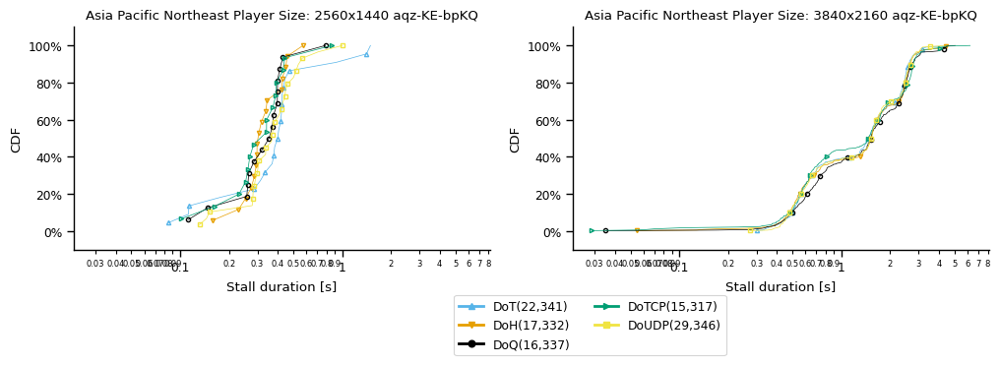

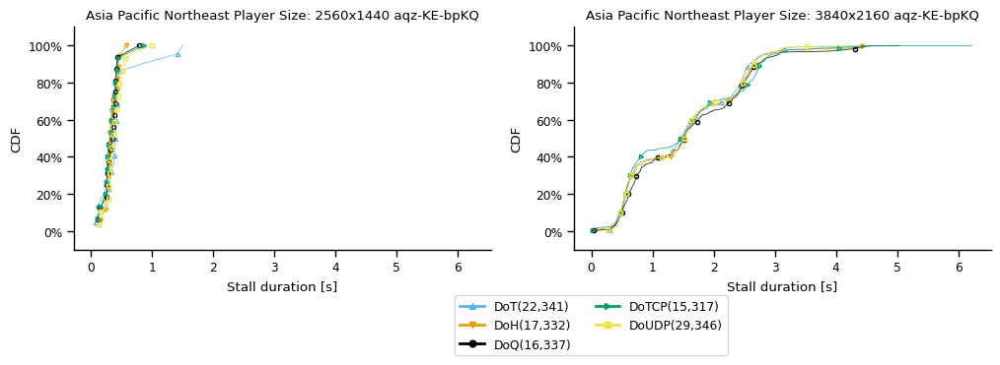

Asia Pacific Southeast


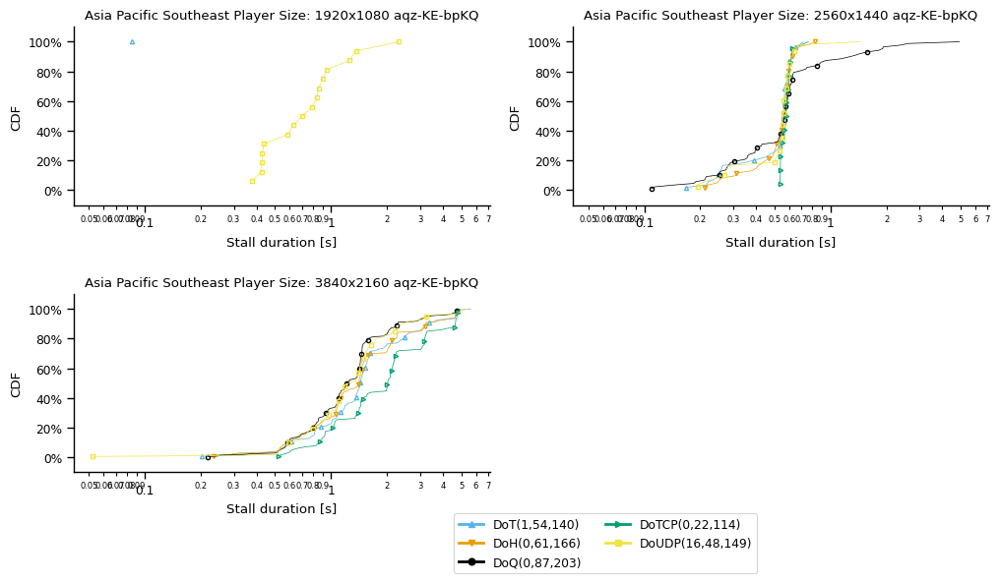

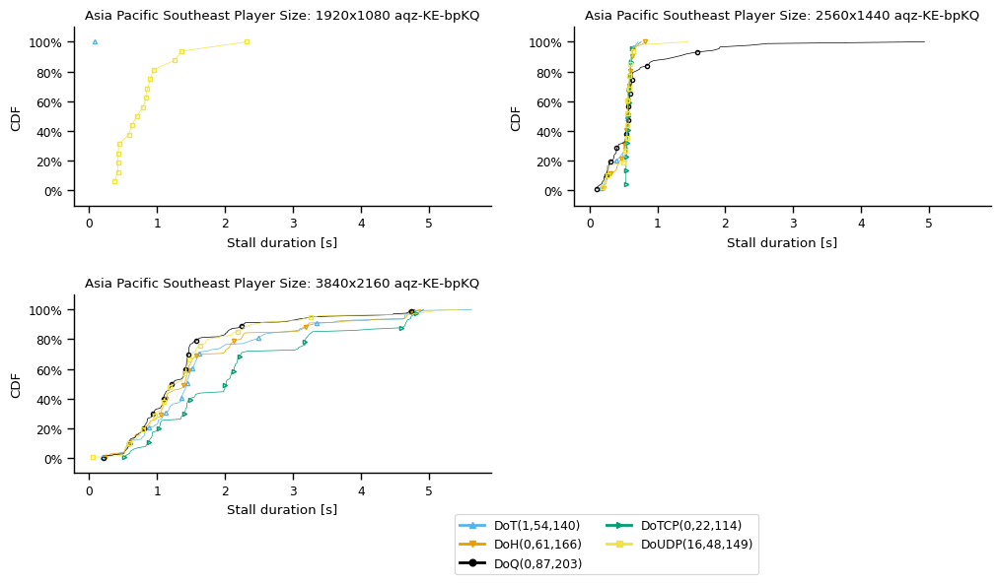

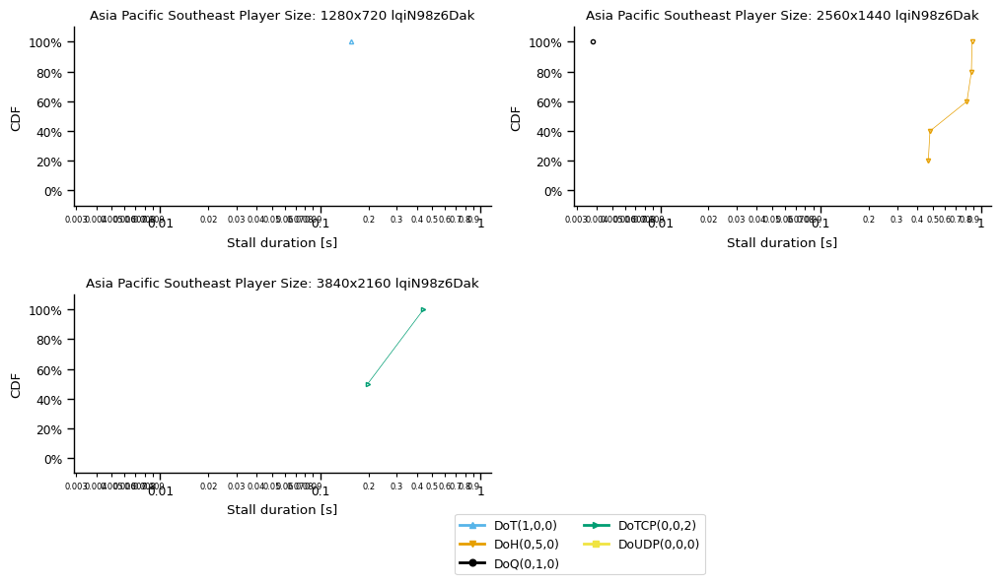

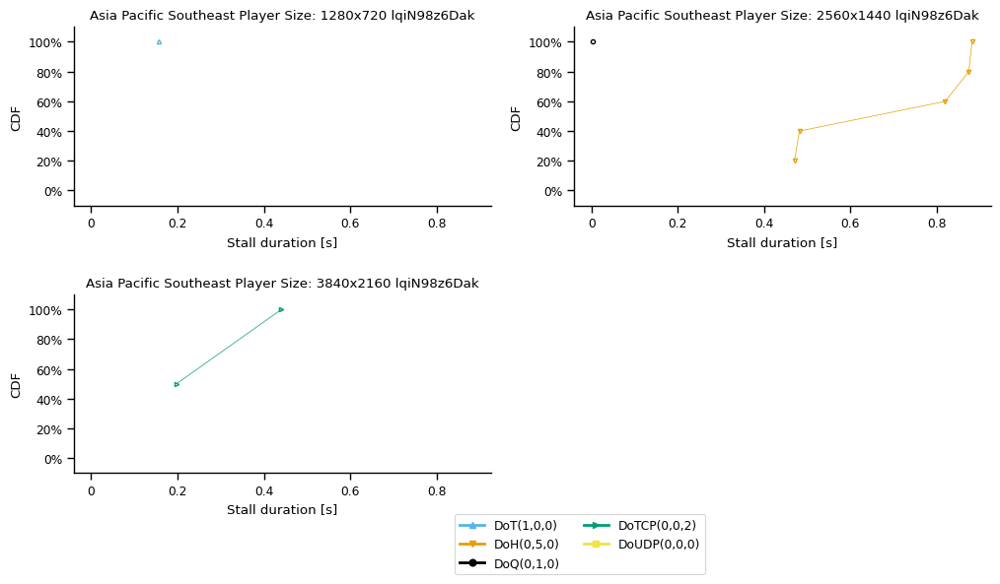

Europe Central


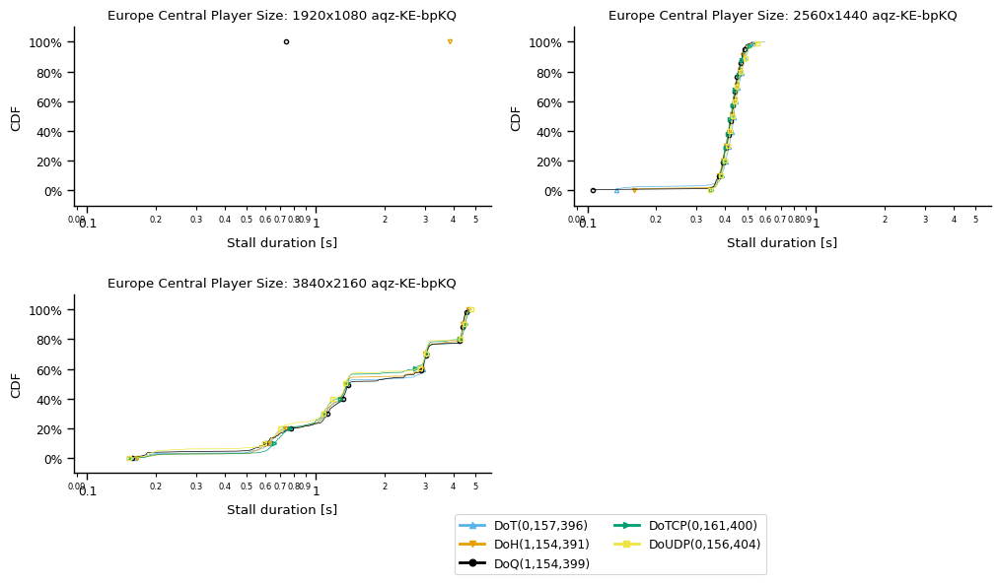

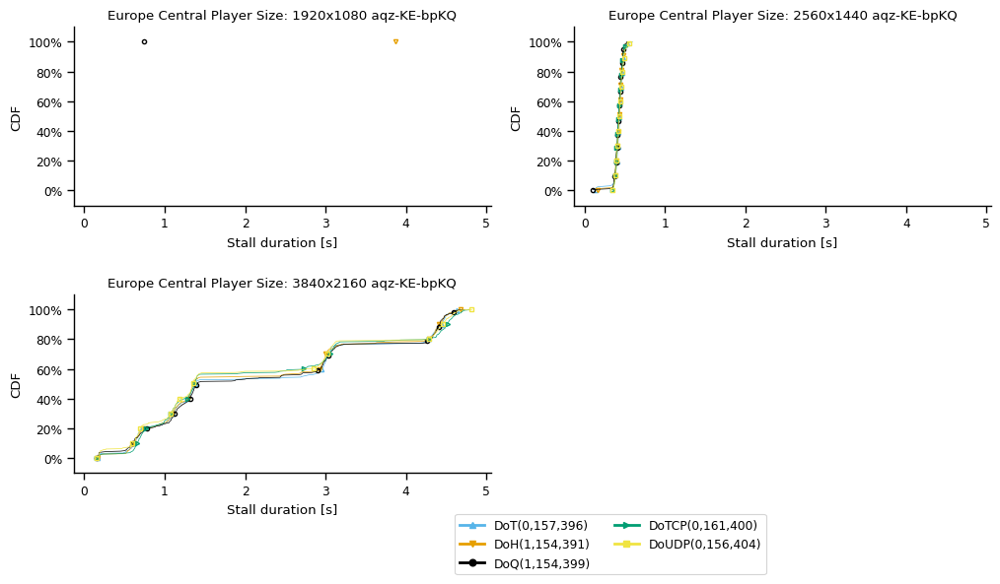

South America East


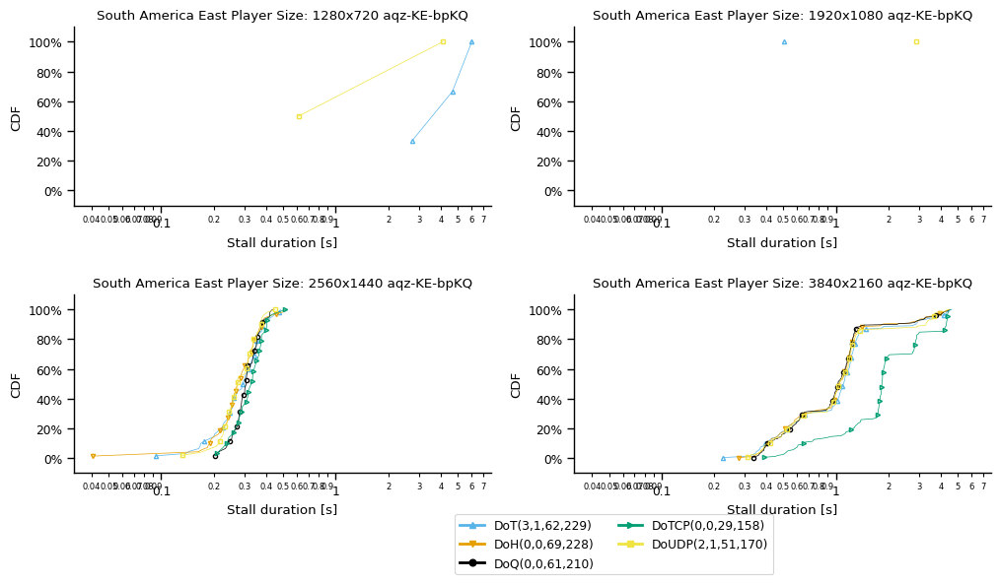

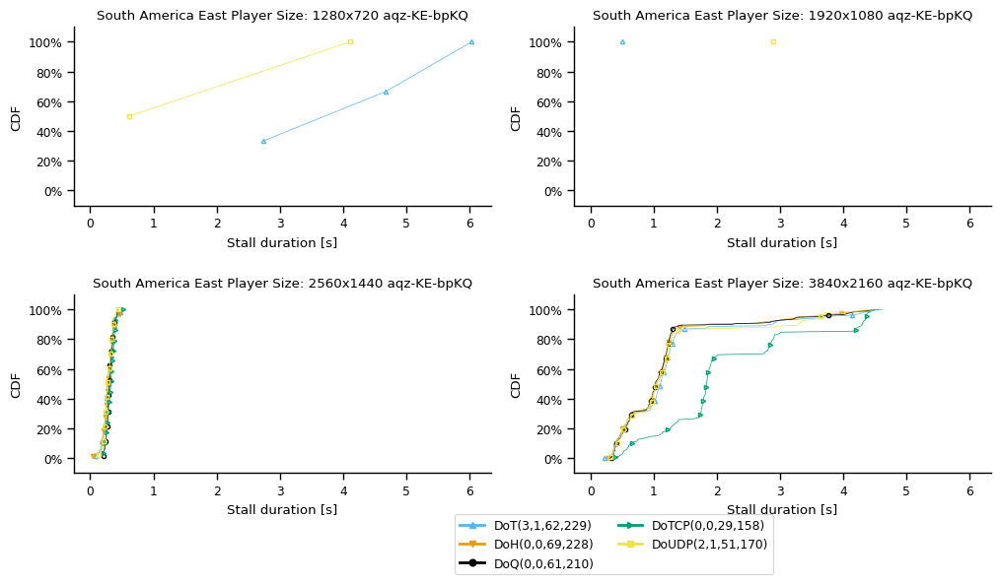

US East


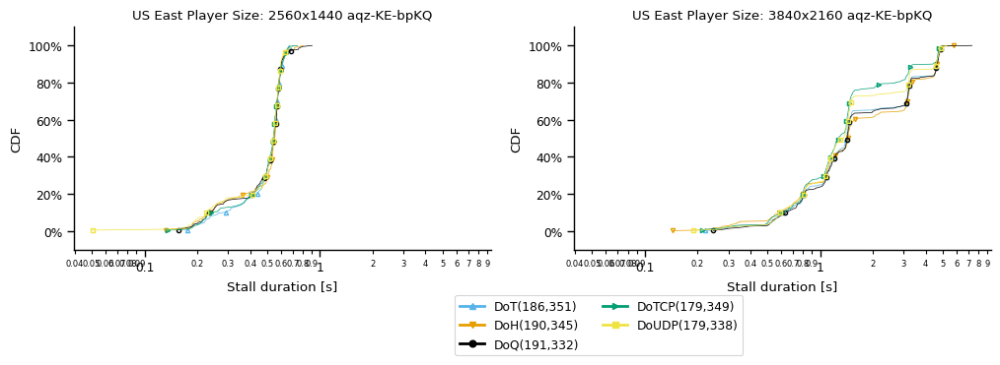

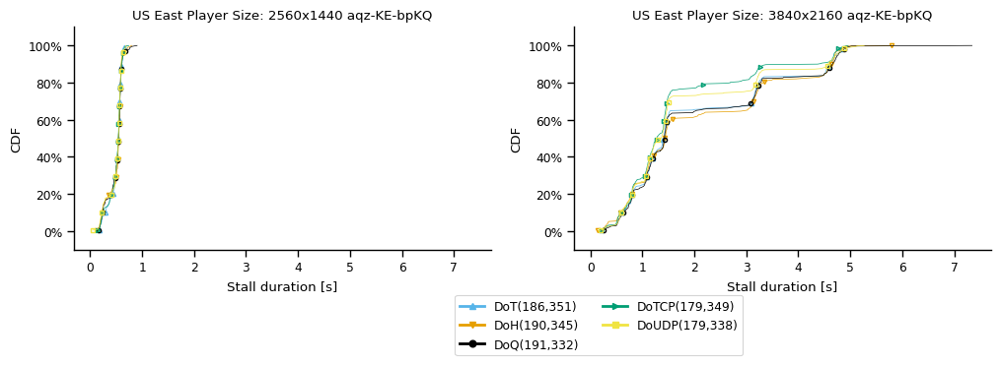

US West


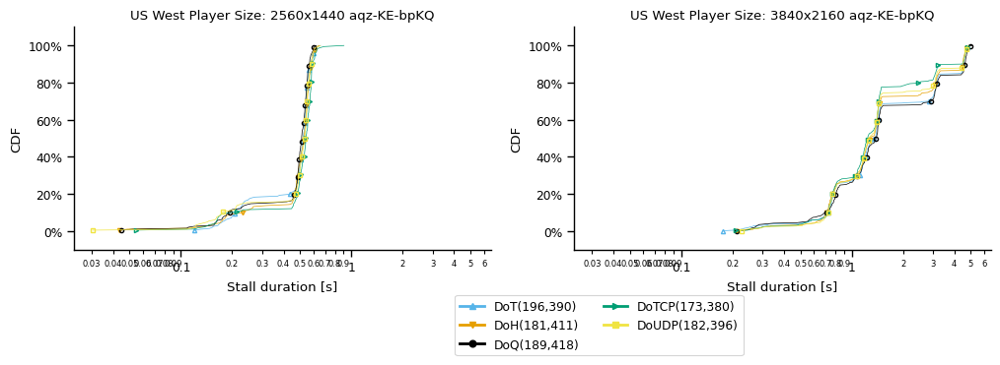

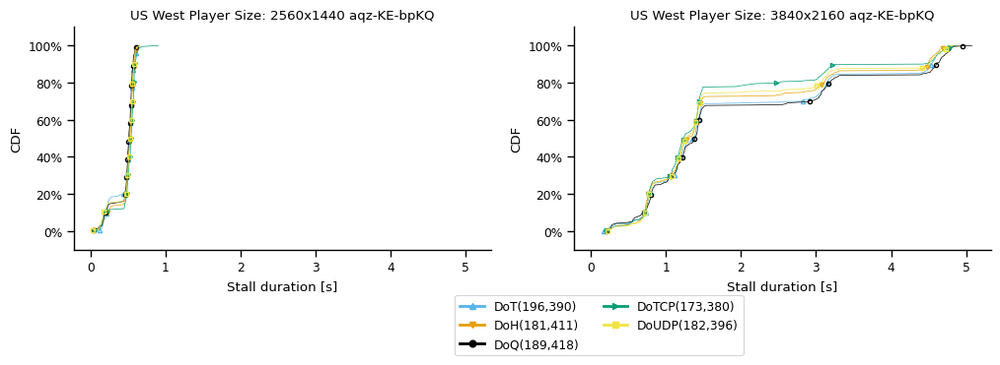

all vantage points


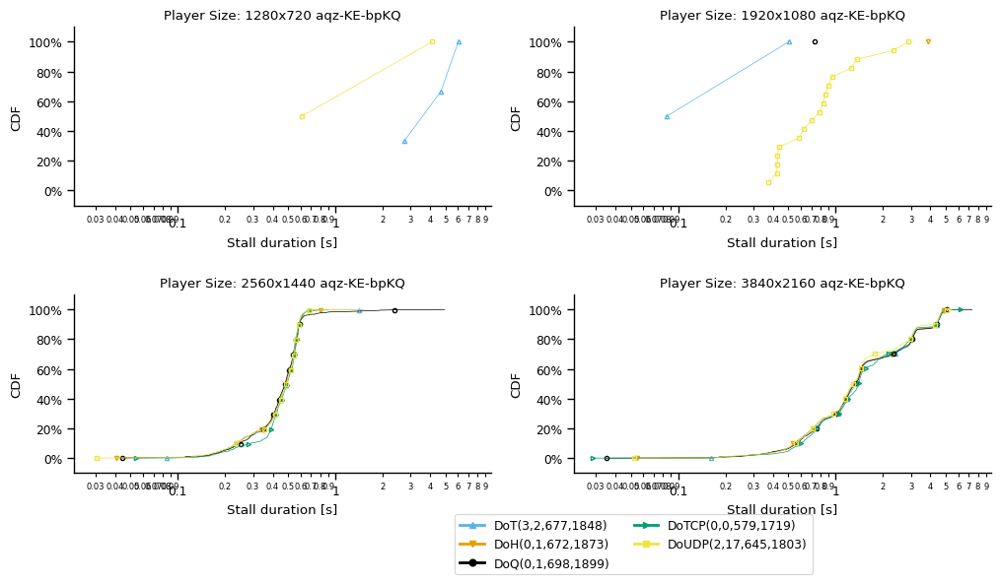

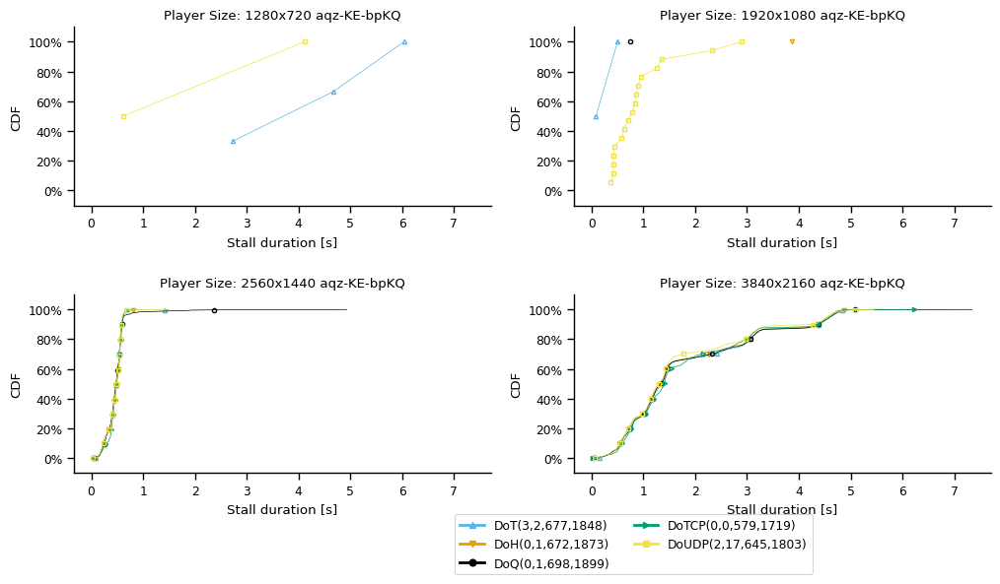

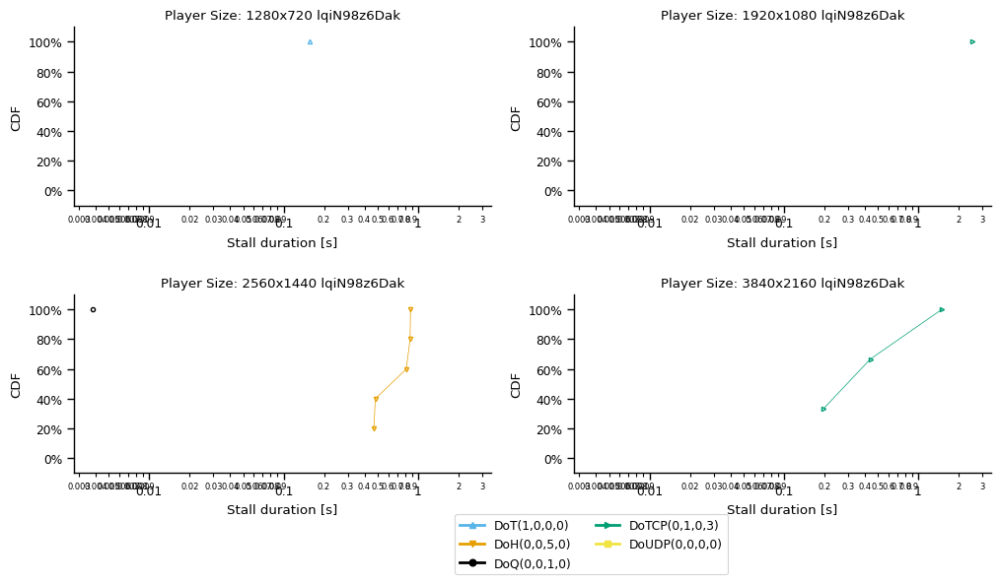

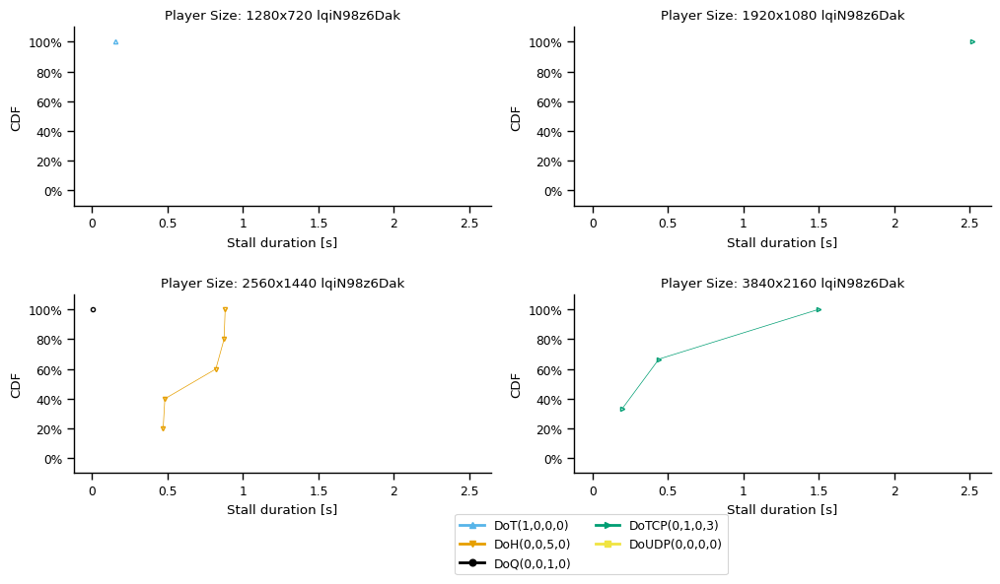

In [521]:
draw_cdf_grid(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0])

Africa South
Asia Pacific Northeast


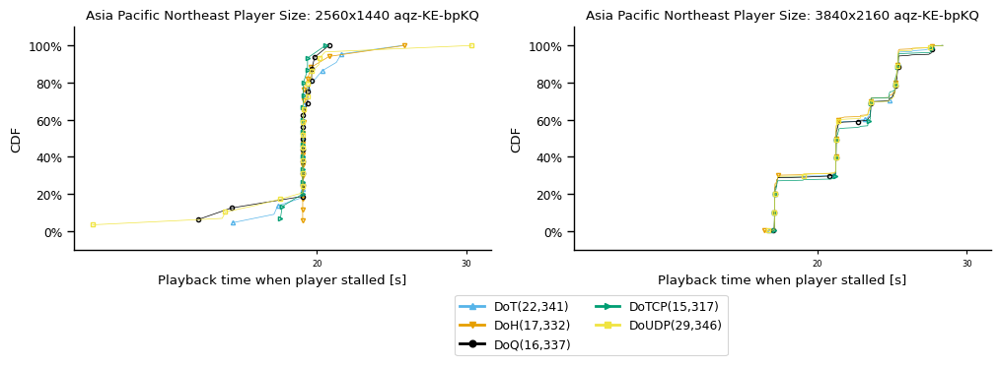

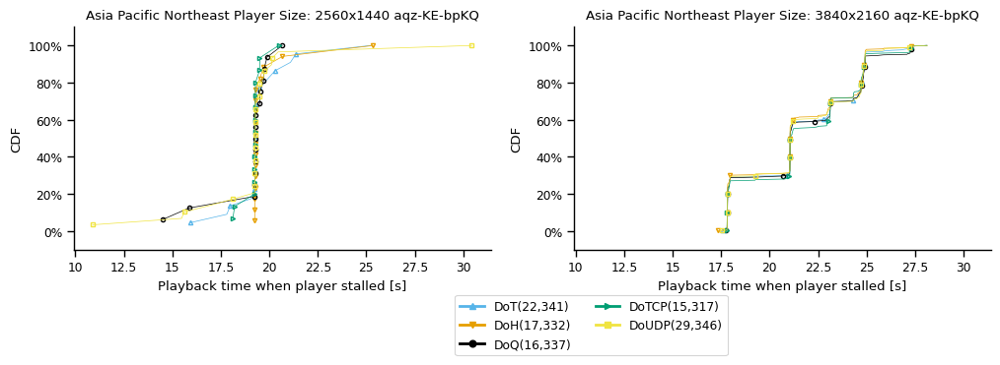

Asia Pacific Southeast


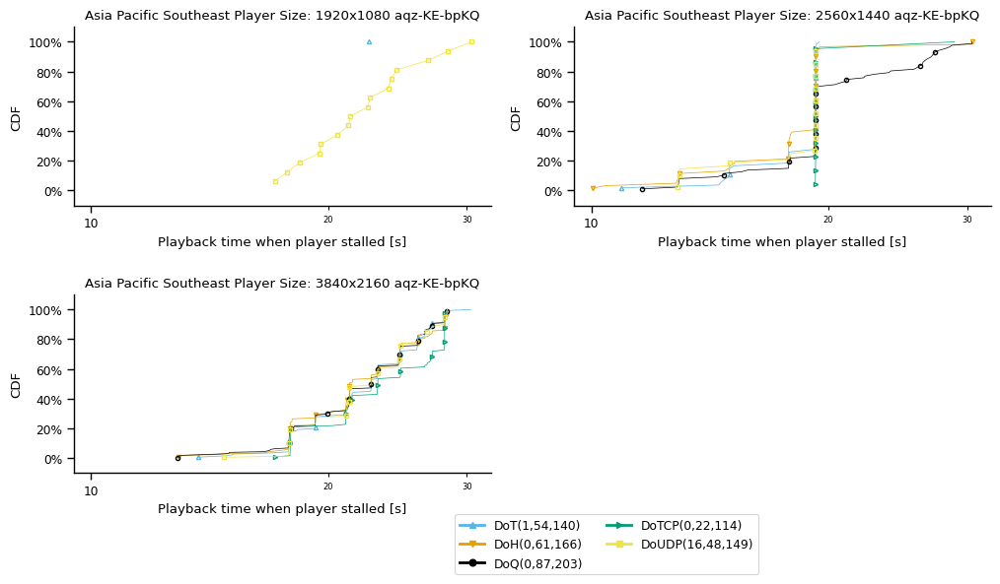

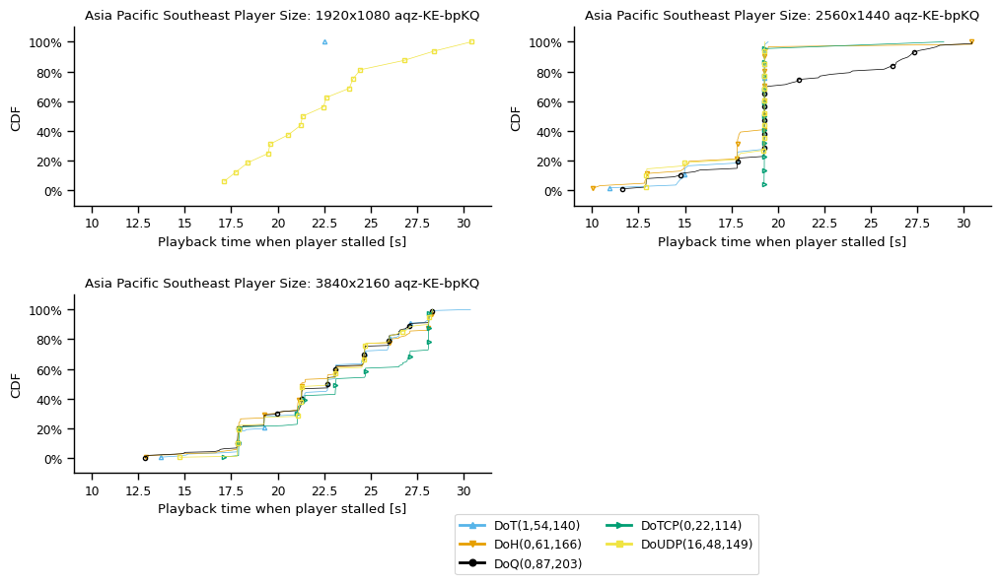

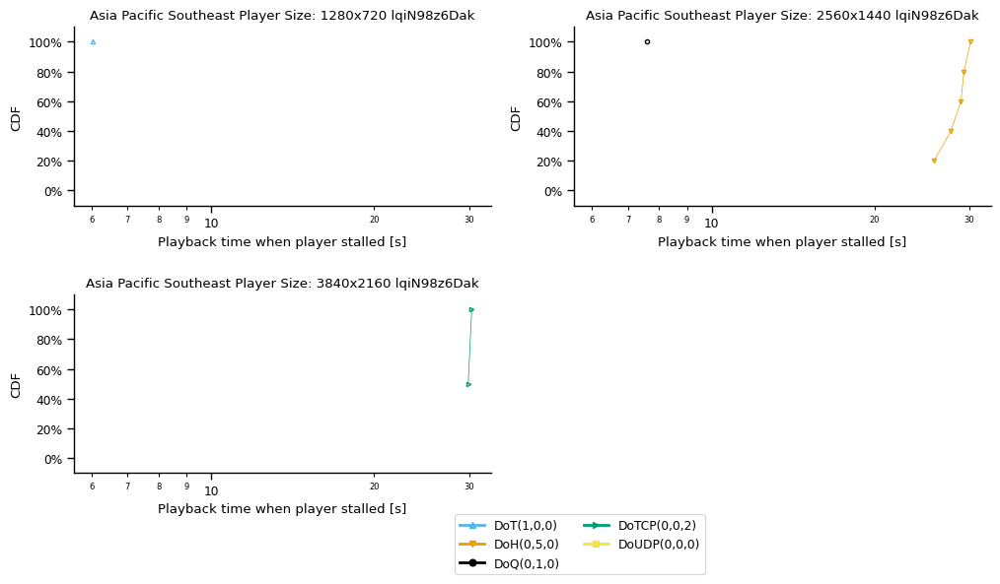

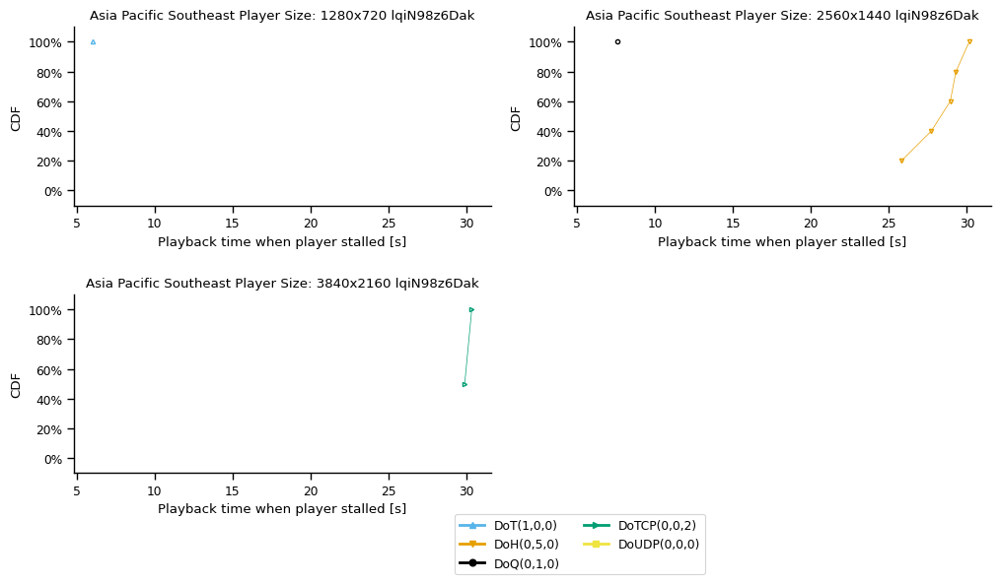

Europe Central


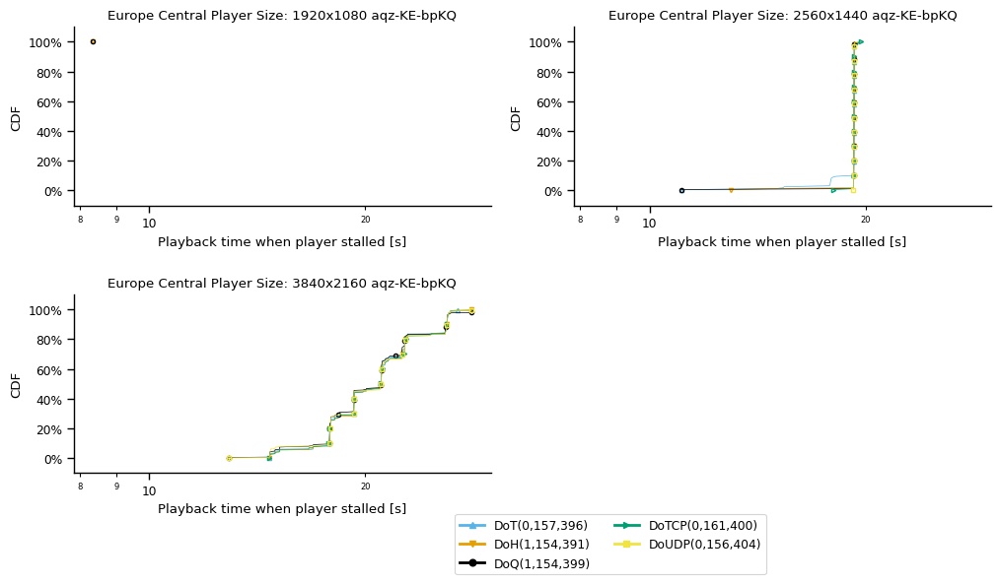

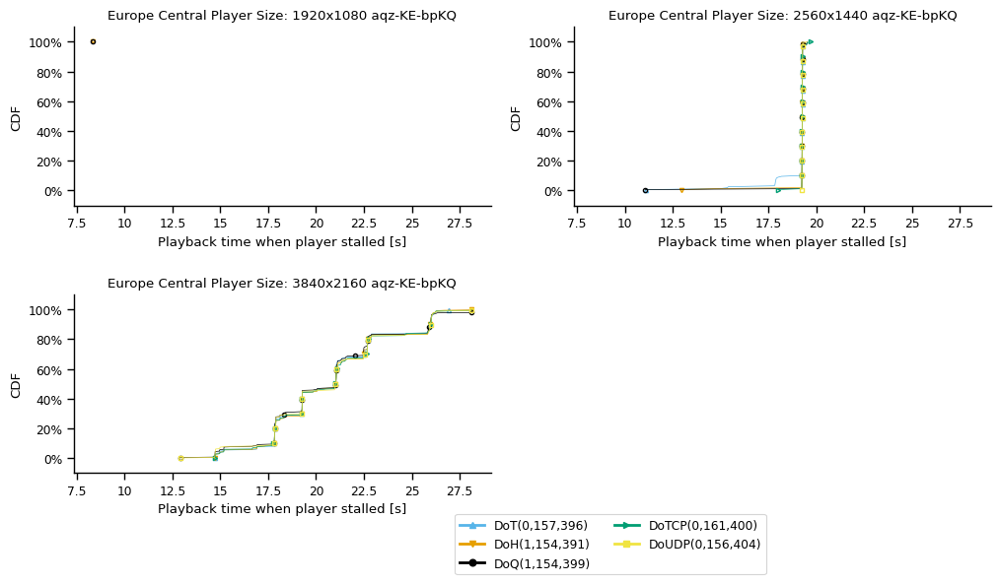

South America East


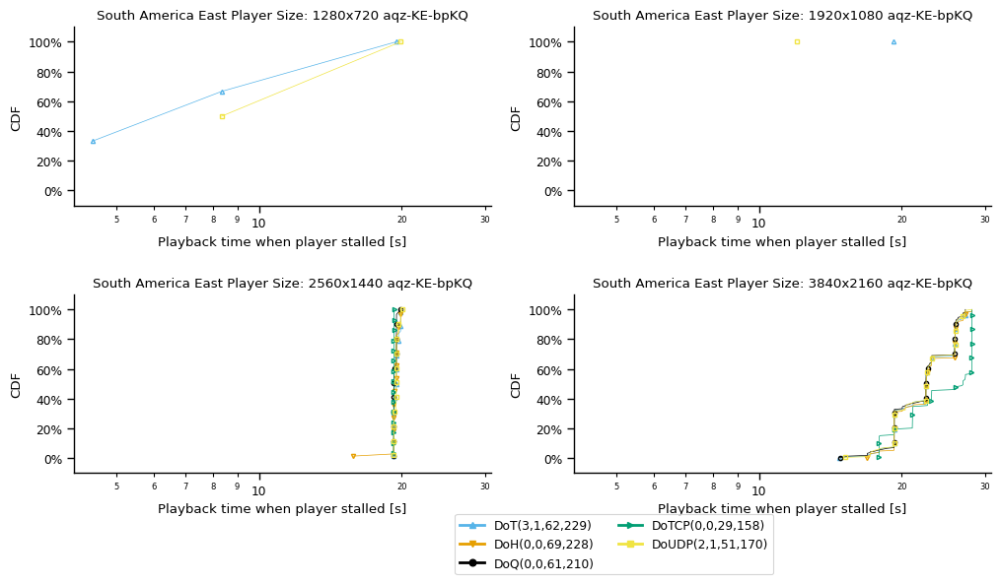

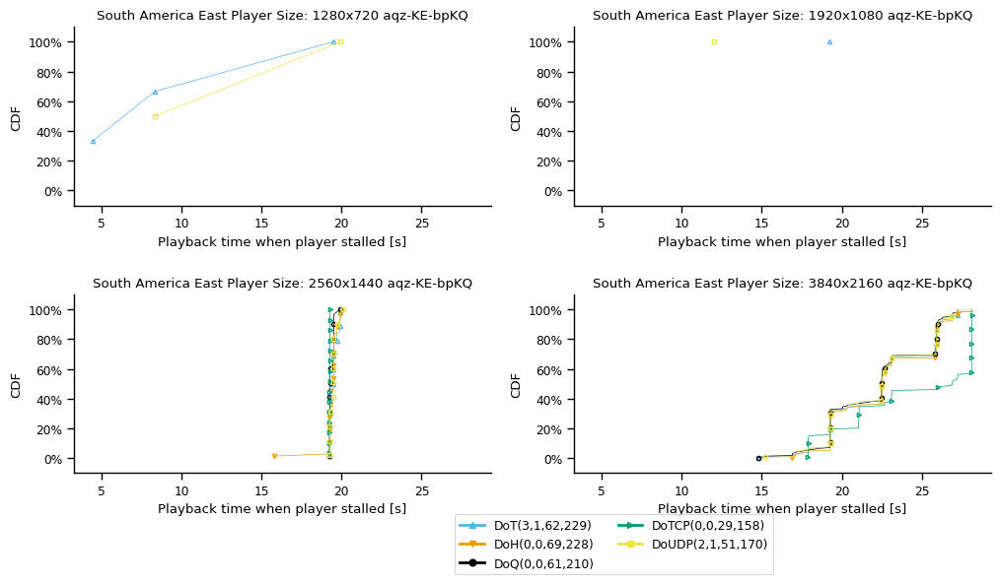

US East


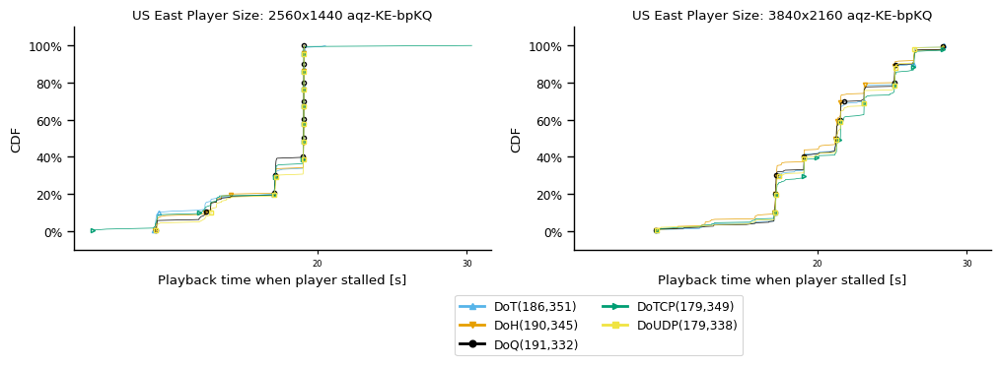

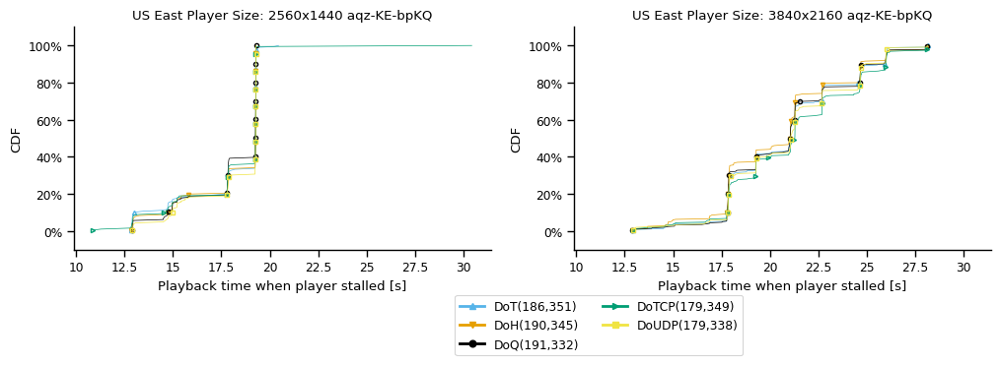

US West


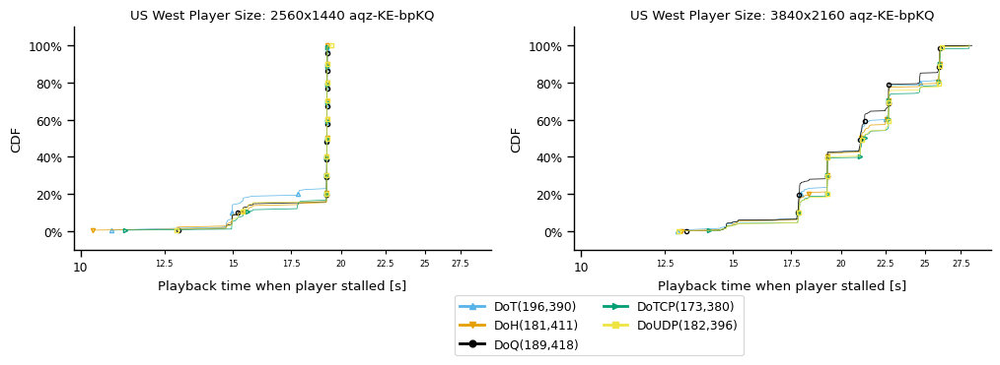

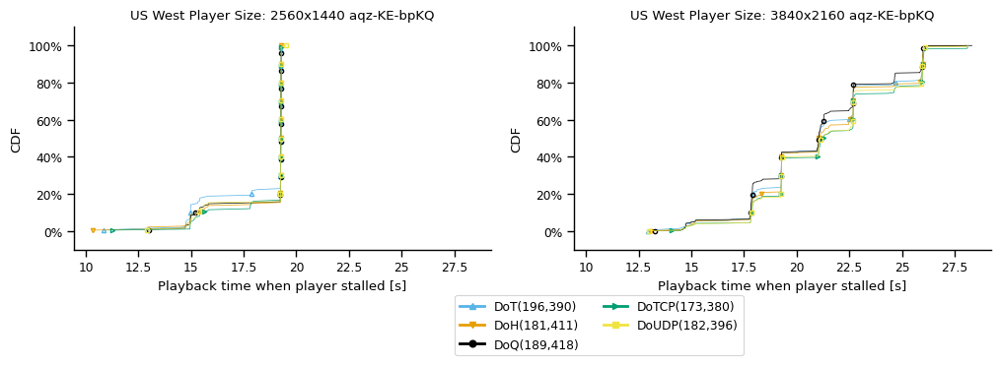

all vantage points


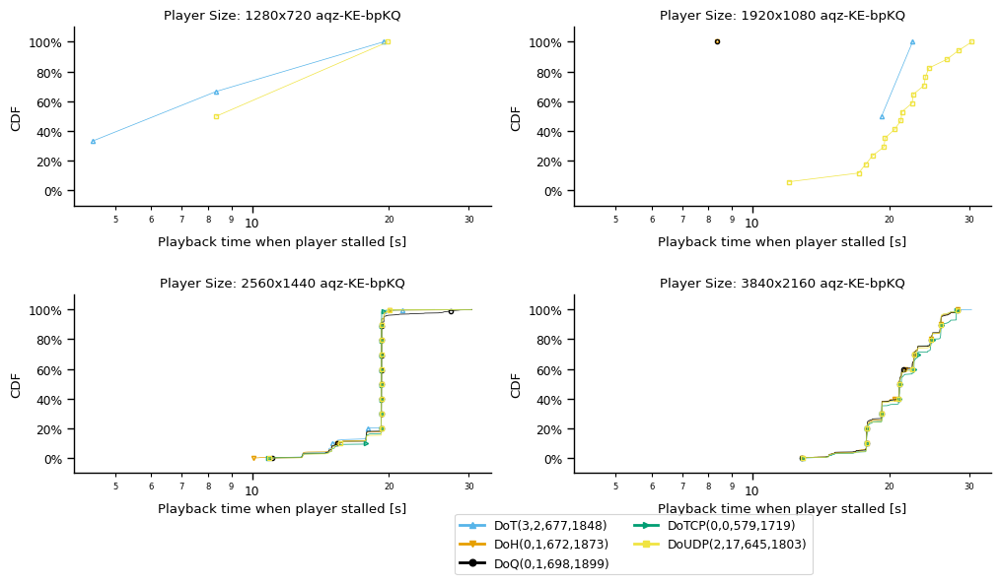

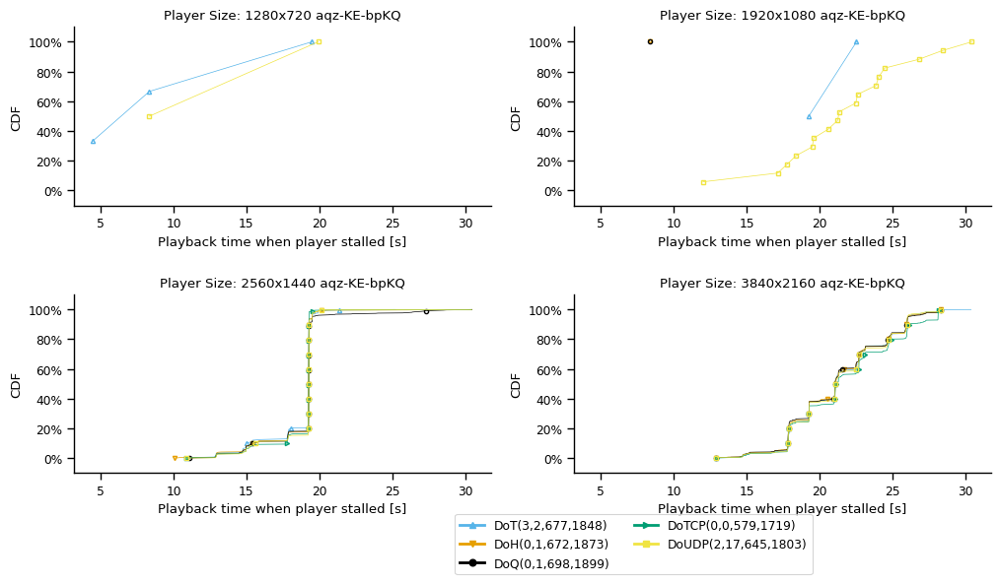

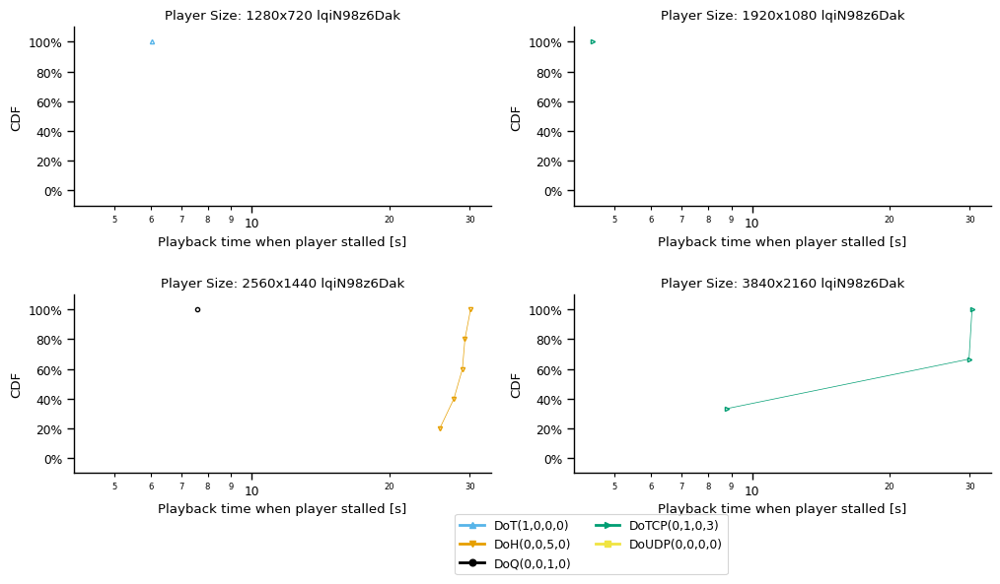

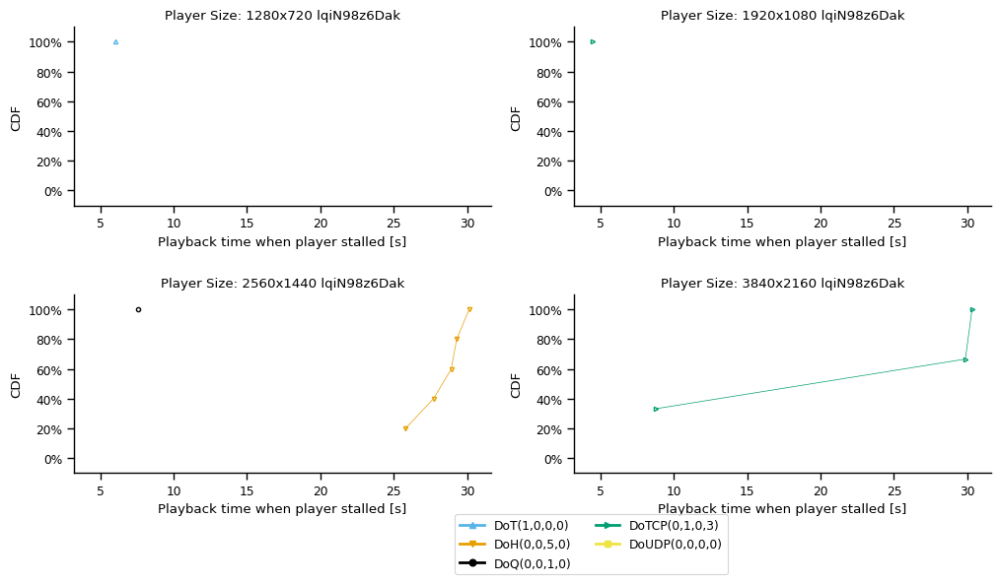

In [522]:
draw_cdf_grid(df_stall_times, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-with-restart-events-by-player-size-and-proto', [0,0], draw_all=True)

Africa South
Asia Pacific Northeast


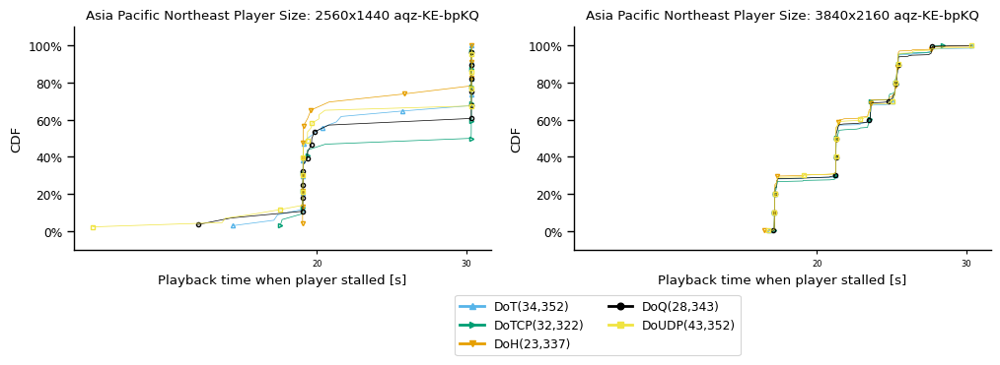

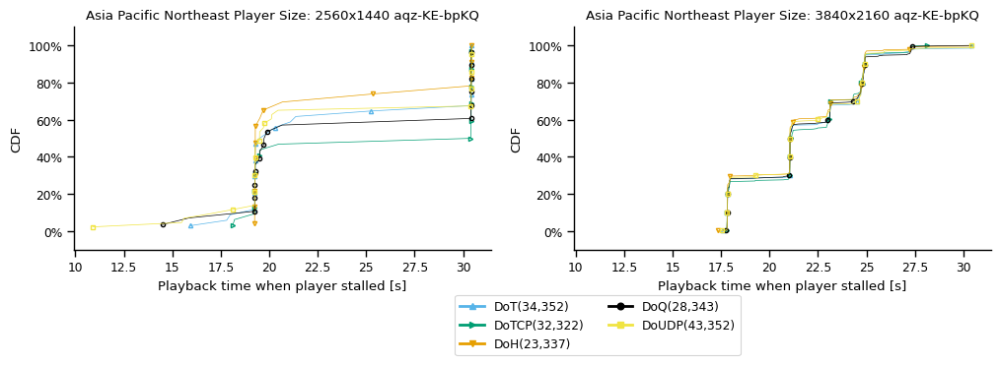

Asia Pacific Southeast


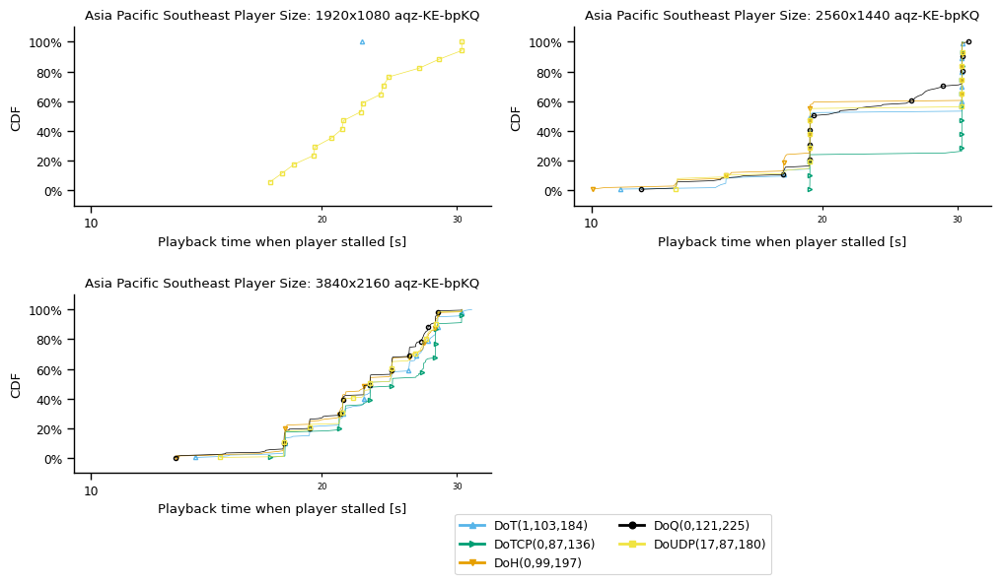

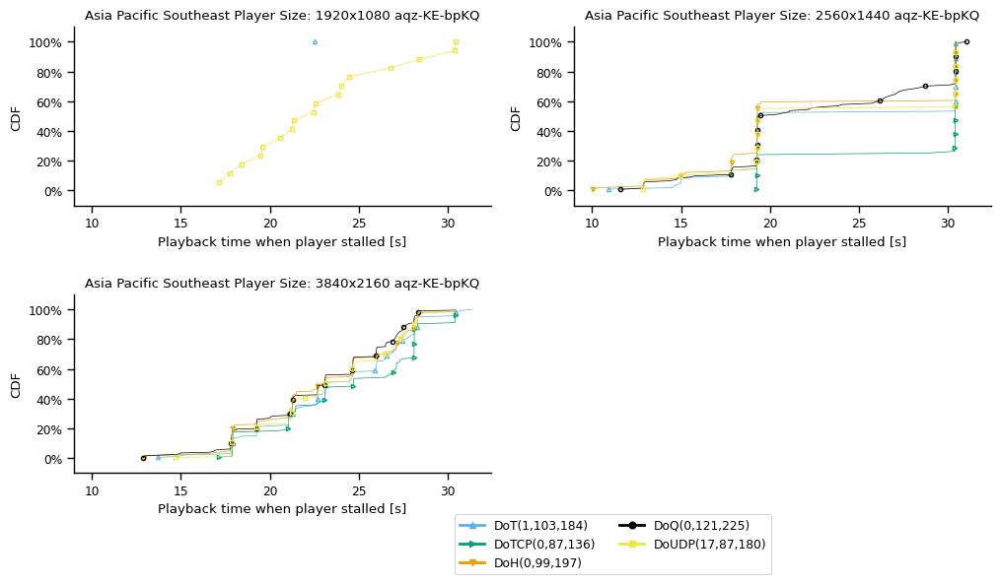

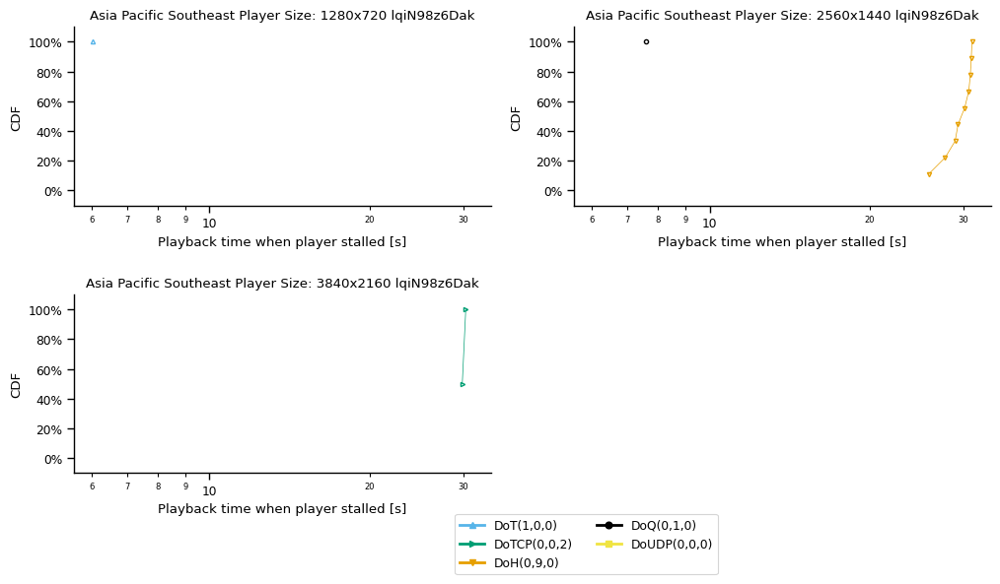

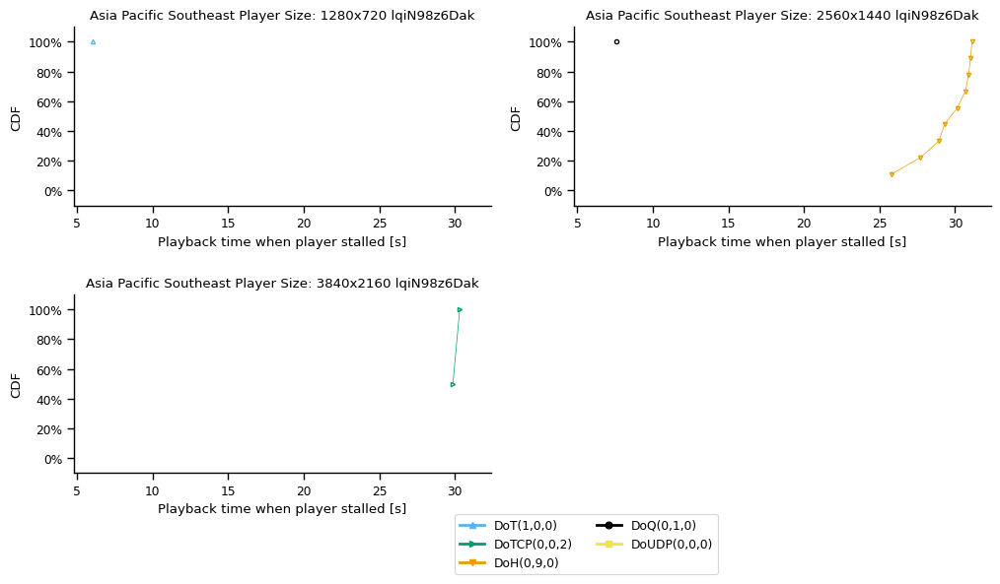

Europe Central


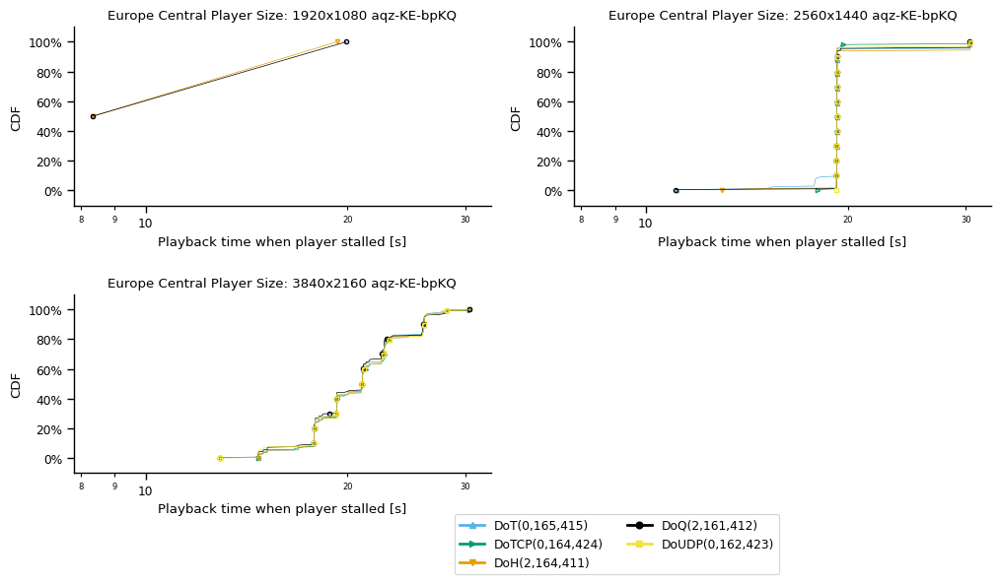

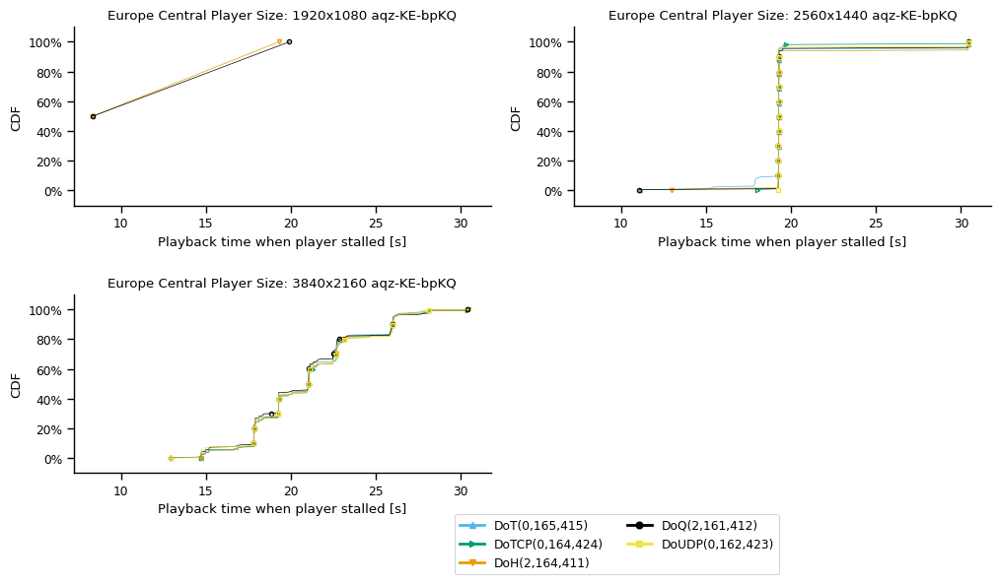

South America East


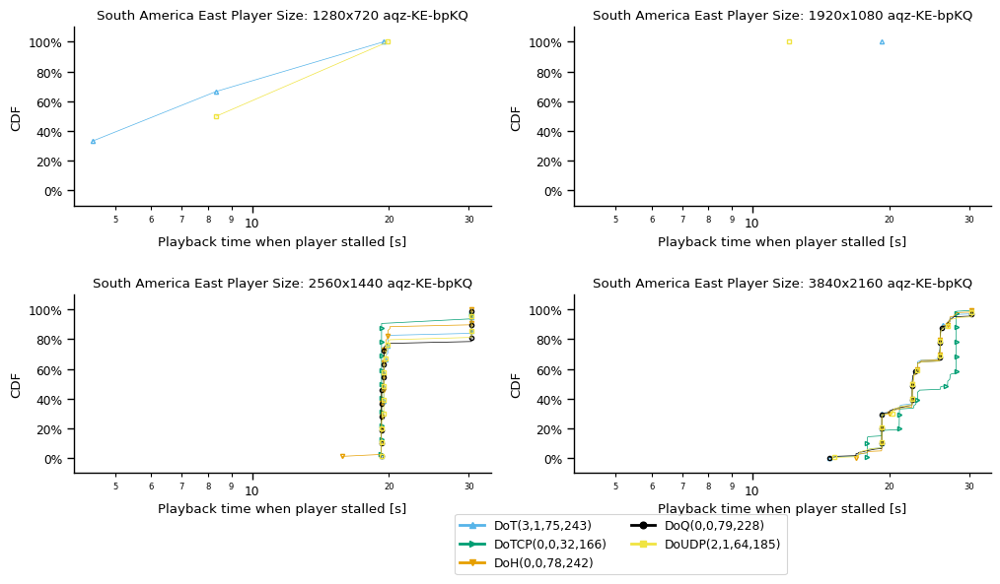

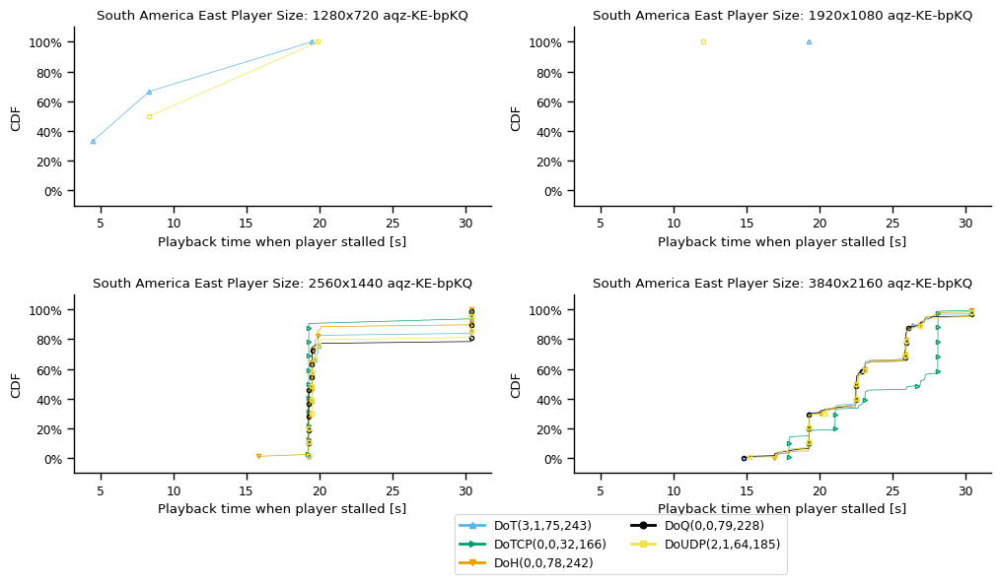

US East


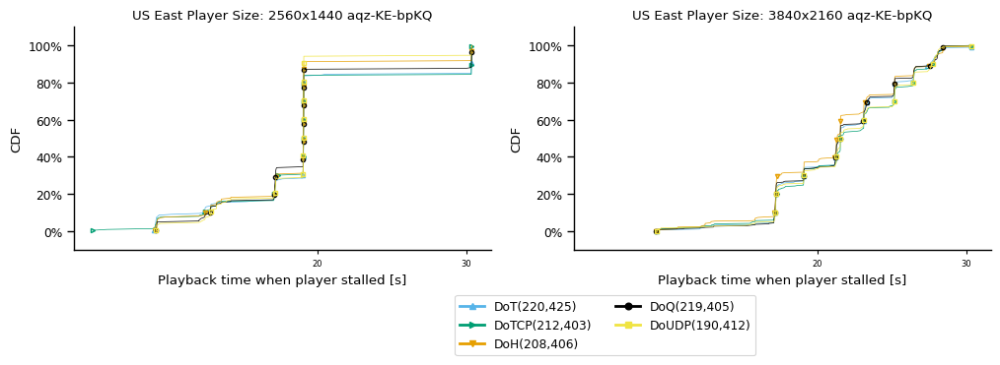

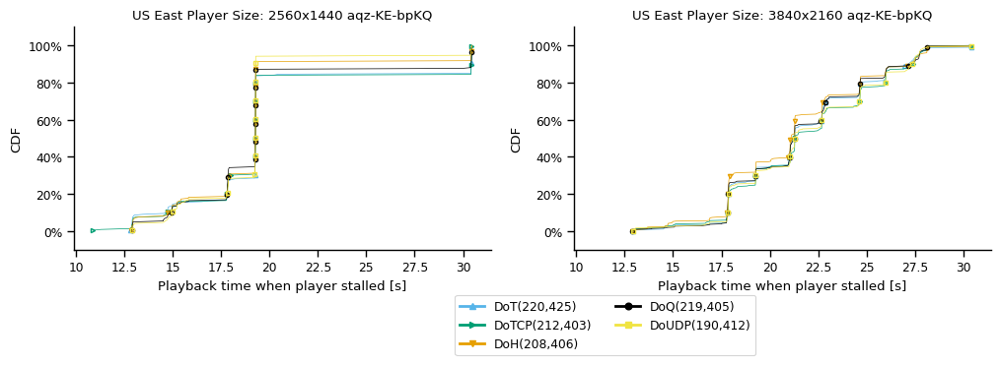

US West


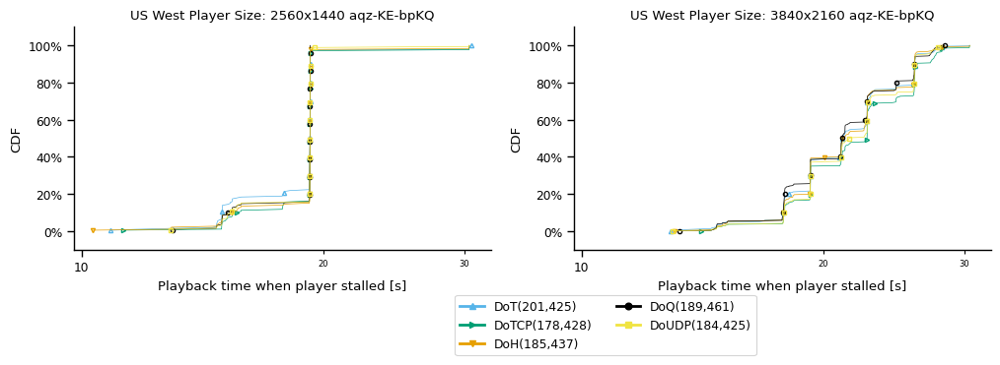

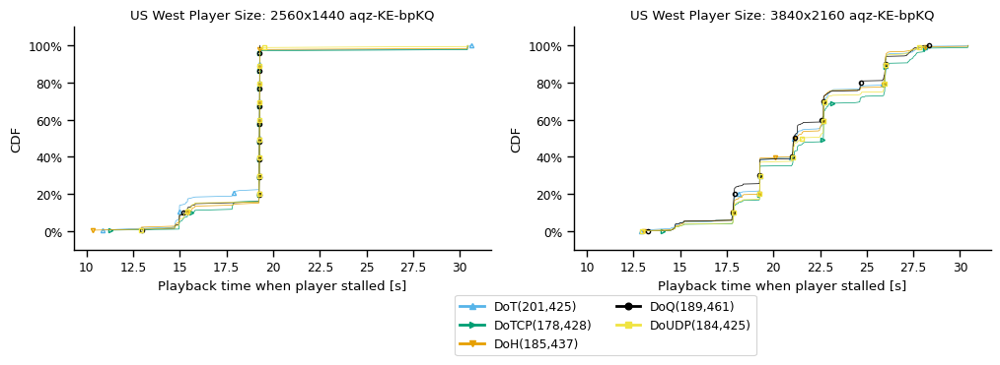

all vantage points


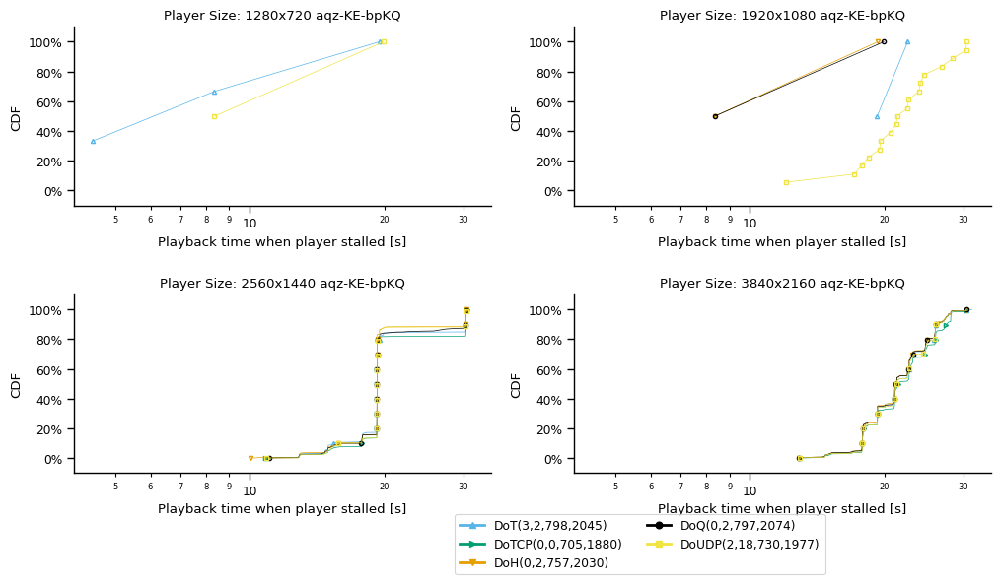

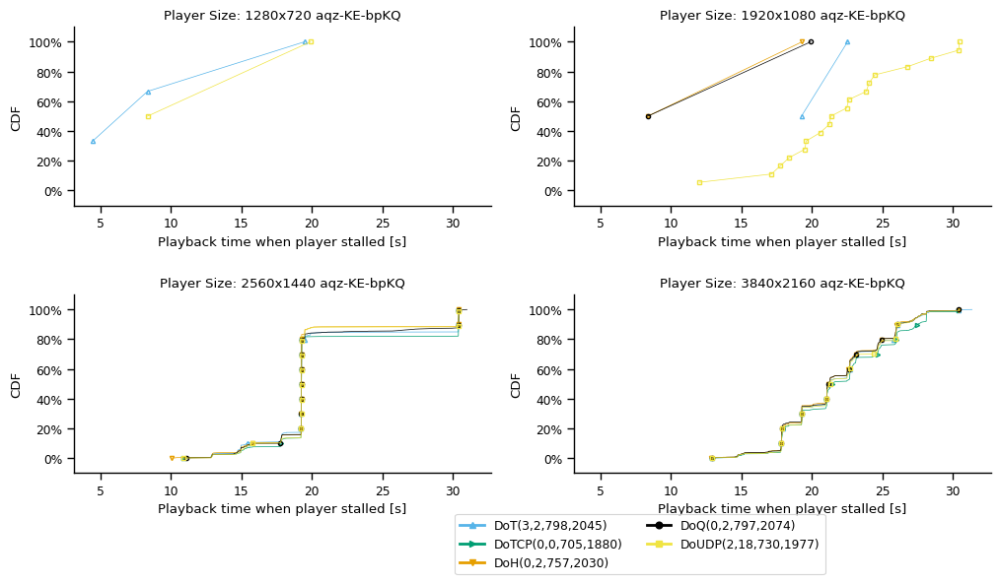

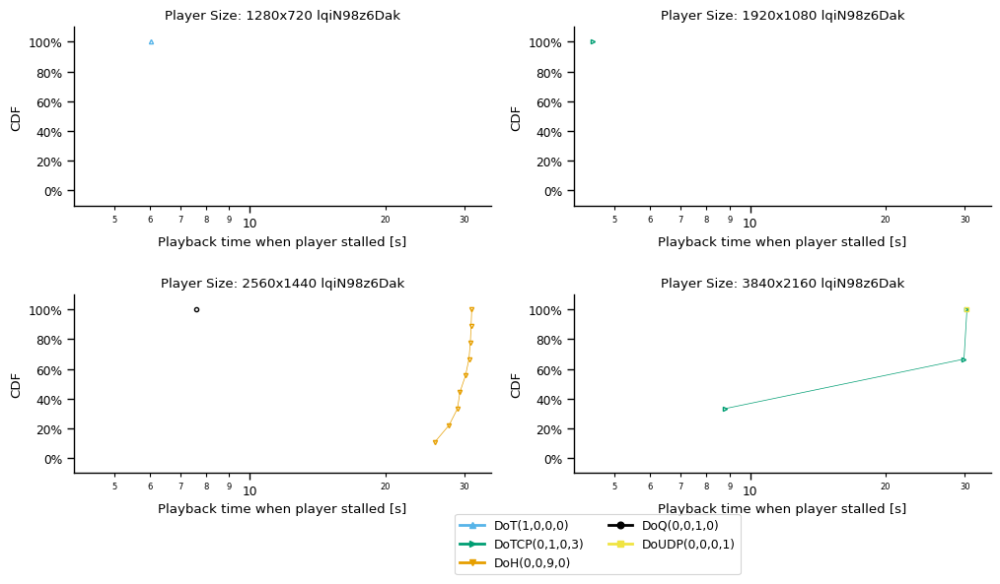

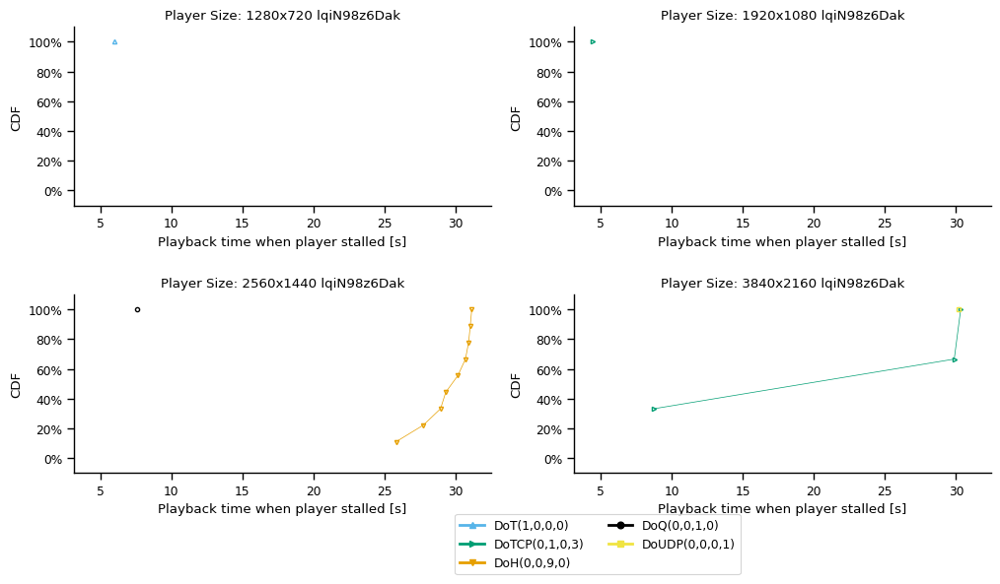

In [523]:
draw_cdf_grid(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0])

In [421]:
df_start_time.groupby('domain').agg({'vantagePoint':'count'})

,vantagePoint
domain,
aqz-KE-bpKQ,20218
lqiN98z6Dak,22259


In [ ]:
draw_cdf_grid(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0])

In [ ]:
draw_cdf(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0.1,1])

Africa South


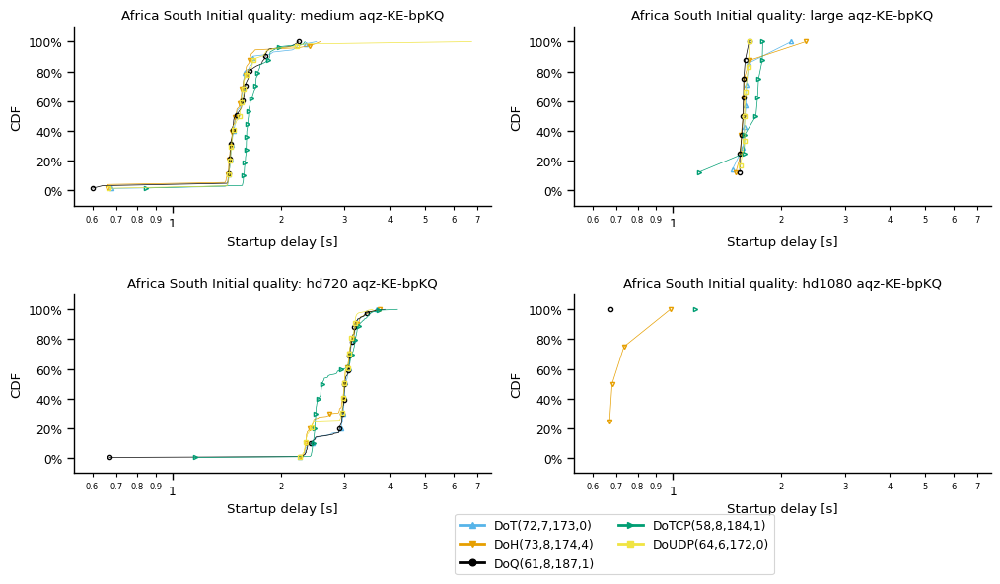

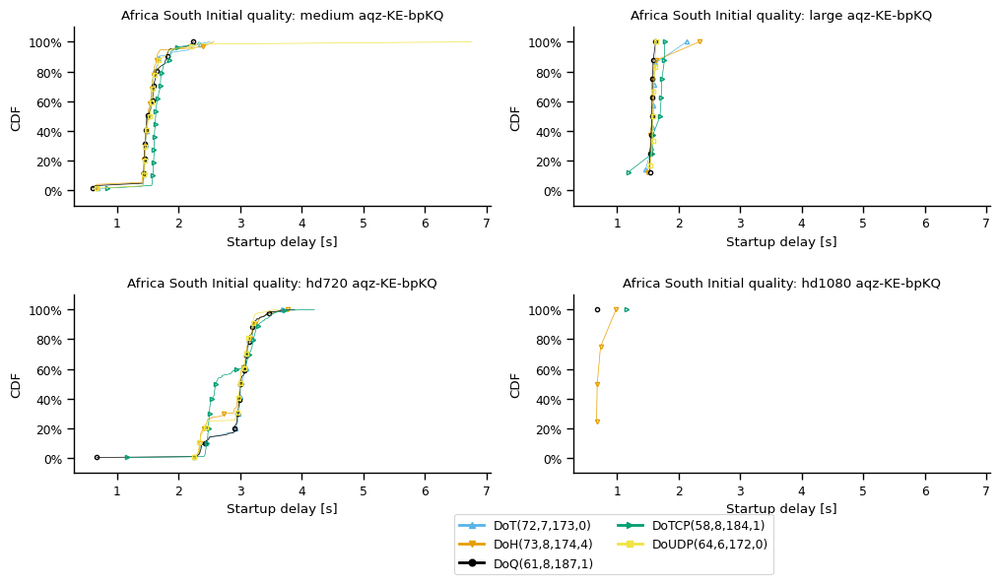

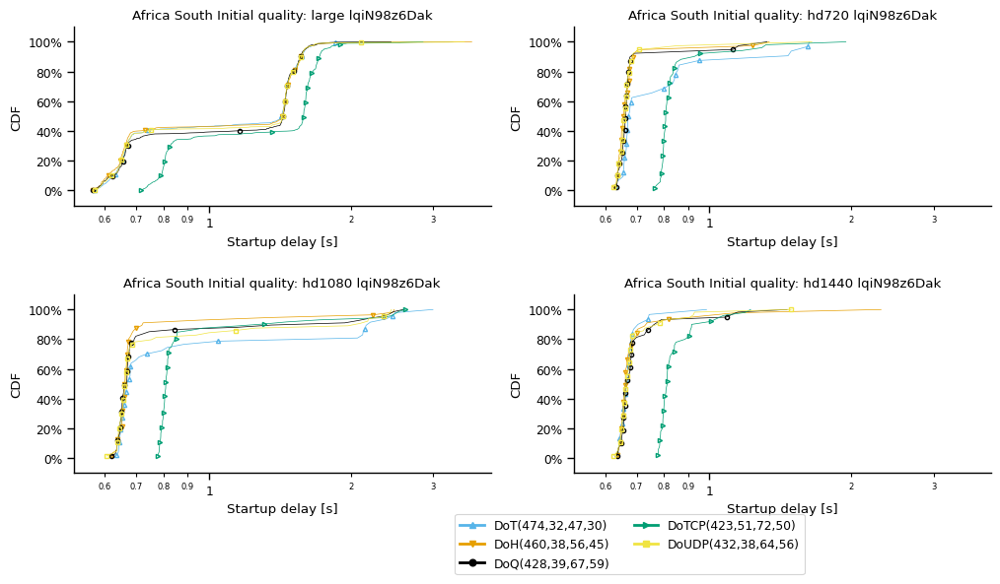

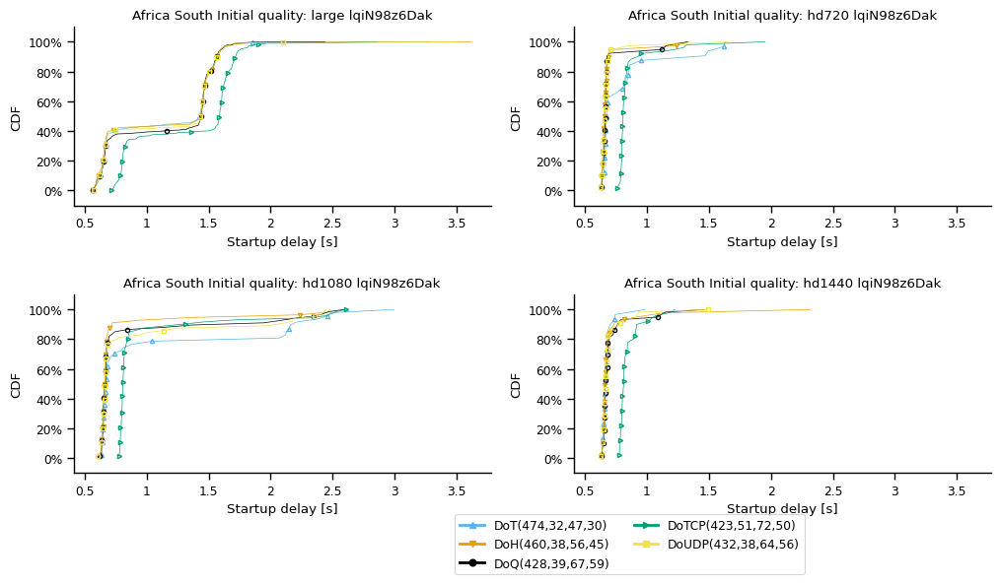

Asia Pacific Northeast


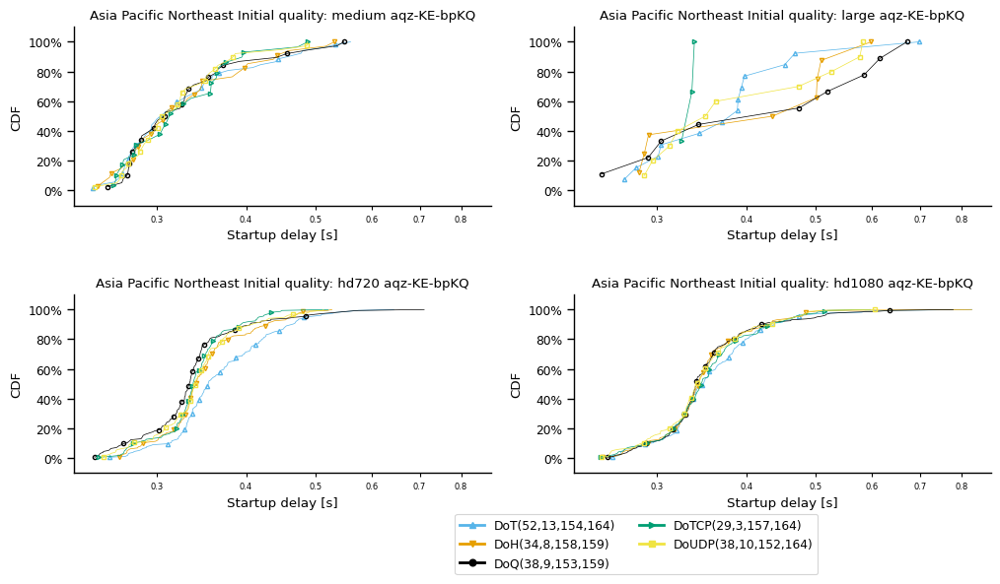

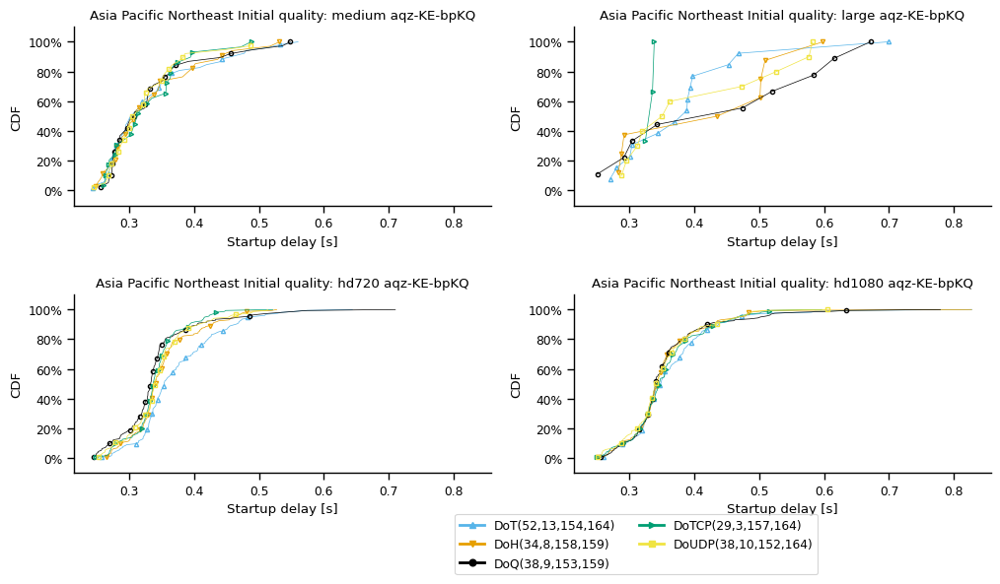

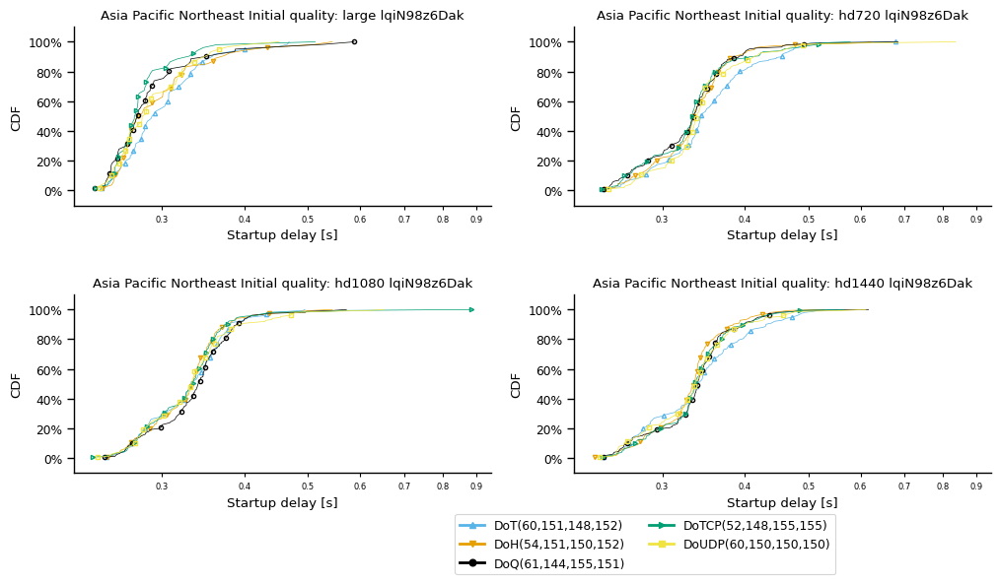

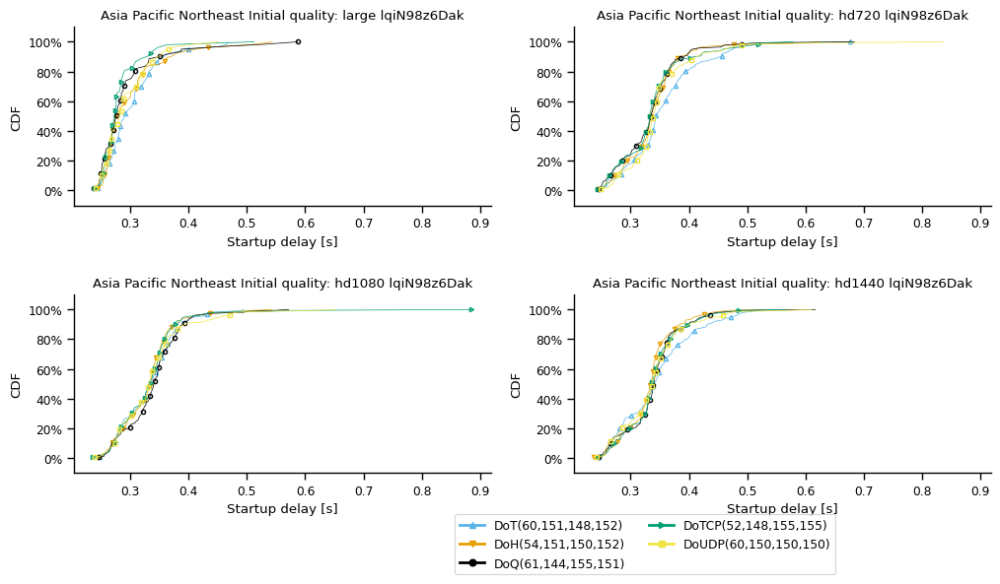

Asia Pacific Southeast


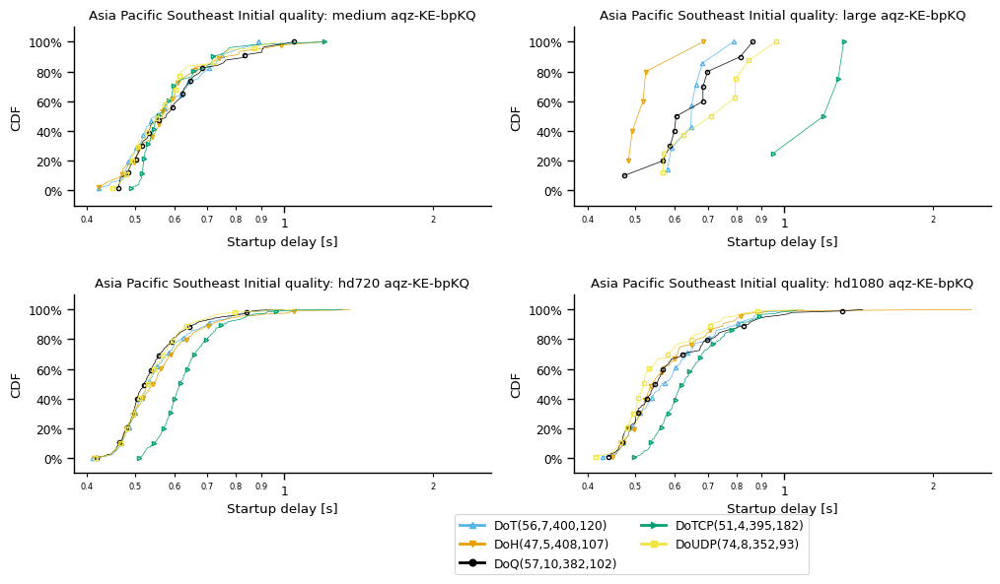

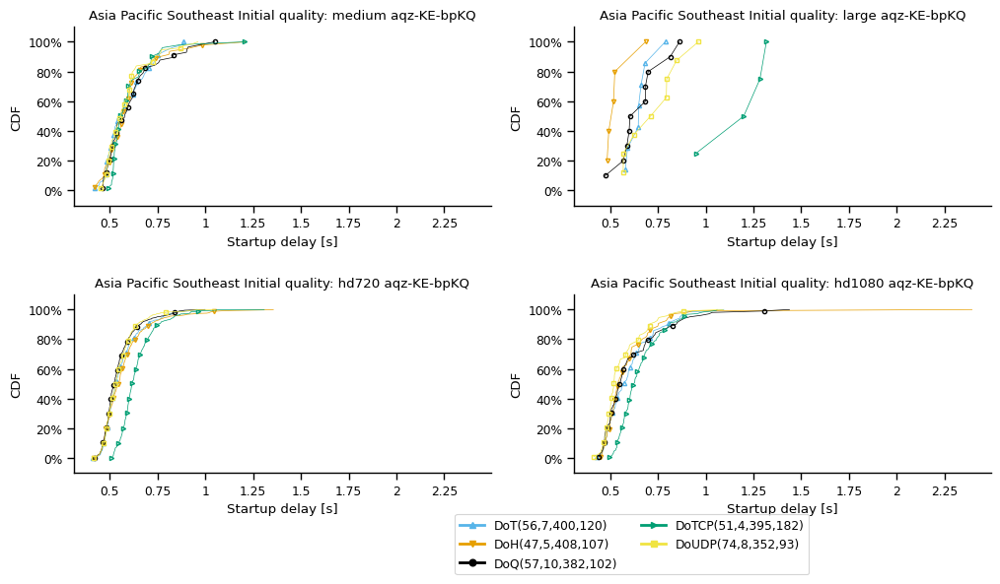

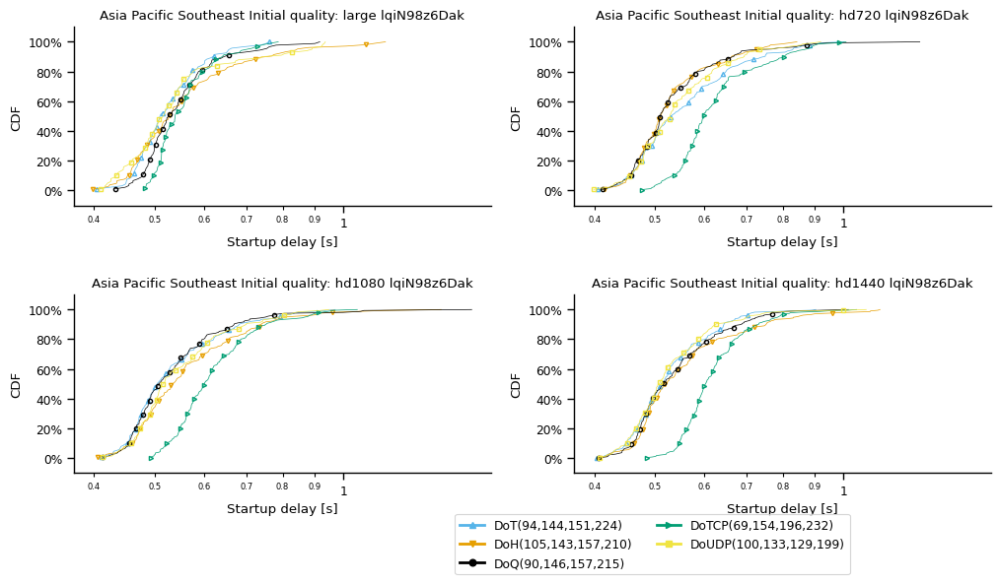

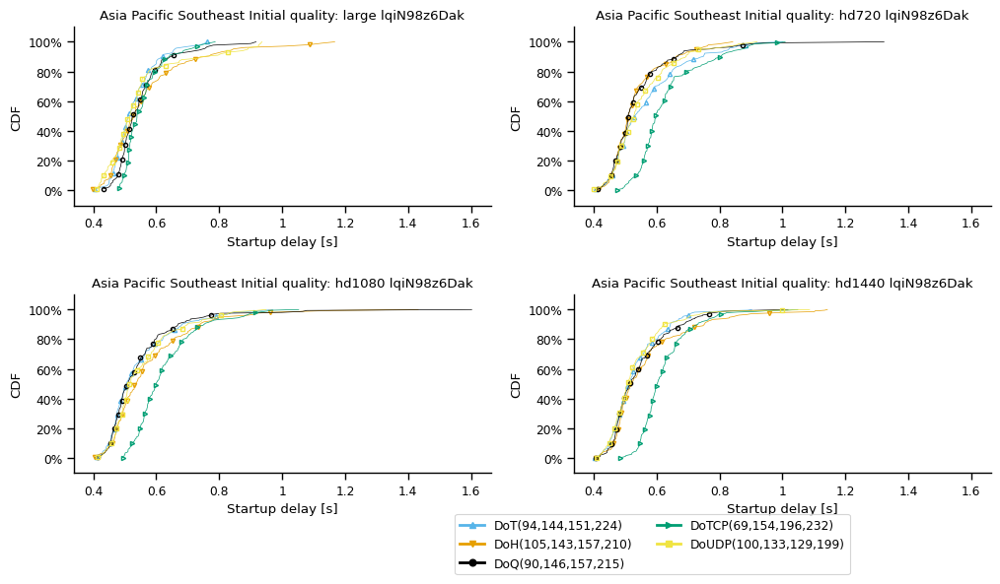

Europe Central


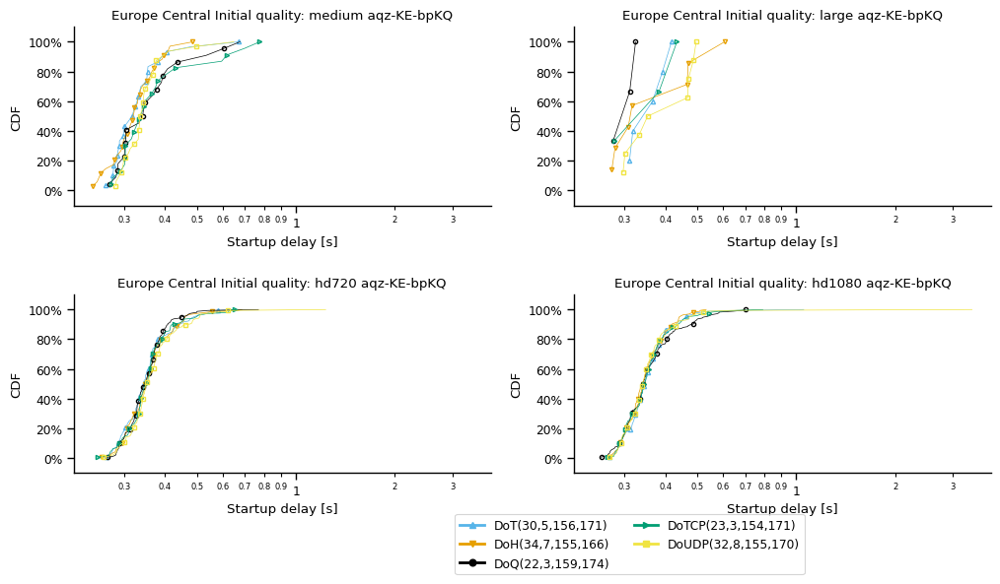

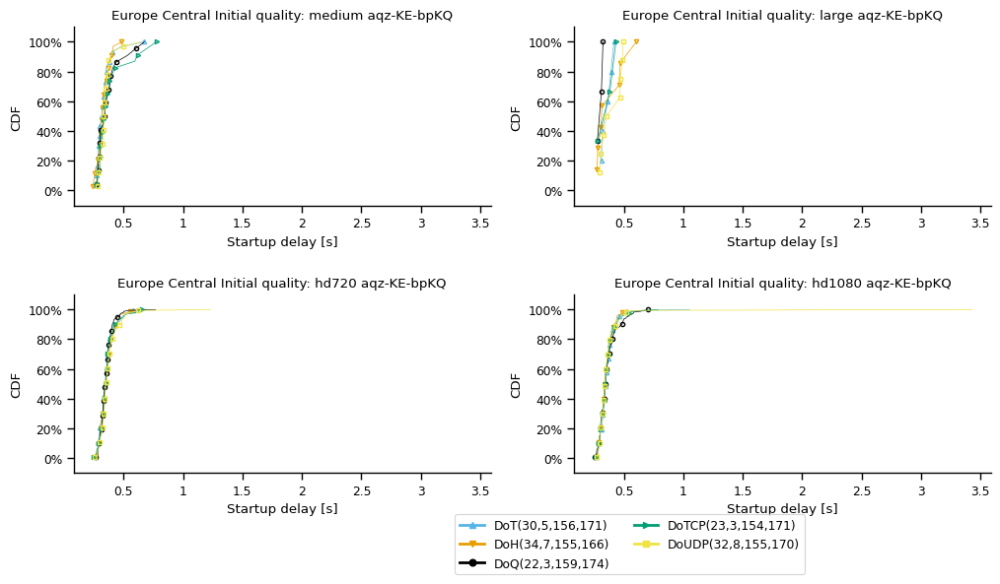

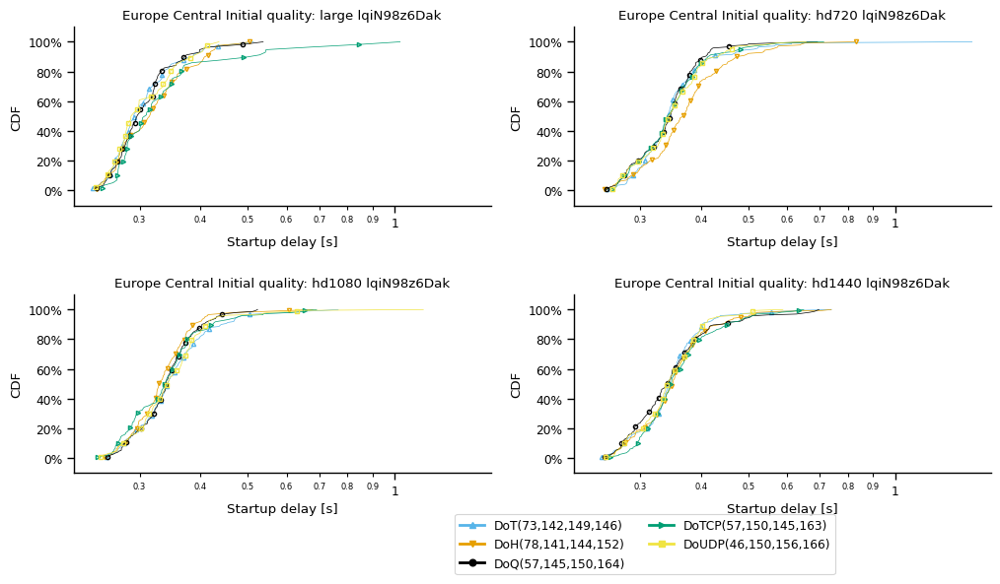

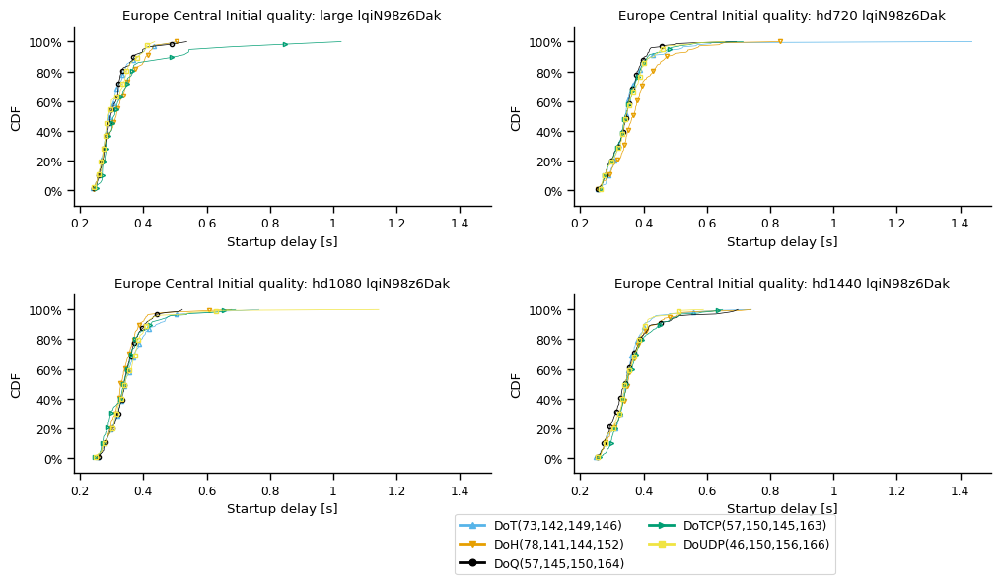

South America East


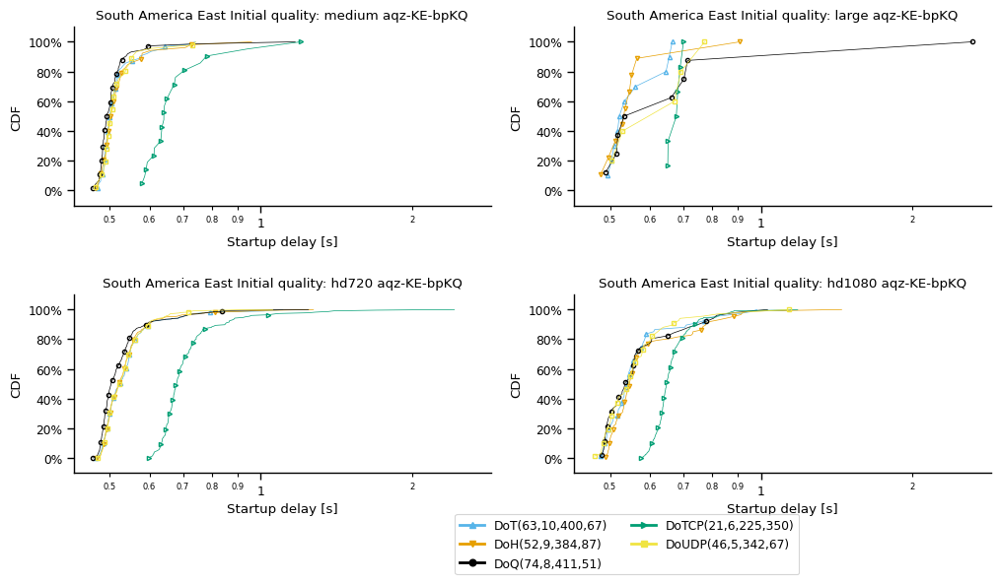

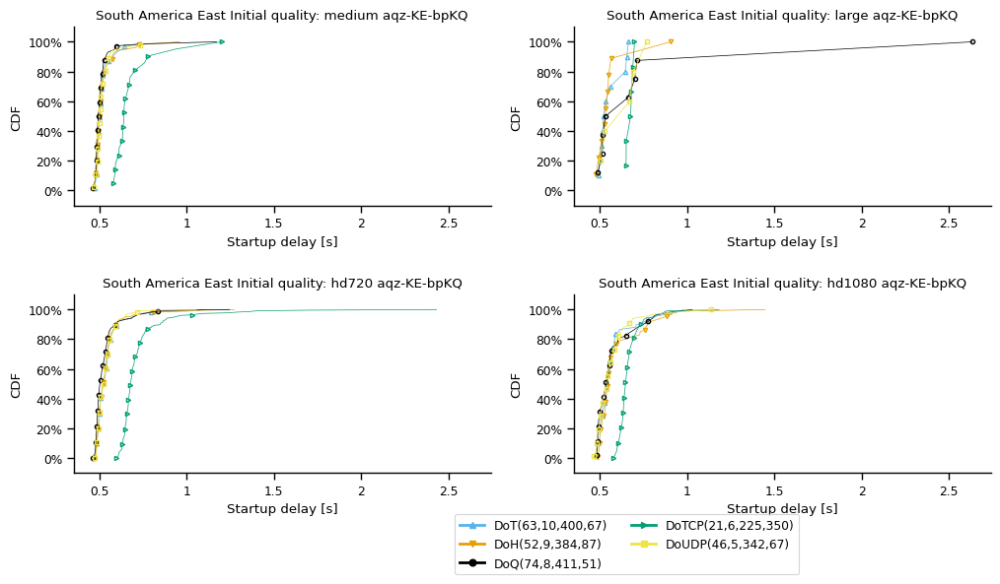

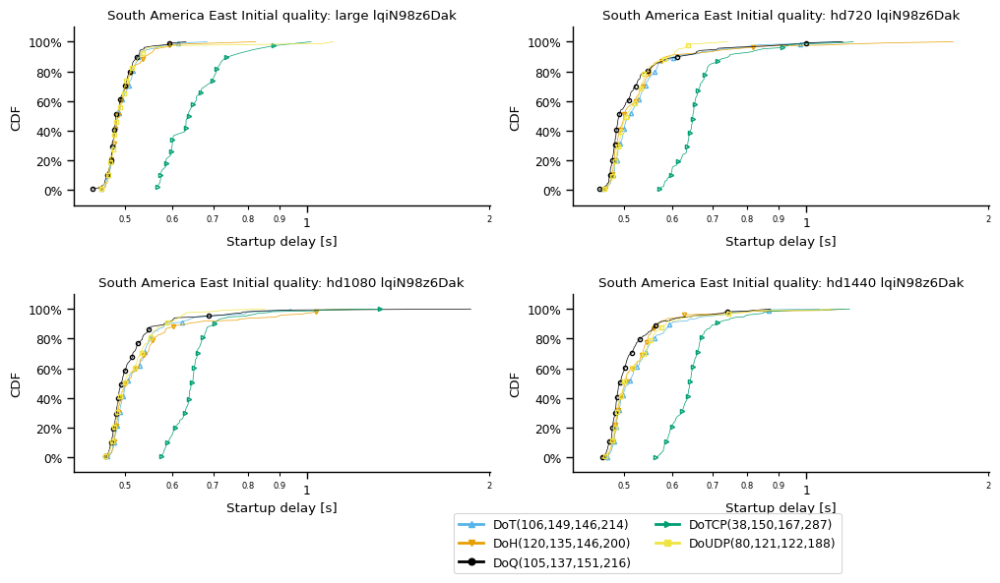

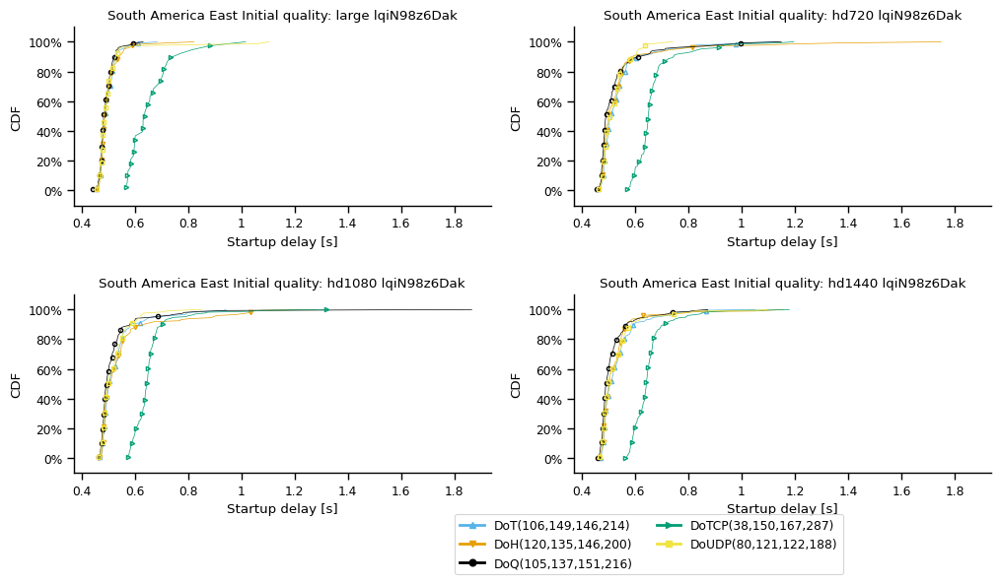

US East


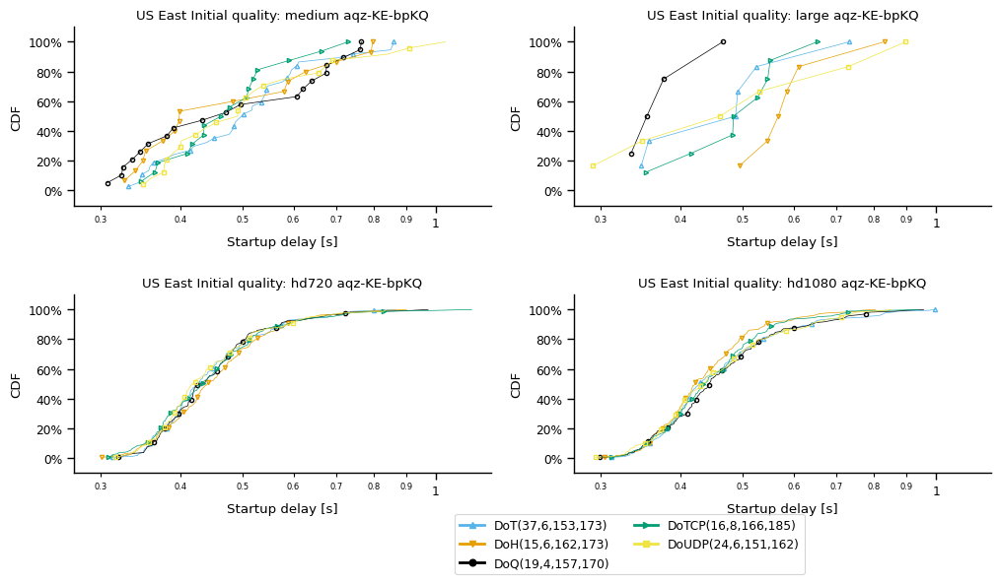

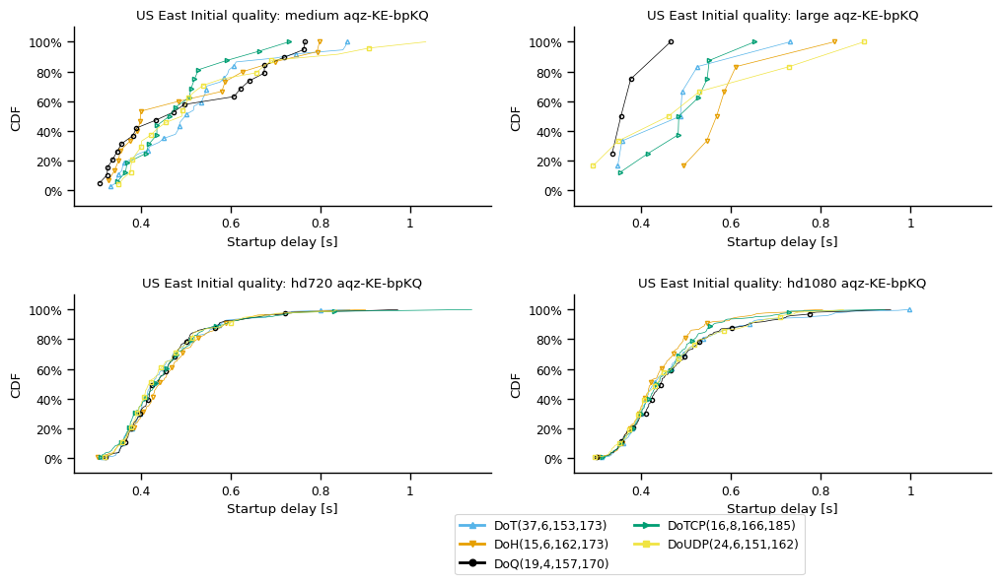

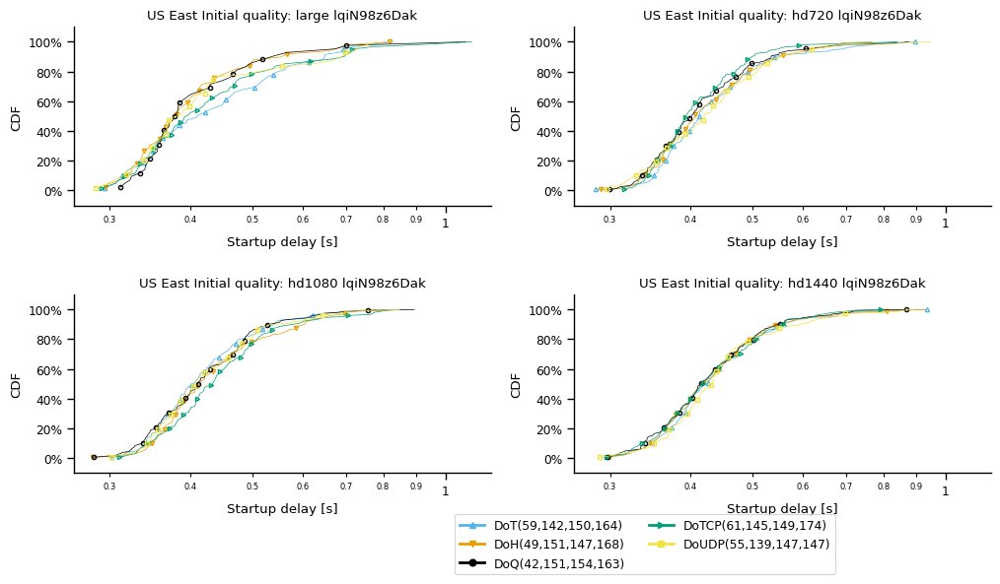

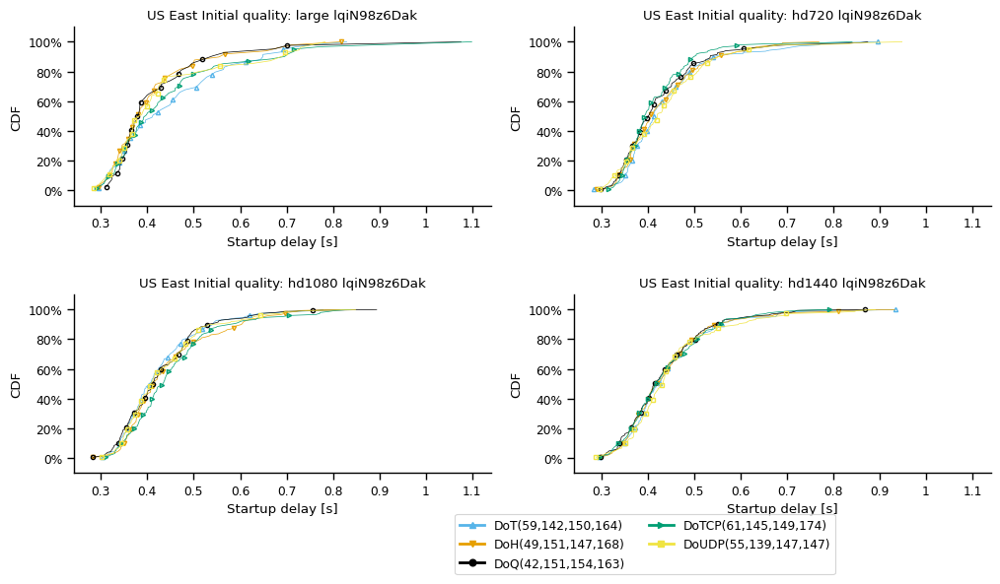

US West


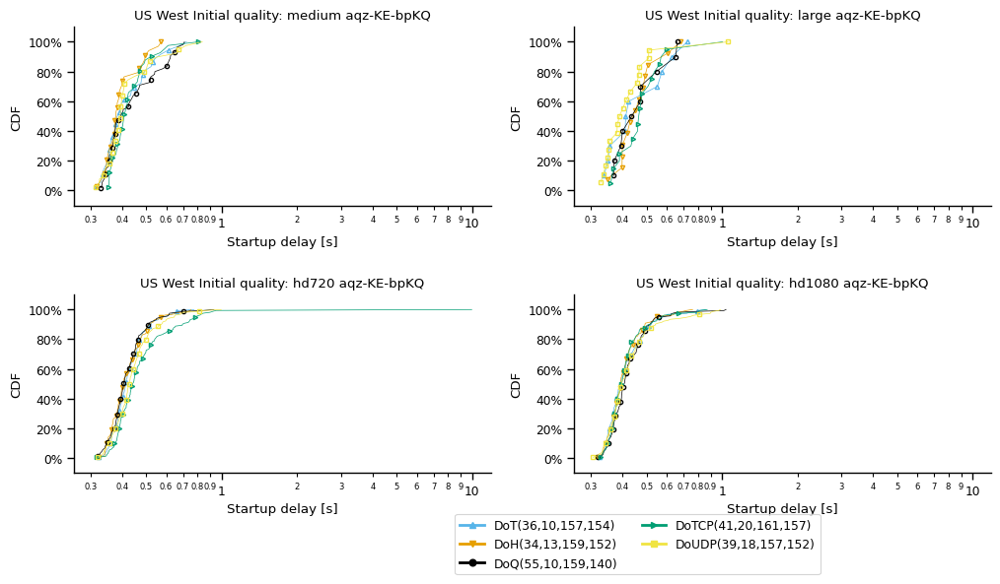

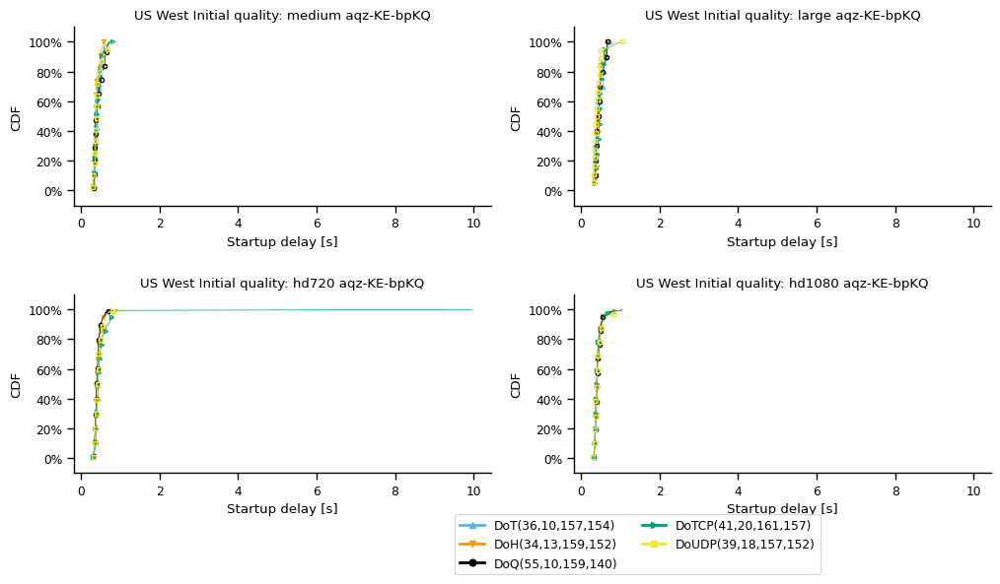

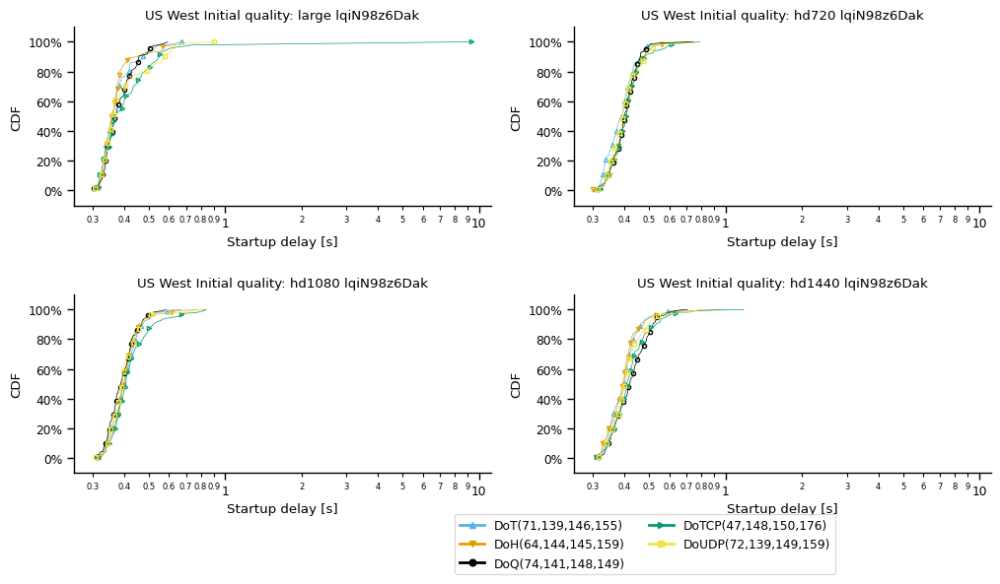

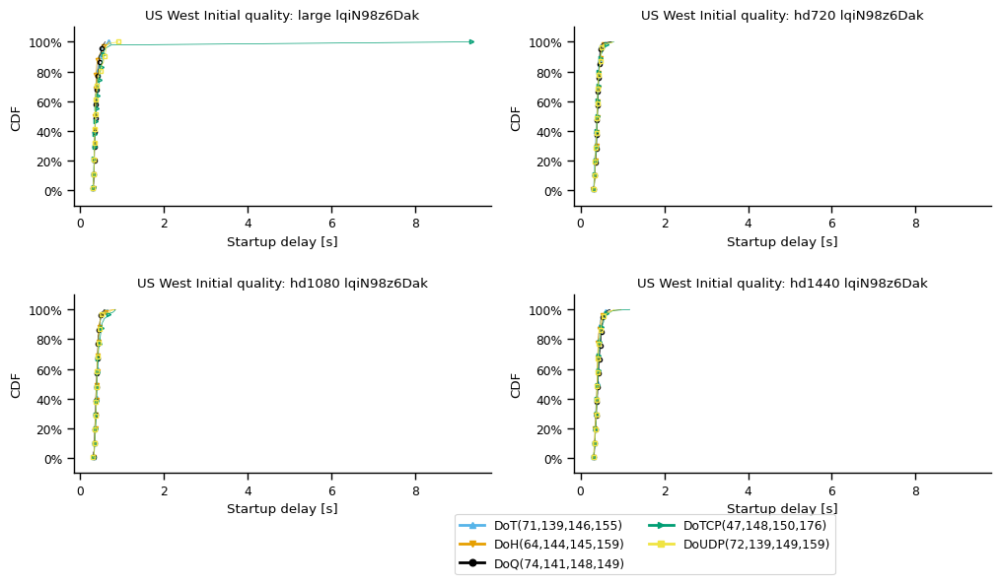

all vantage points


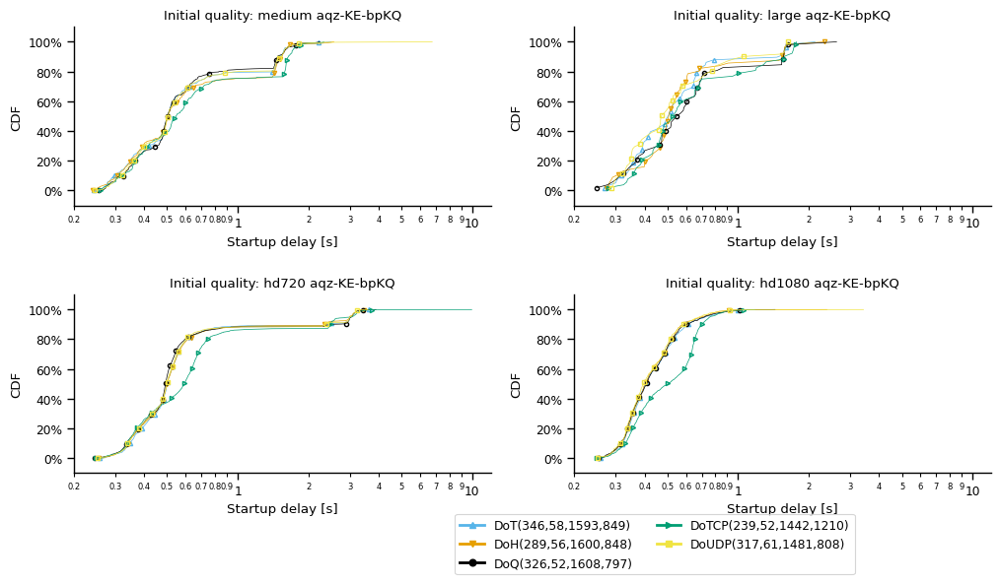

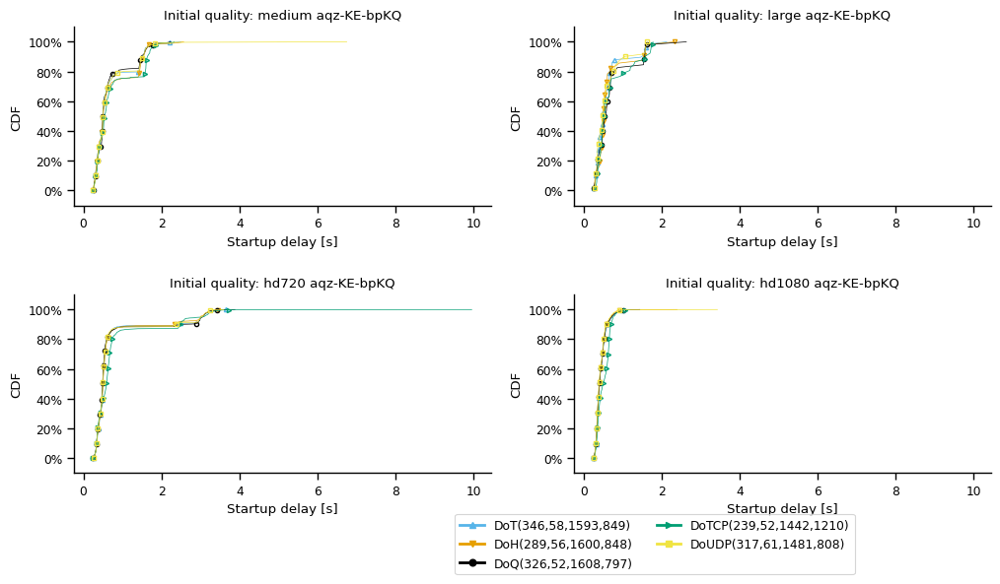

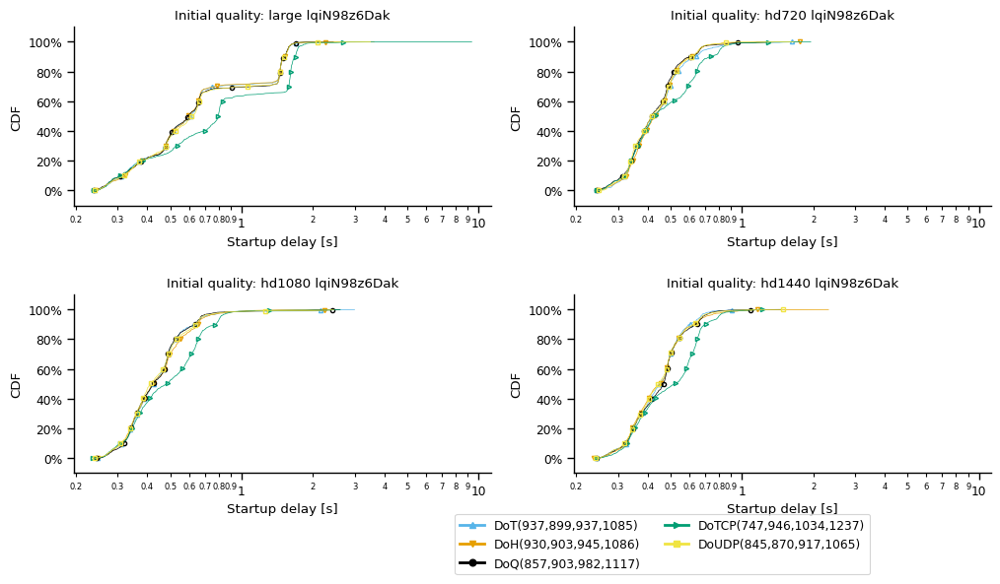

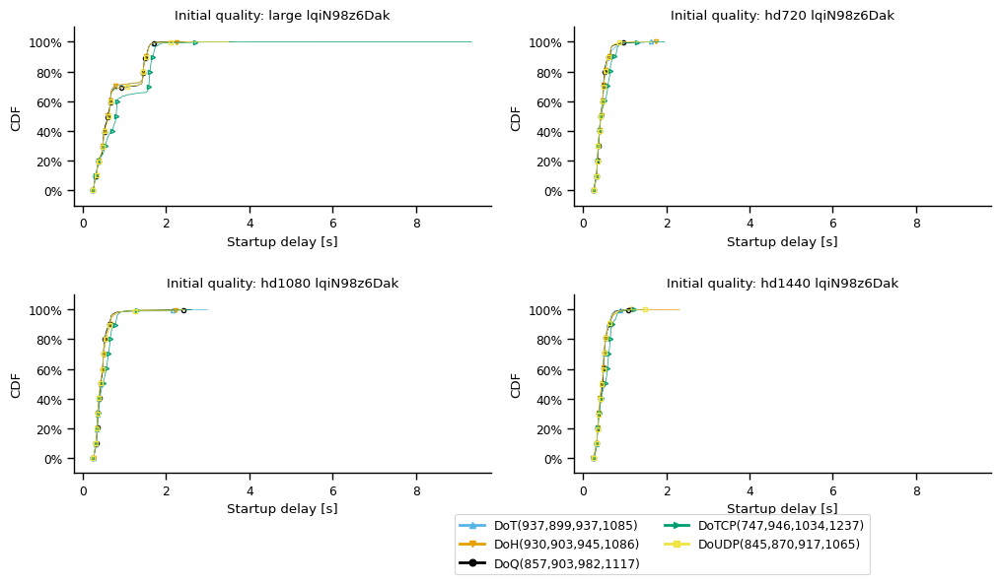

In [524]:
draw_cdf_grid(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0.1,1])

In [525]:
df_player_quality_change_event_to_opt.groupby(['vantagePoint','optimal_res', 'domain']).agg({'msm_id':pd.Series.nunique})

msm_id
vantagePoint           optimal_res domain             
Africa South           1280x720    aqz-KE-bpKQ     321
                                   lqiN98z6Dak     775
                       1920x1080   aqz-KE-bpKQ     319
                                   lqiN98z6Dak     764
                       2560x1440   aqz-KE-bpKQ     317
                                   lqiN98z6Dak     708
                       3840x2160   aqz-KE-bpKQ     305
                                   lqiN98z6Dak     714
Asia Pacific Northeast 1280x720    aqz-KE-bpKQ     813
                                   lqiN98z6Dak     815
                       1920x1080   aqz-KE-bpKQ     813
                                   lqiN98z6Dak     813
                       2560x1440   aqz-KE-bpKQ     812
                                   lqiN98z6Dak     812
                       3840x2160   aqz-KE-bpKQ     717
                                   lqiN98z6Dak     813
Asia Pacific Southeast 1280x720    aqz-KE-bpKQ     795
                                   lqiN98z6Dak     799
                       1920x1080   aqz-KE-bpKQ     801
                                   lqiN98z6Dak     793
                       2560x1440   aqz-KE-bpKQ     790
                                   lqiN98z6Dak     800
                       3840x2160   aqz-KE-bpKQ     766
                                   lqiN98z6Dak     802
Europe Central         1280x720    aqz-KE-bpKQ     811
                                   lqiN98z6Dak     814
                       1920x1080   aqz-KE-bpKQ     810
                                   lqiN98z6Dak     814
                       2560x1440   aqz-KE-bpKQ     811
                                   lqiN98z6Dak     812
                       3840x2160   aqz-KE-bpKQ     800
                                   lqiN98z6Dak     811
South America East     1280x720    aqz-KE-bpKQ     791
                                   lqiN98z6Dak     786
                       1920x1080   aqz-KE-bpKQ     788
                                   lqiN98z6Dak     778
                       2560x1440   aqz-KE-bpKQ     780
                                   lqiN98z6Dak     792
                       3840x2160   aqz-KE-bpKQ     768
                                   lqiN98z6Dak     780
US East                1280x720    aqz-KE-bpKQ     802
                                   lqiN98z6Dak     806
                       1920x1080   aqz-KE-bpKQ     807
                                   lqiN98z6Dak     800
                       2560x1440   aqz-KE-bpKQ     805
                                   lqiN98z6Dak     804
                       3840x2160   aqz-KE-bpKQ     686
                                   lqiN98z6Dak     807
US West                1280x720    aqz-KE-bpKQ     811
                                   lqiN98z6Dak     814
                       1920x1080   aqz-KE-bpKQ     815
                                   lqiN98z6Dak     813
                       2560x1440   aqz-KE-bpKQ     809
                                   lqiN98z6Dak     808
                       3840x2160   aqz-KE-bpKQ     755
                                   lqiN98z6Dak     812

Africa South


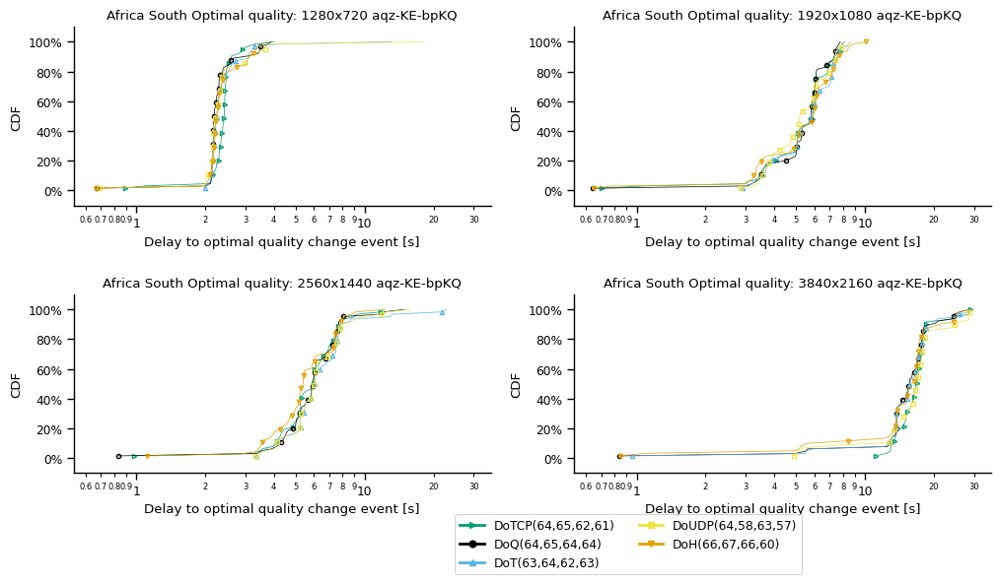

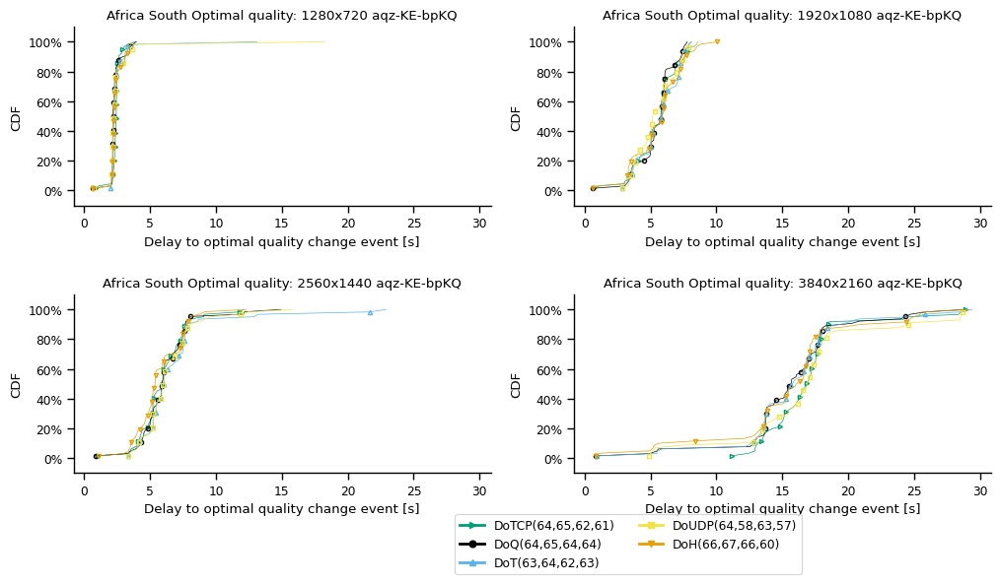

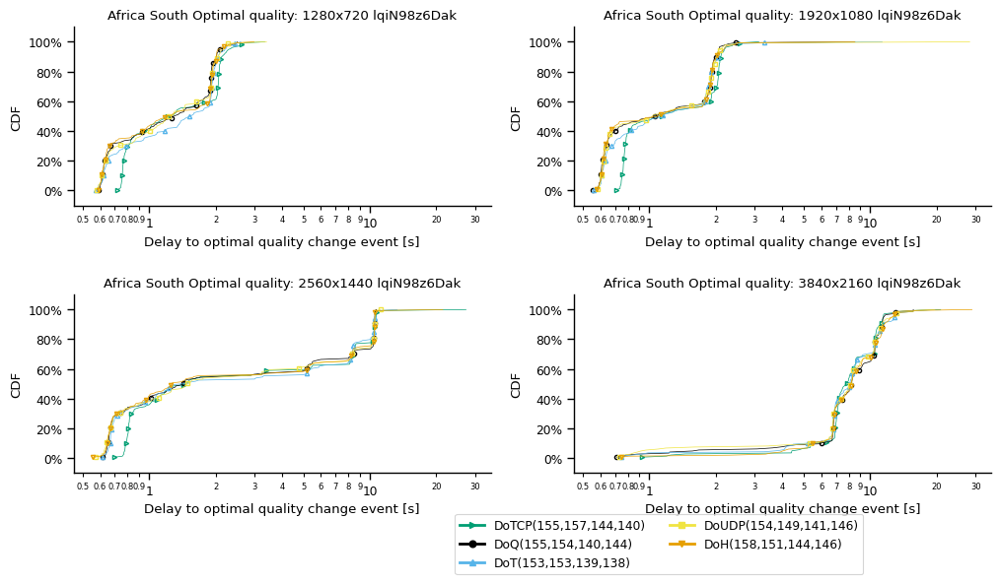

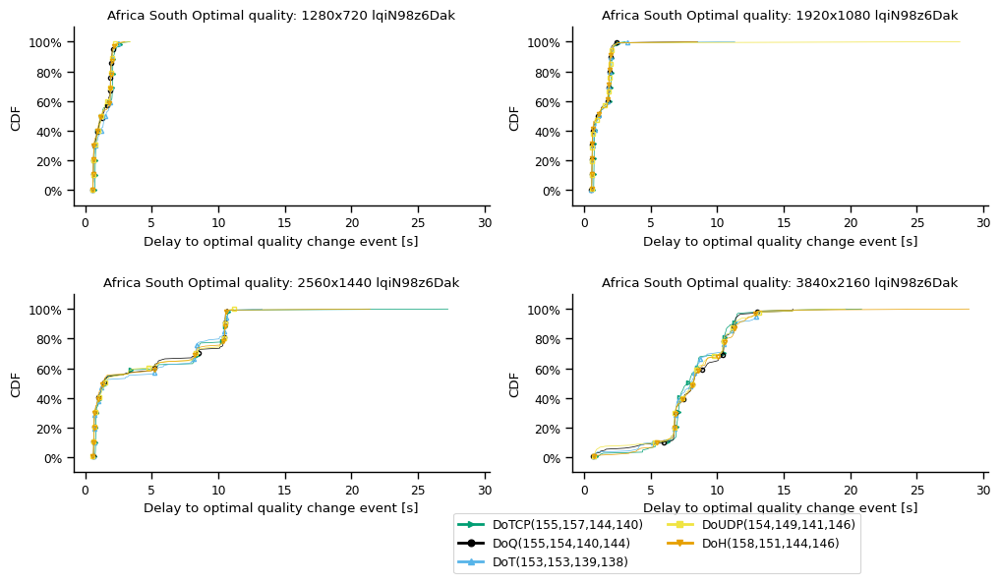

Asia Pacific Northeast


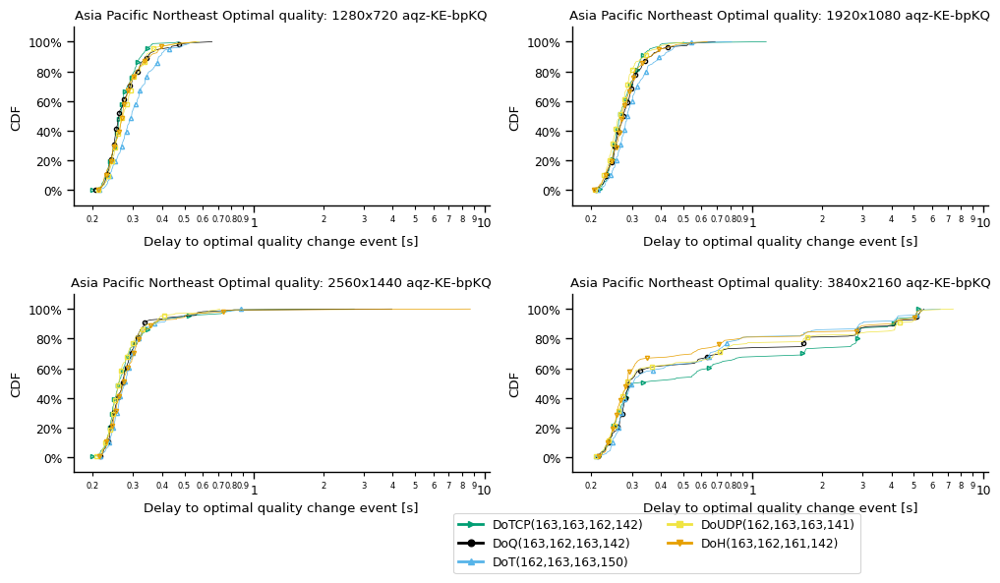

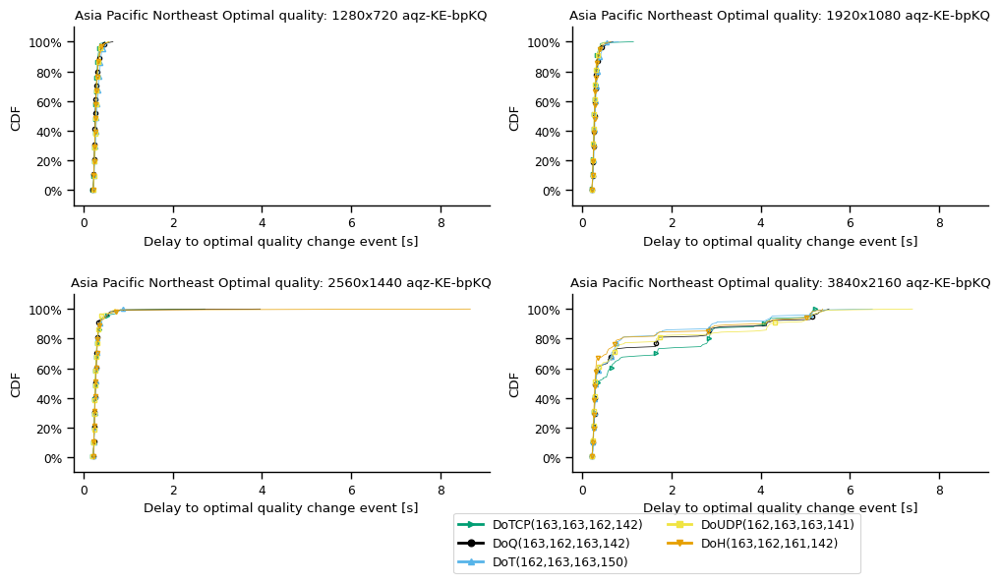

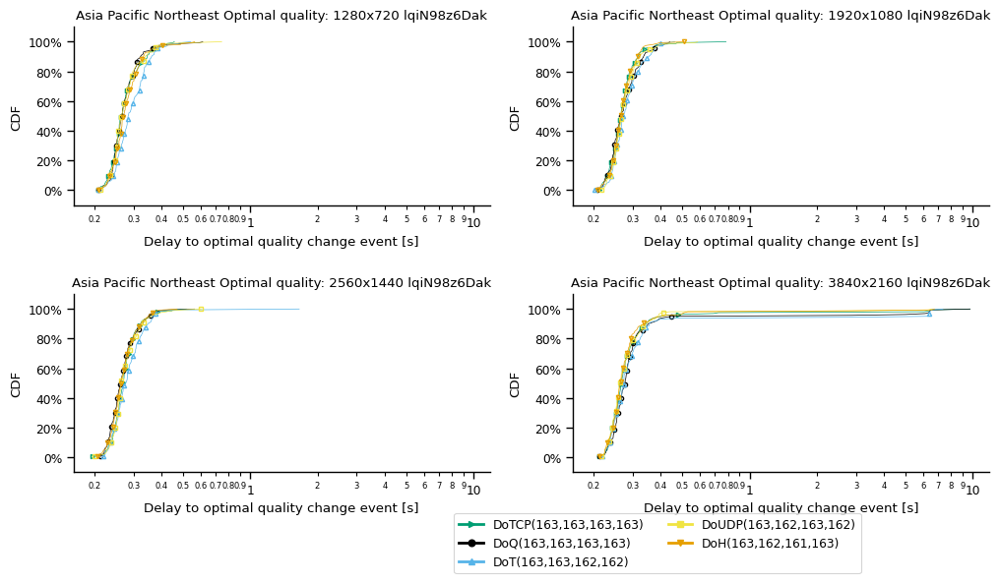

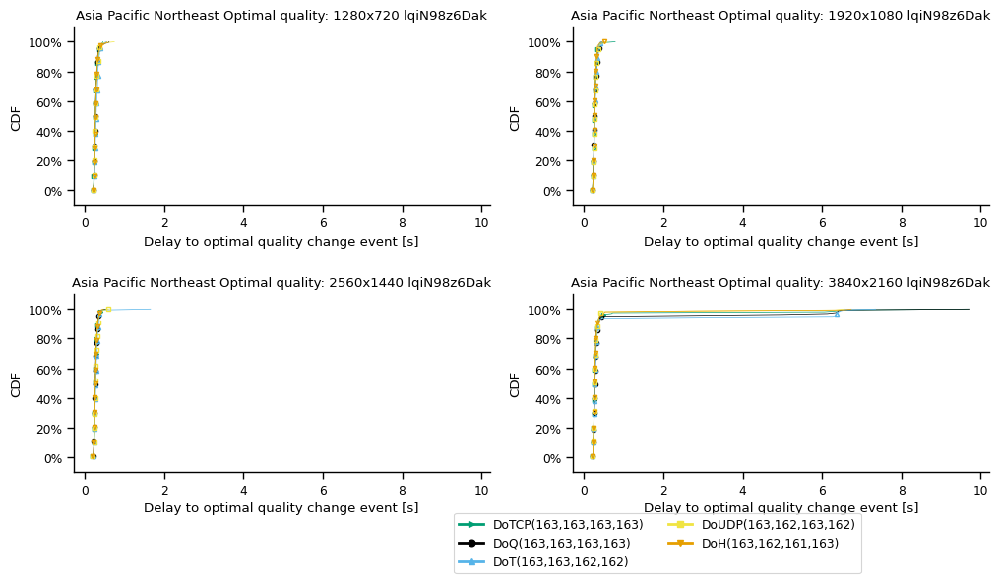

Asia Pacific Southeast


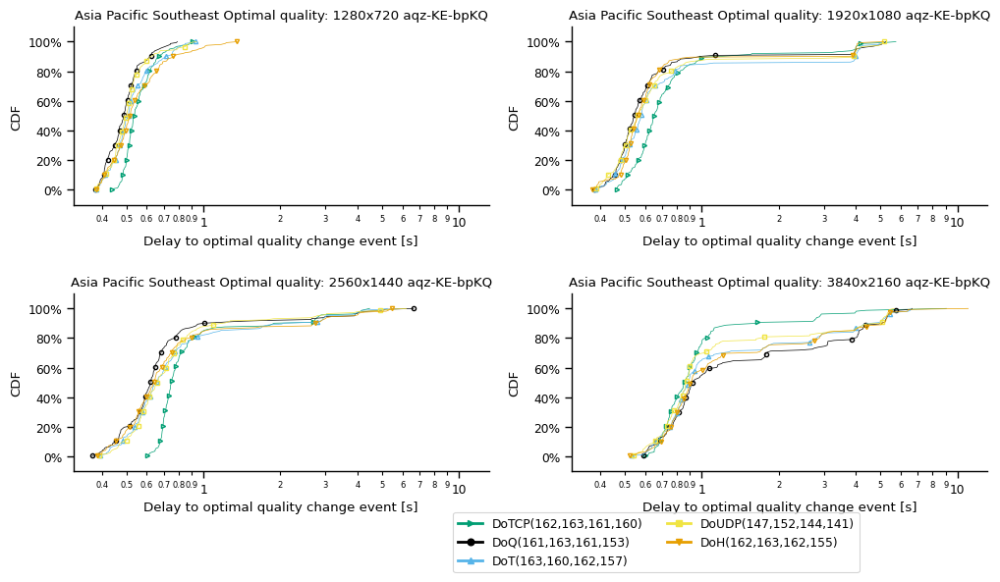

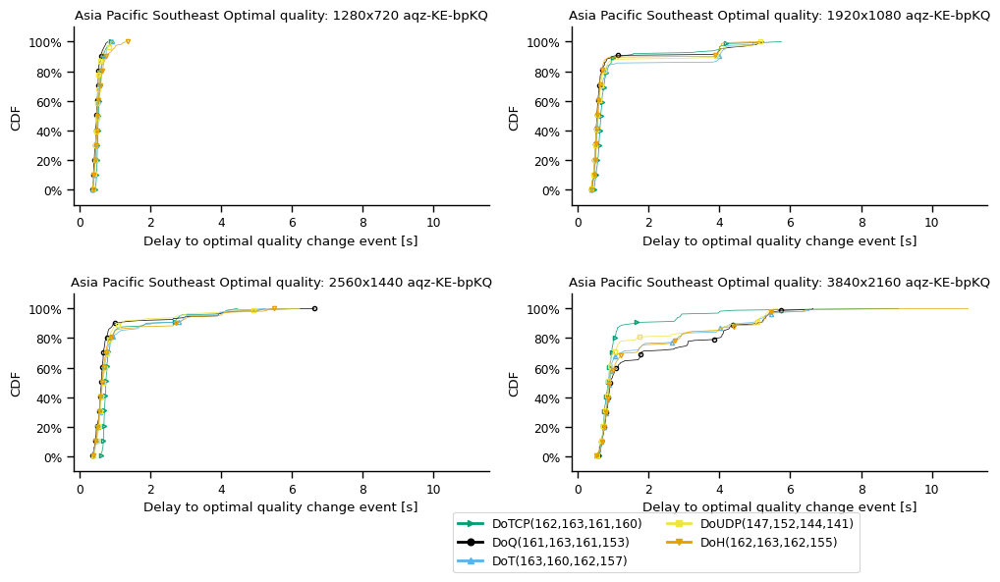

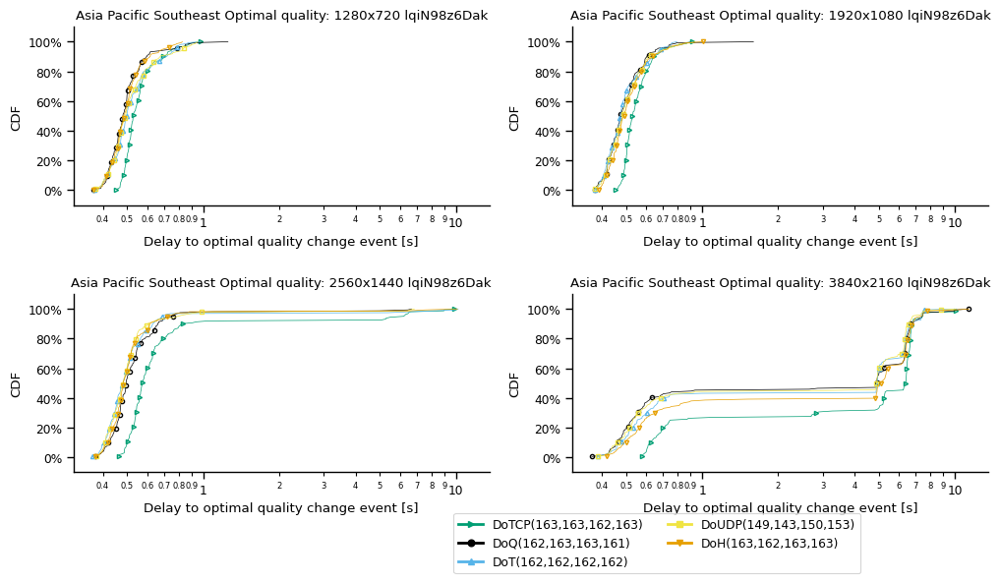

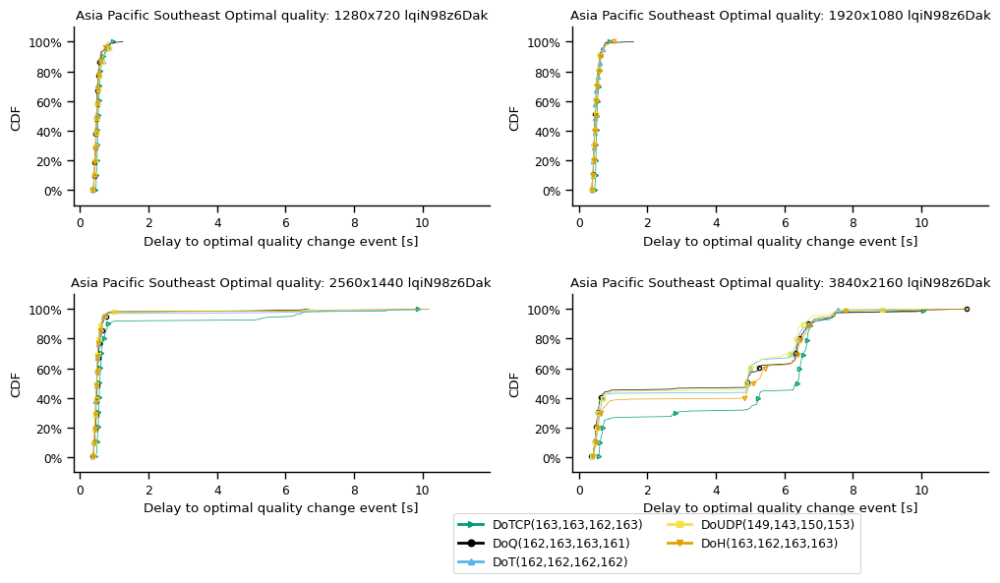

Europe Central


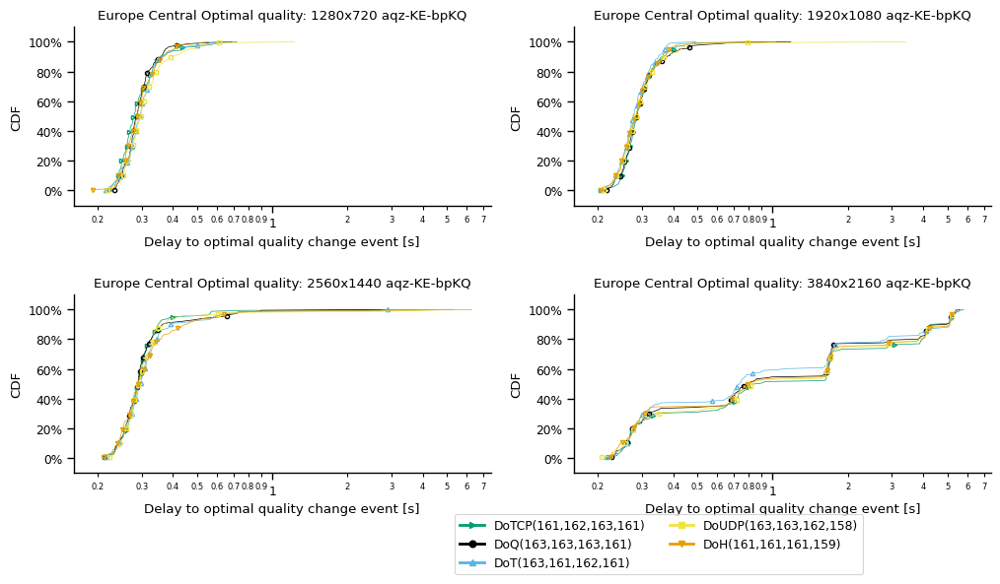

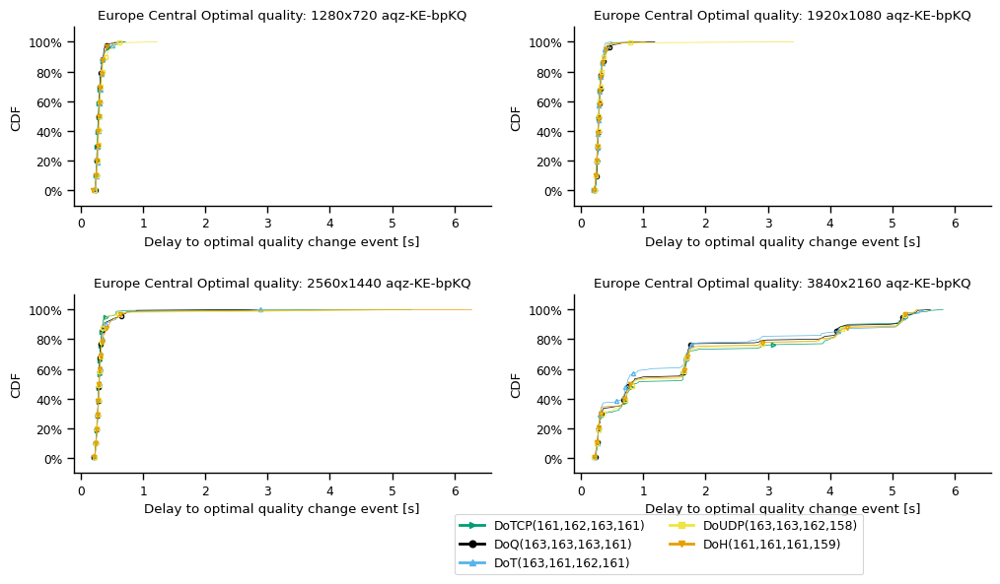

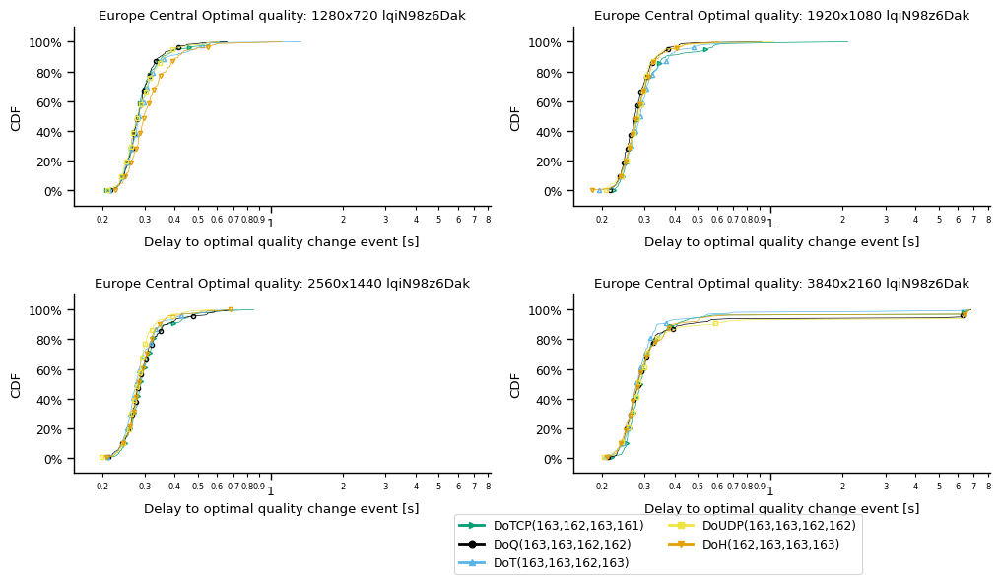

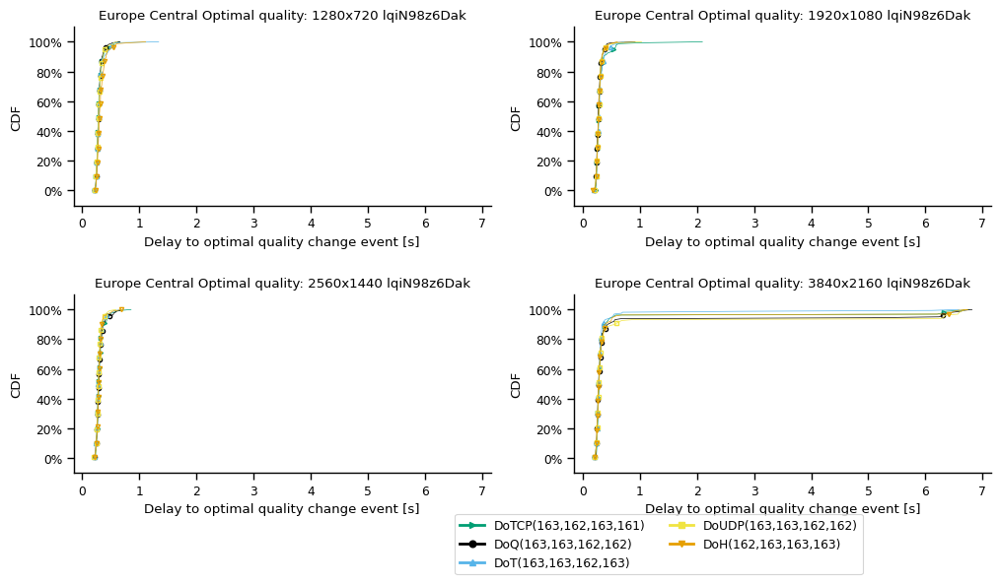

South America East


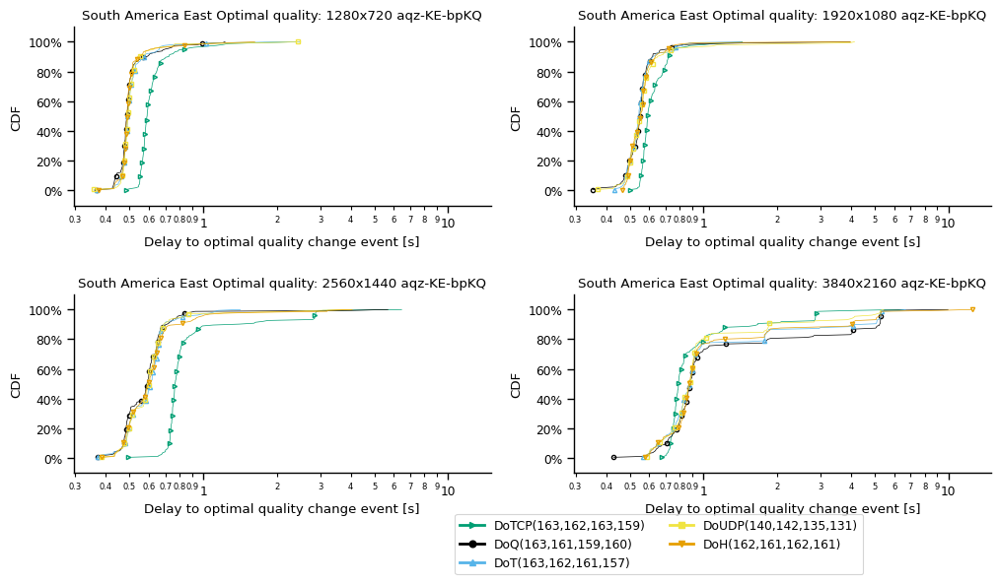

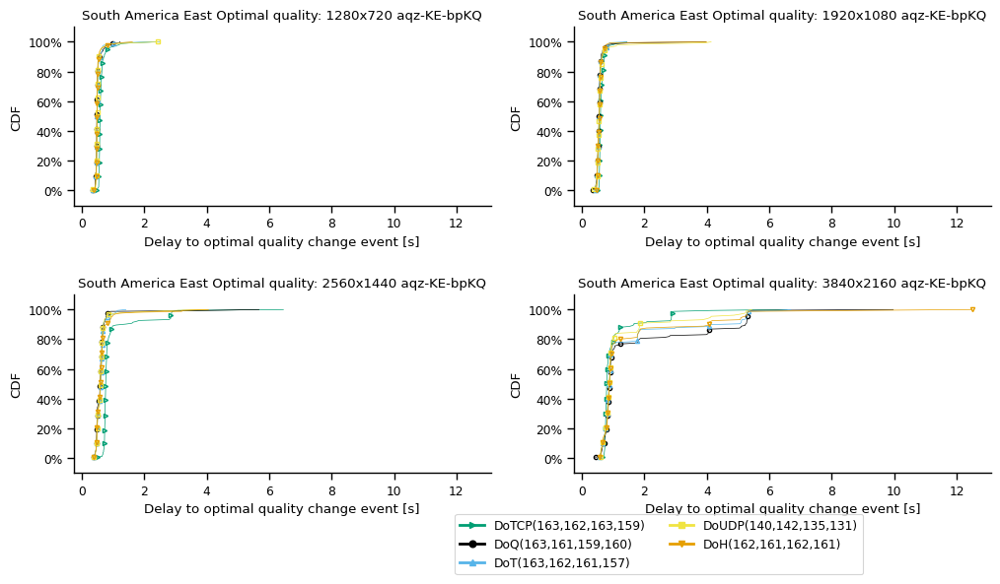

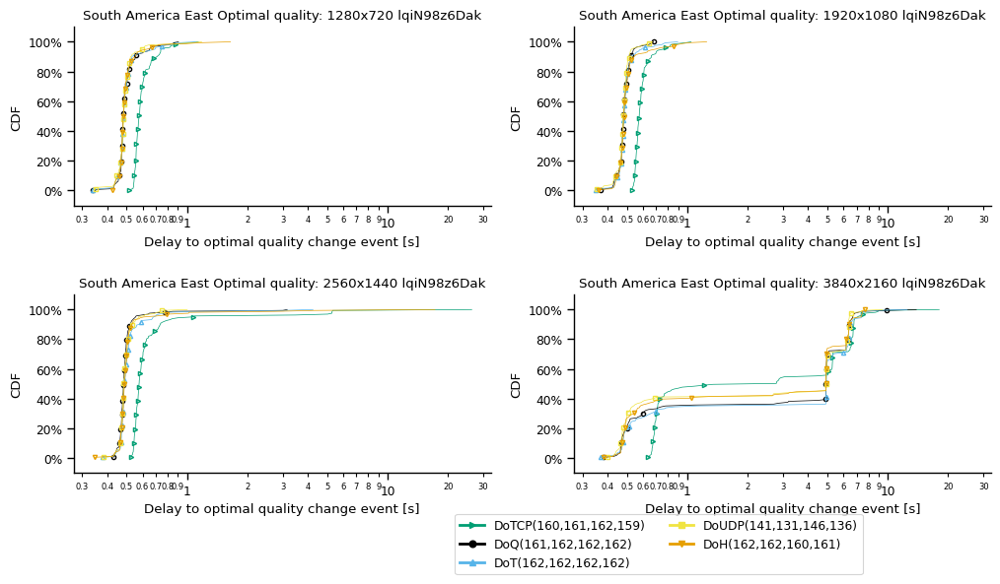

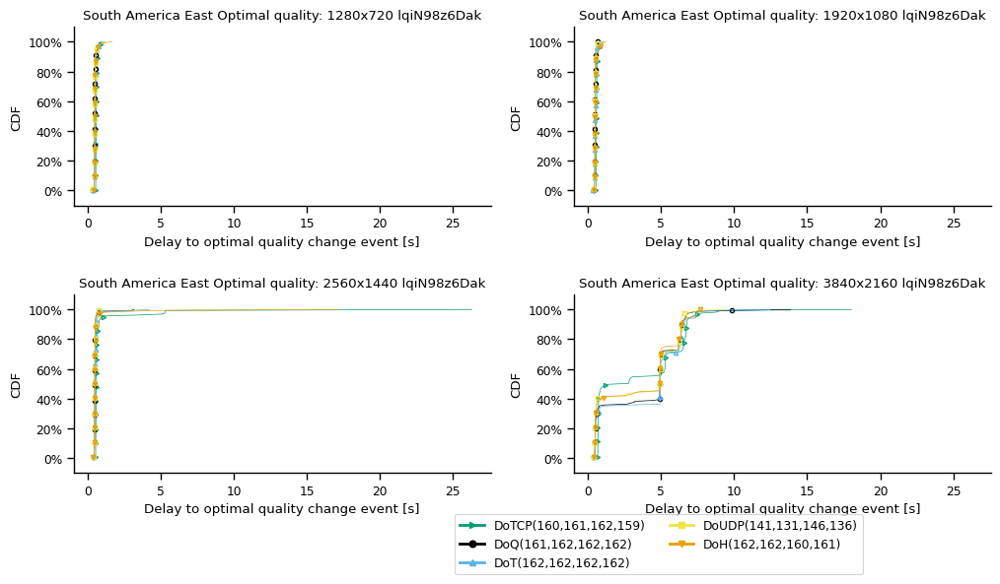

US East


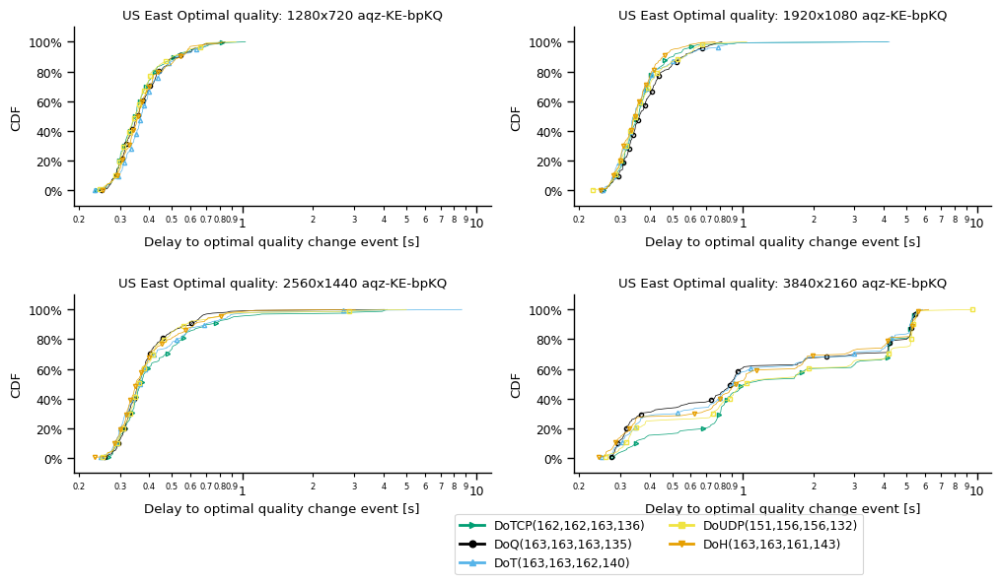

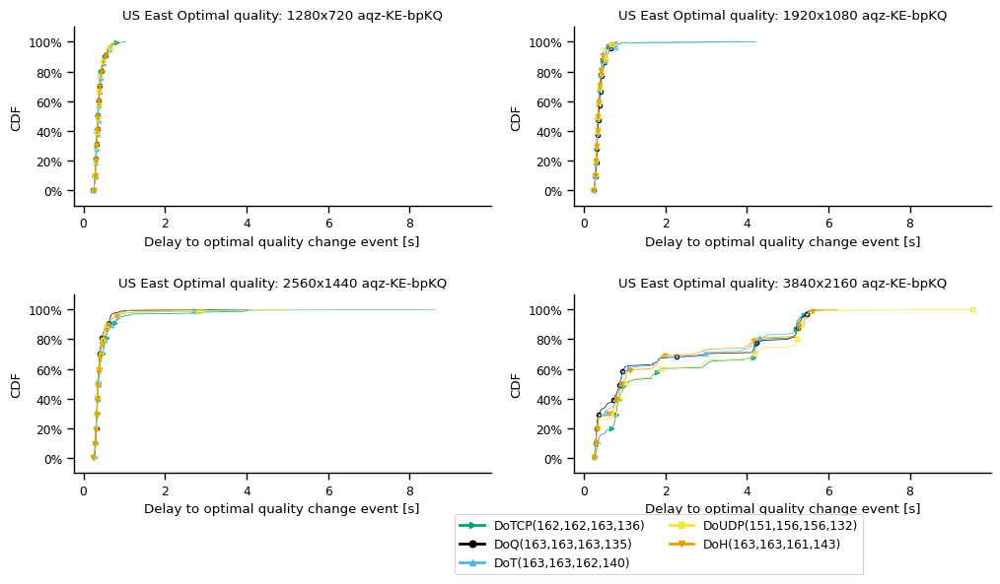

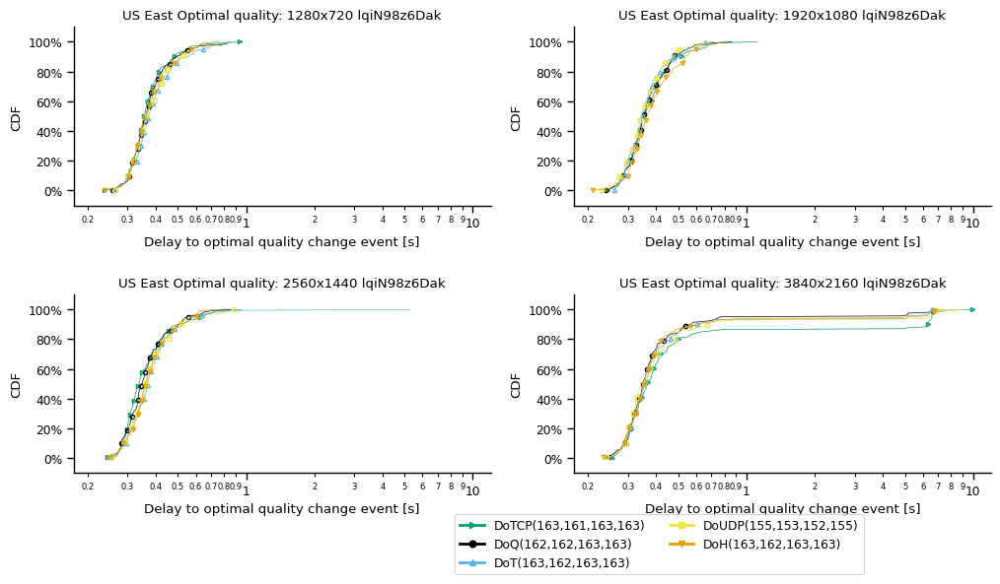

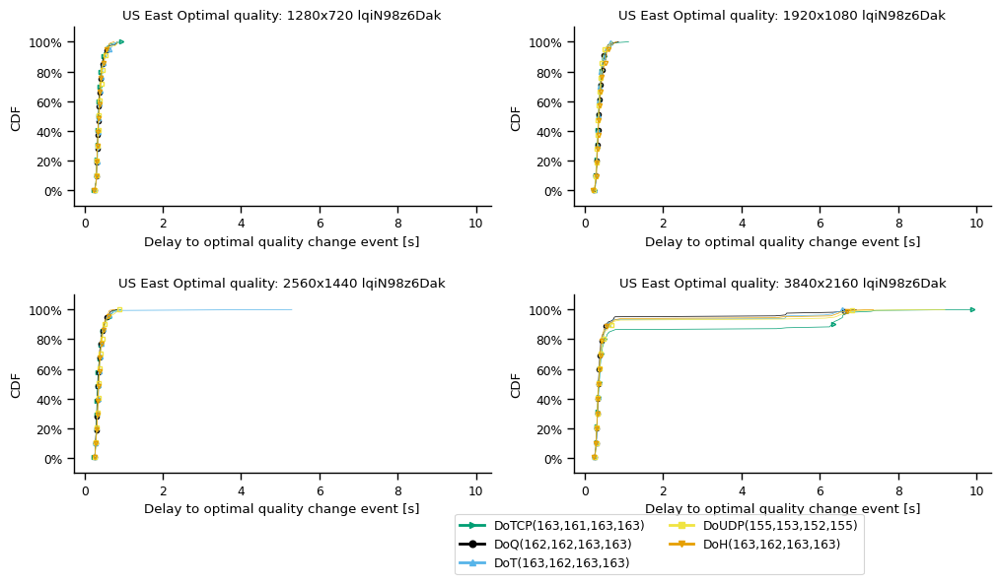

US West


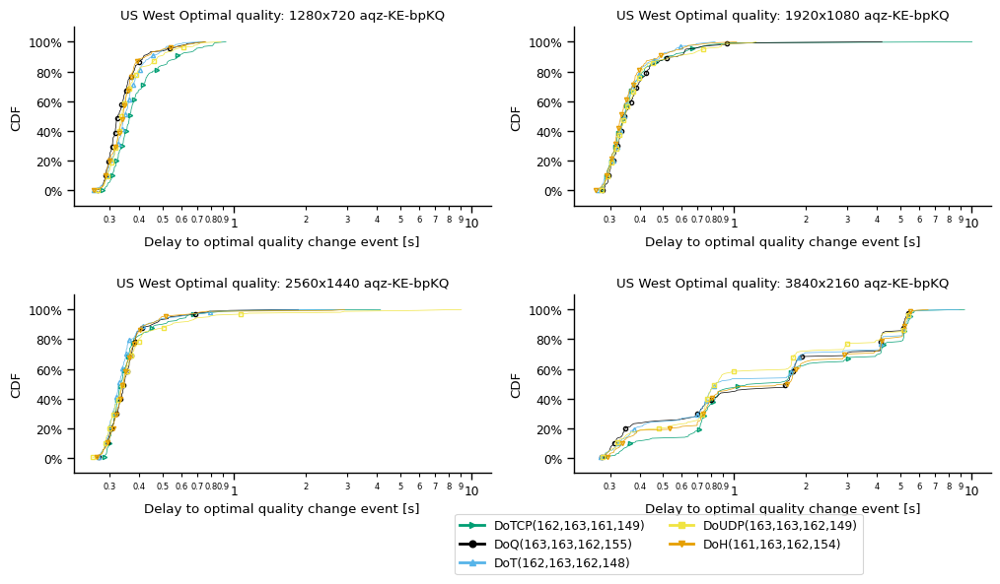

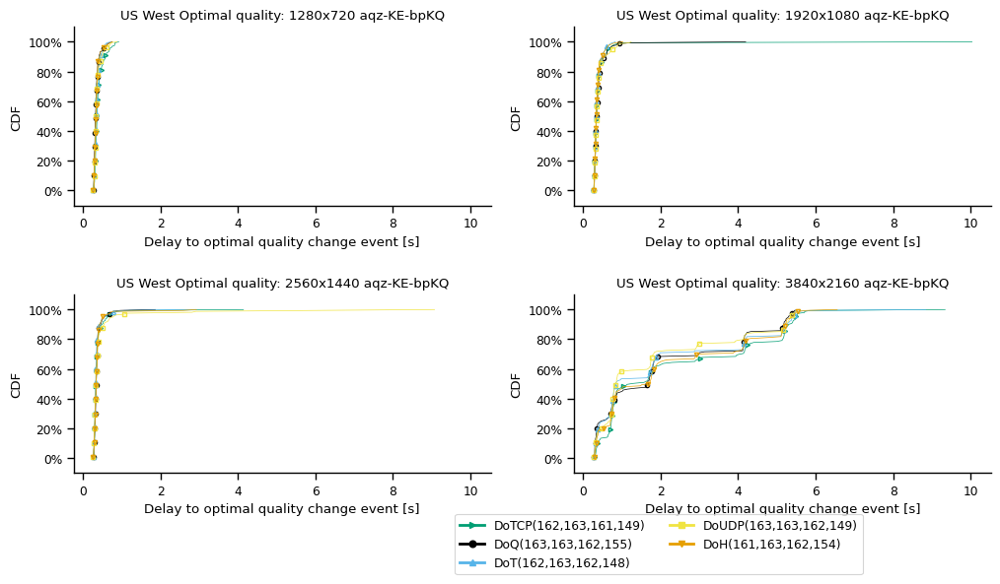

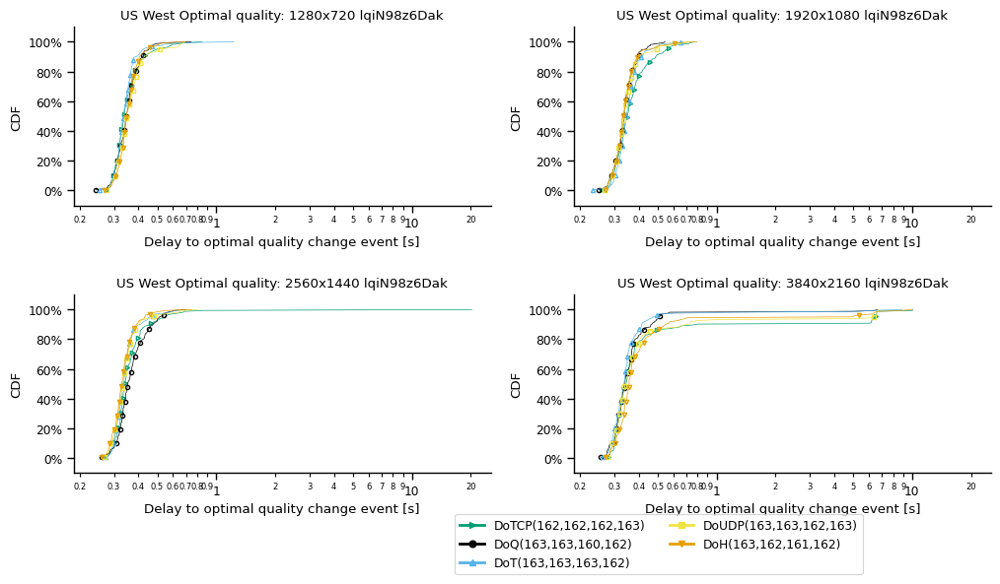

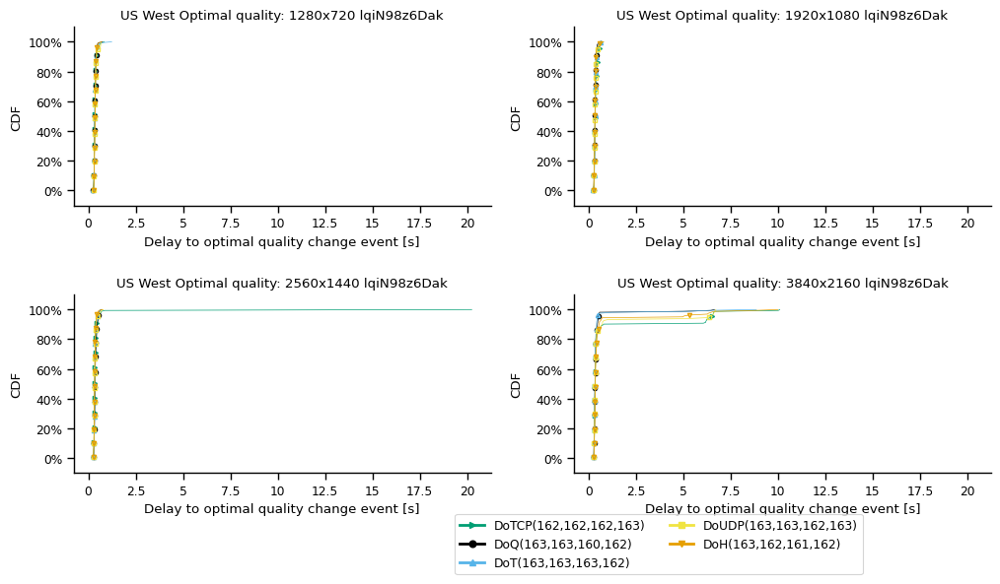

all vantage points


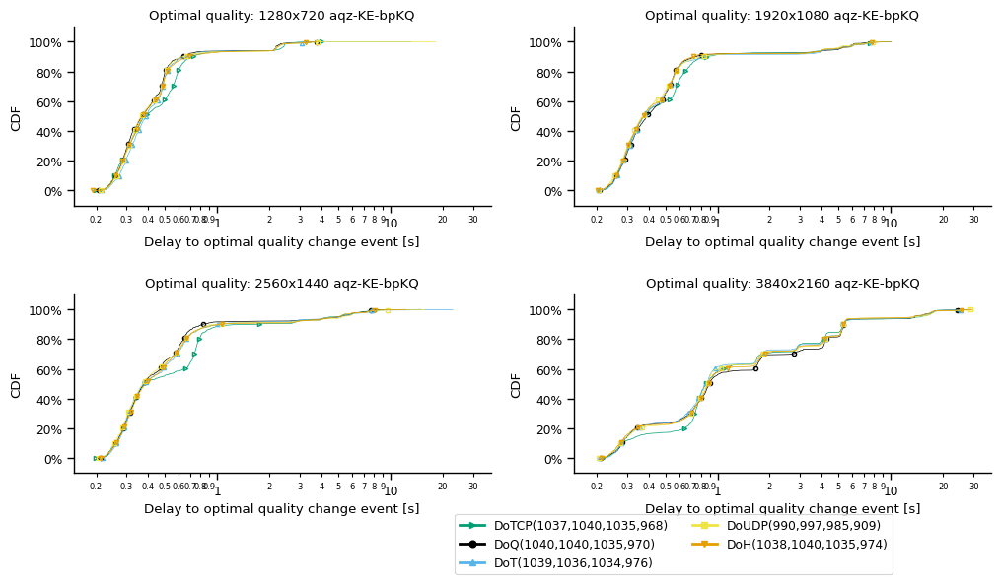

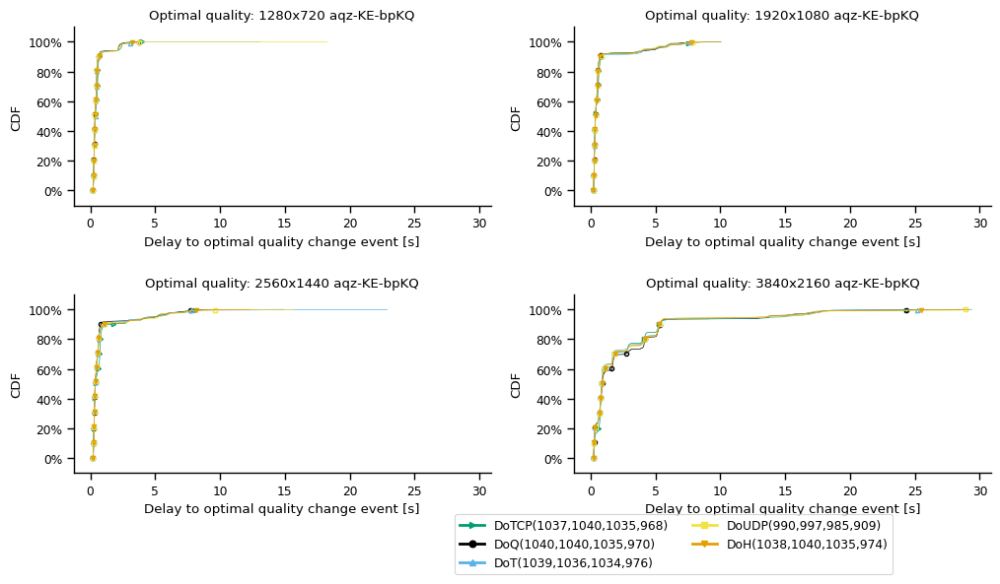

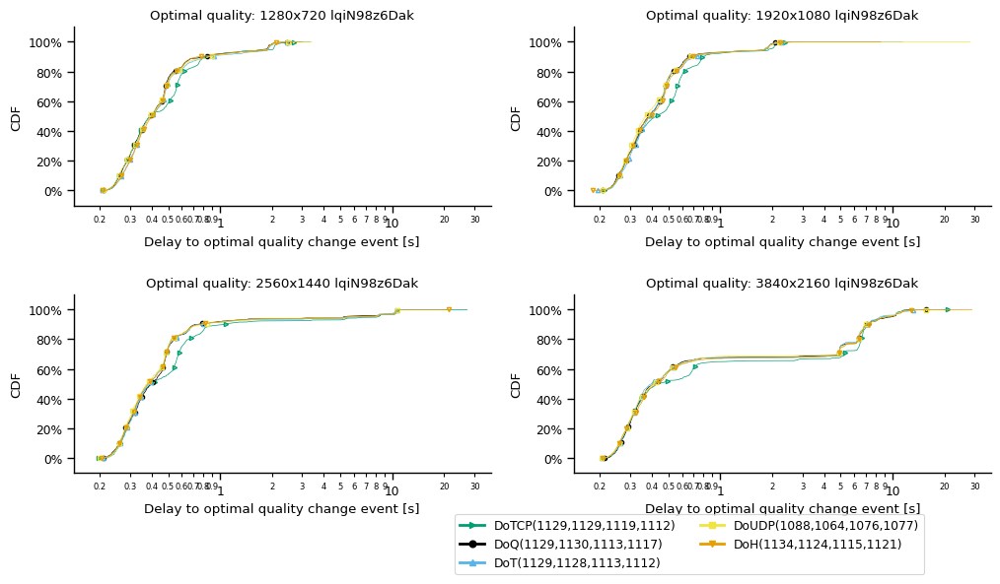

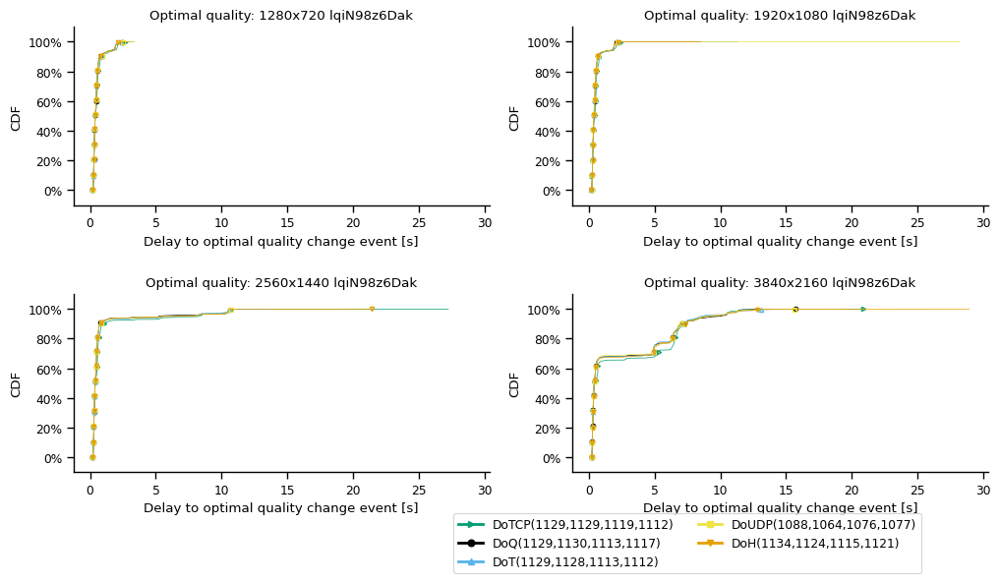

In [526]:
draw_cdf_grid(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True,False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True,False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0])

In [527]:
def draw_boxplot_grid(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, ylabel, showmean=True, draw_all=False):
    proto_order=['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    if col_name_ == 'protocol':
        y_order = proto_order
    else:
        y_order = sorted(df_[col_name_].unique().tolist())
    with plt.style.context('seaborn-whitegrid'):
        for vp in sorted(df_['vantagePoint'].unique().tolist()):
            print(vp)
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    num_rows = math.ceil(df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                    if col_outer_groupby_ == 'true_initial_quality':
                        num_rows = 2
                    if df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                        fig, axs = plt.subplots(num_rows, 2, sharex='all', figsize=(12,6*num_rows))#, sharey='all')
                        fig.subplots_adjust(hspace=.2, wspace=.3)
                        #turn off all axis before plotting, then only turn back on the ones we plot in
                        #https://stackoverflow.com/a/66799199
                        for ax in axs.flat:
                            ax.set_axis_off()
                        col_outer_groupby_values = df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                        #if col_outer_groupby_ == 'true_initial_quality':
                        #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                        for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        #for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                            ax.set_axis_on()
                            lnwidth = .5
                            mrksize = 3
                            df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                            #hue=
                            
                            boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                            showfliers=False, order=y_order,
                            color='white',
                            meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                            #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                            
                            if log:
                                ax.set_xscale('log')
                            
                            
                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel(ylabel)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)

                            ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                            ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                        plt.show()
        if draw_all:
            print('all vantage points')
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    num_rows = math.ceil(df_[(df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                    if col_outer_groupby_ == 'true_initial_quality':
                        num_rows = 2
                    if df_[(df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                        fig, axs = plt.subplots(num_rows, 2, sharex='all', figsize=(12,6*num_rows))#, sharey='all')
                        fig.subplots_adjust(hspace=.2, wspace=.3)
                        #turn off all axis before plotting, then only turn back on the ones we plot in
                        #https://stackoverflow.com/a/66799199
                        for ax in axs.flat:
                            ax.set_axis_off()
                        col_outer_groupby_values = df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                        #if col_outer_groupby_ == 'true_initial_quality':
                        #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                        for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        #for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                            ax.set_axis_on()
                            lnwidth = .5
                            mrksize = 3
                            df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                            #hue=
                            
                            boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                            showfliers=False, order=y_order,
                            color='white',
                            meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                            #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                            
                            if log:
                                ax.set_xscale('log')
                            
                            
                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel(ylabel)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)

                            ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                            ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                        plt.show()

In [528]:
def draw_boxplot(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, ylabel, showmean=True, draw_all=False):
    proto_order=['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    if col_name_ == 'protocol':
        y_order = proto_order
    else:
        y_order = sorted(df_[col_name_].unique().tolist())
    with plt.style.context('seaborn-whitegrid'):
        for vp in sorted(df_['vantagePoint'].unique().tolist()):
            print(vp)
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                        fig, ax = plt.subplots(figsize=(6,8))
                        #hue=
                        boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                        showfliers=False, order=y_order,
                        color='white',
                        meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                        #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                        
                        if log:
                            ax.set_xscale('log')
                        
                        
                        ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                        #ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))


                        ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                        ax.set_xlabel(xlabel)

                        ax.set_ylabel(ylabel)
                        if xlim != [0,0]:
                            ax.set_xlim(xlim)

                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                        ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                        #plt.show()
        if draw_all:
            print('all vantage points')
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                        fig, ax = plt.subplots(figsize=(6,8))
                        #hue=
                        boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                        showfliers=False, order=y_order,
                        color='white',
                        meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                        #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                        
                        if log:
                            ax.set_xscale('log')
                        
                        
                        ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                        #ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))


                        ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                        ax.set_xlabel(xlabel)

                        ax.set_ylabel(ylabel)
                        if xlim != [0,0]:
                            ax.set_xlim(xlim)

                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                        ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                        #plt.show()

Africa South
Asia Pacific Northeast


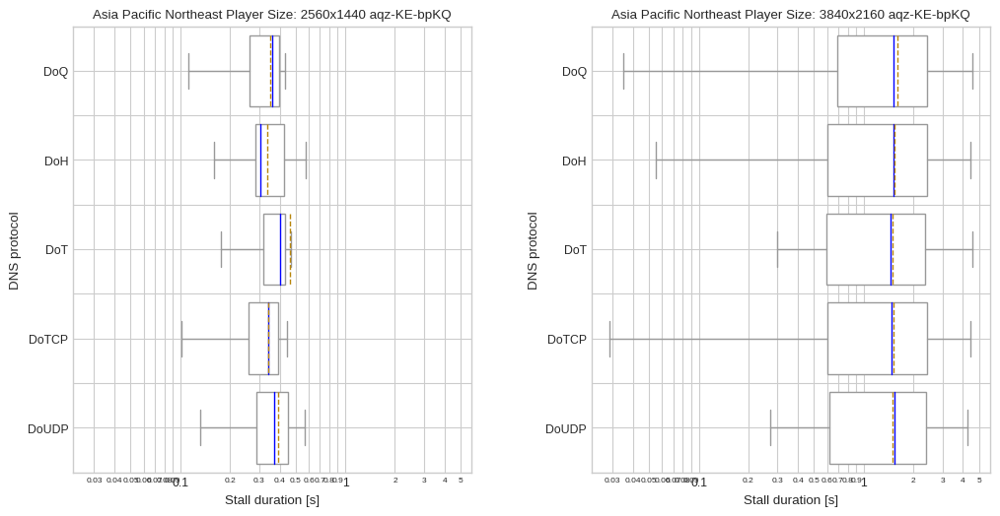

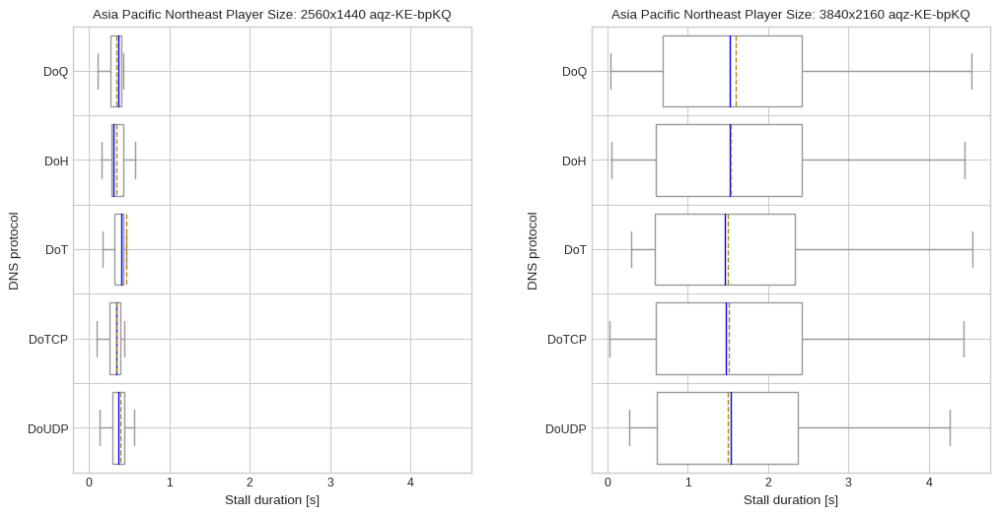

Asia Pacific Southeast


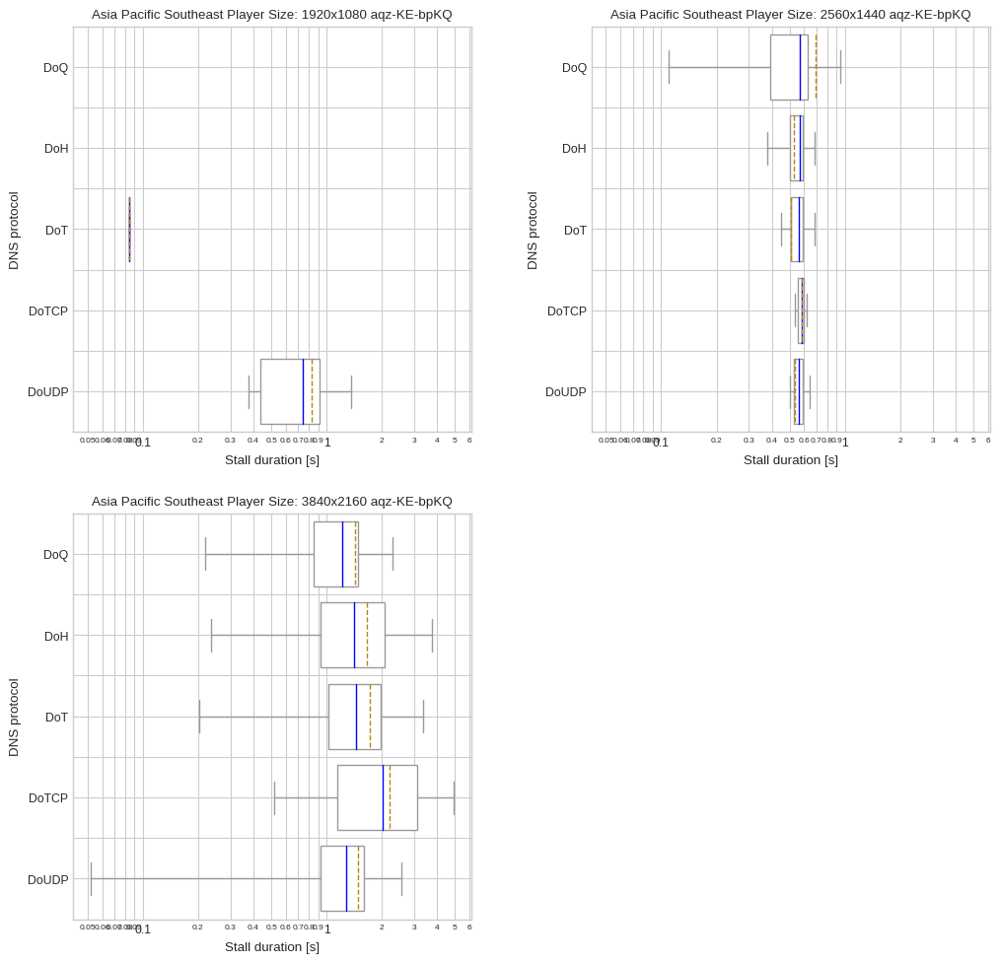

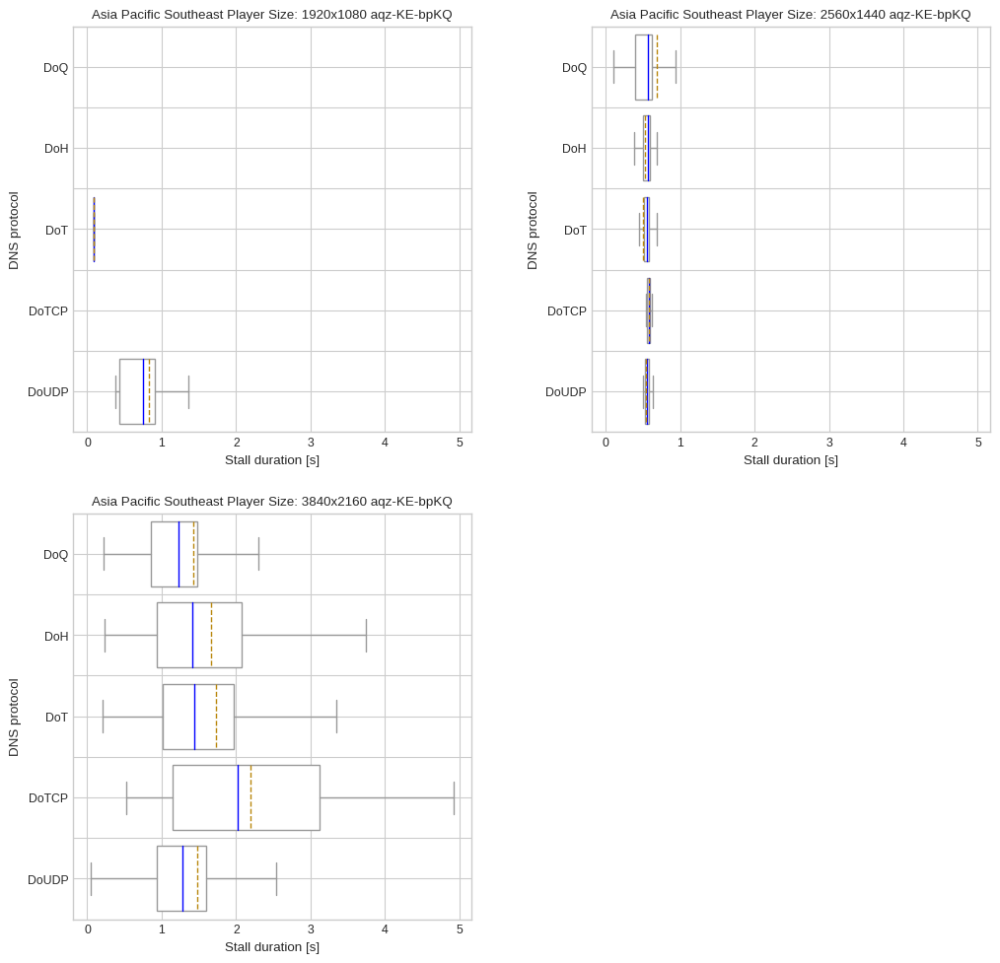

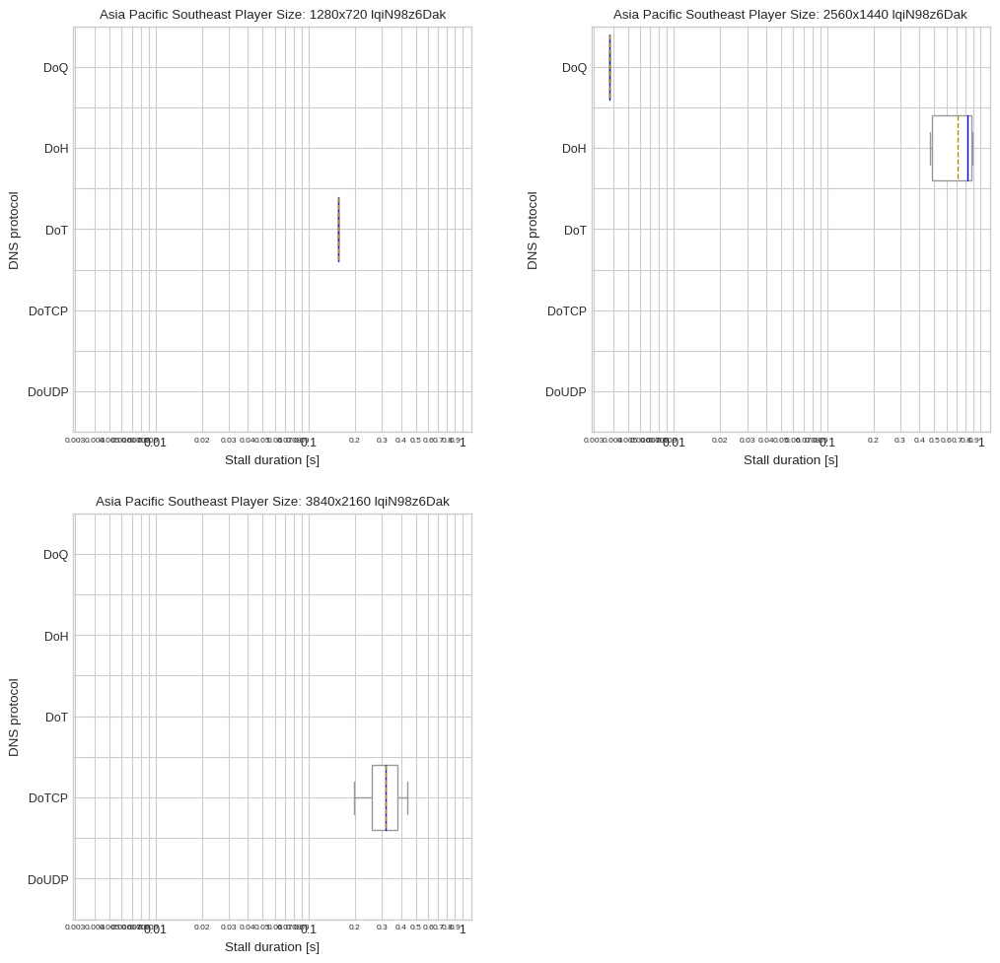

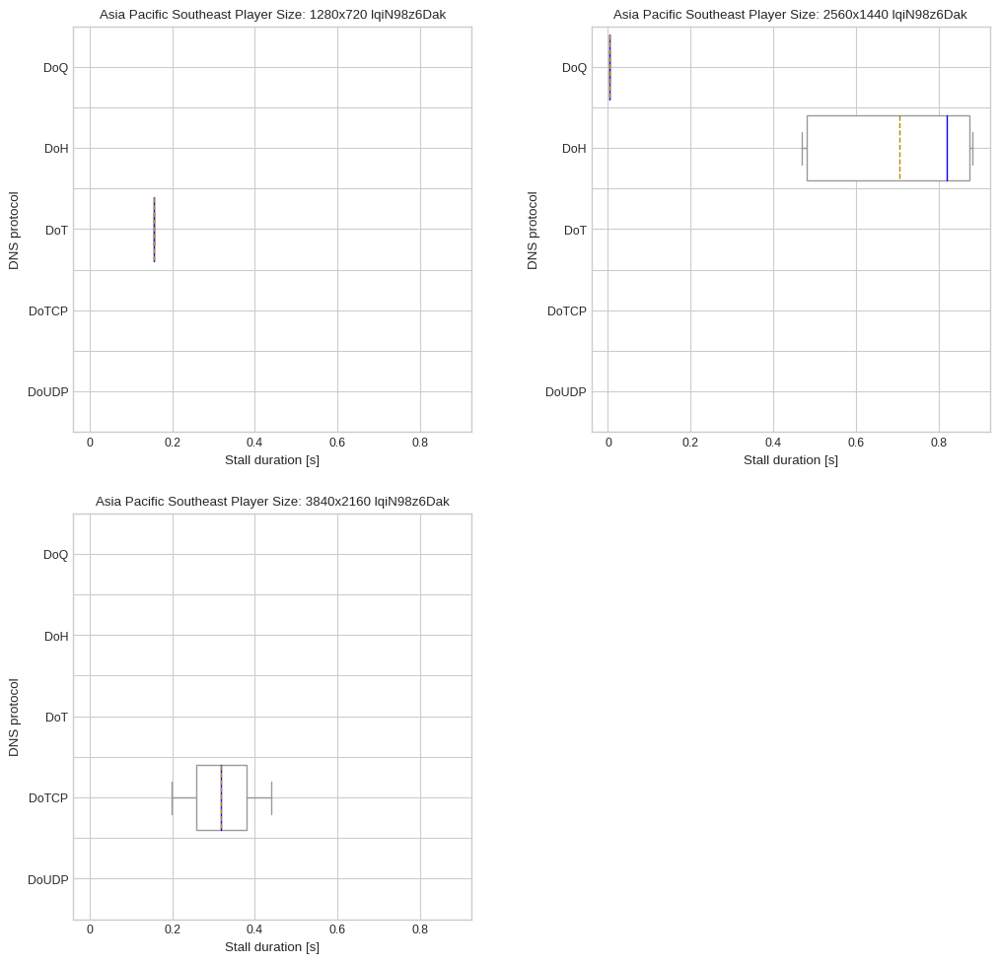

Europe Central


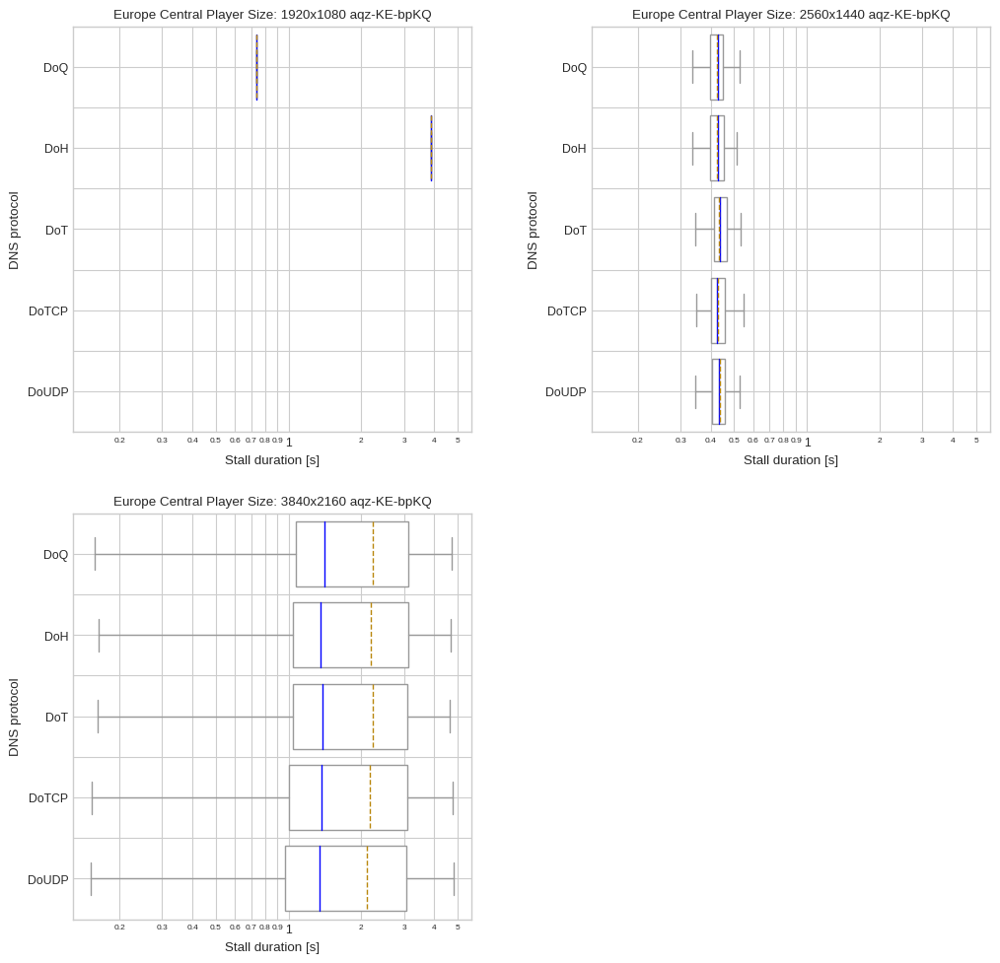

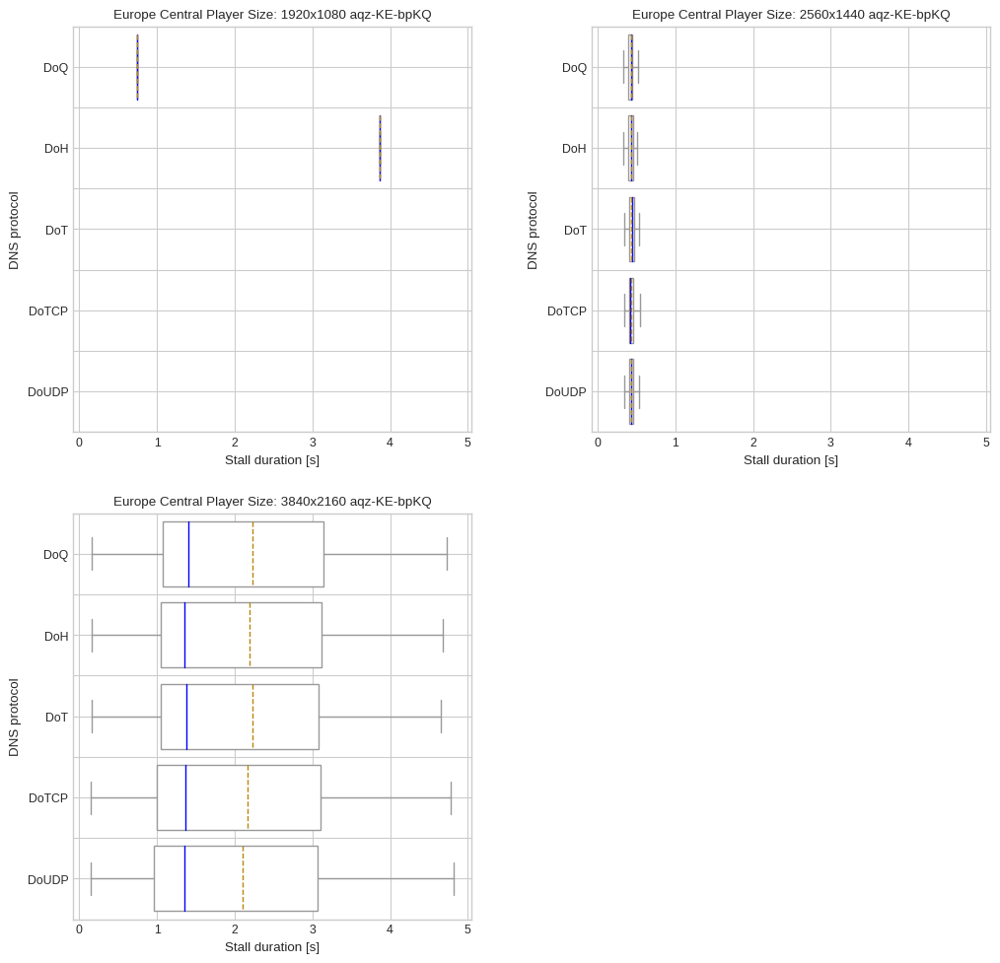

South America East


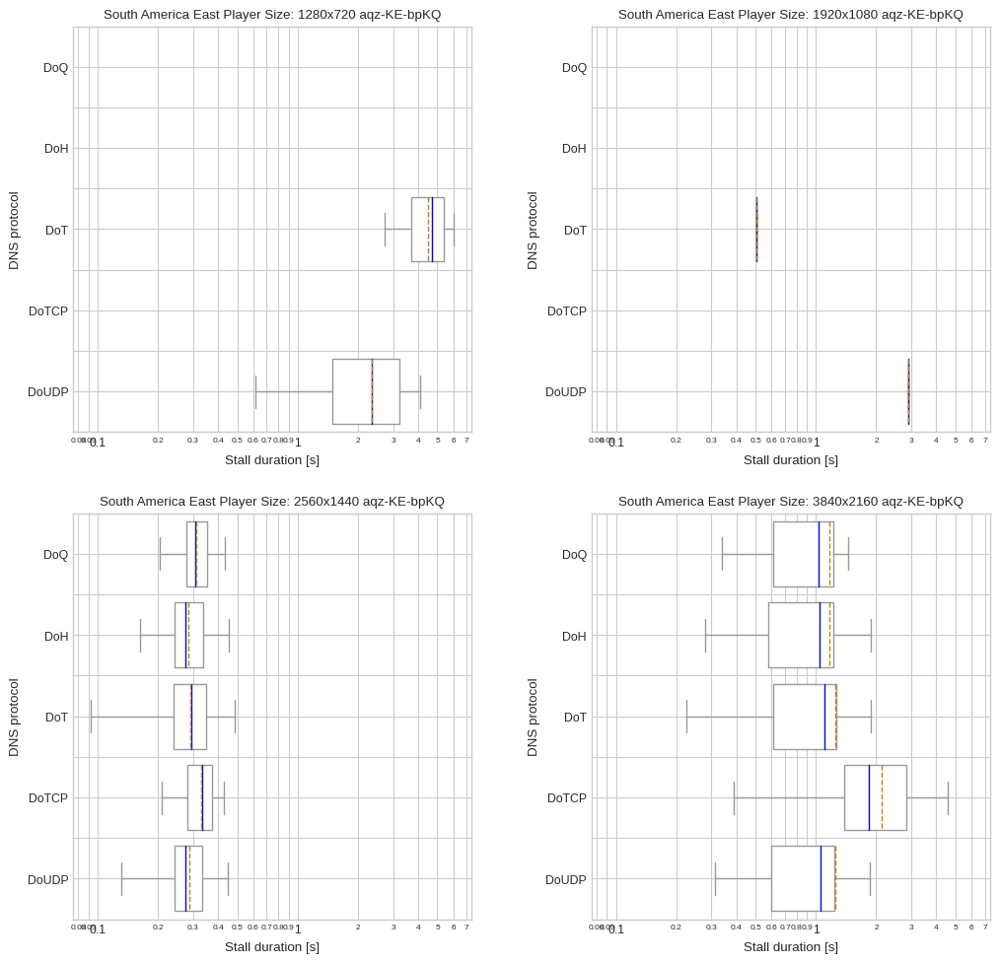

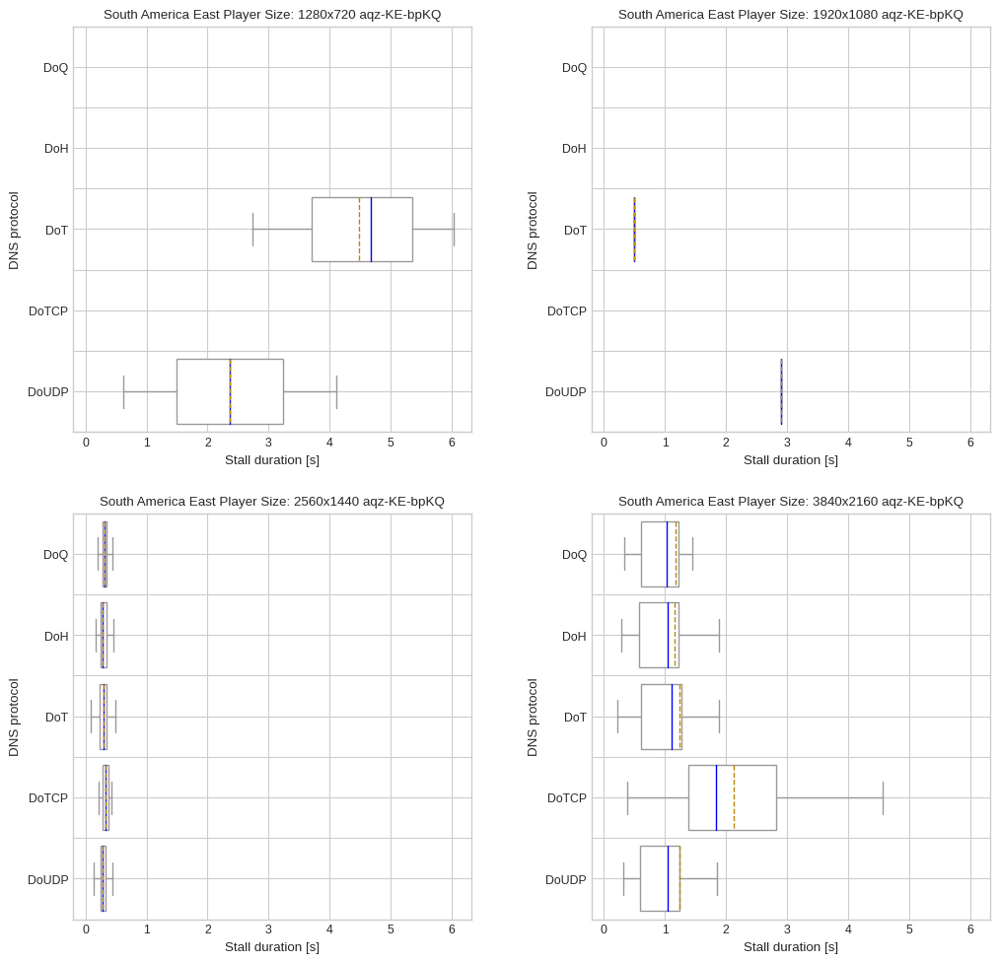

US East


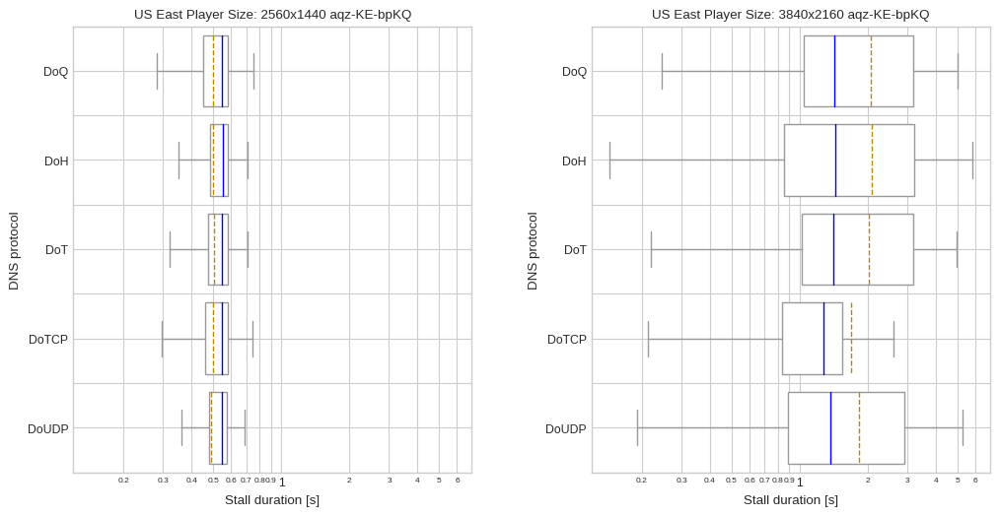

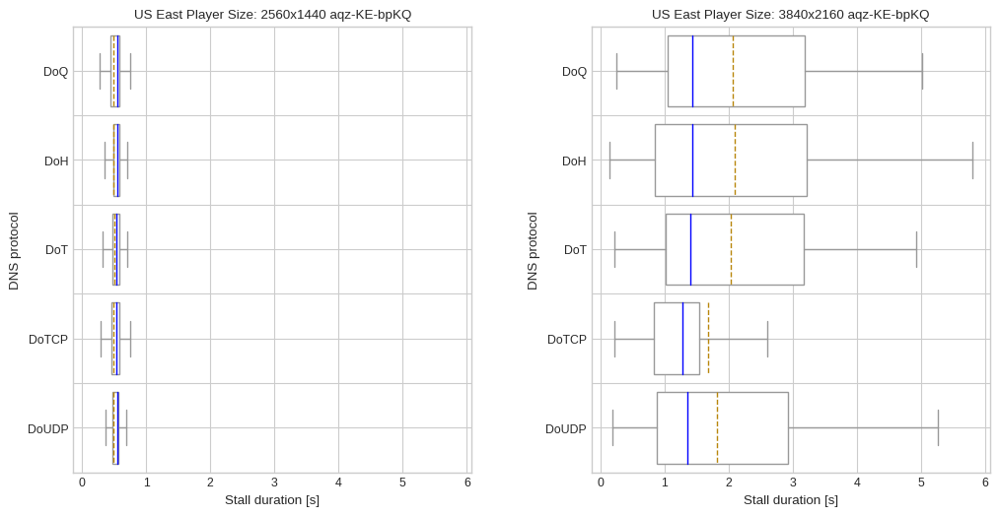

US West


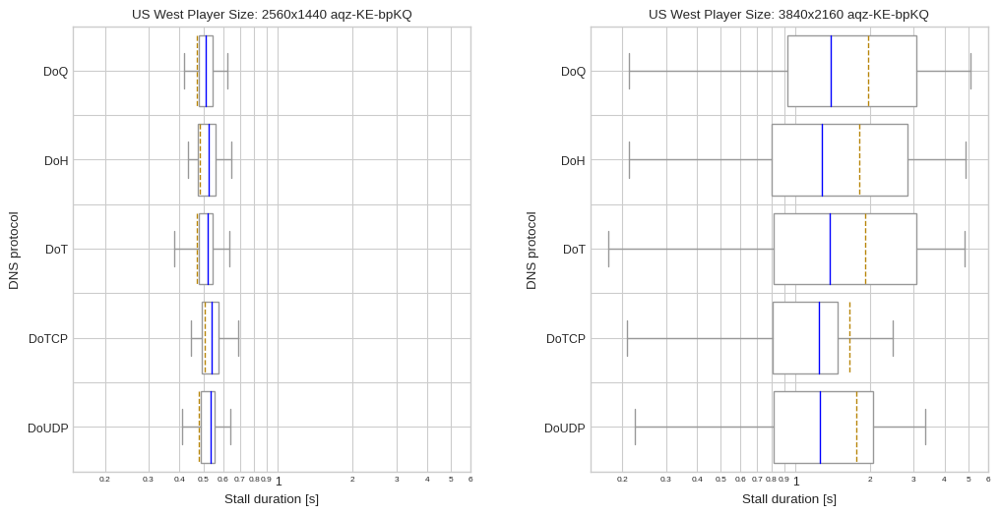

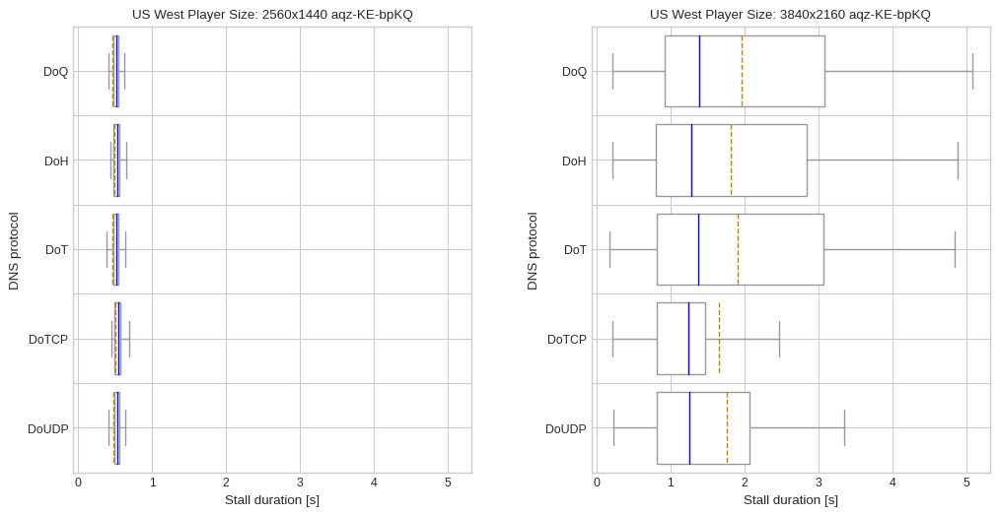

all vantage points


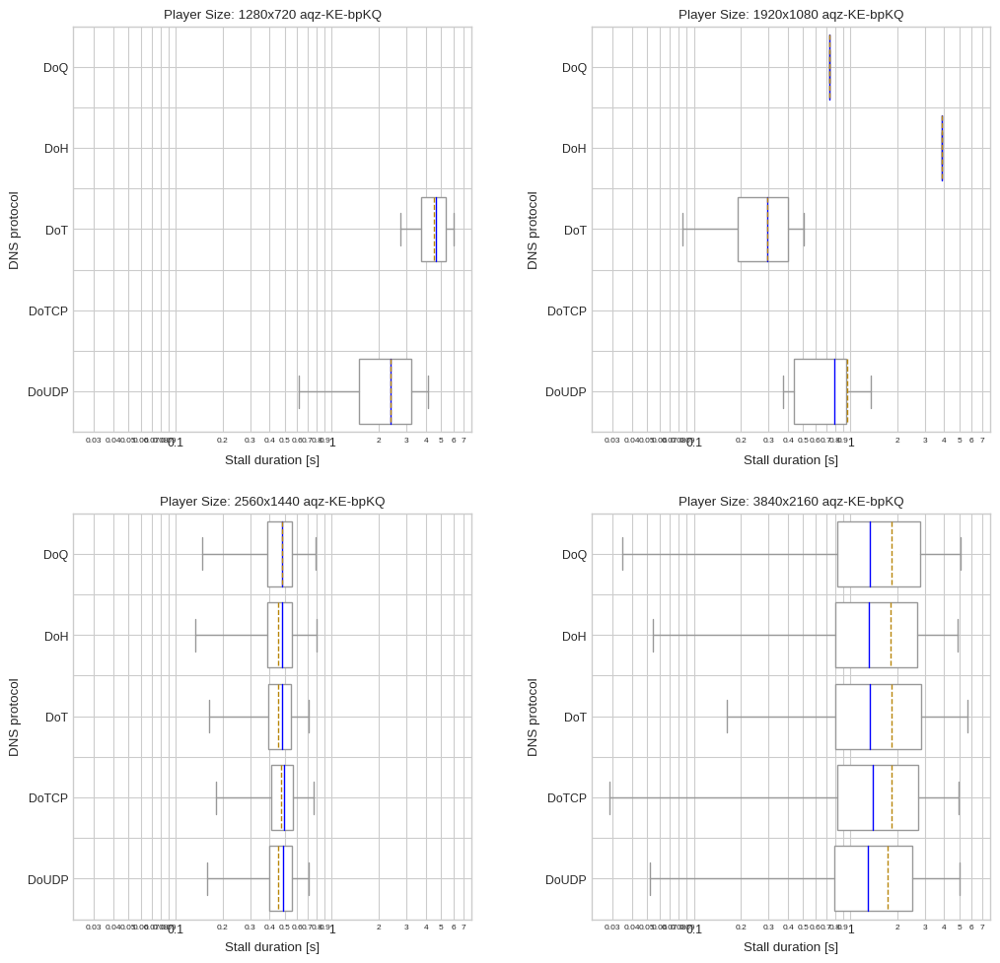

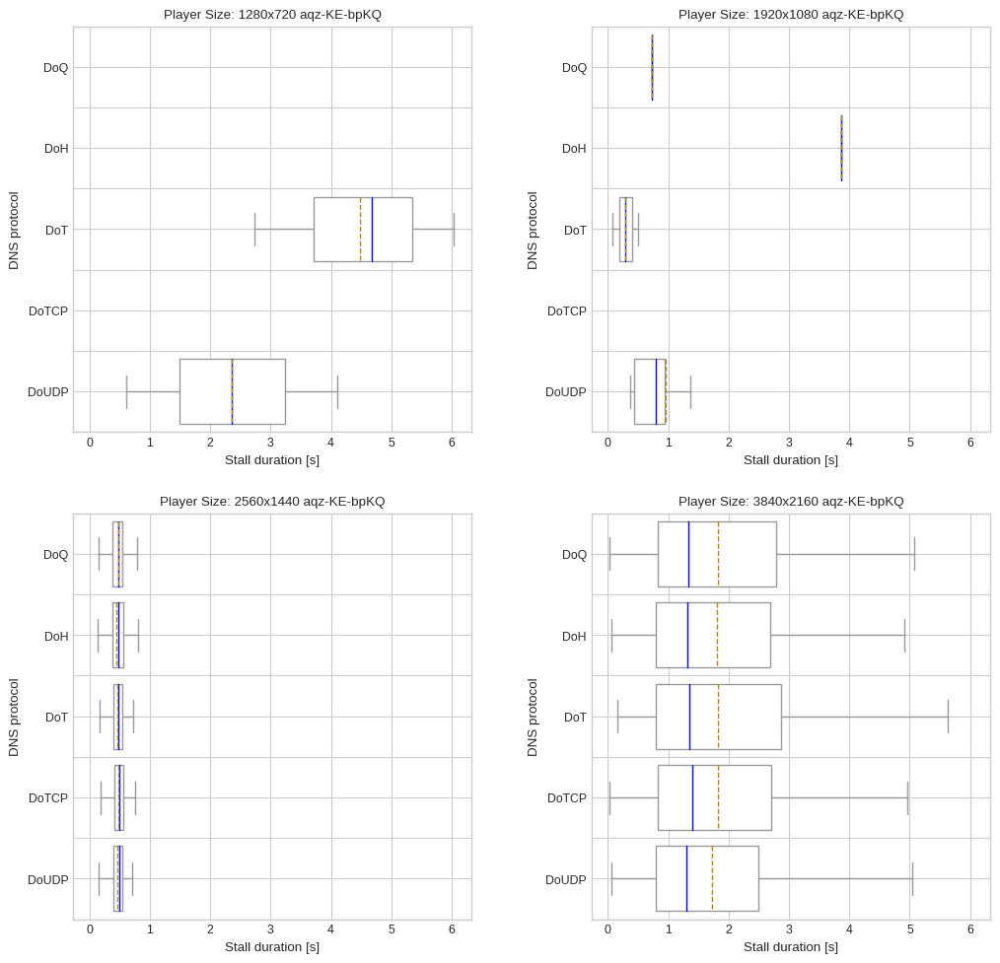

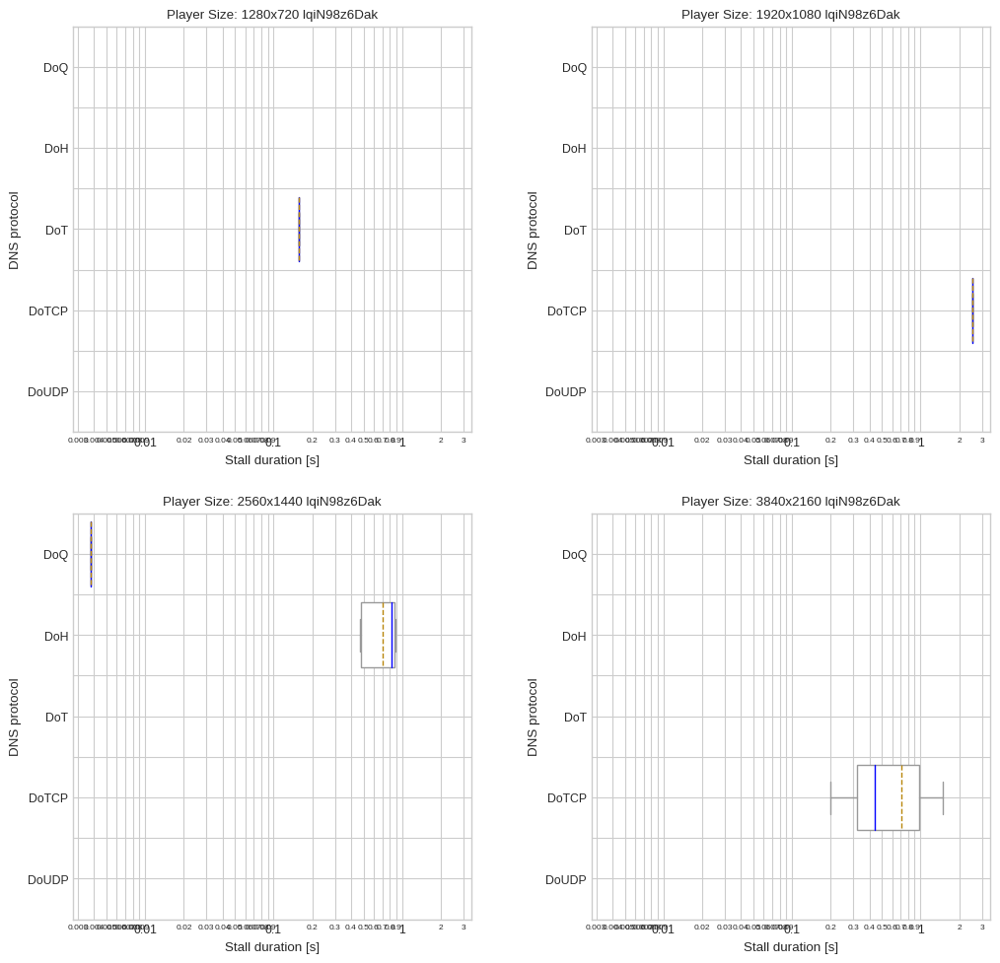

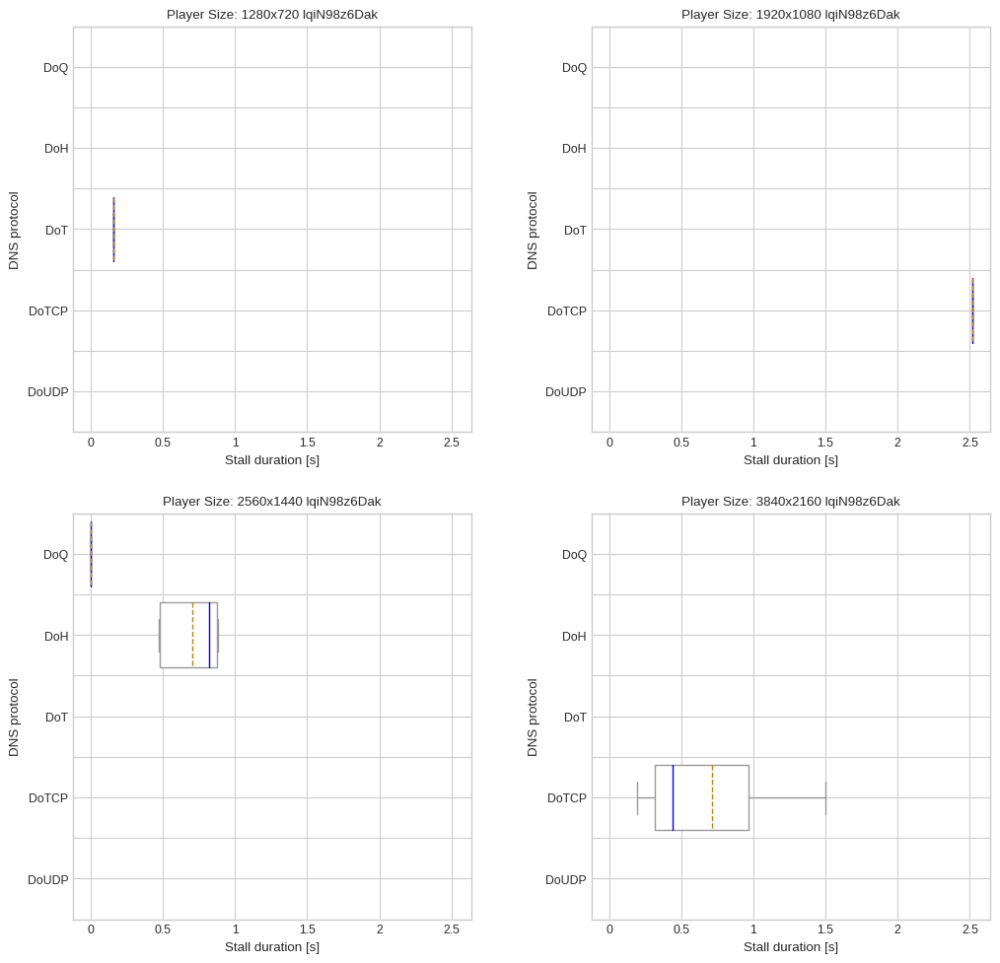

In [529]:
draw_boxplot_grid(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], "DNS protocol")

Africa South
Asia Pacific Northeast


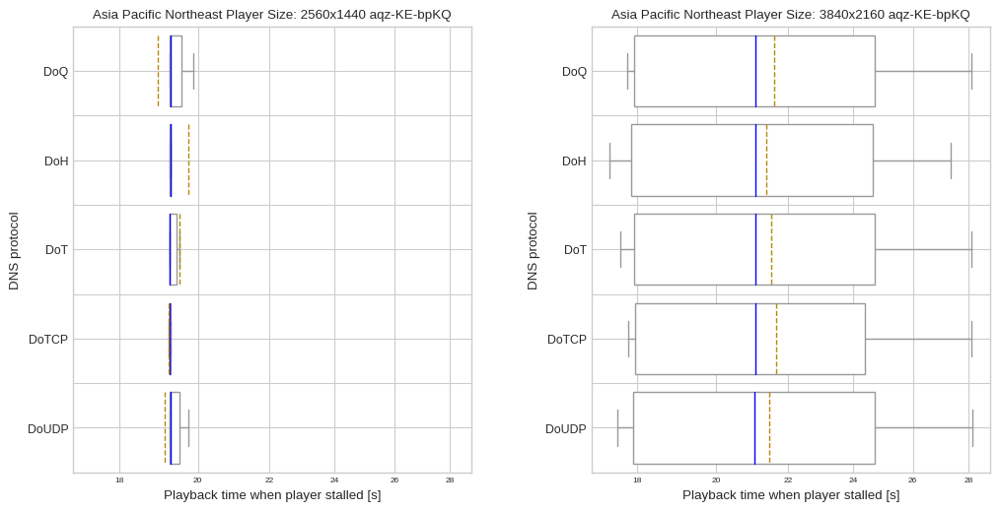

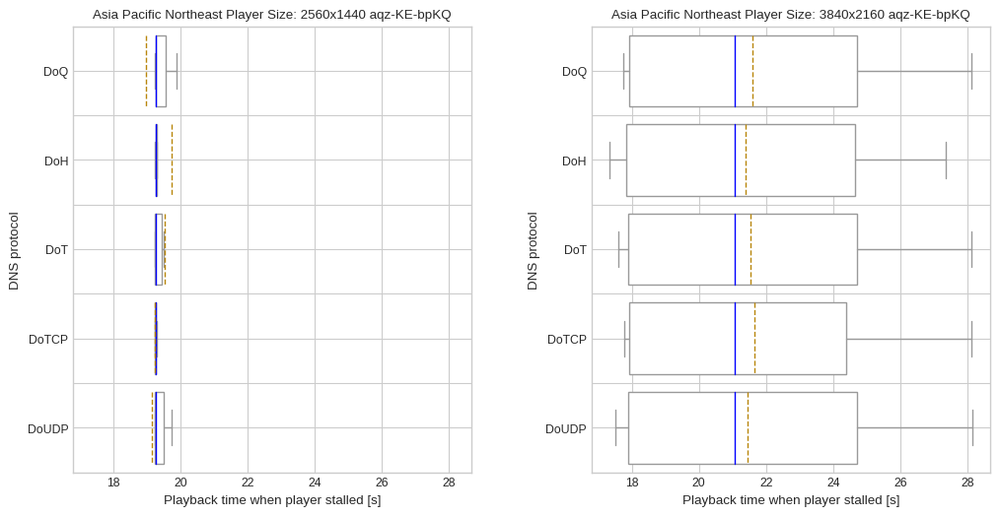

Asia Pacific Southeast


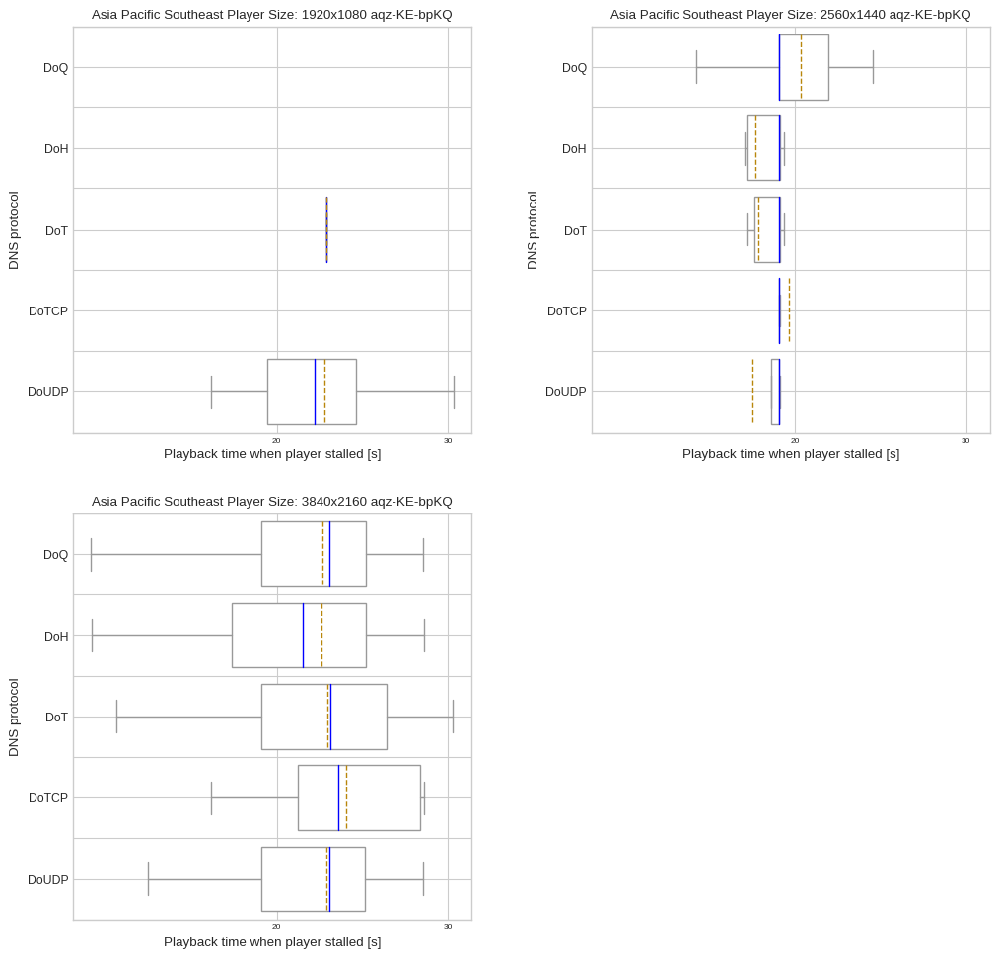

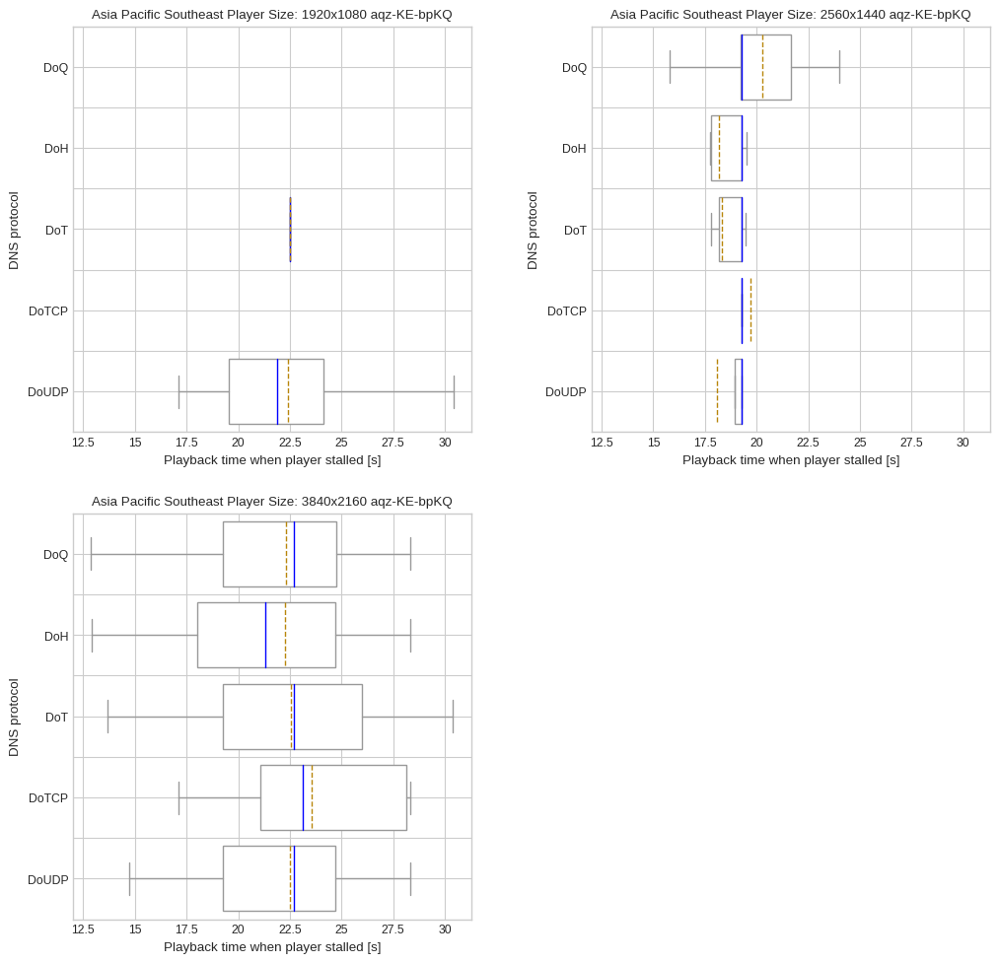

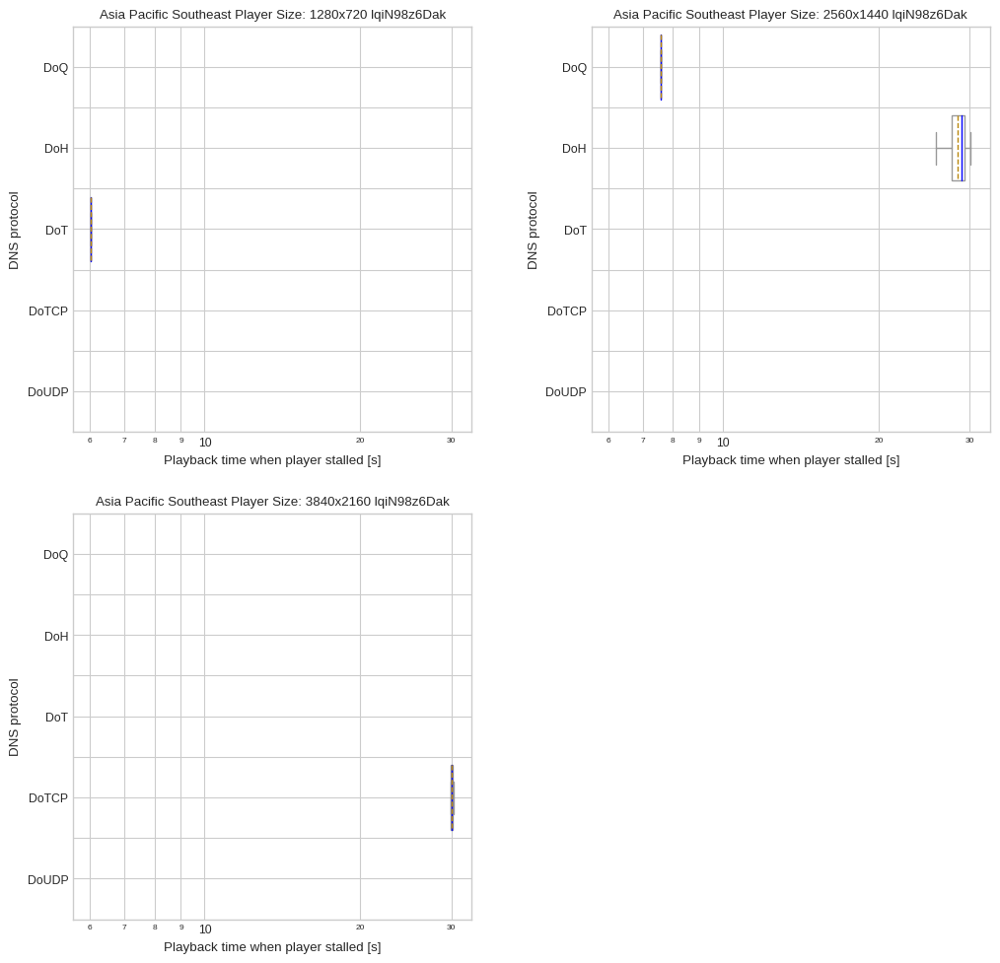

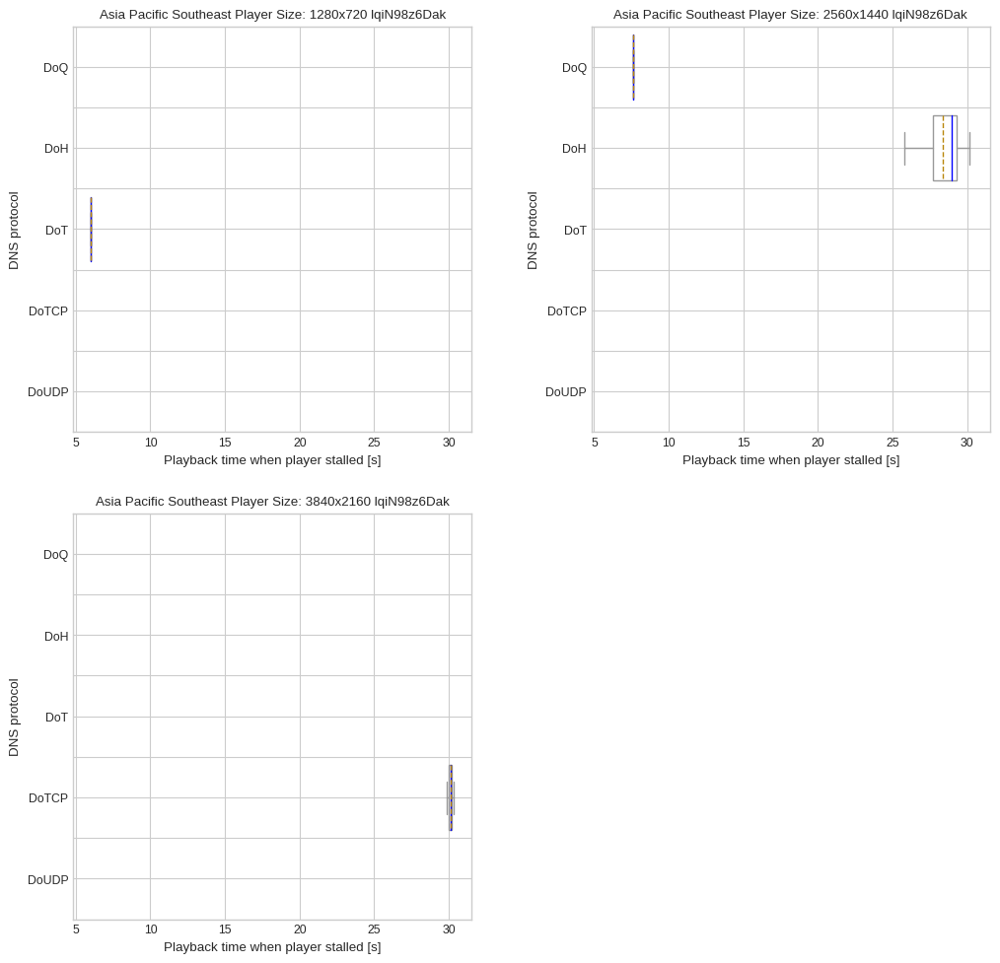

Europe Central


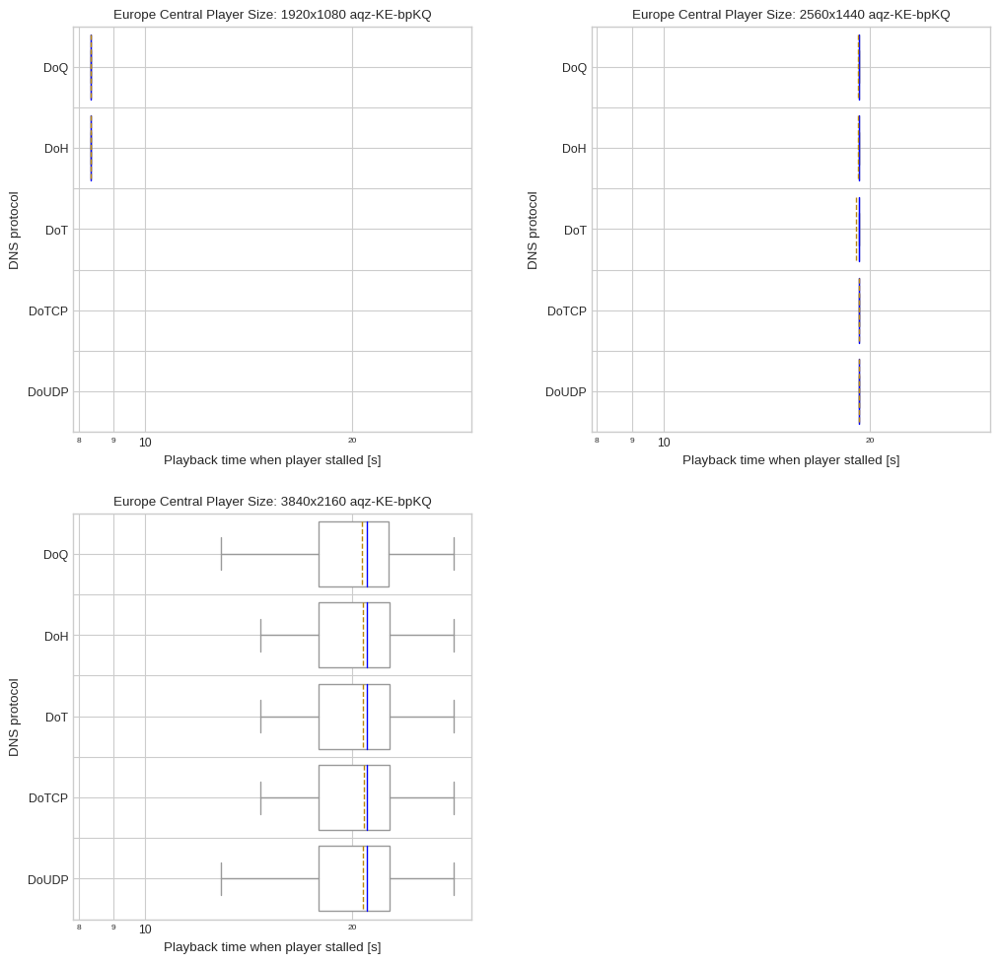

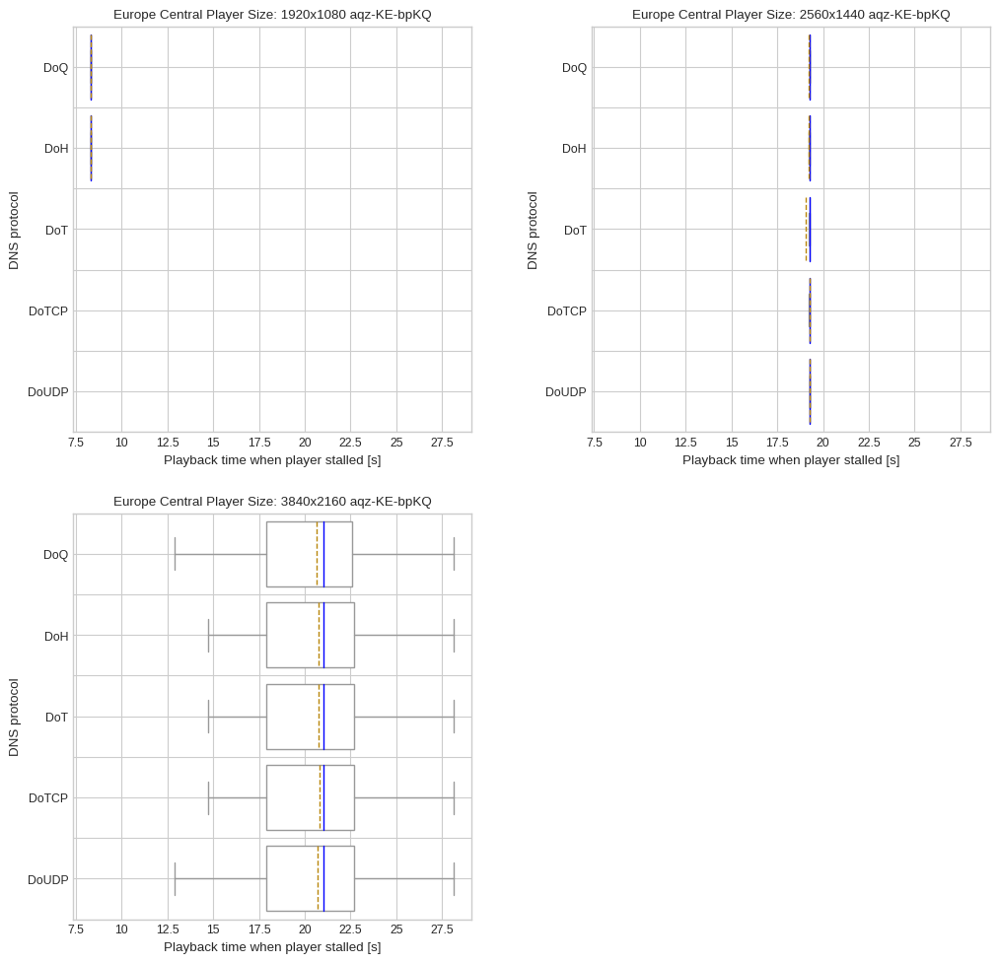

South America East


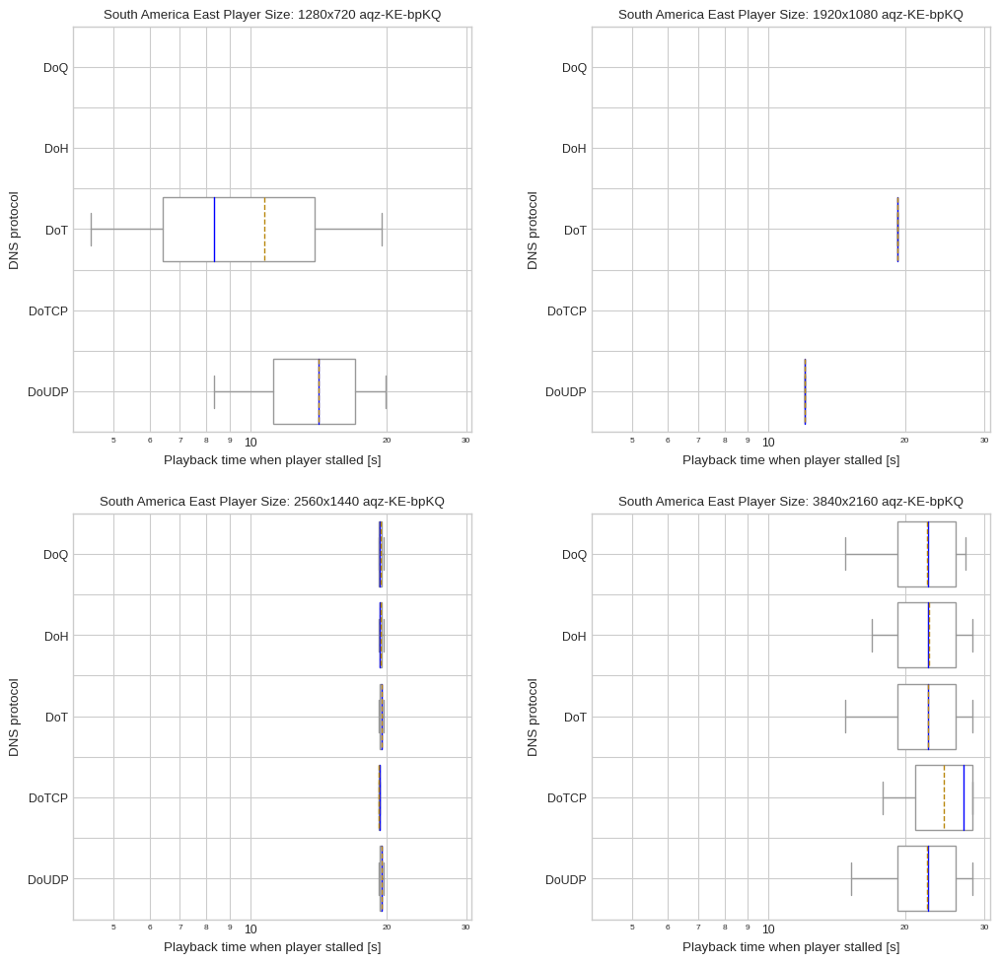

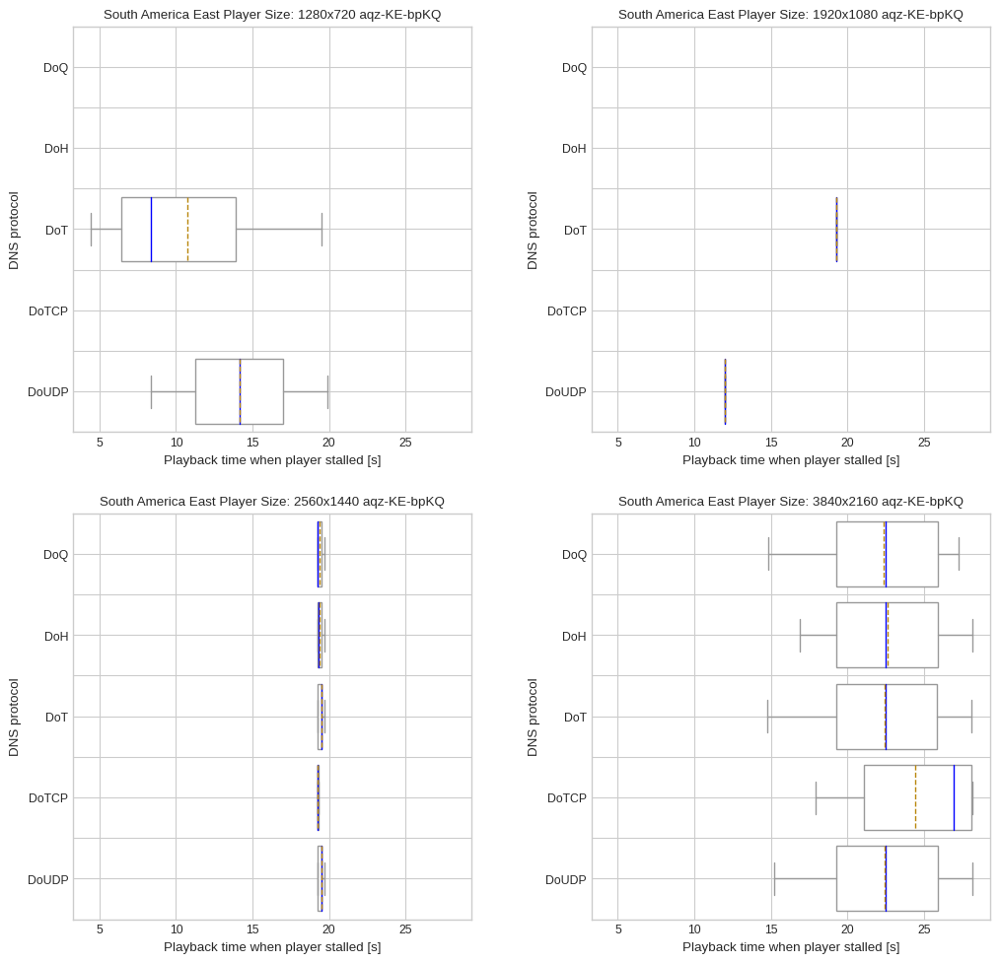

US East


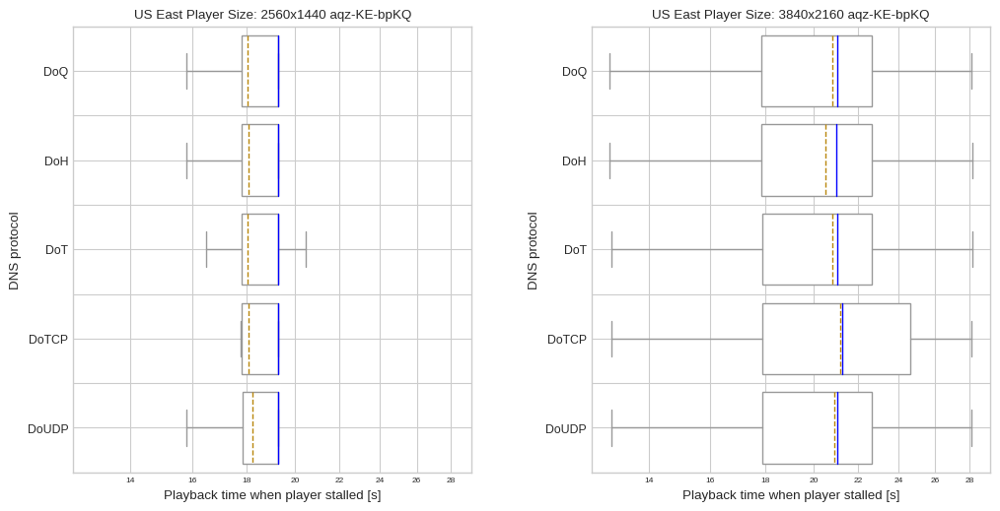

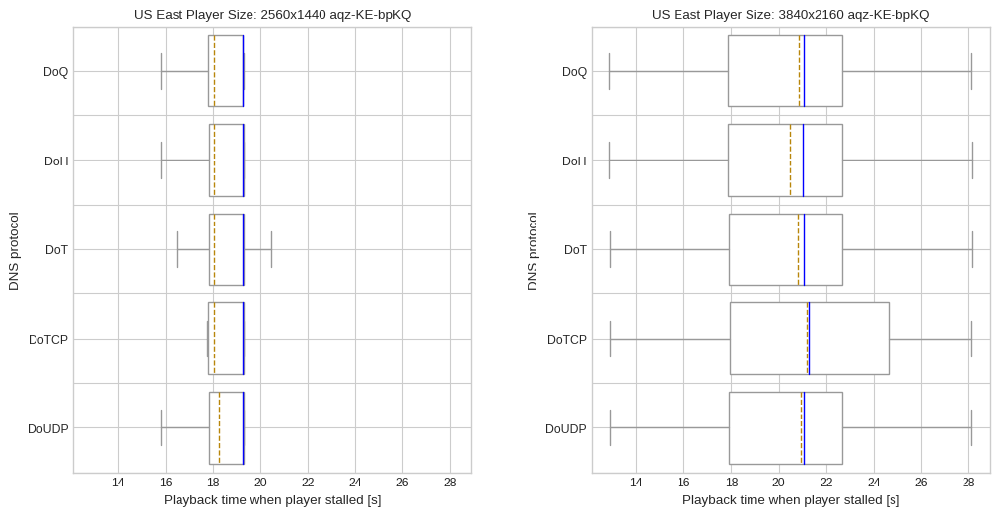

US West


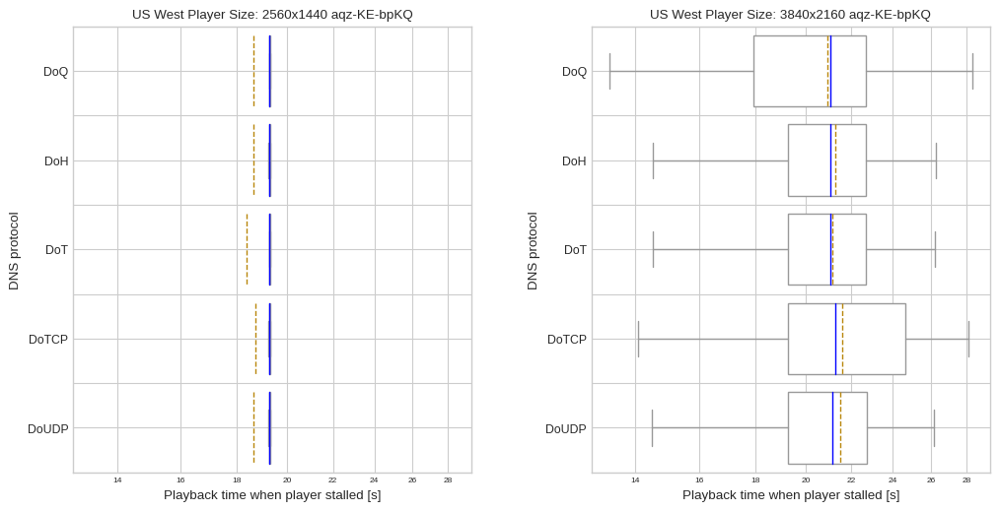

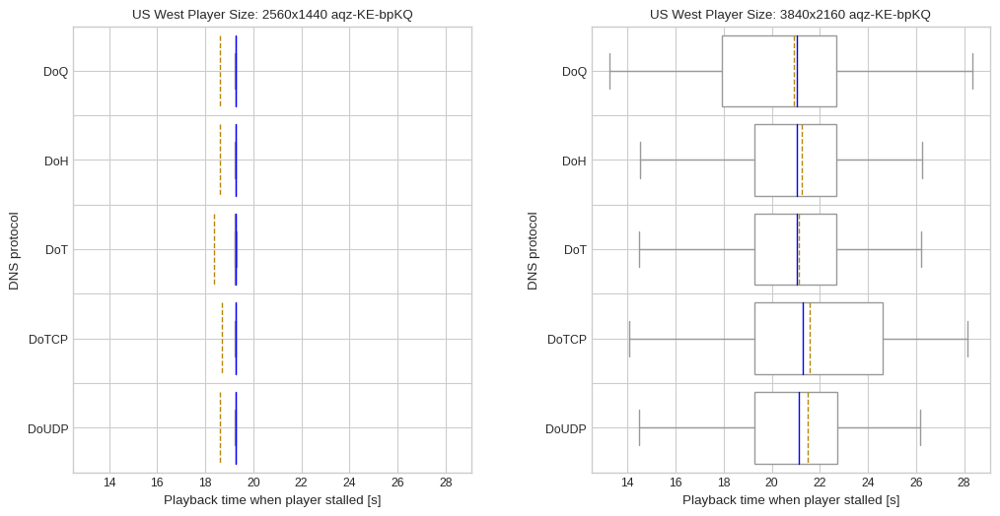

all vantage points


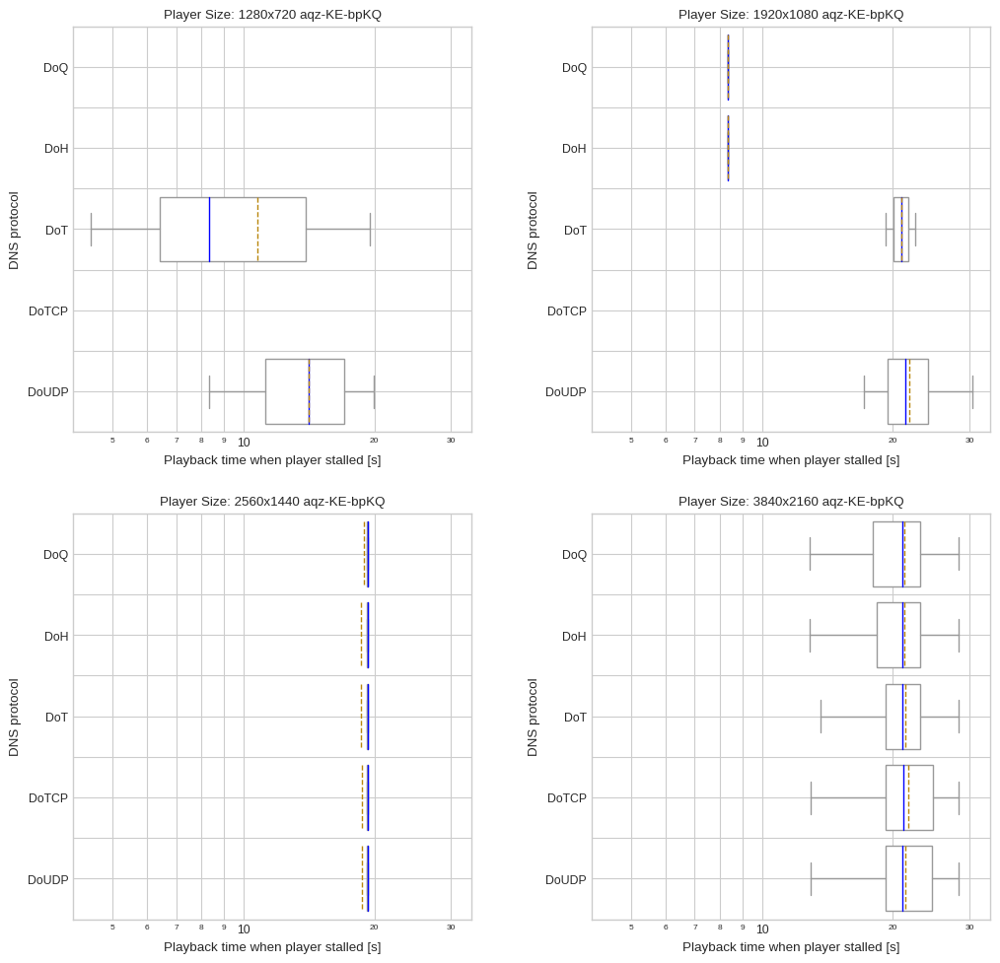

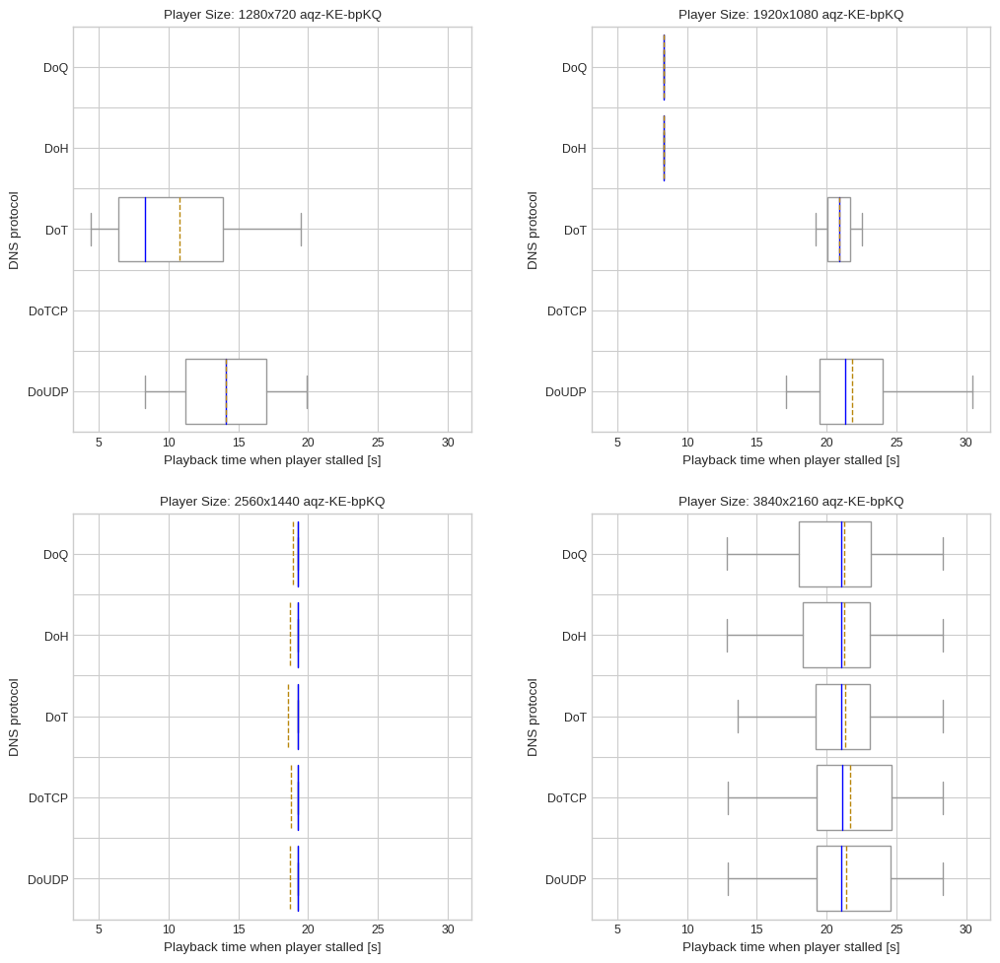

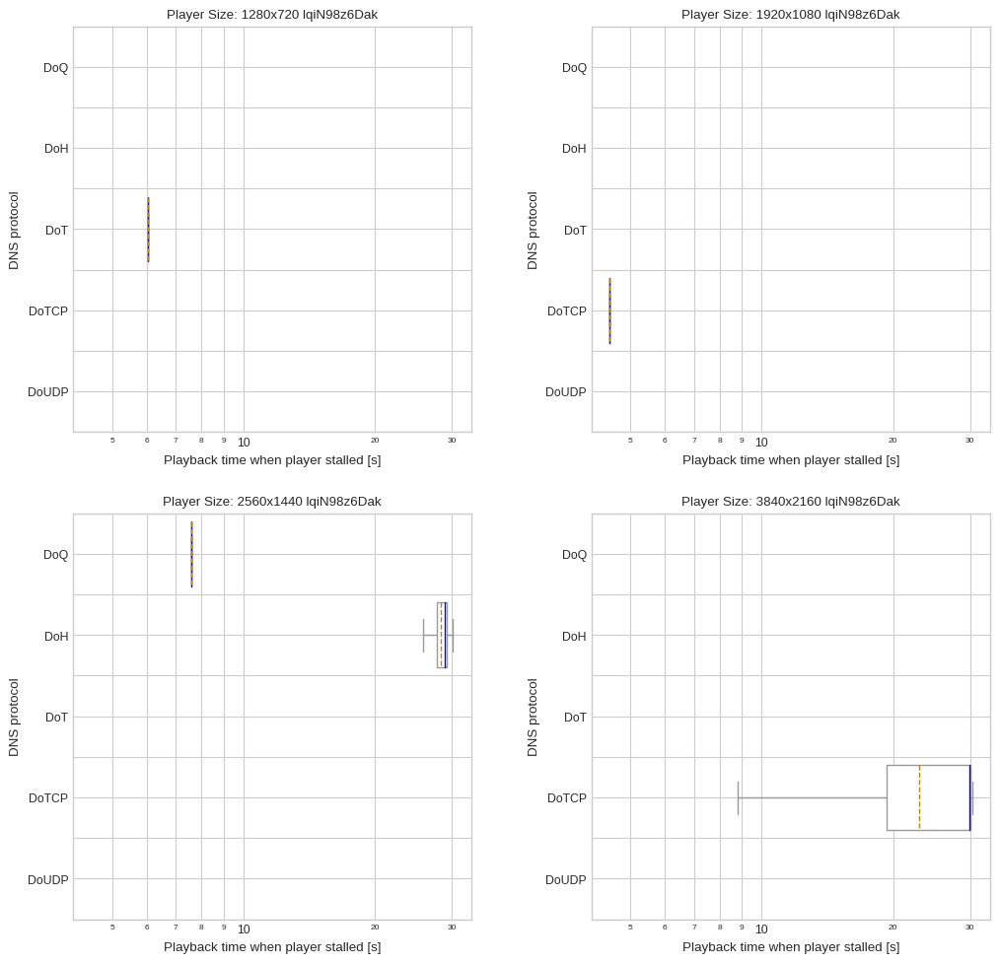

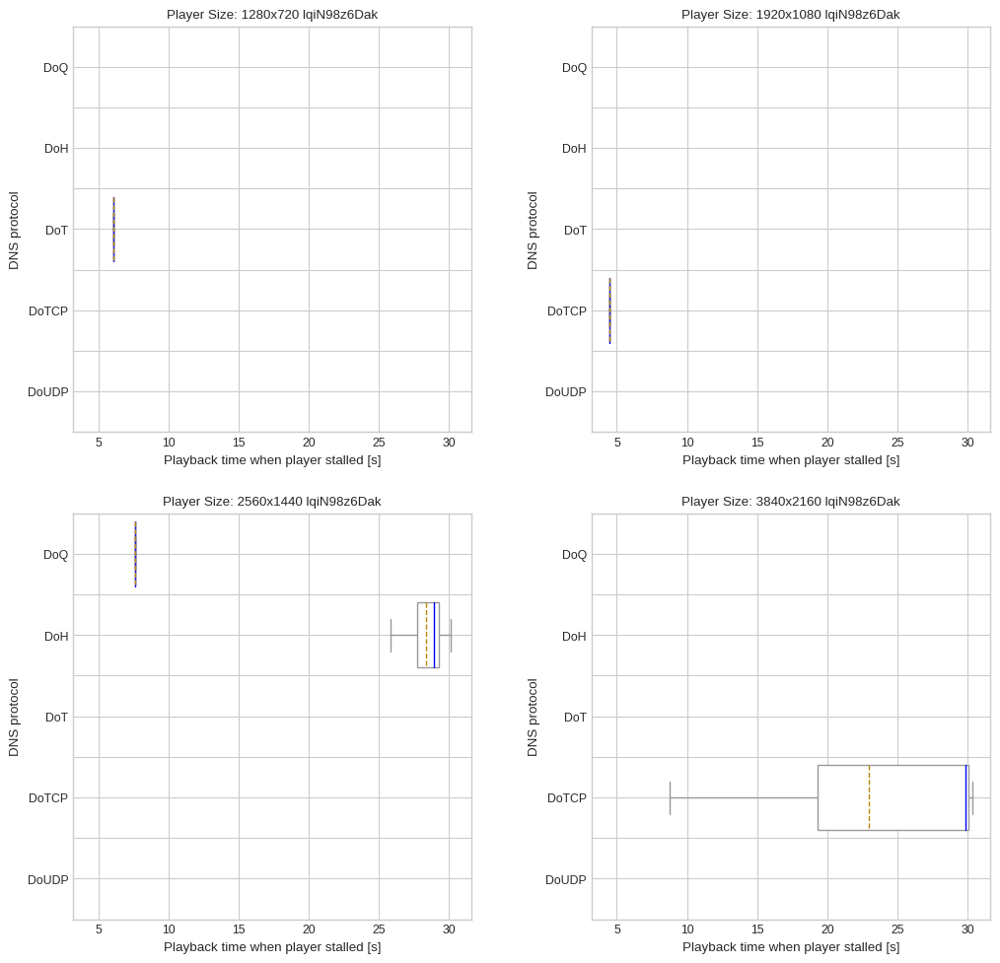

In [530]:
draw_boxplot_grid(df_stall_times, 'player_dimensions', 'protocol', 'curr_play_time', [True, False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-with-restart-events-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

Africa South
Asia Pacific Northeast


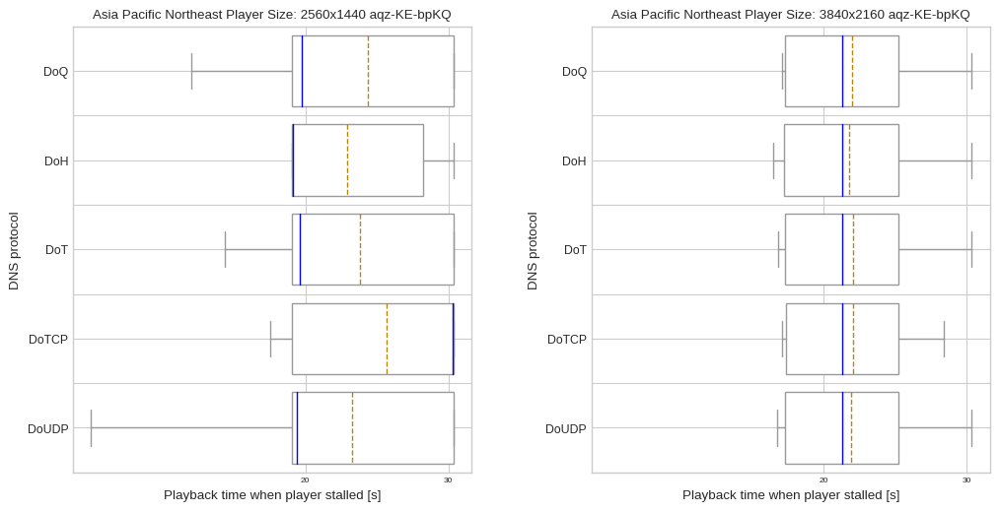

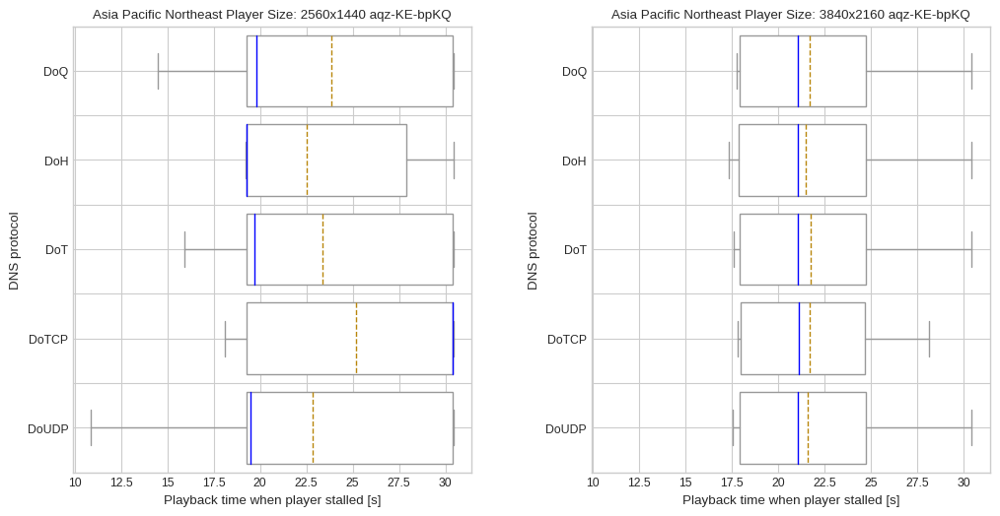

Asia Pacific Southeast


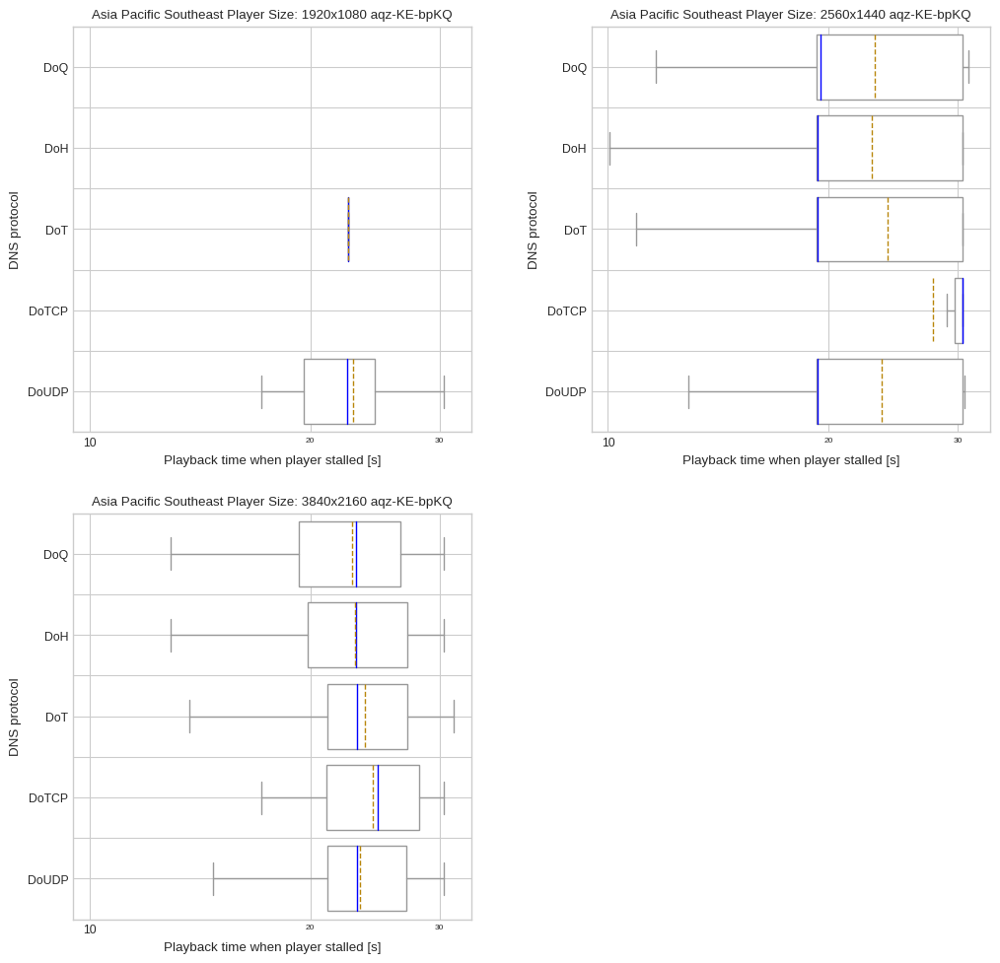

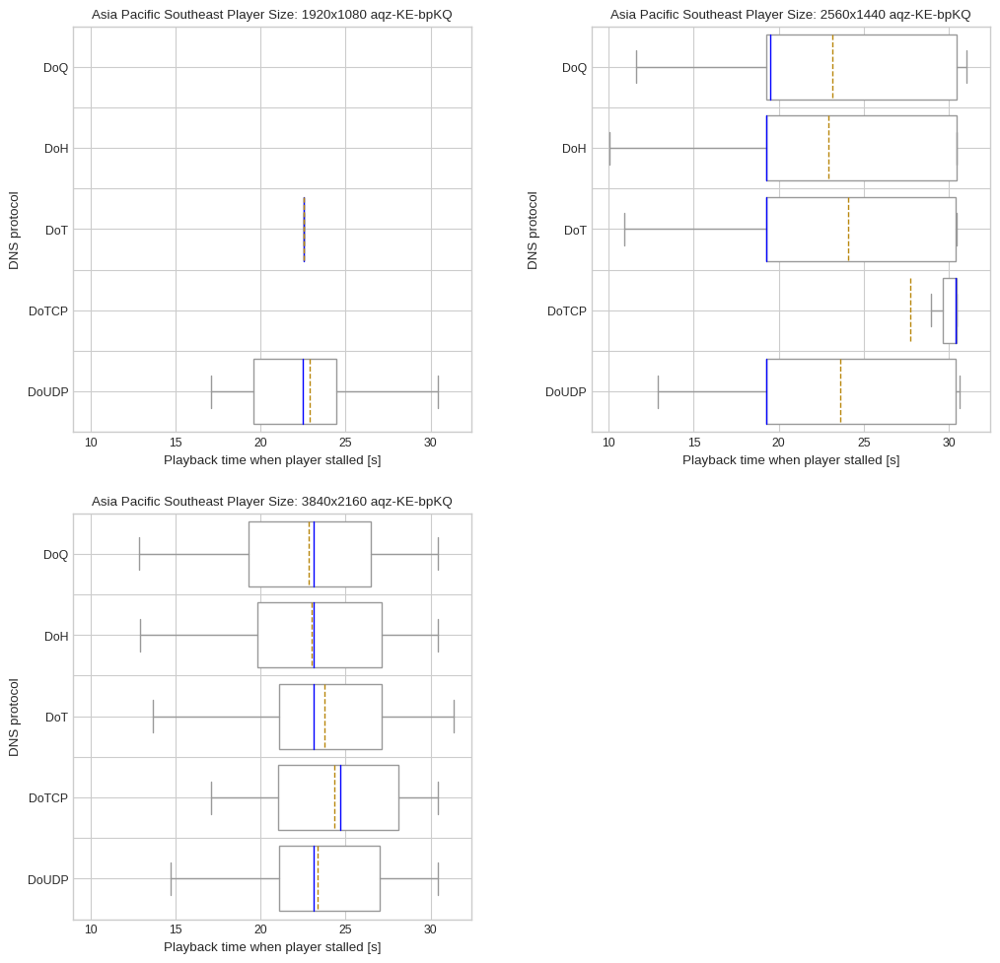

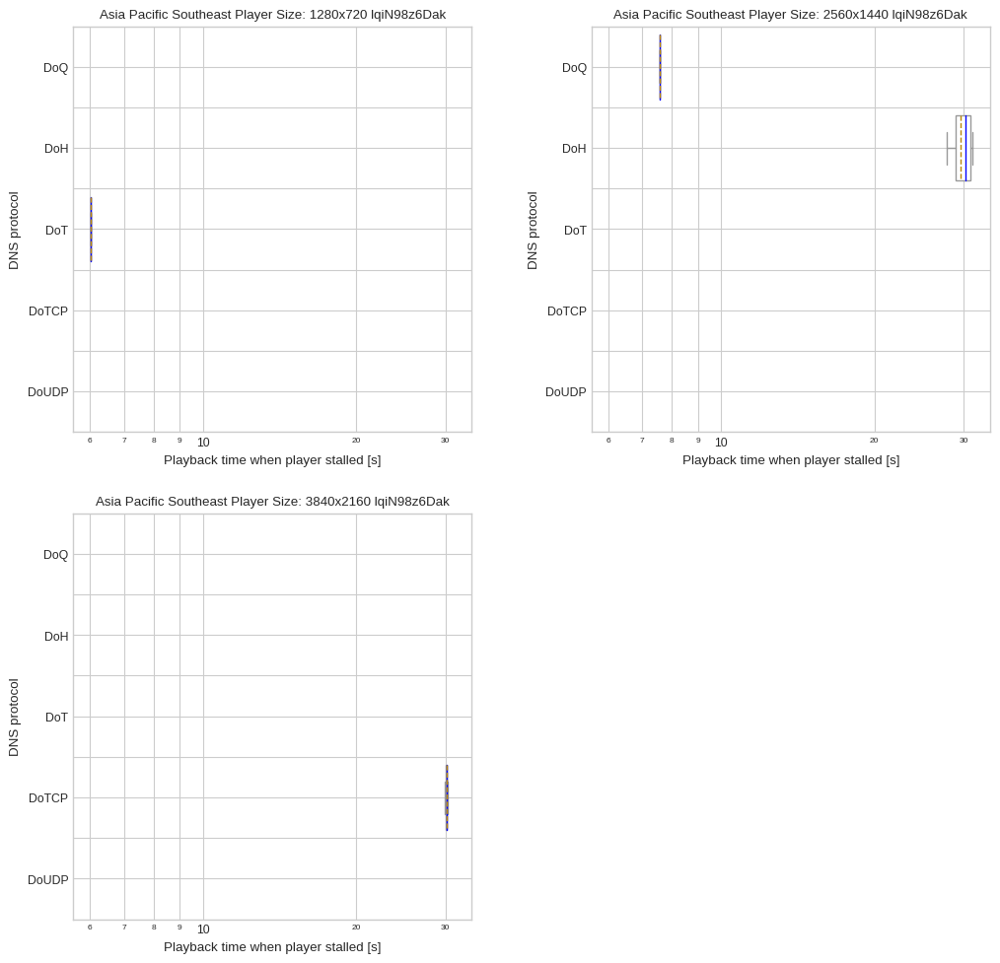

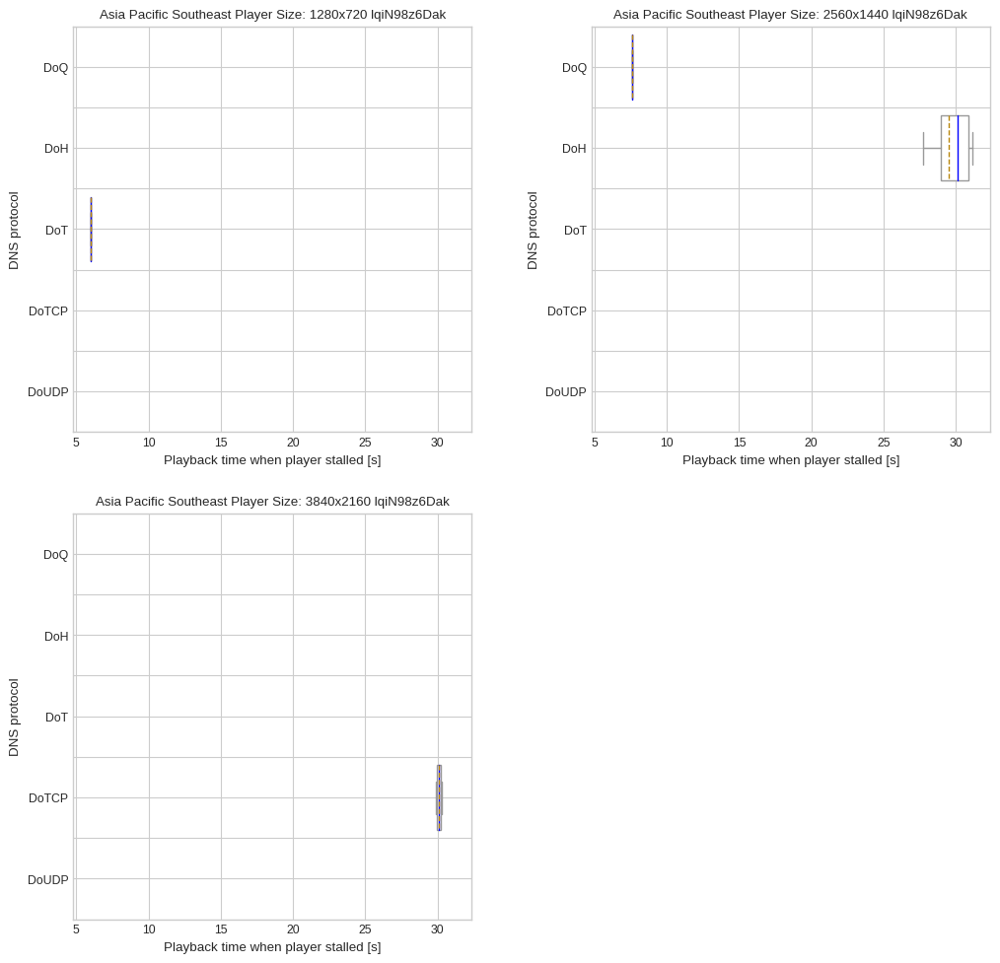

Europe Central


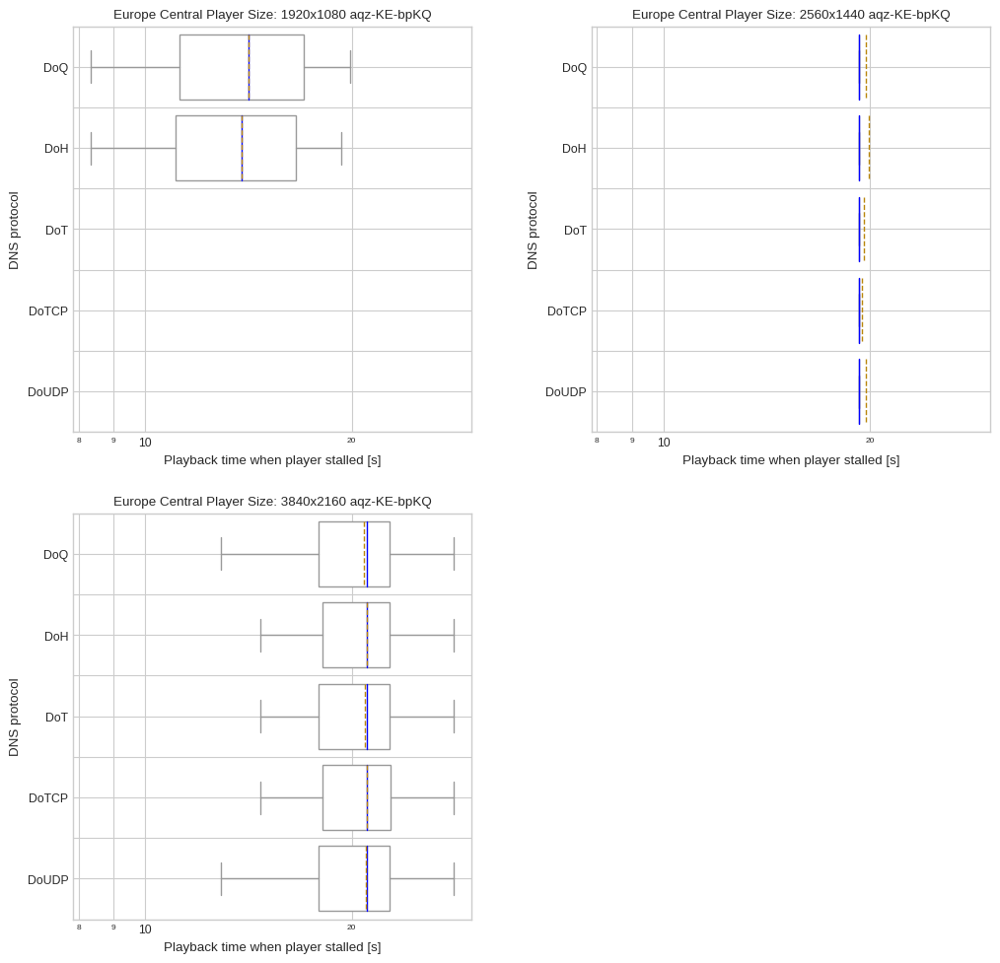

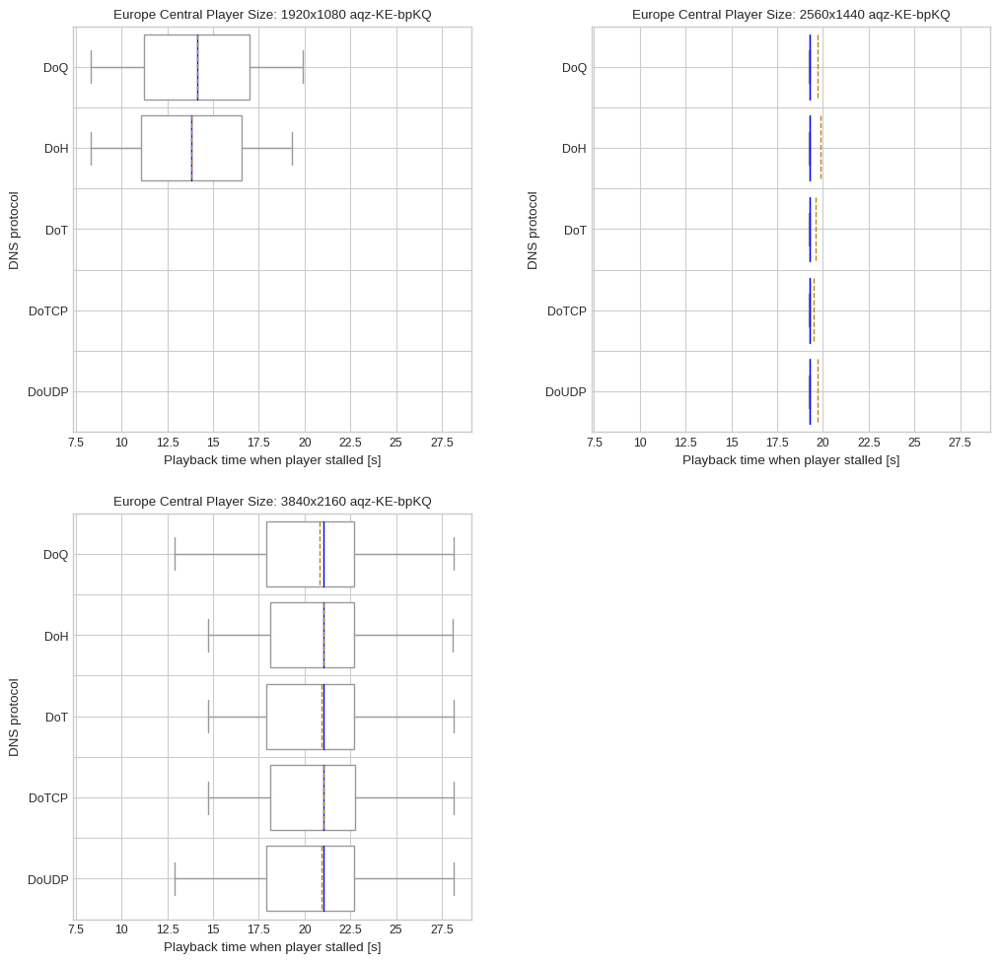

South America East


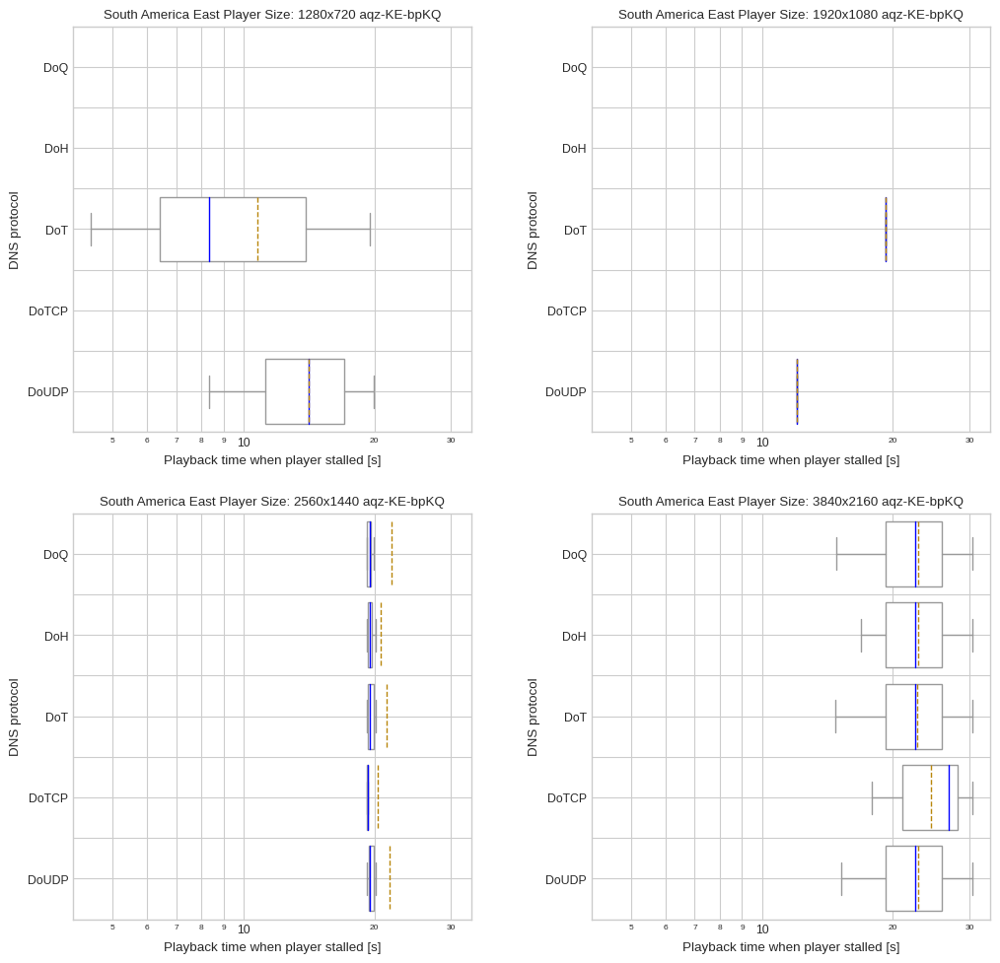

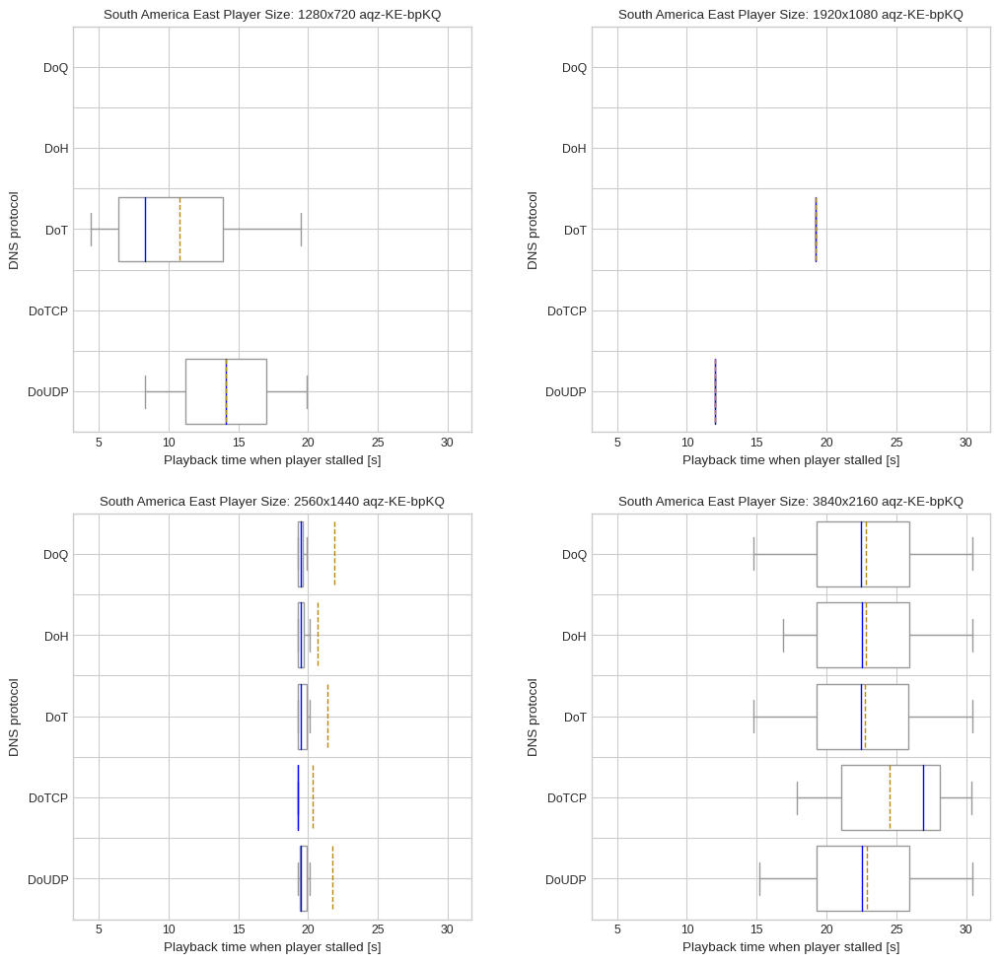

US East


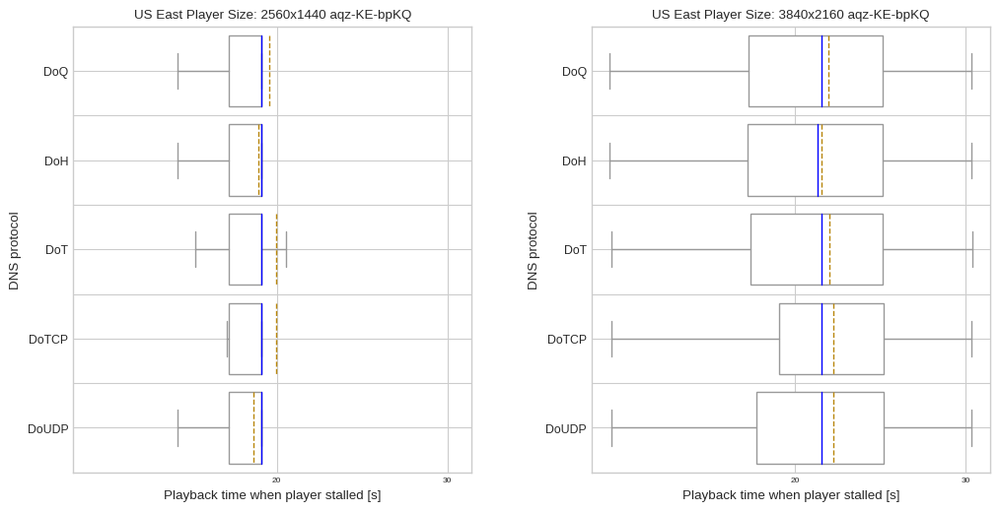

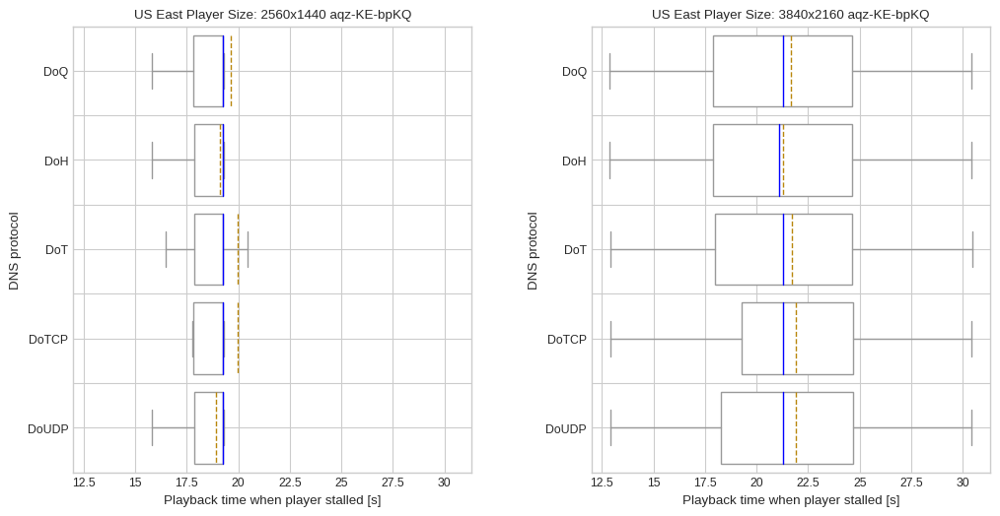

US West


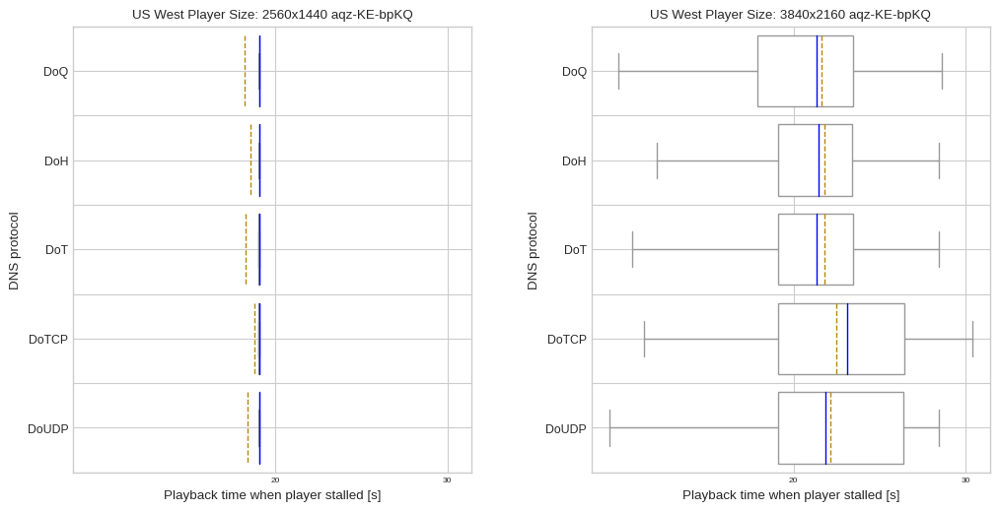

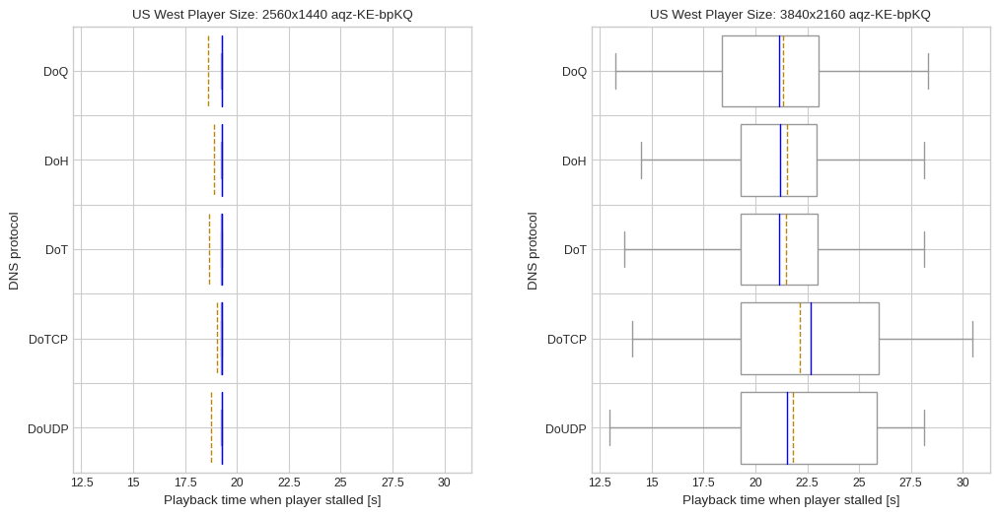

all vantage points


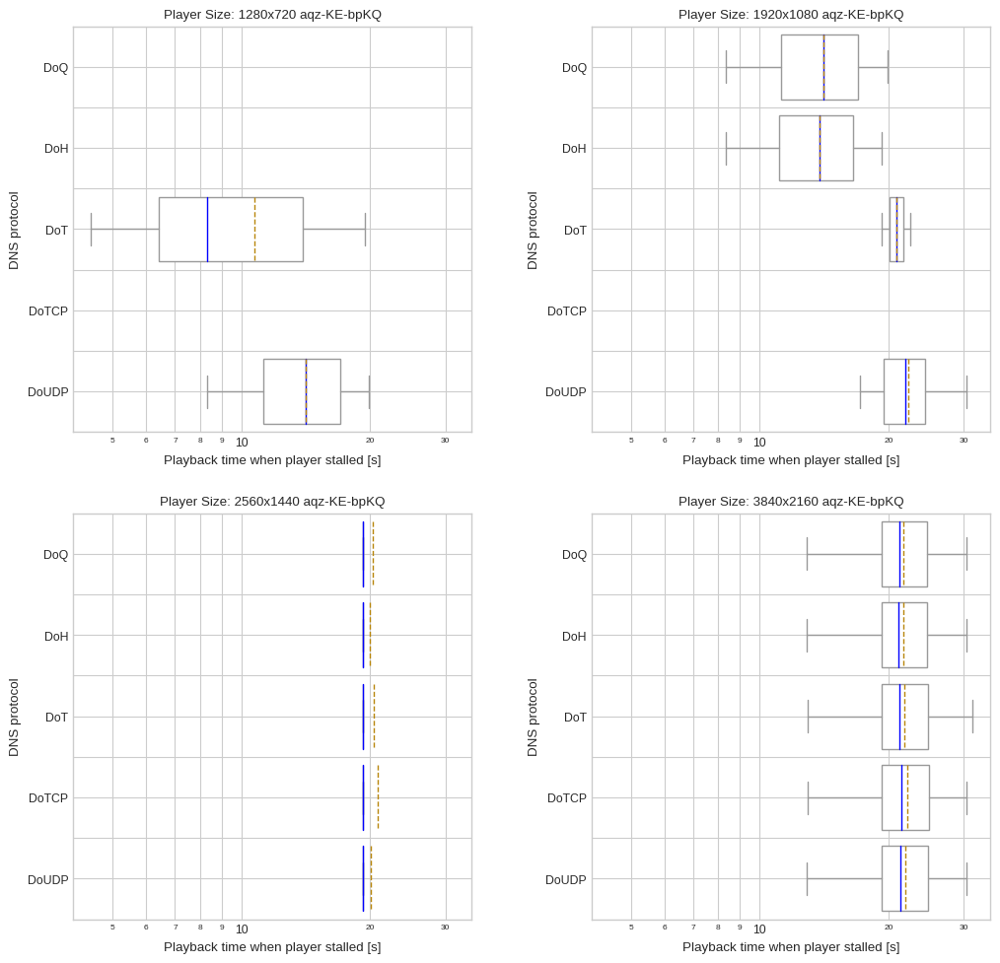

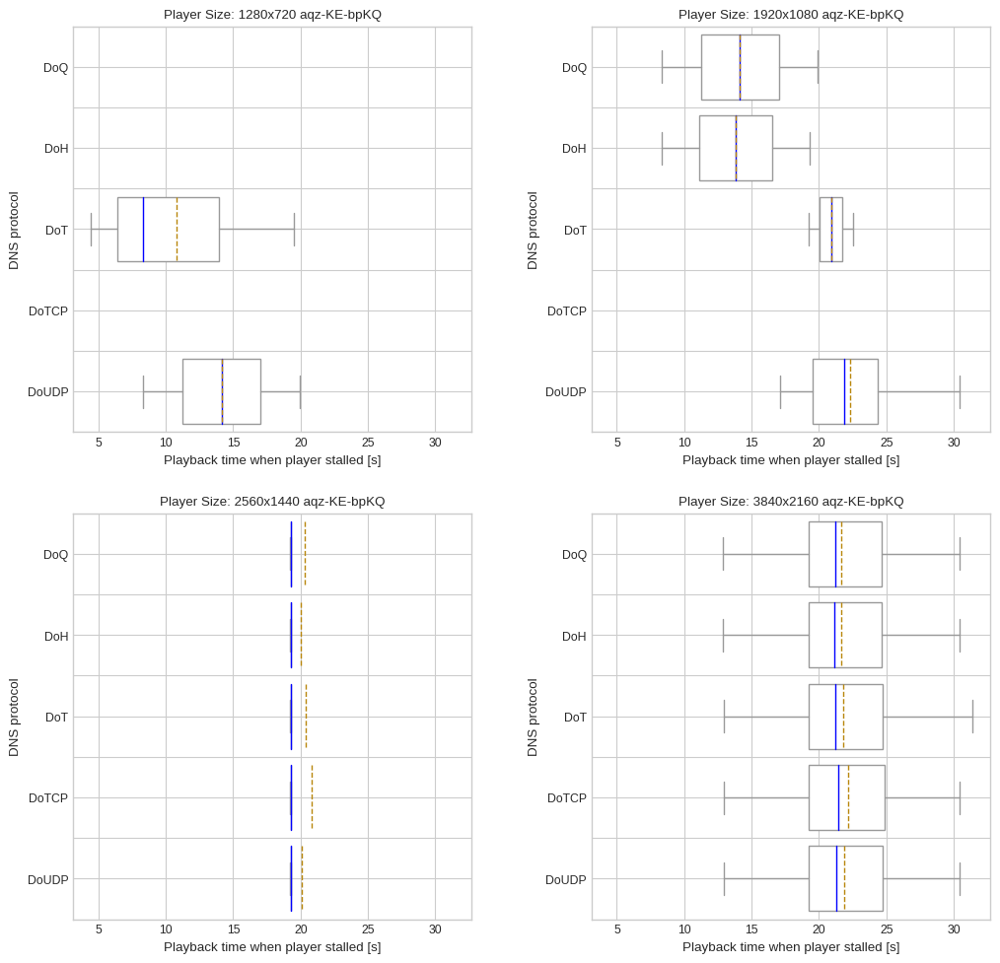

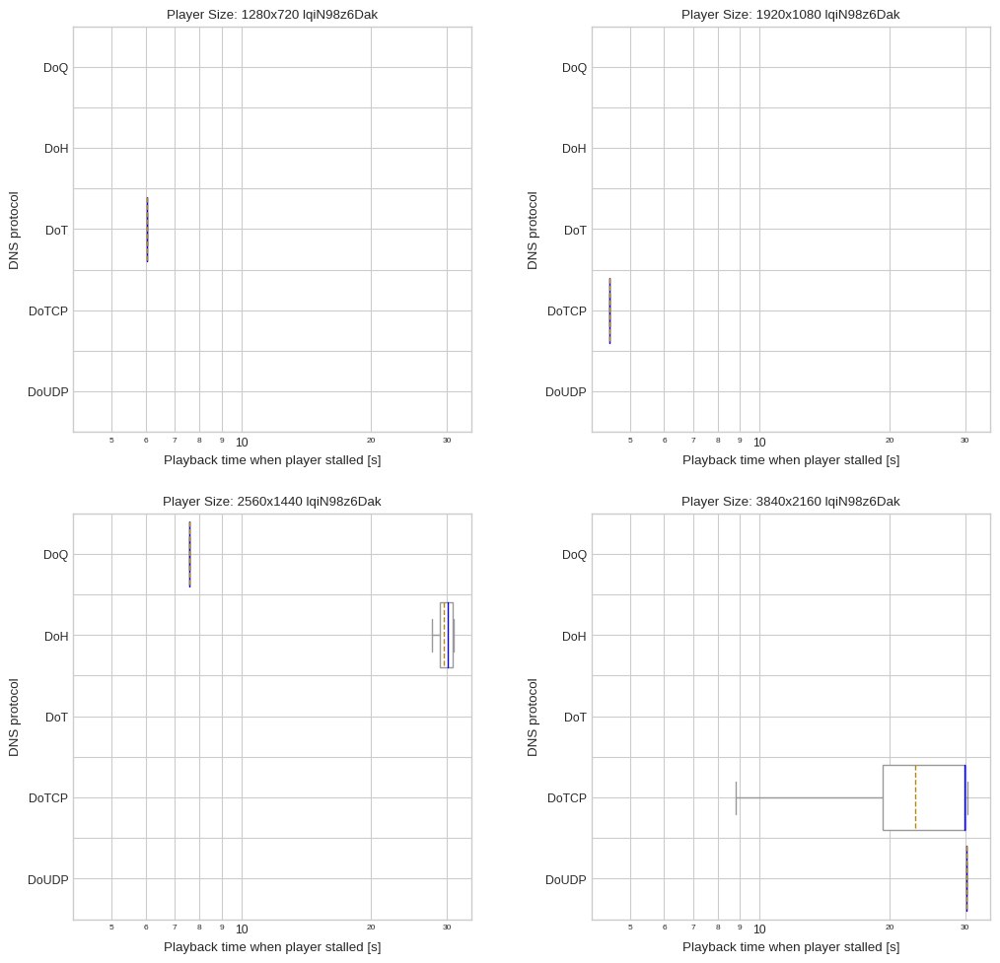

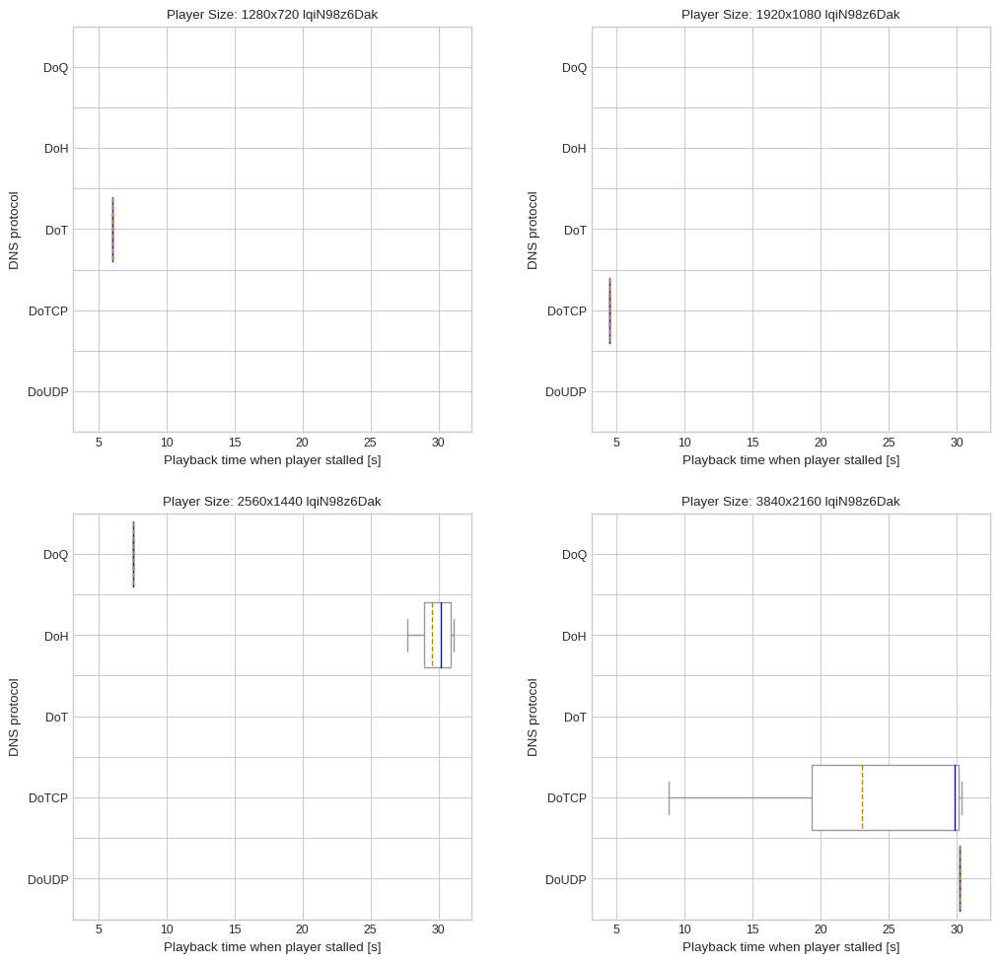

In [531]:
draw_boxplot_grid(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True, False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], "DNS protocol")

In [ ]:
draw_boxplot_grid(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True, False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0], "DNS protocol")

In [ ]:
draw_boxplot(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0], "DNS protocol")

Africa South


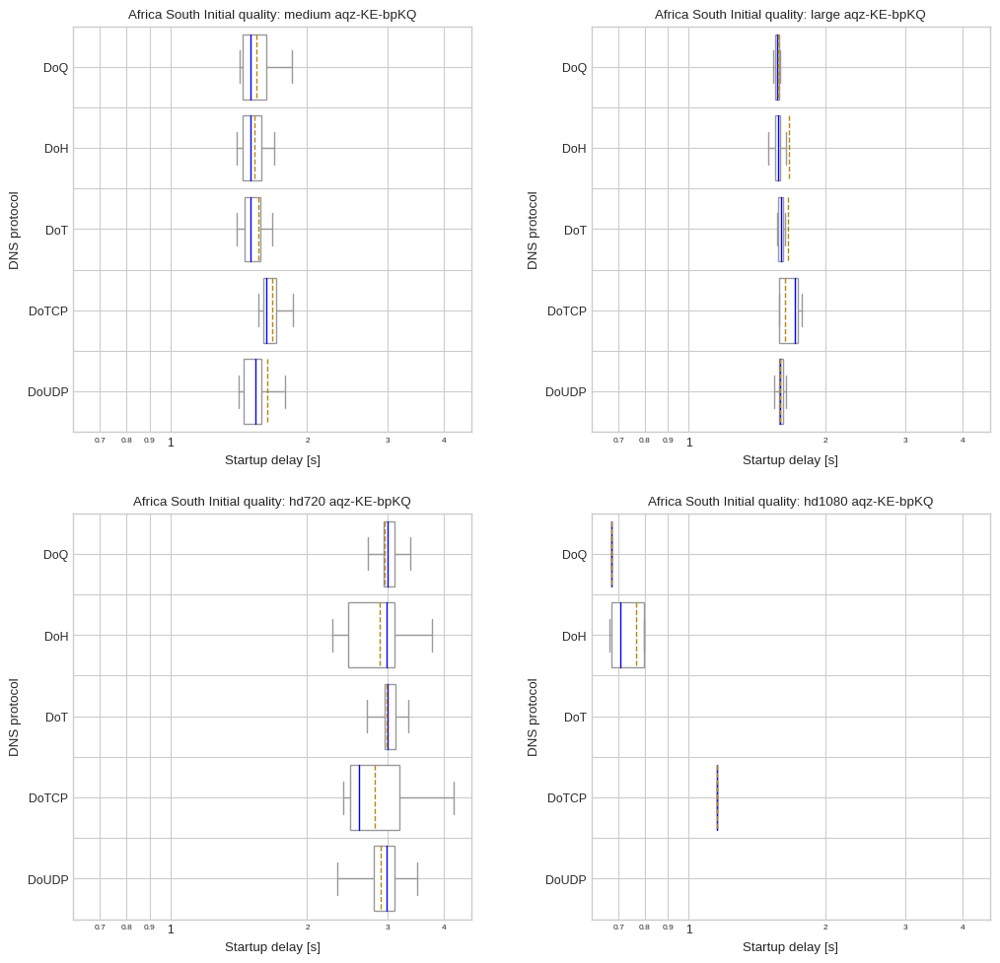

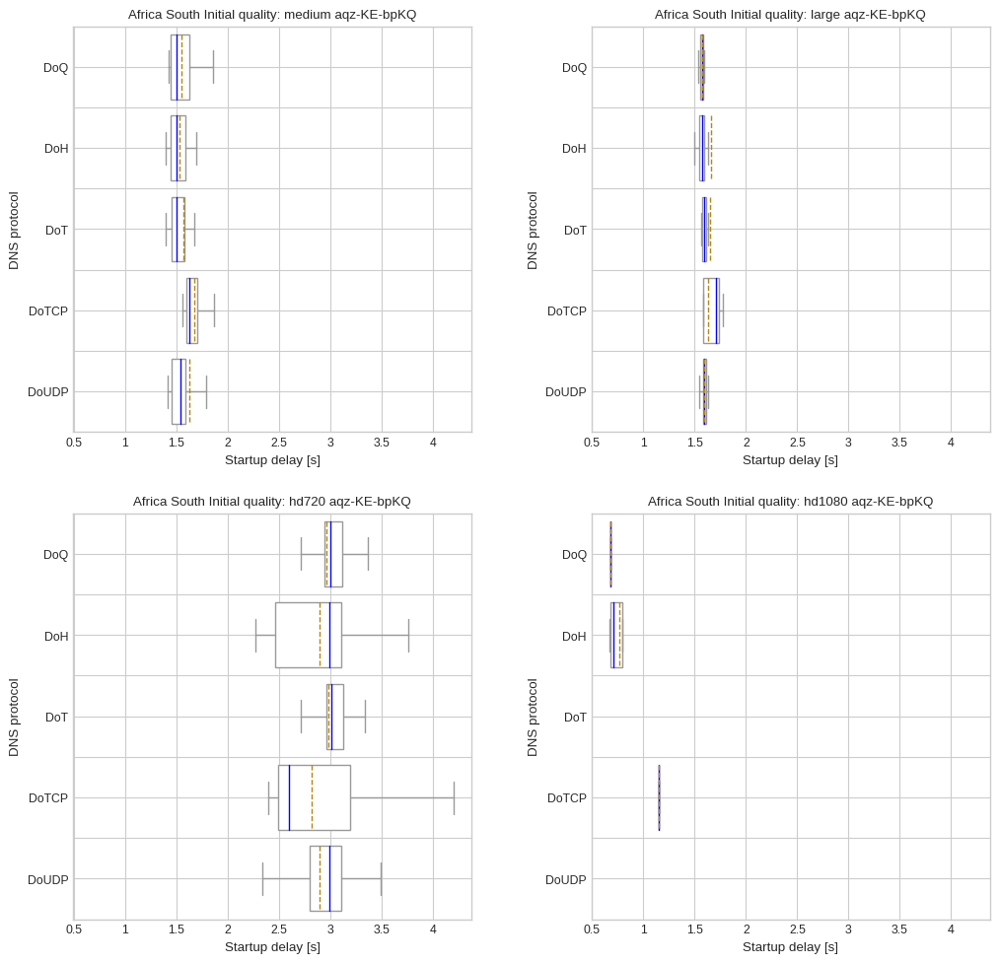

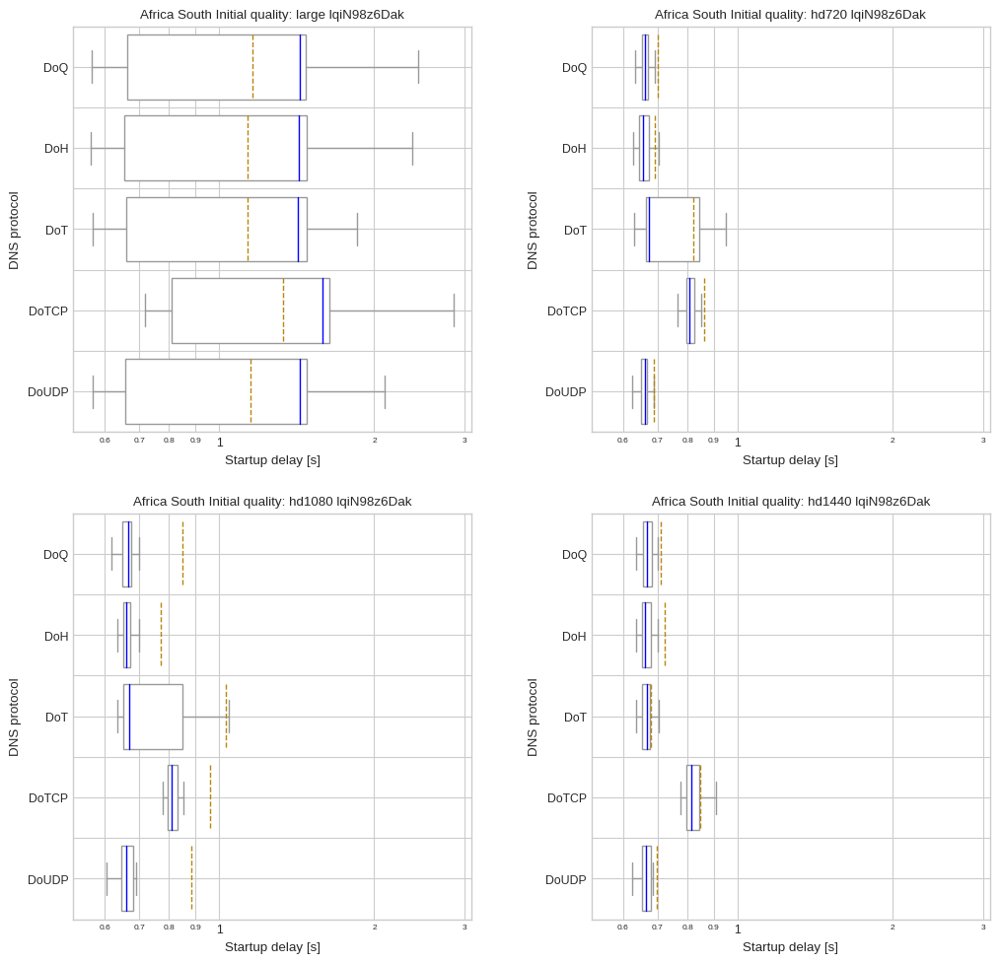

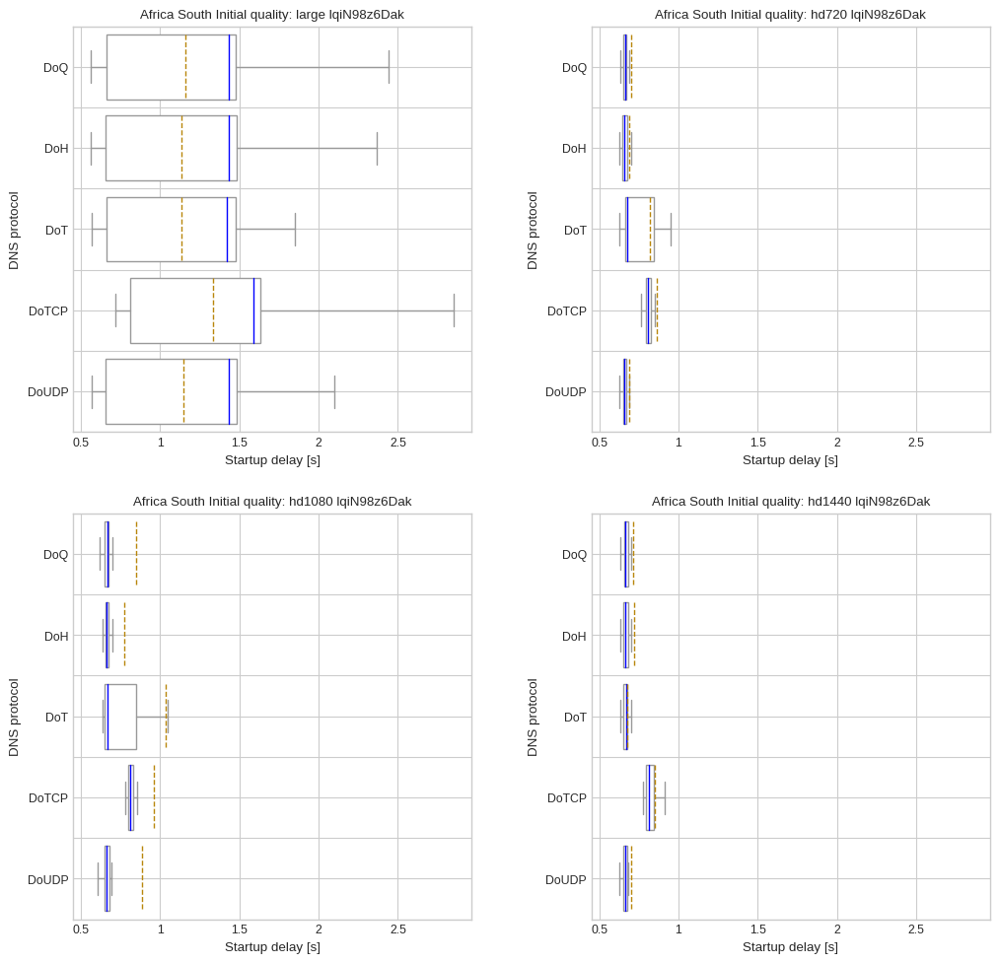

Asia Pacific Northeast


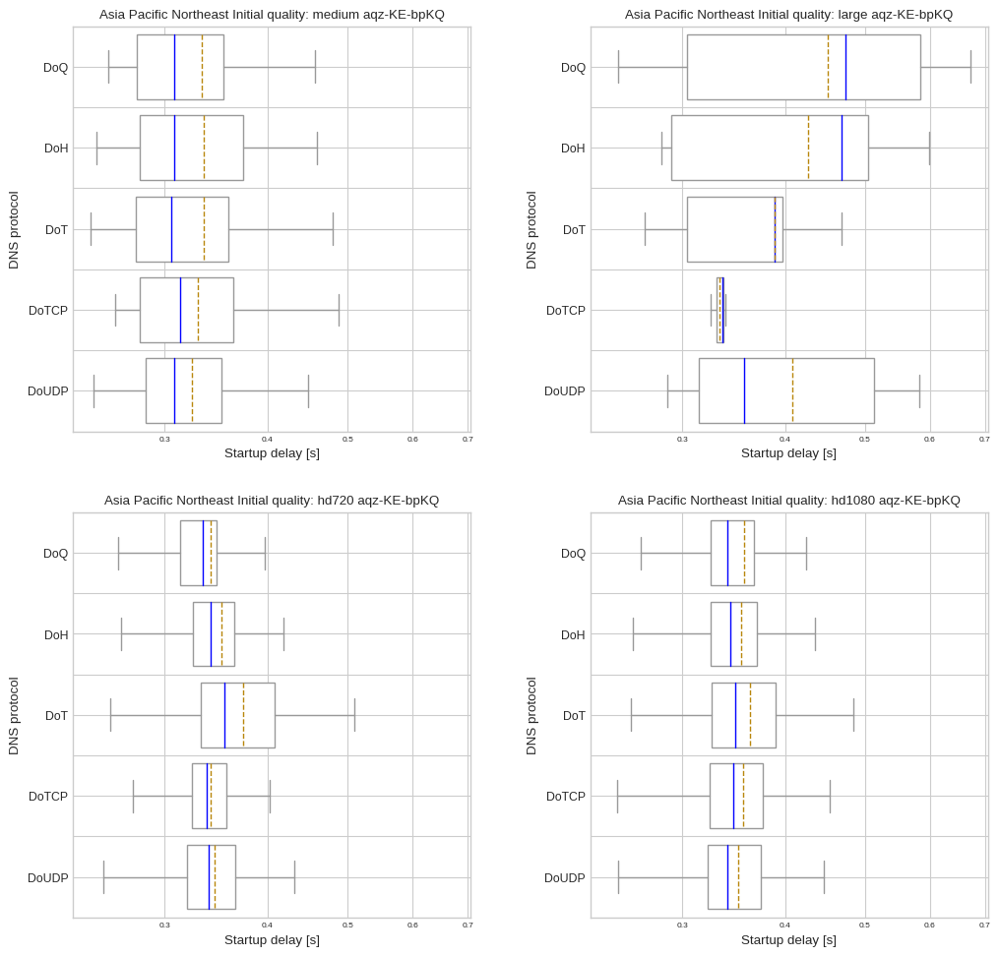

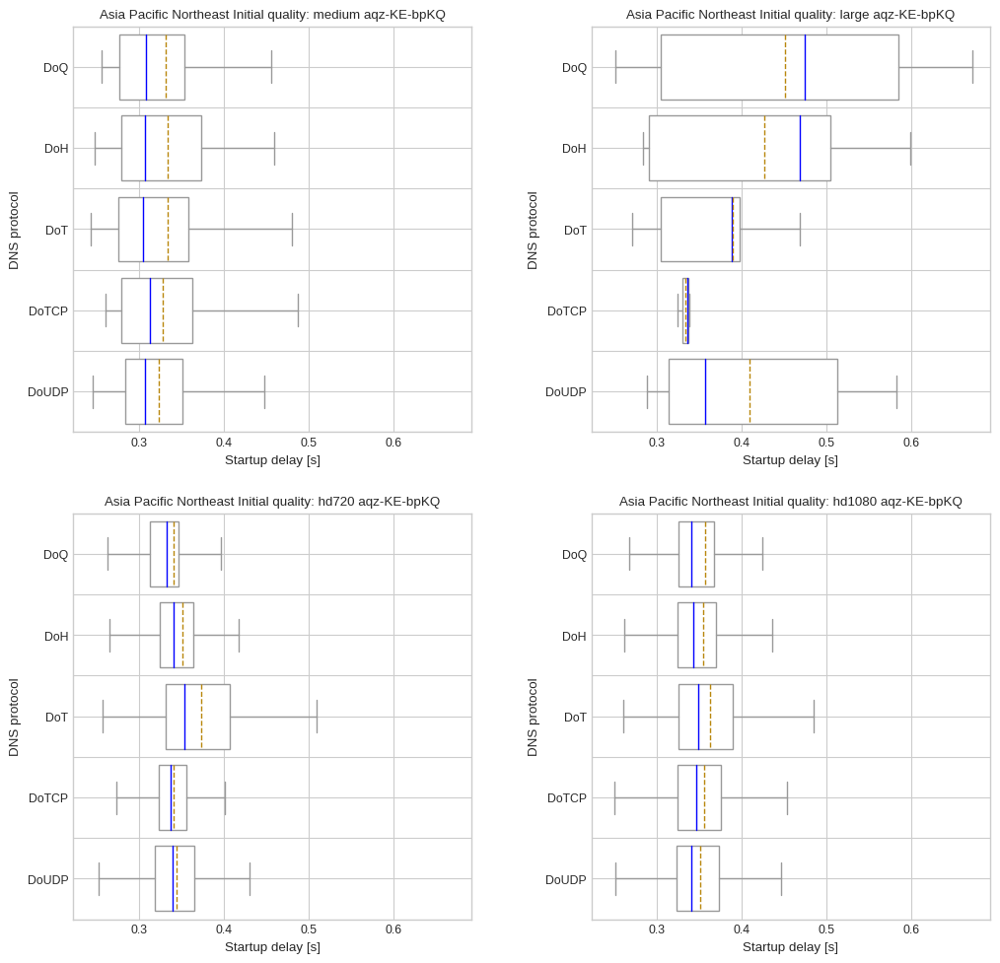

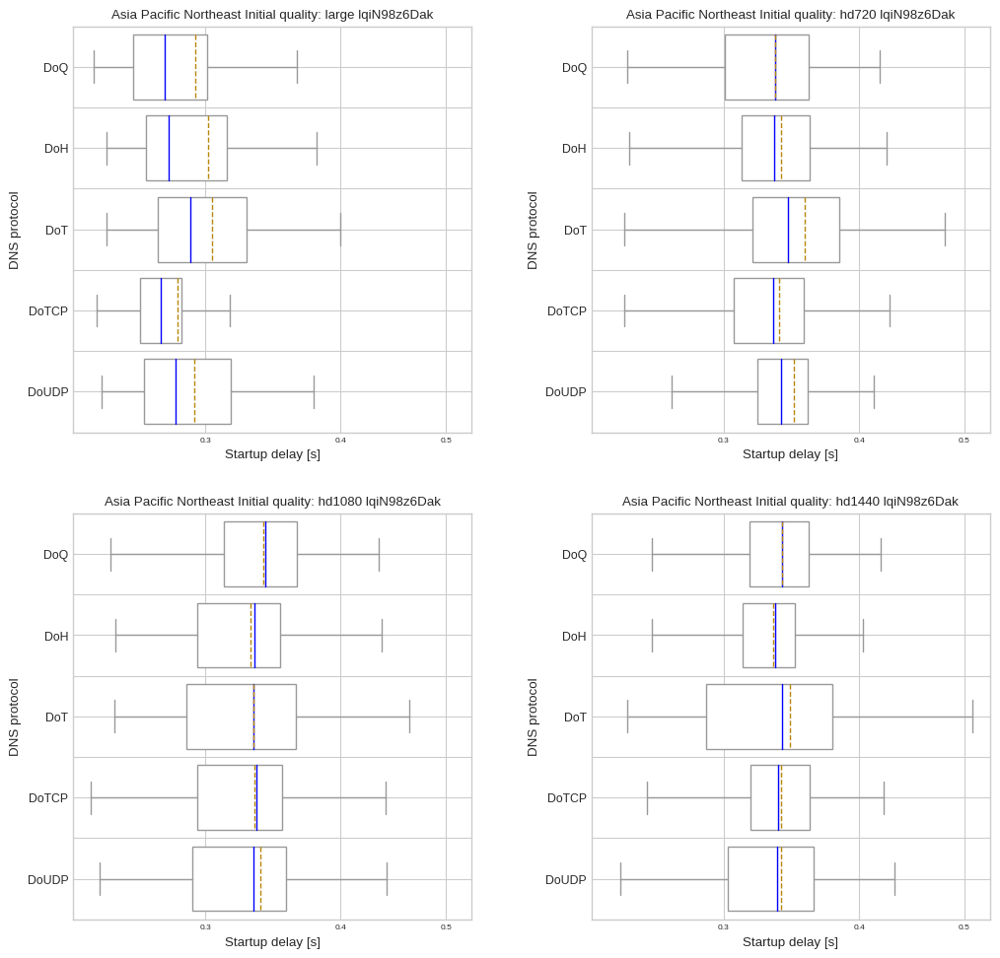

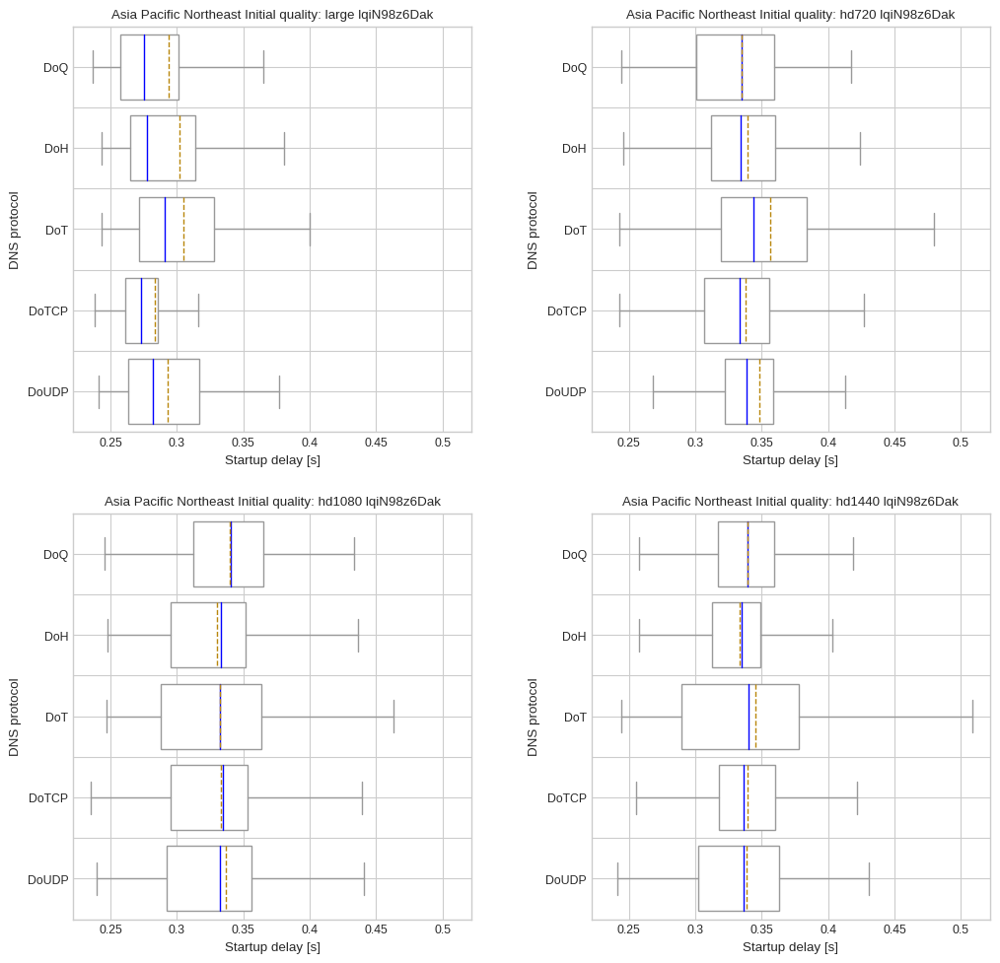

Asia Pacific Southeast


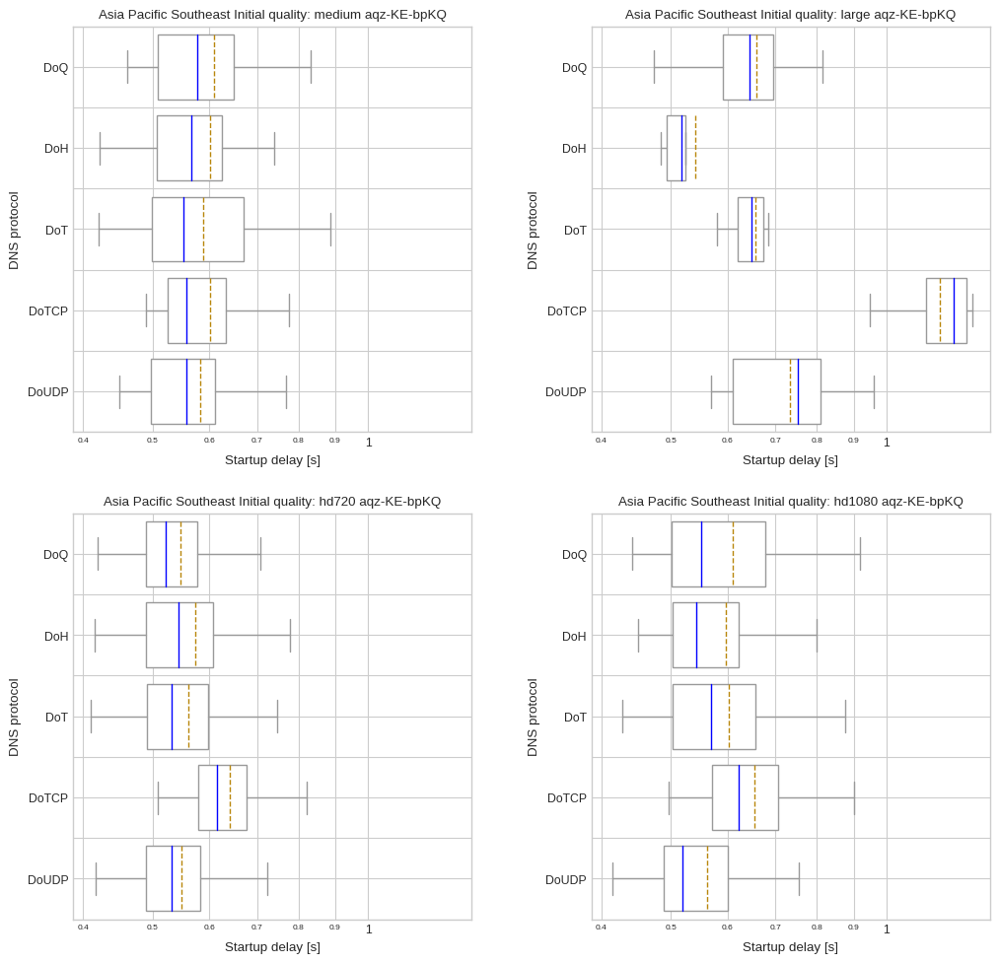

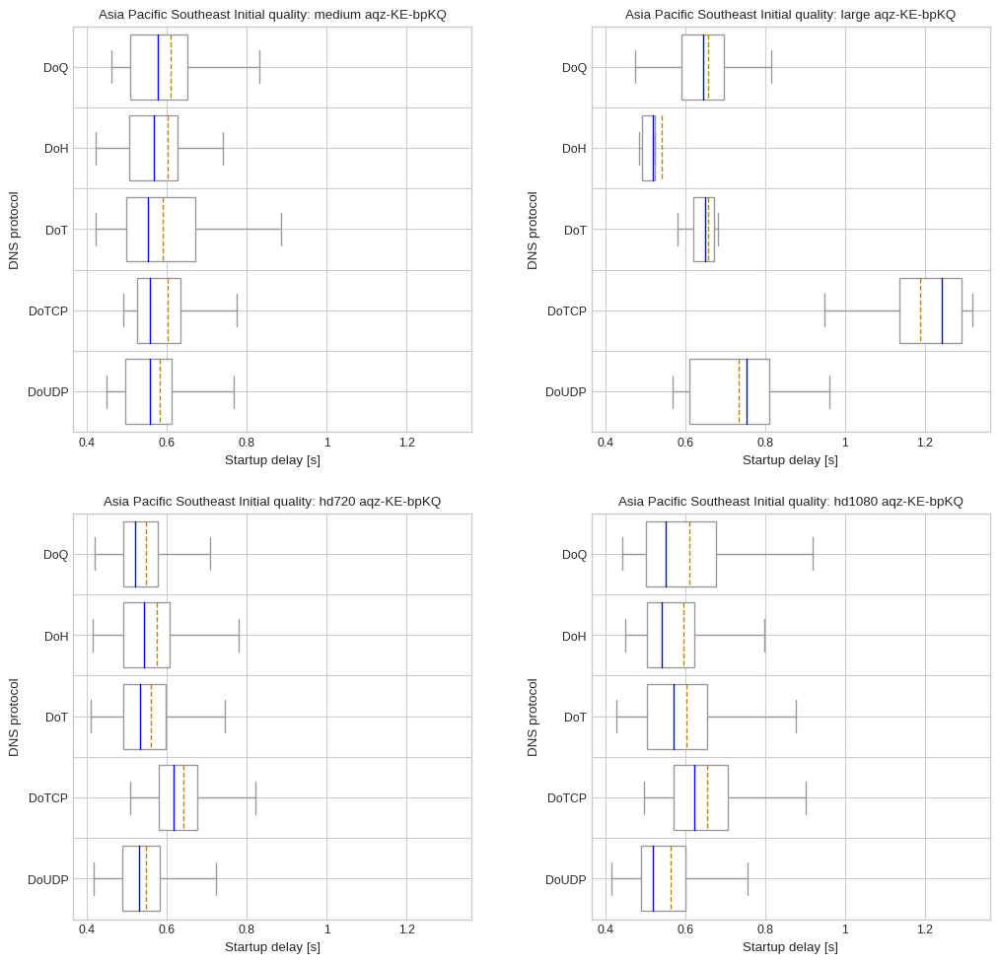

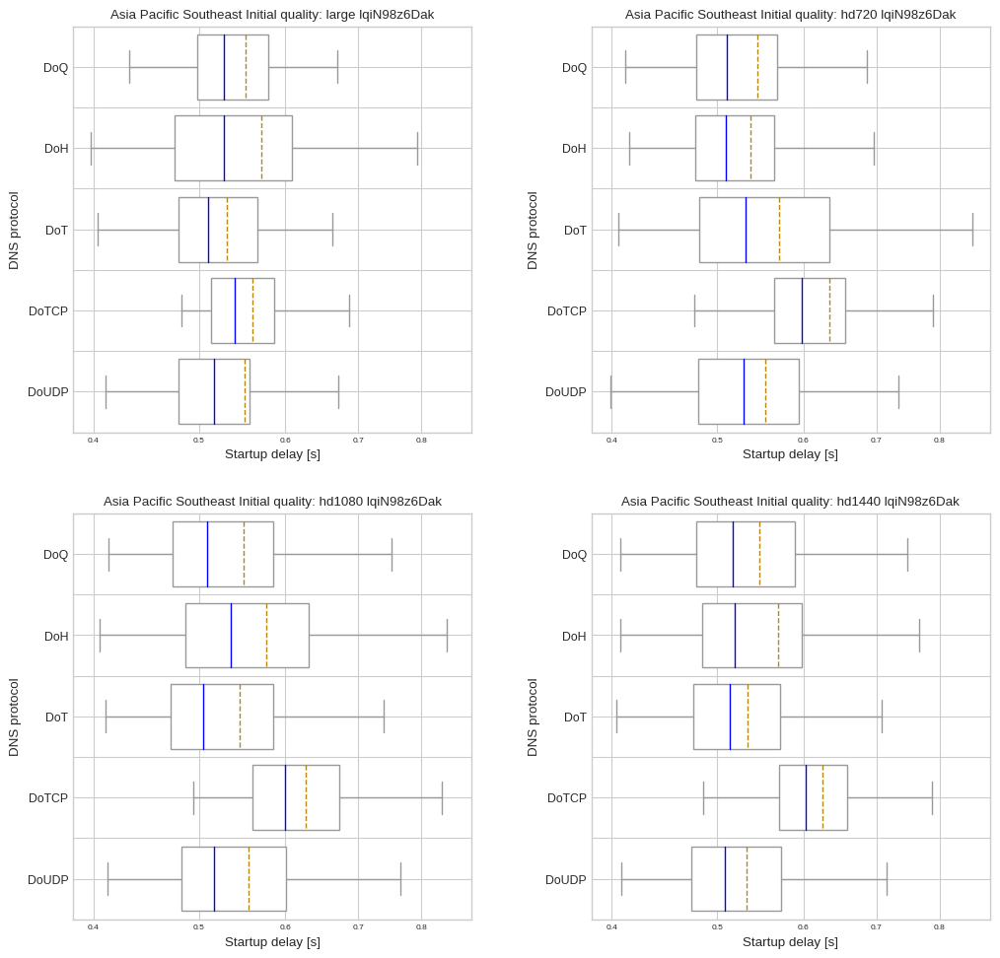

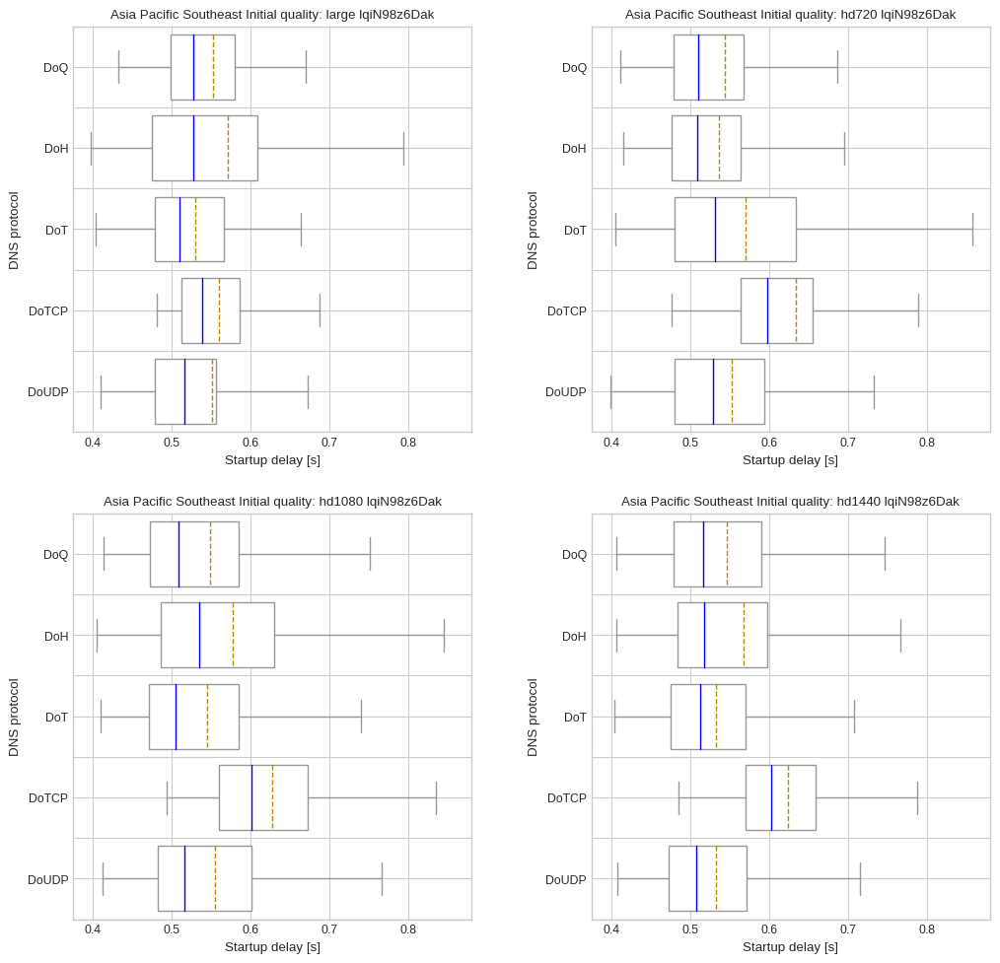

Europe Central


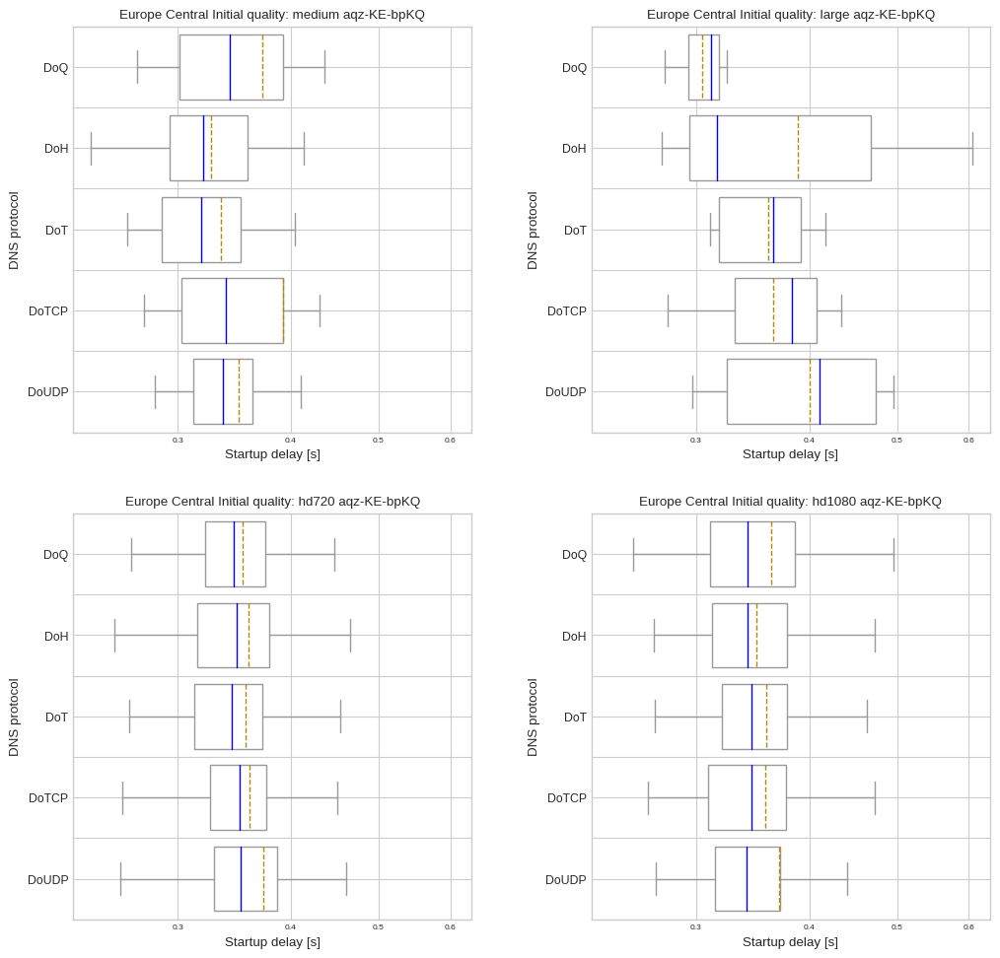

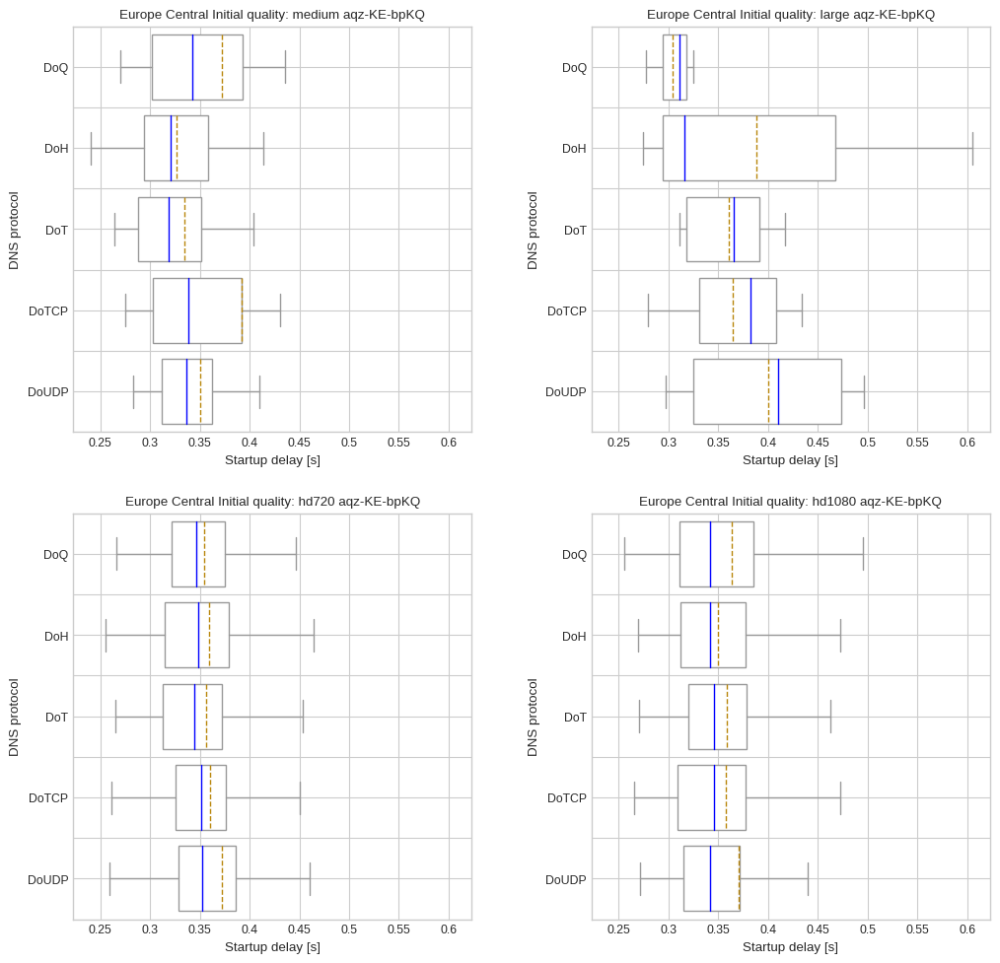

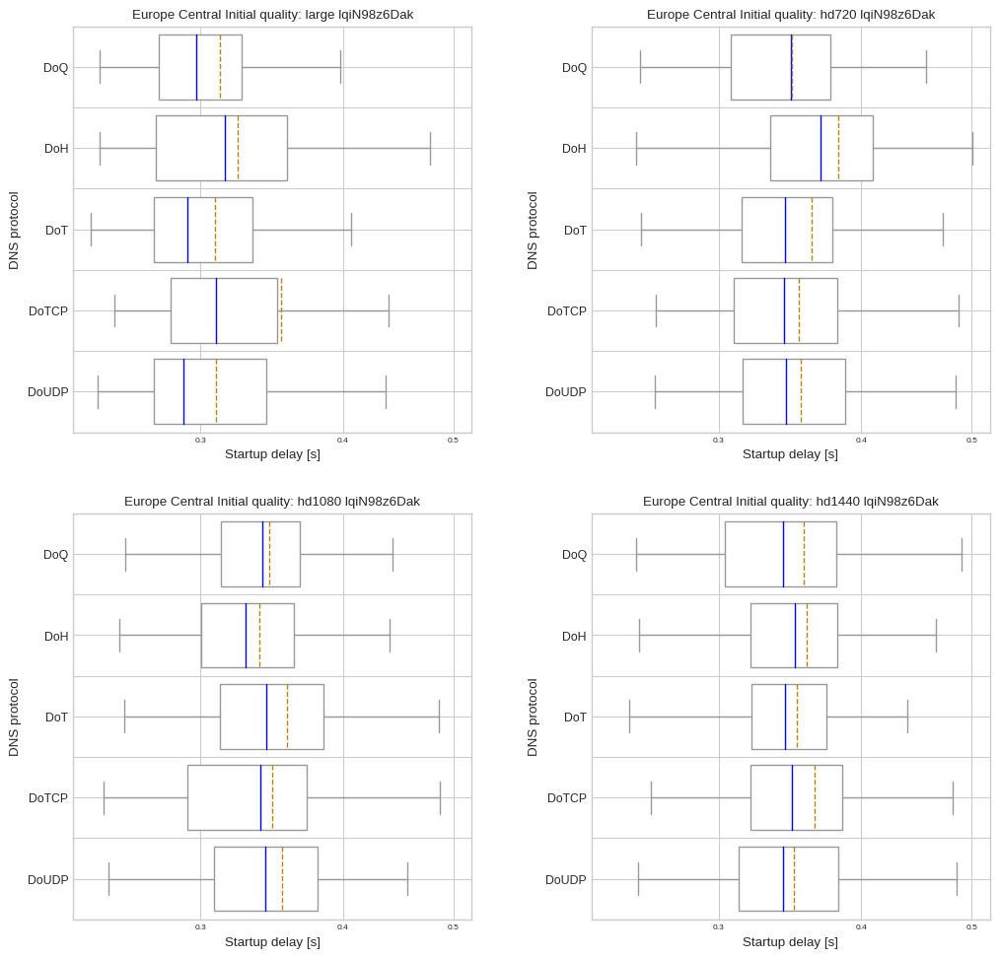

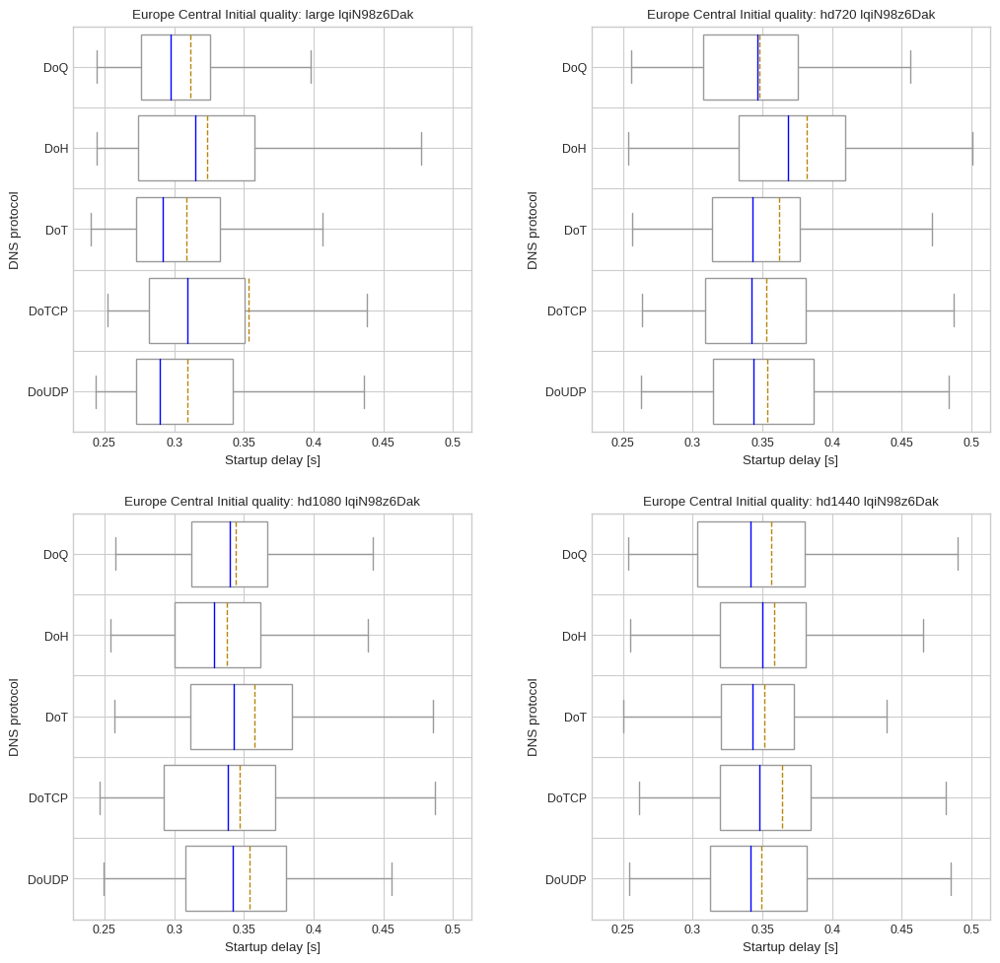

South America East


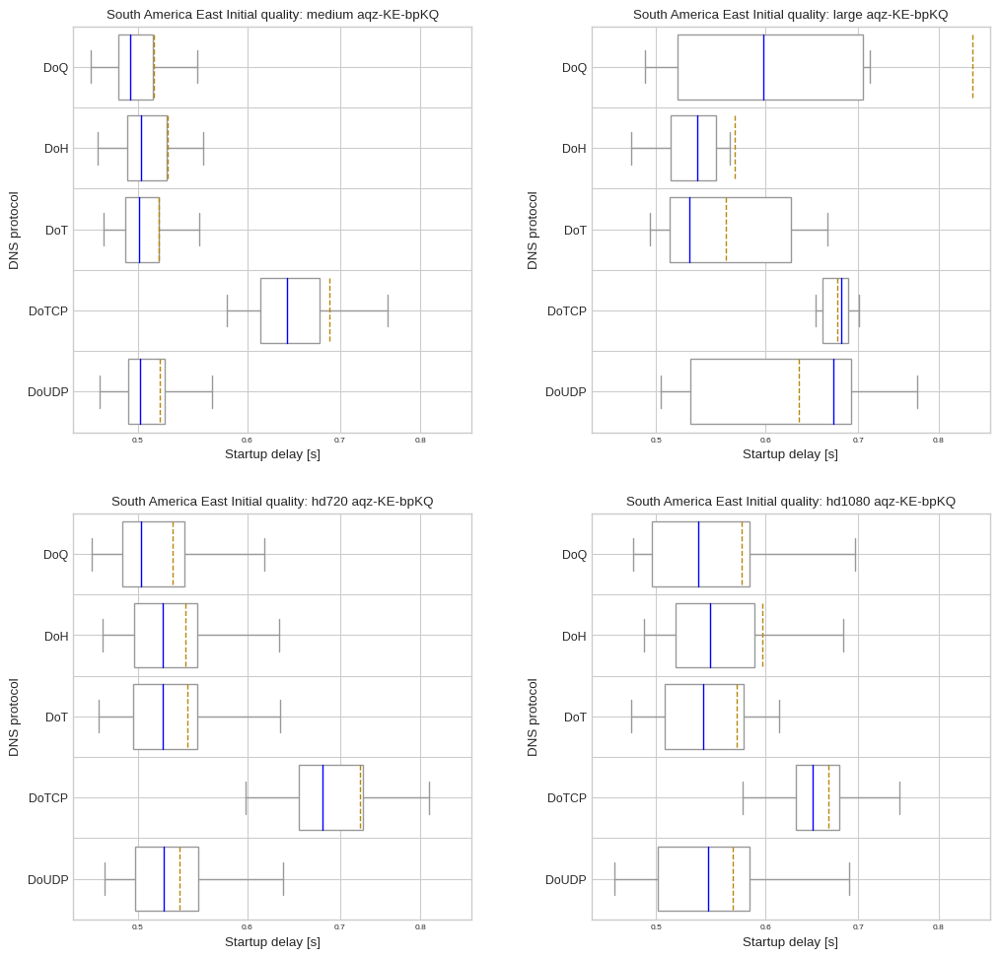

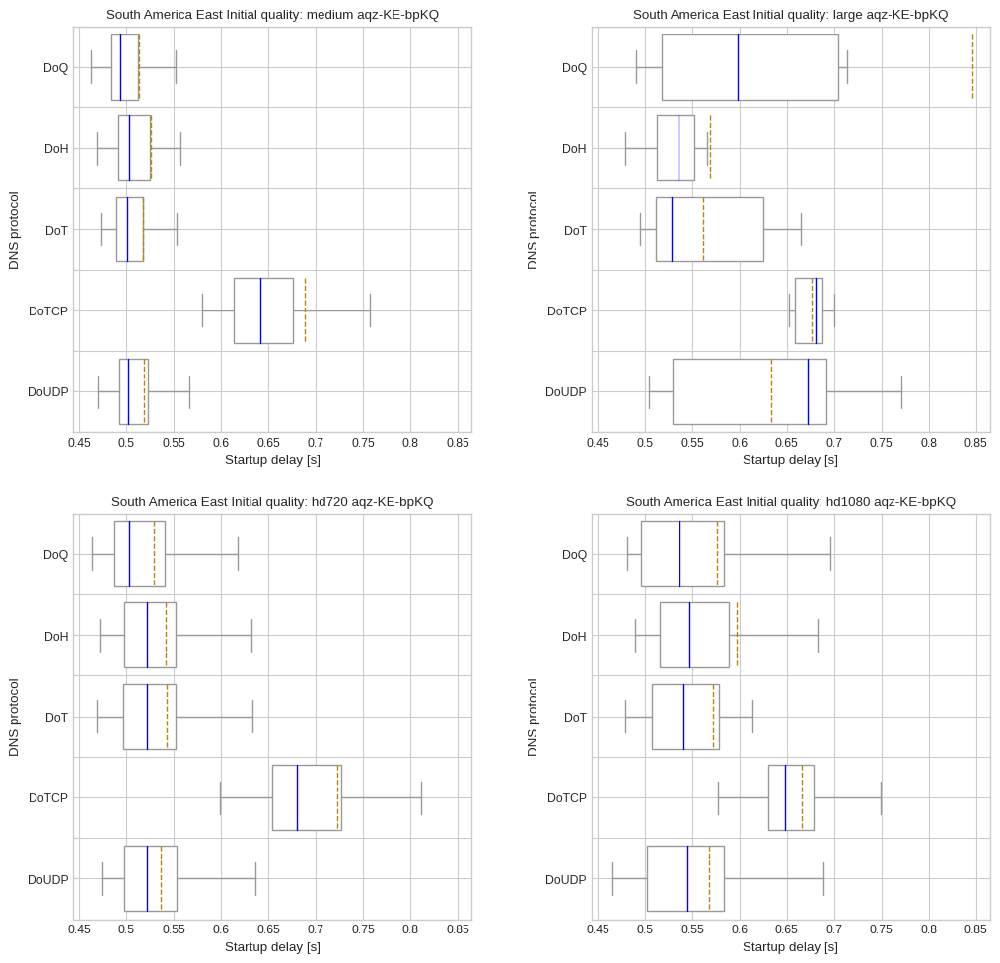

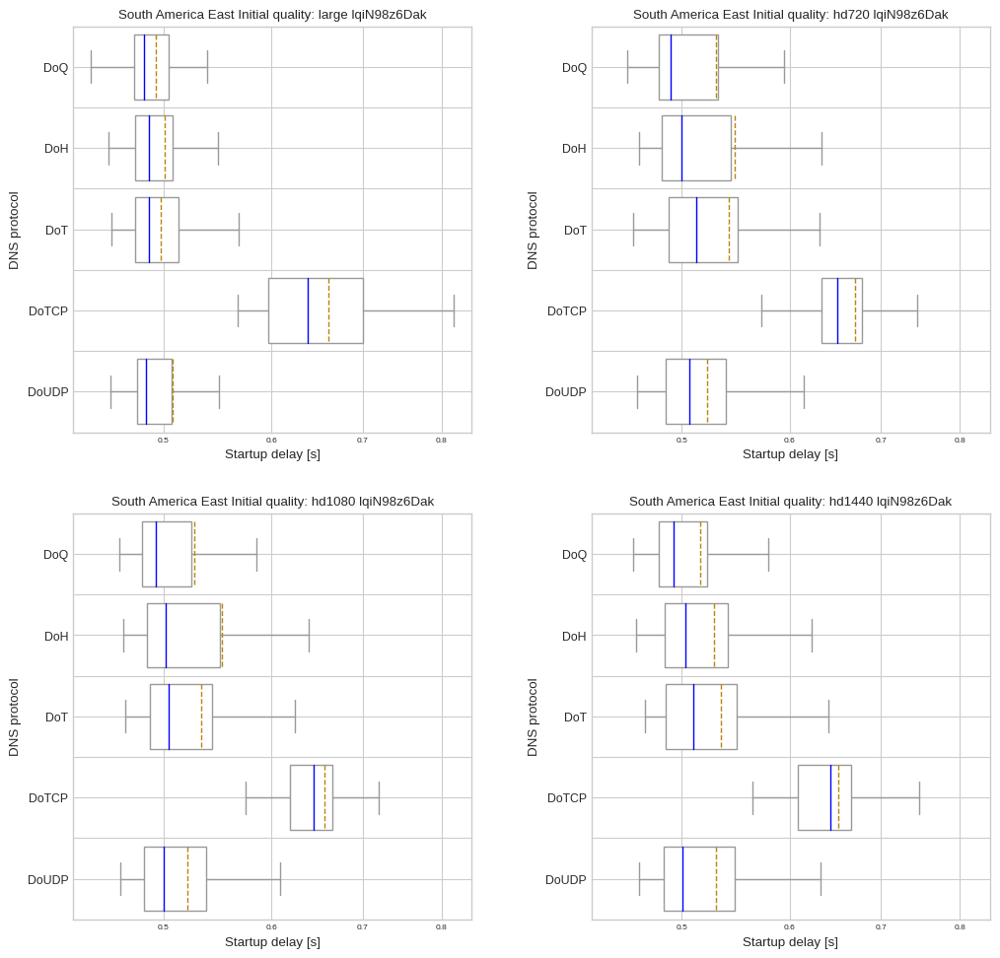

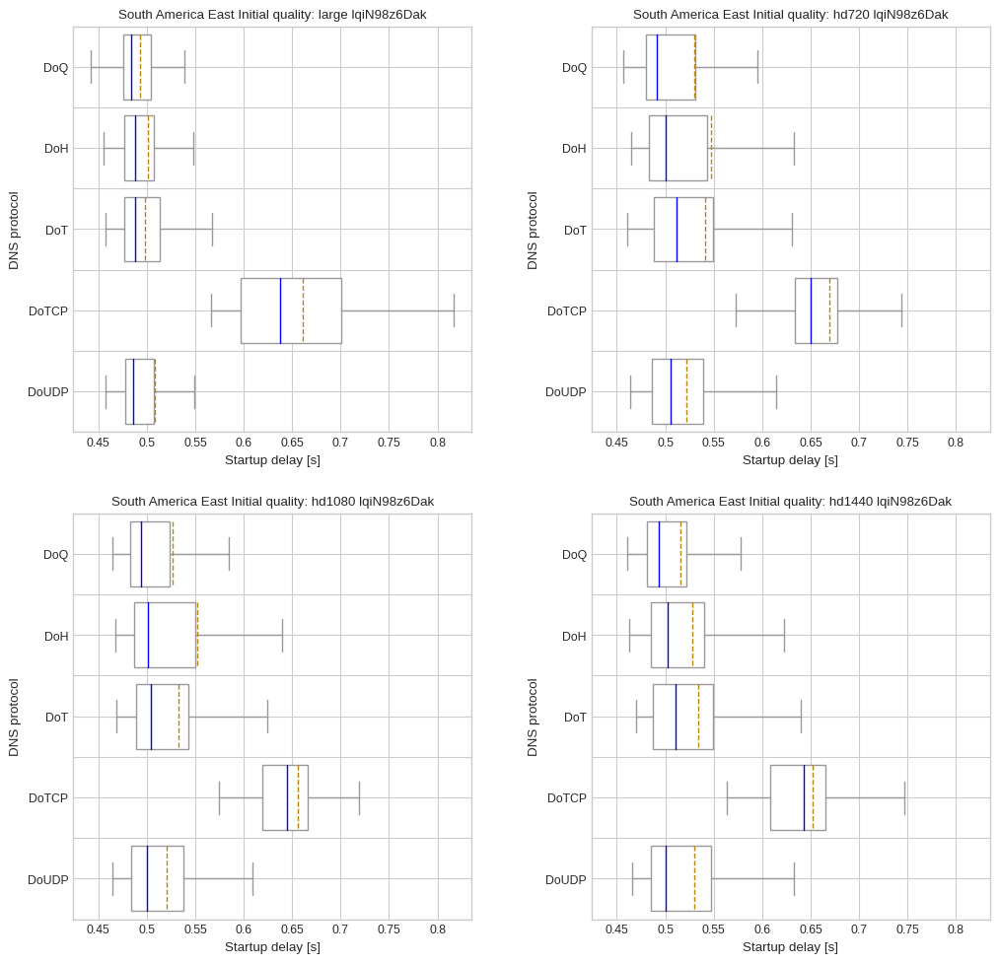

US East


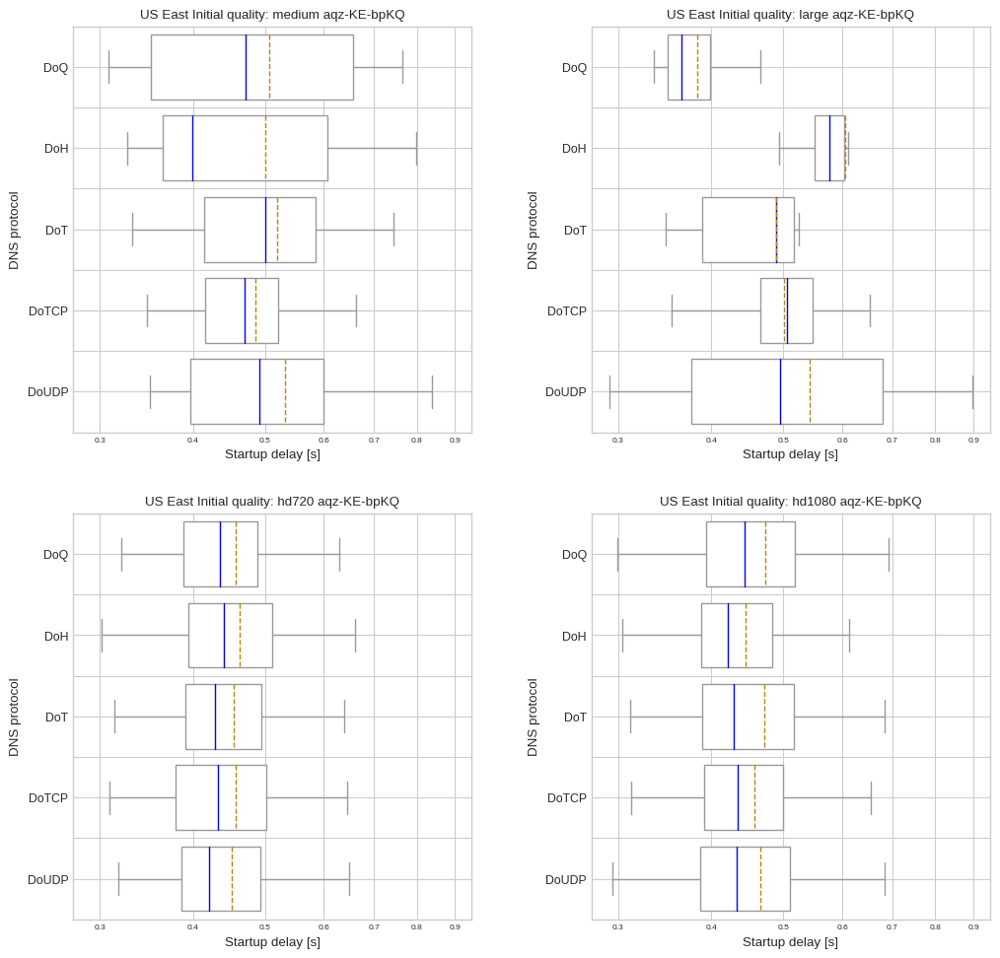

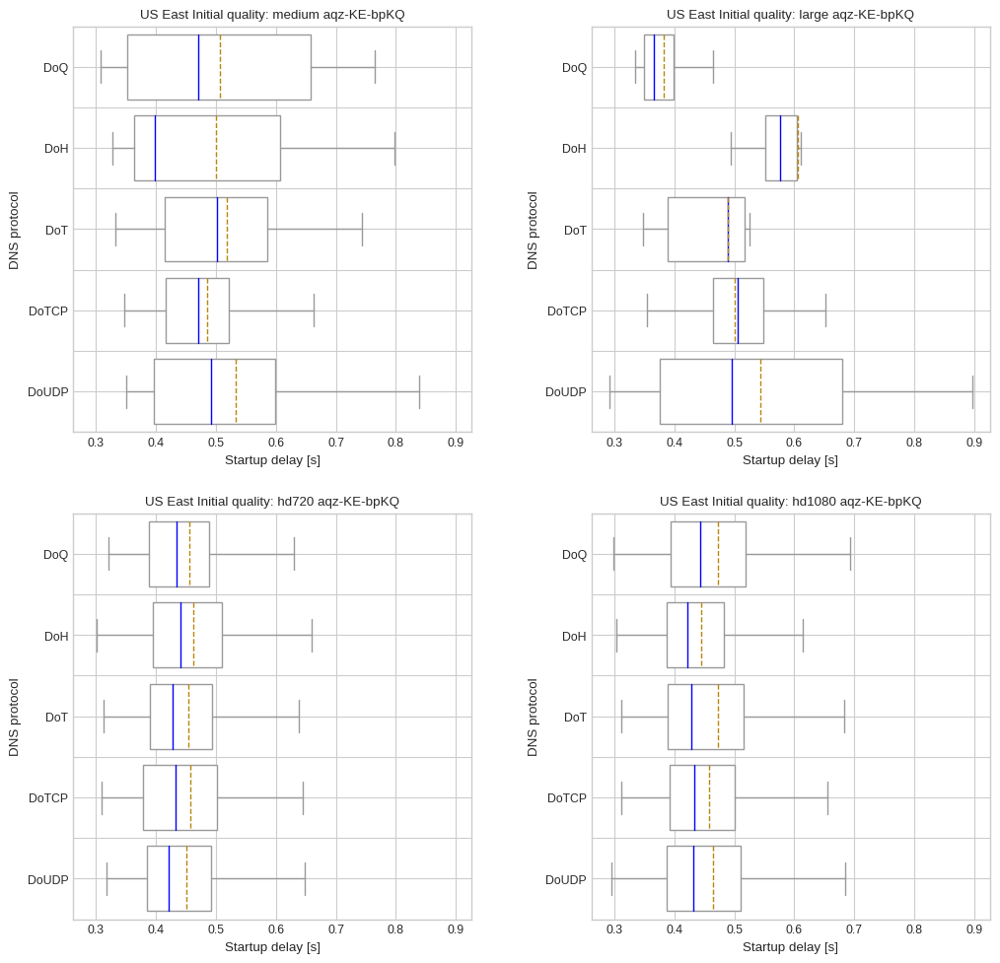

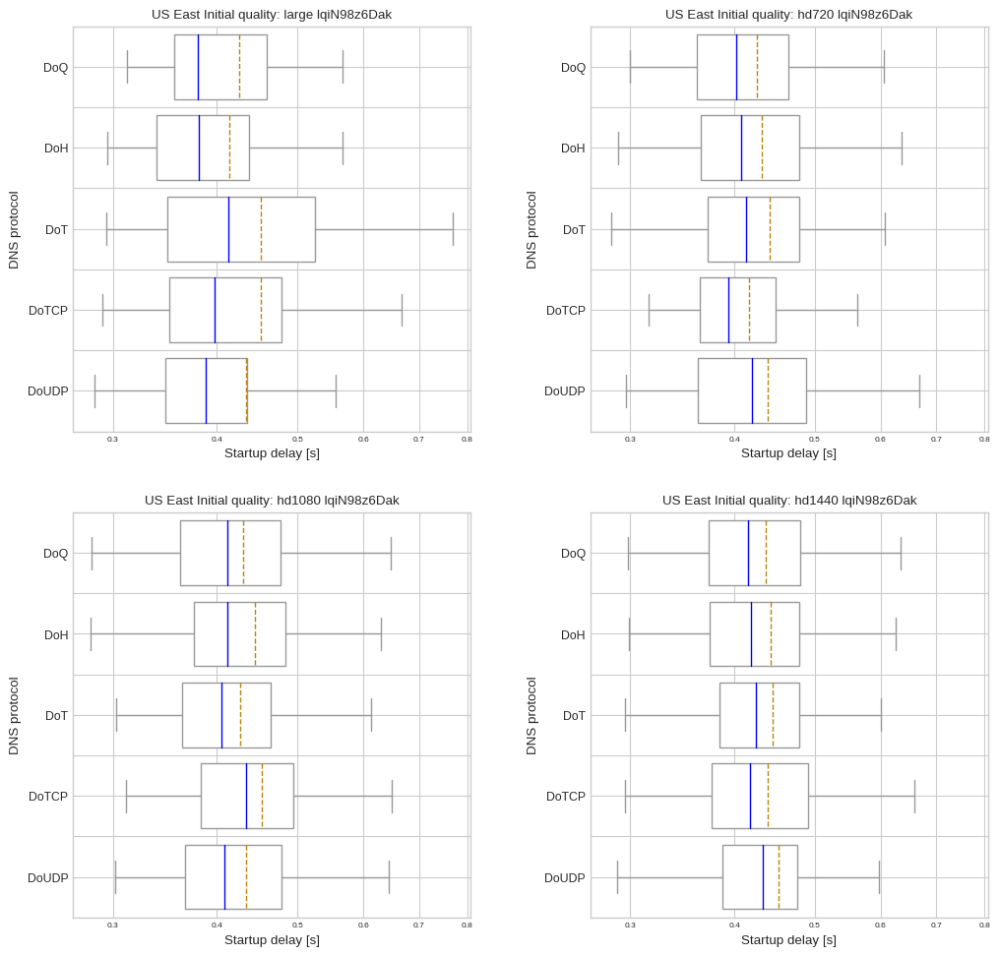

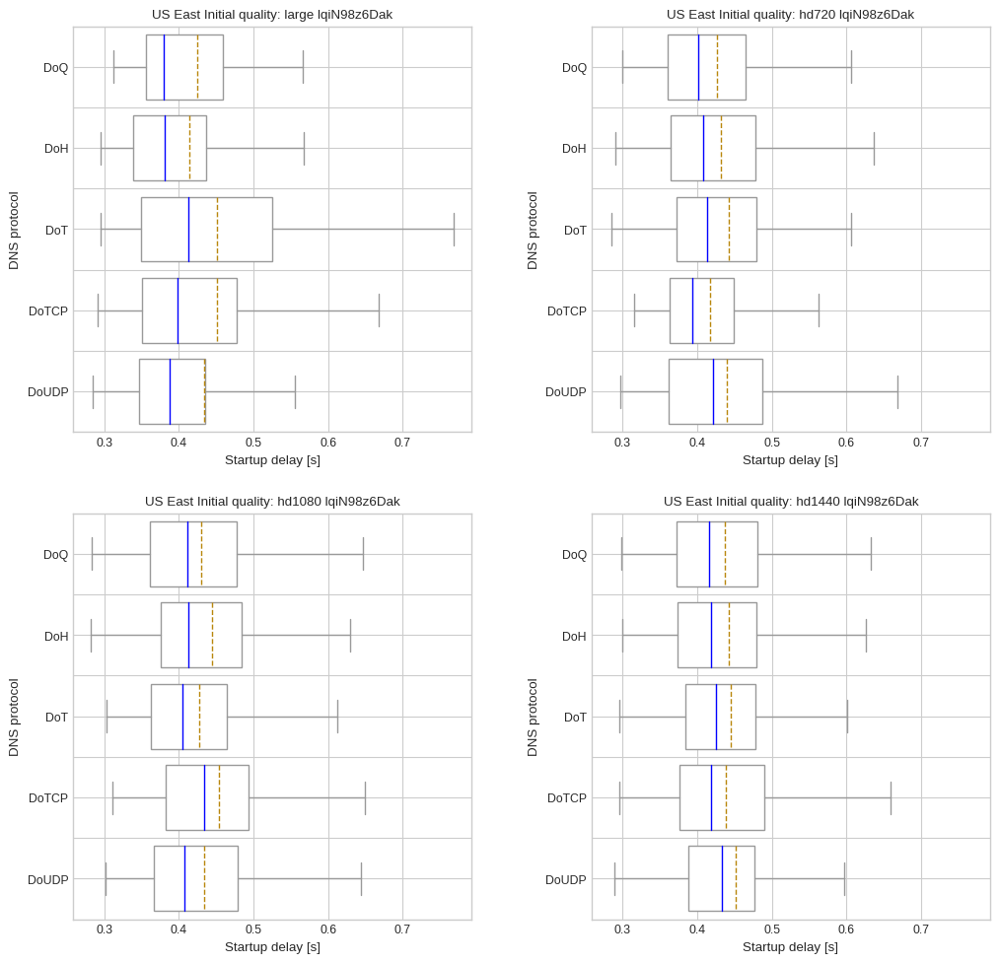

US West


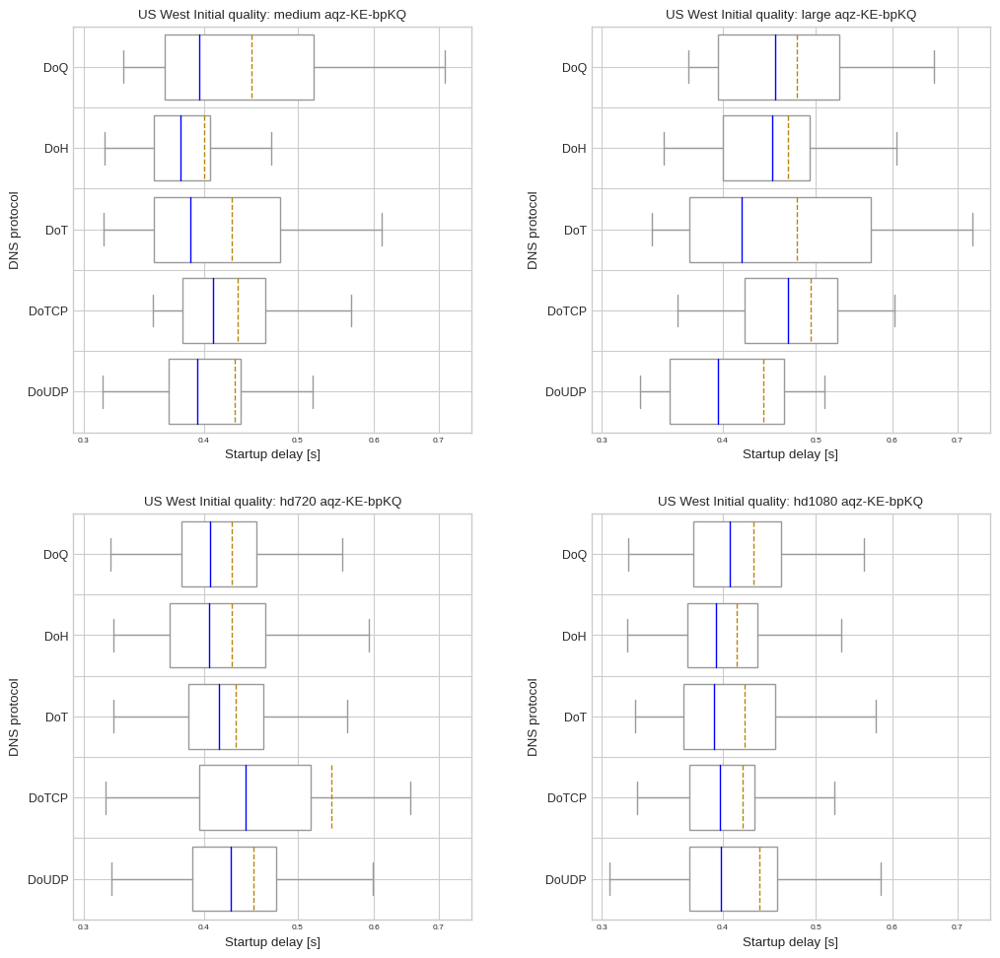

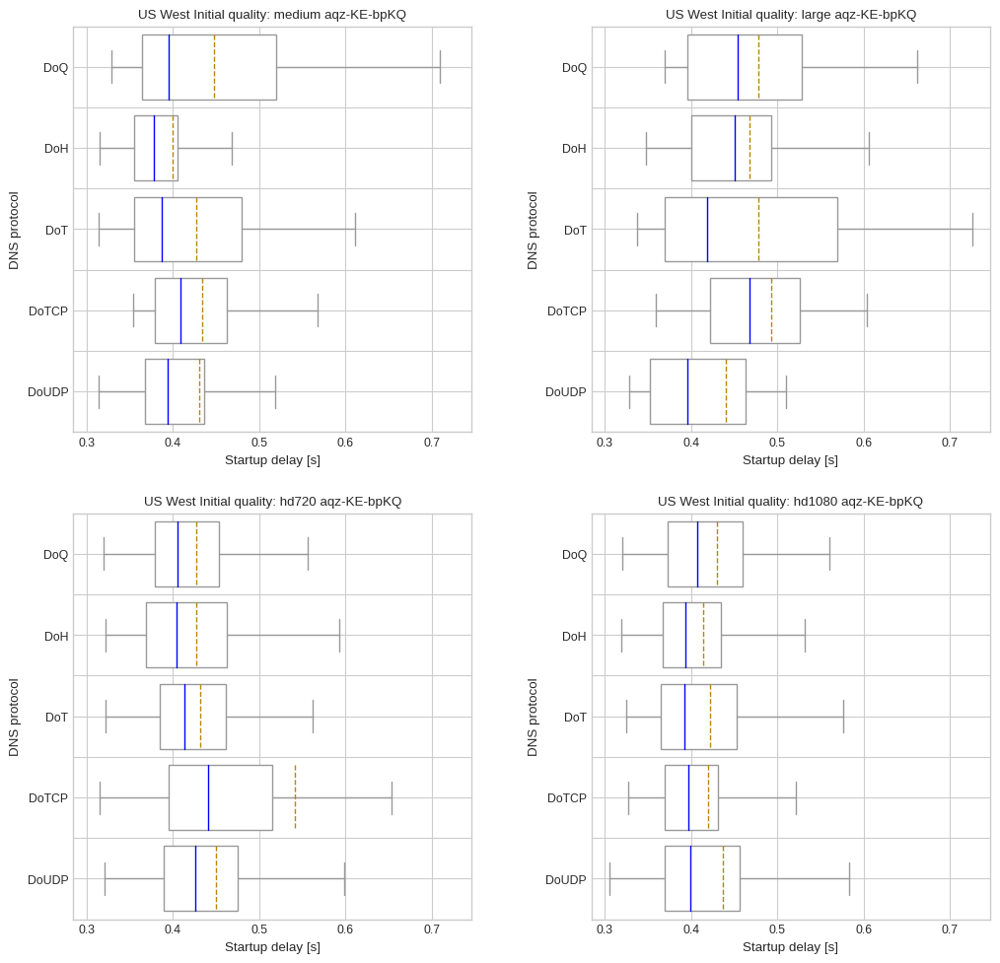

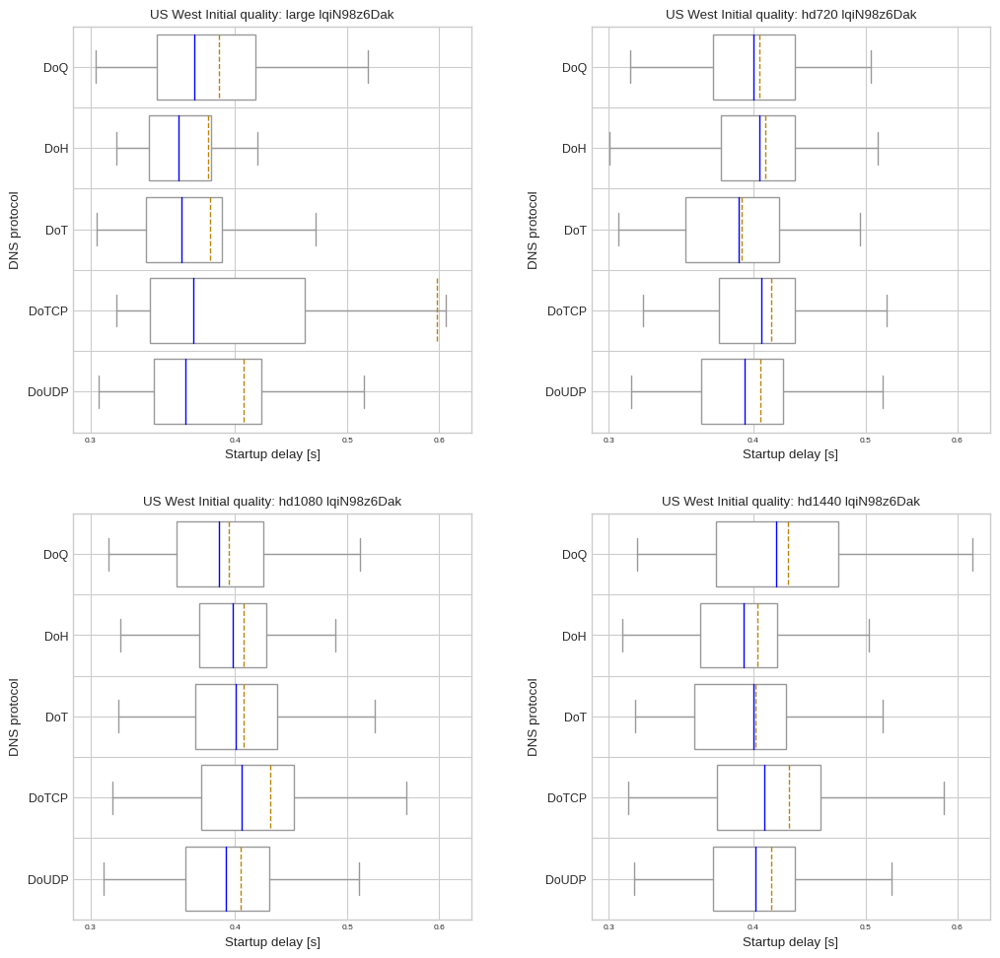

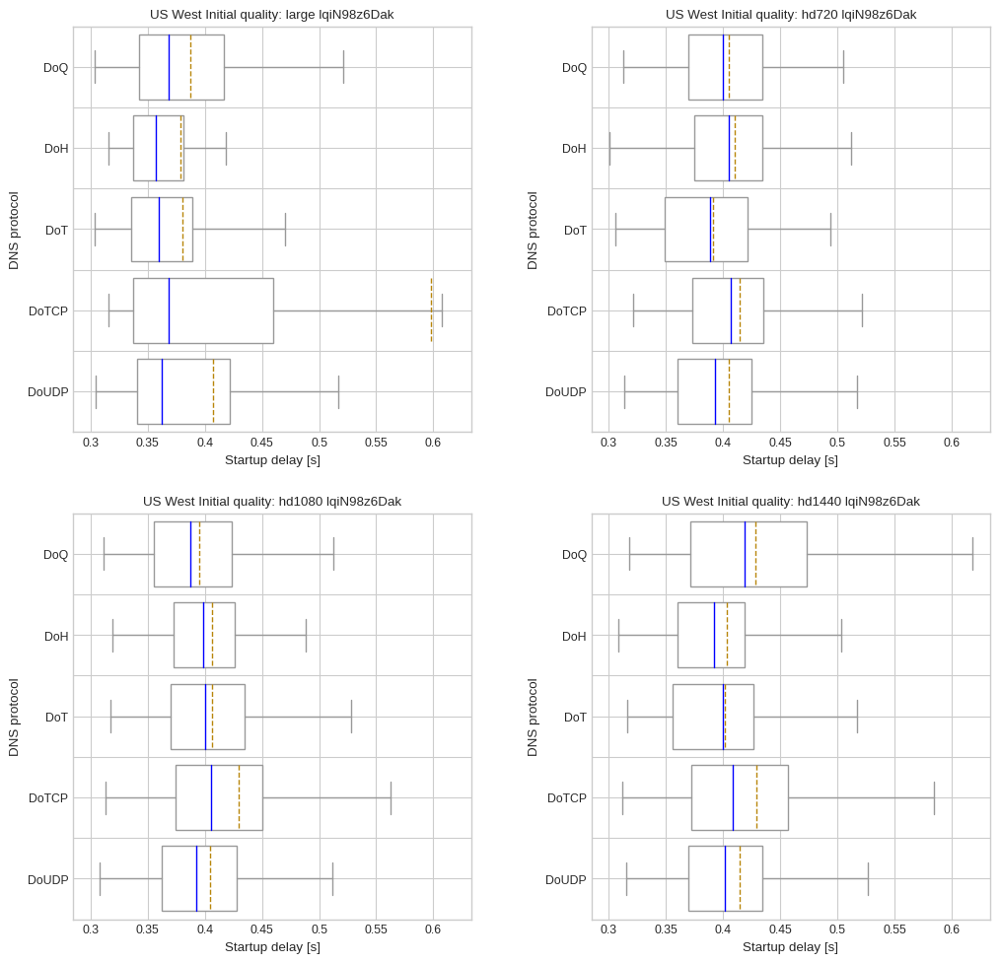

all vantage points


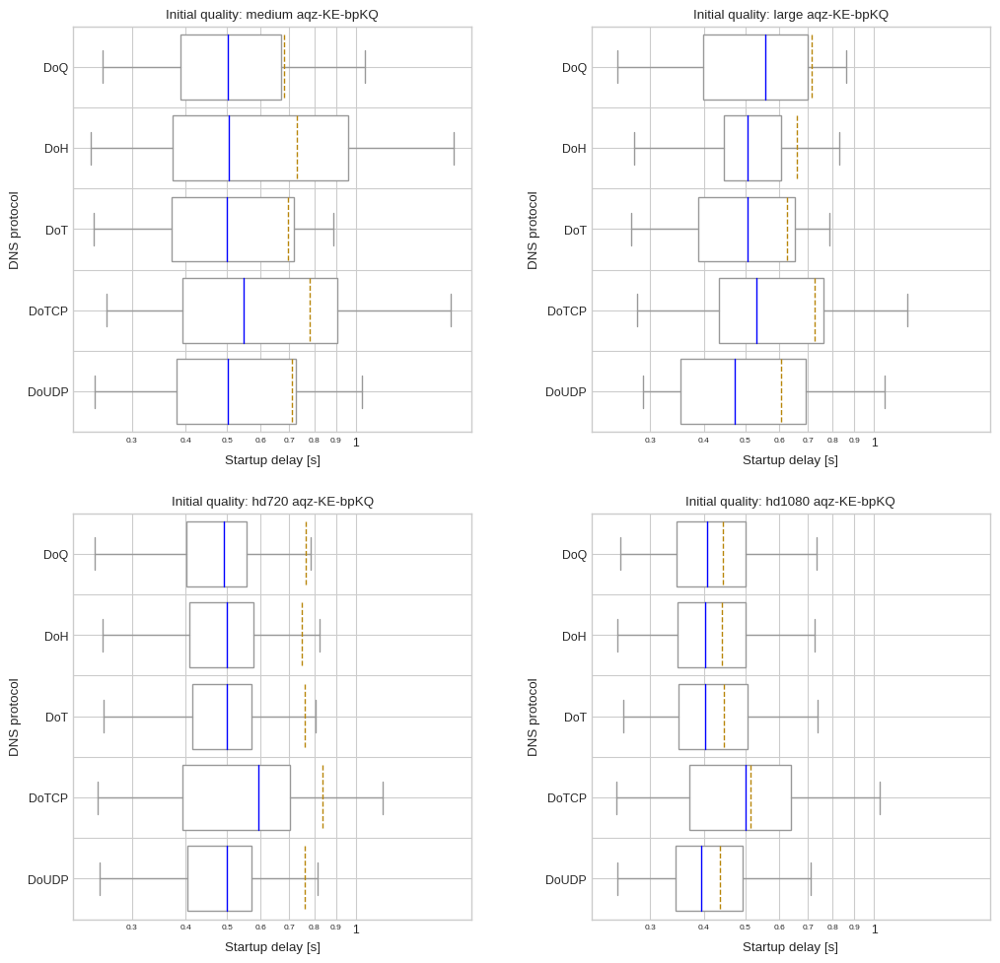

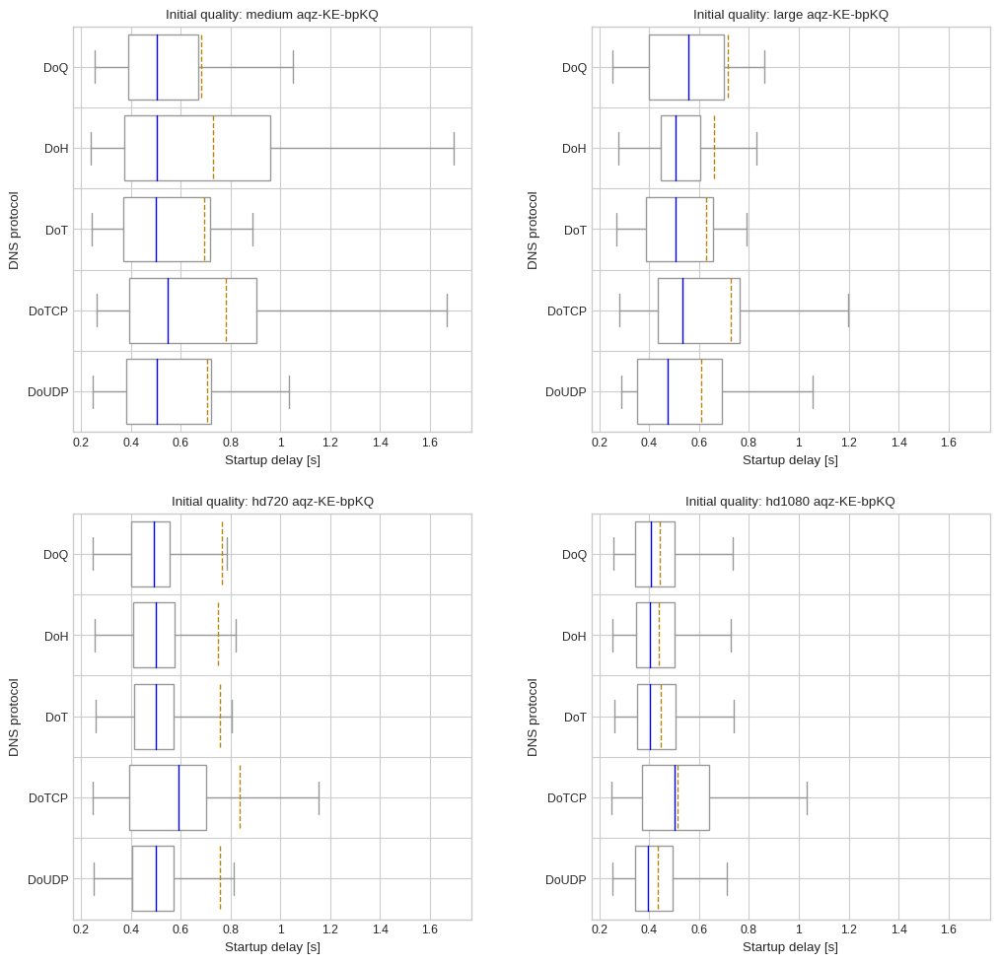

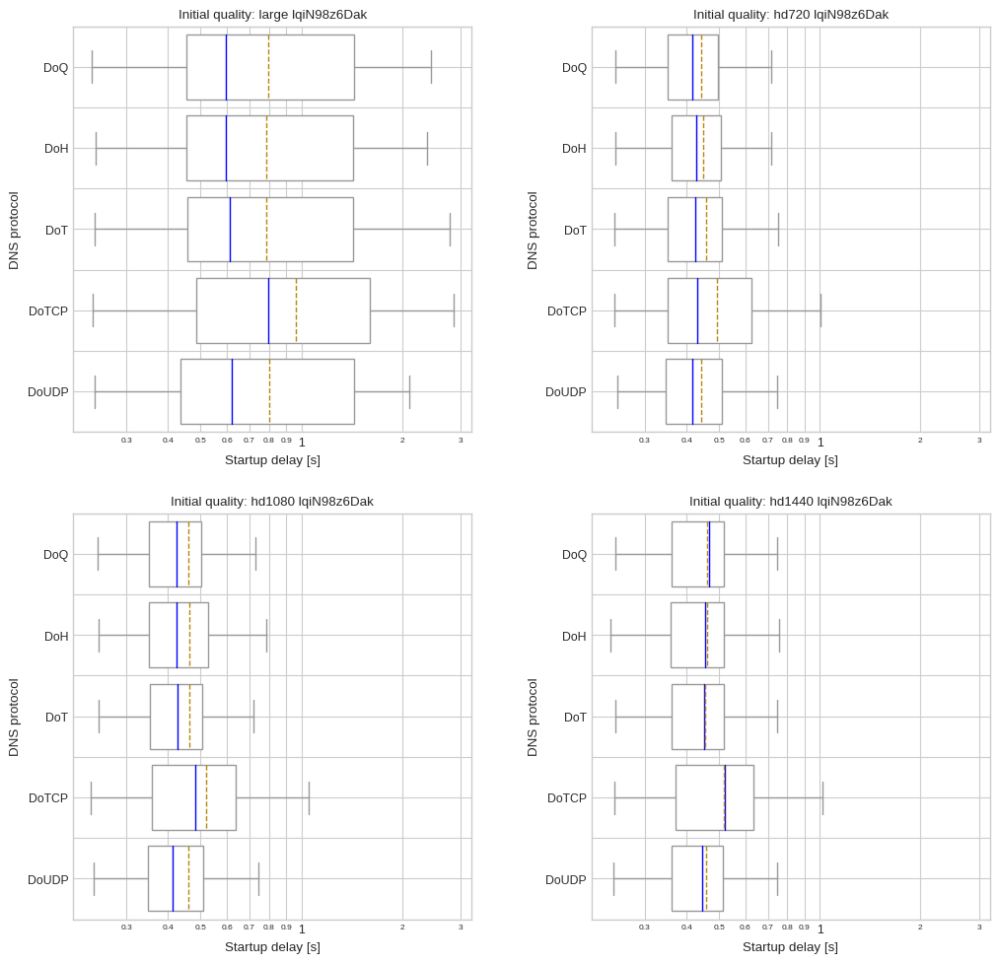

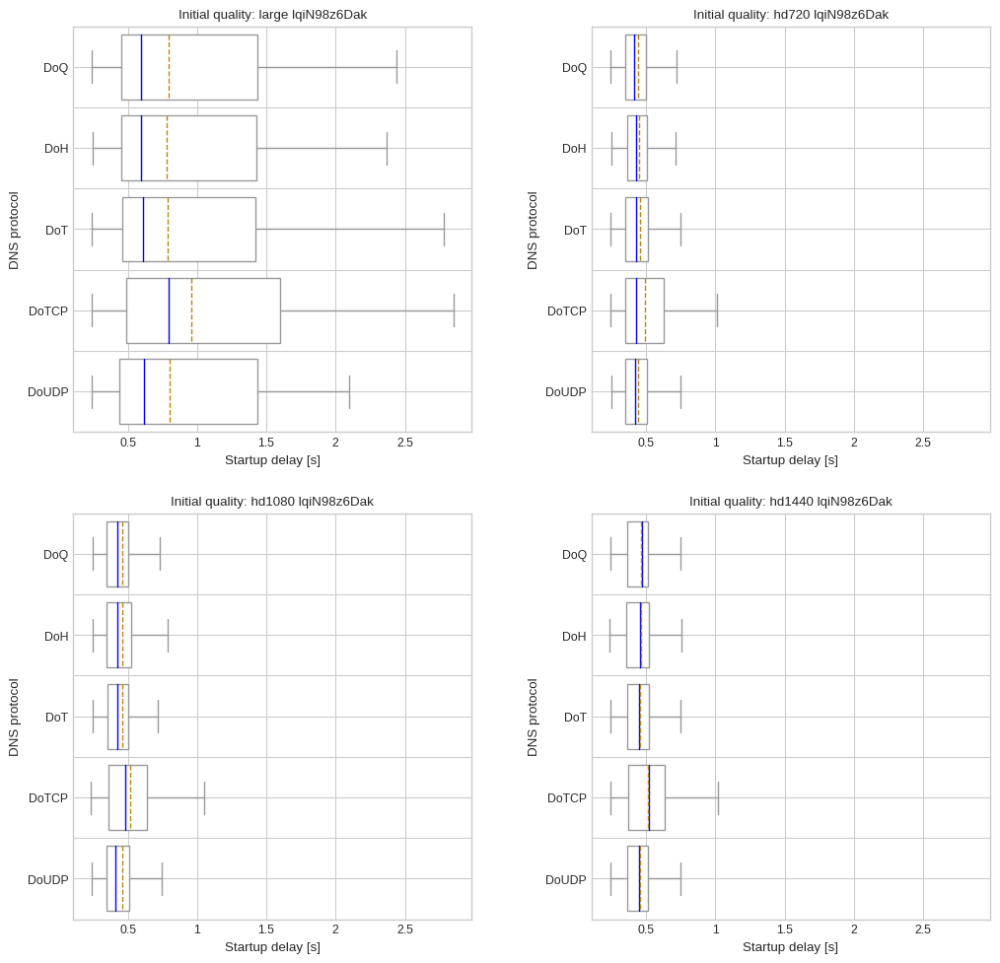

In [532]:
draw_boxplot_grid(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True, False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], "DNS protocol")


Africa South


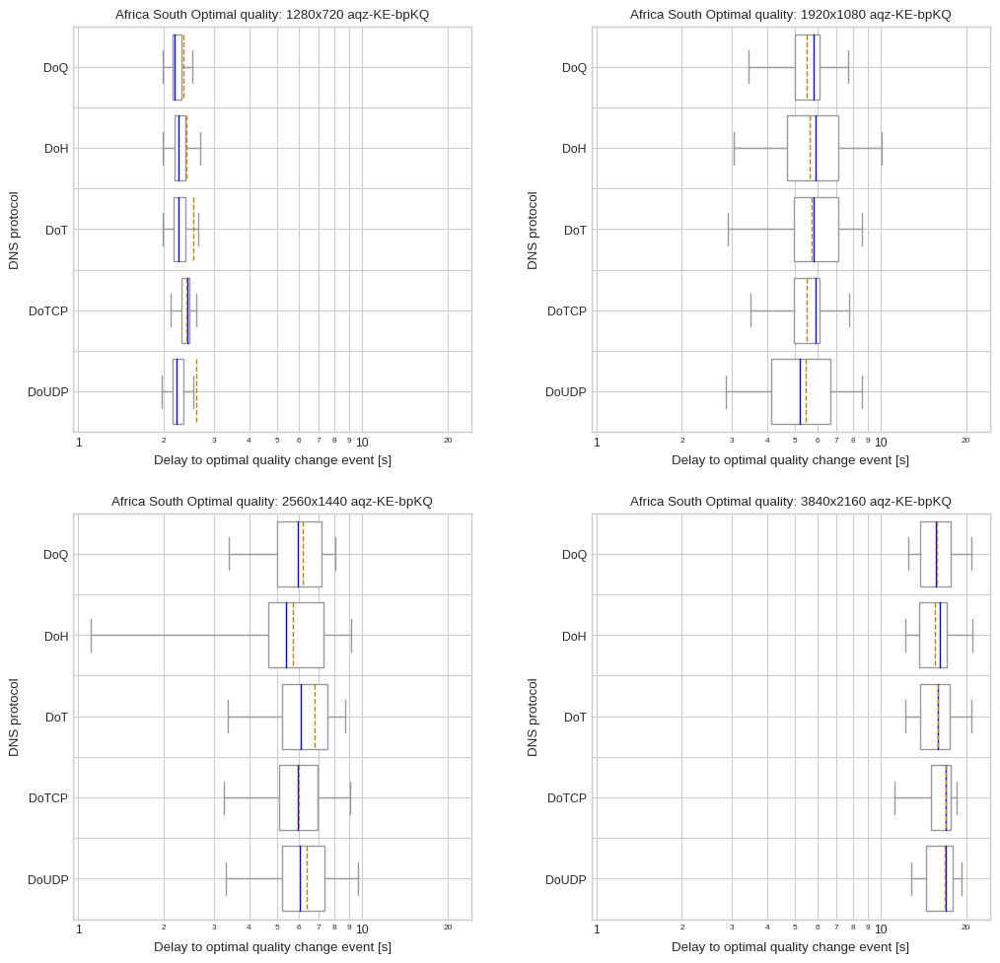

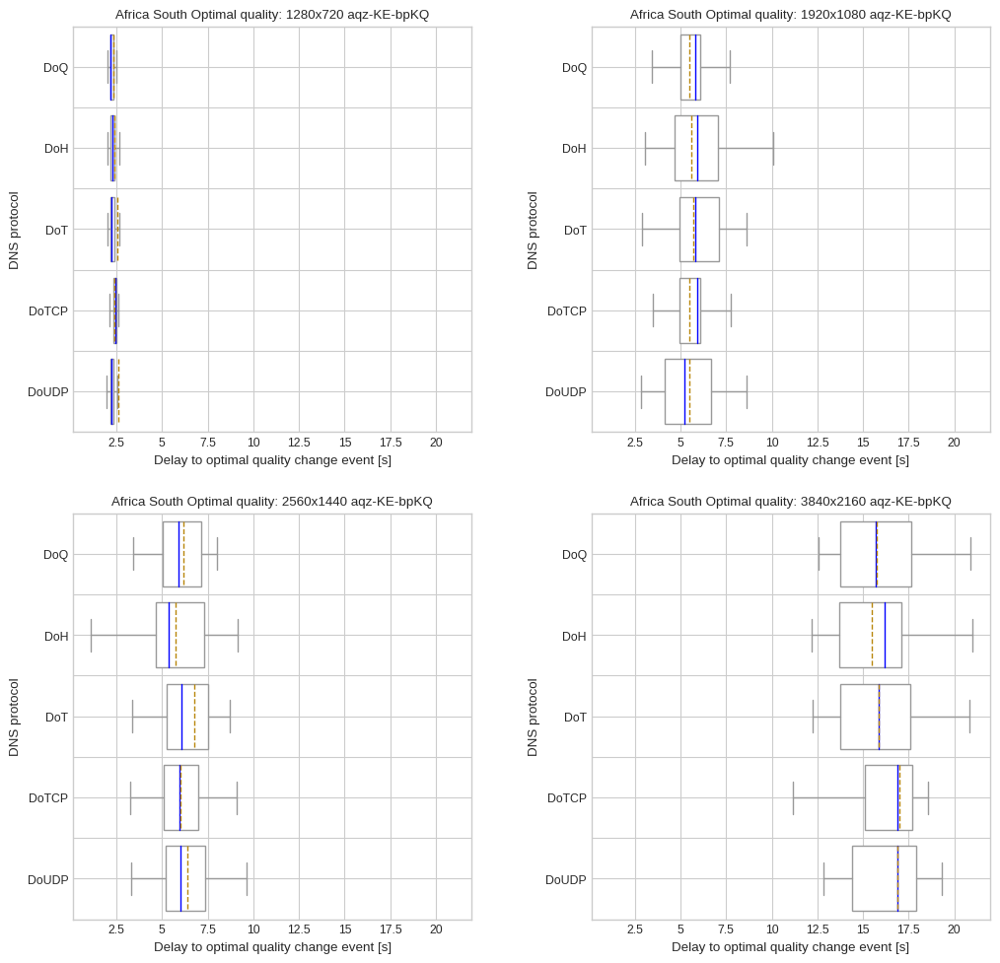

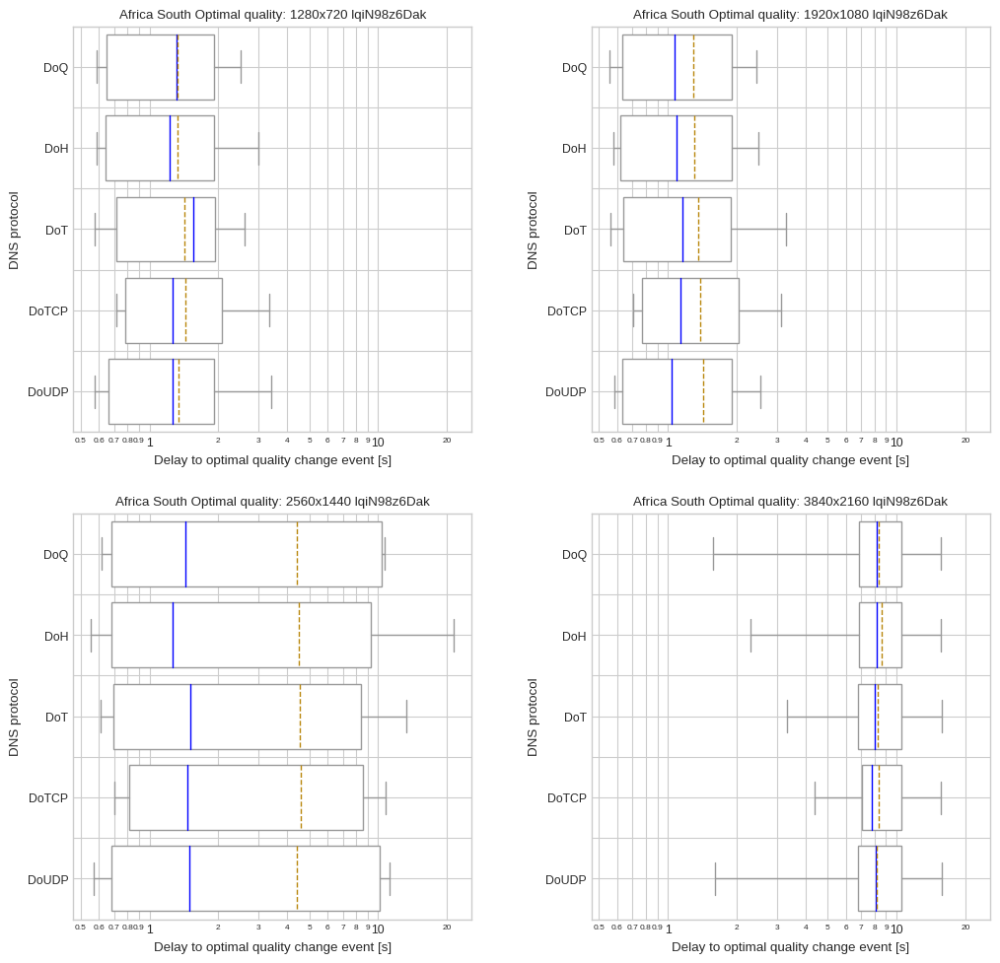

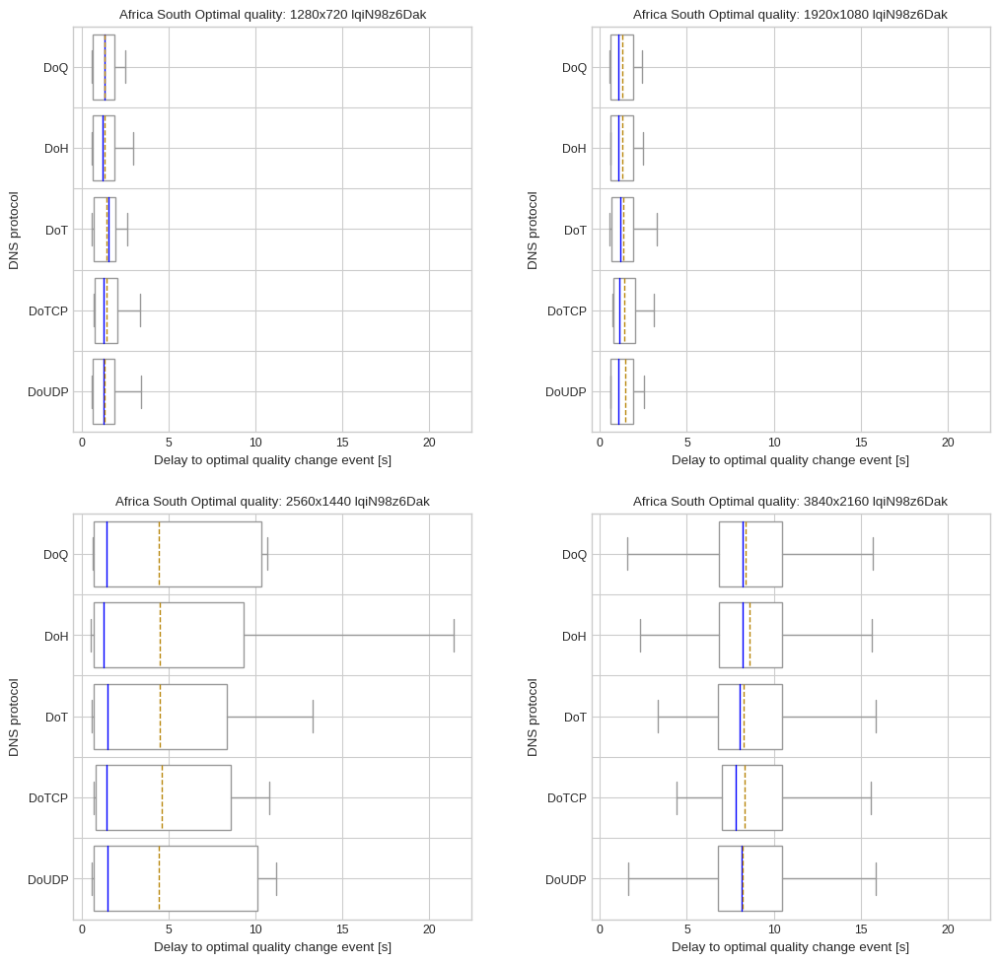

Asia Pacific Northeast


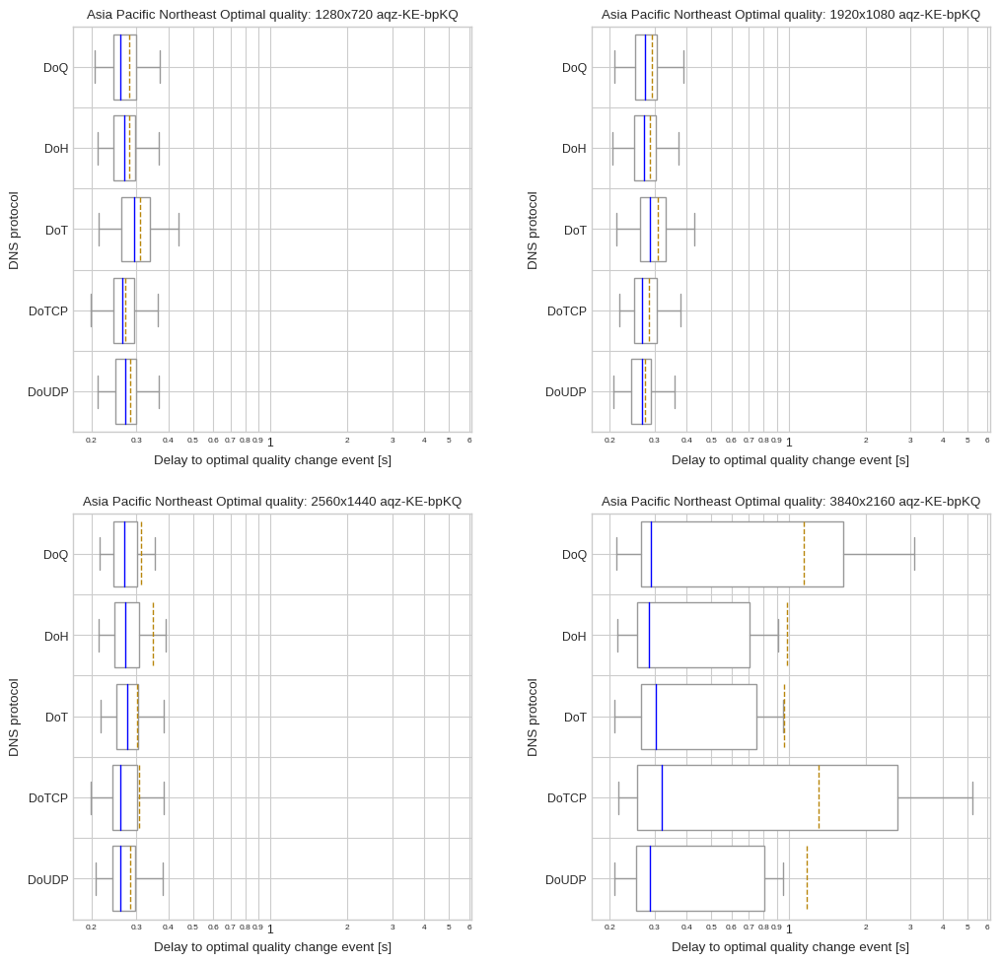

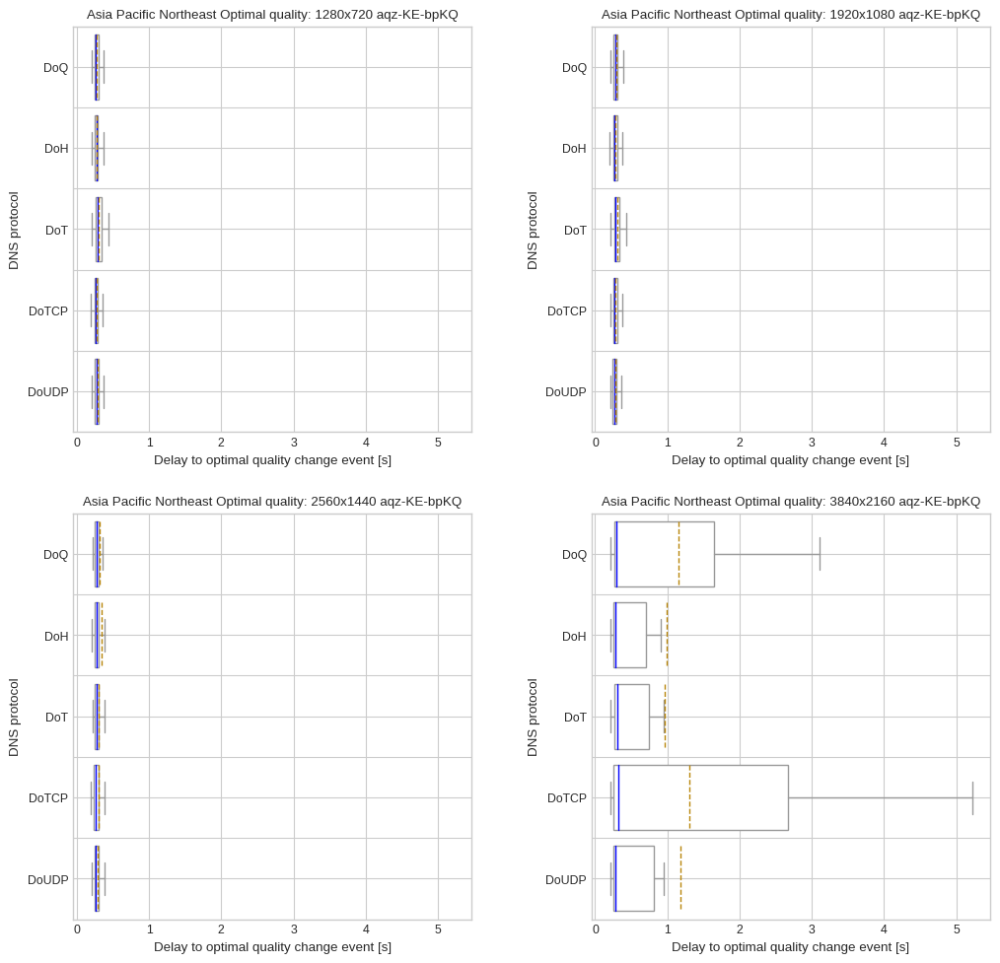

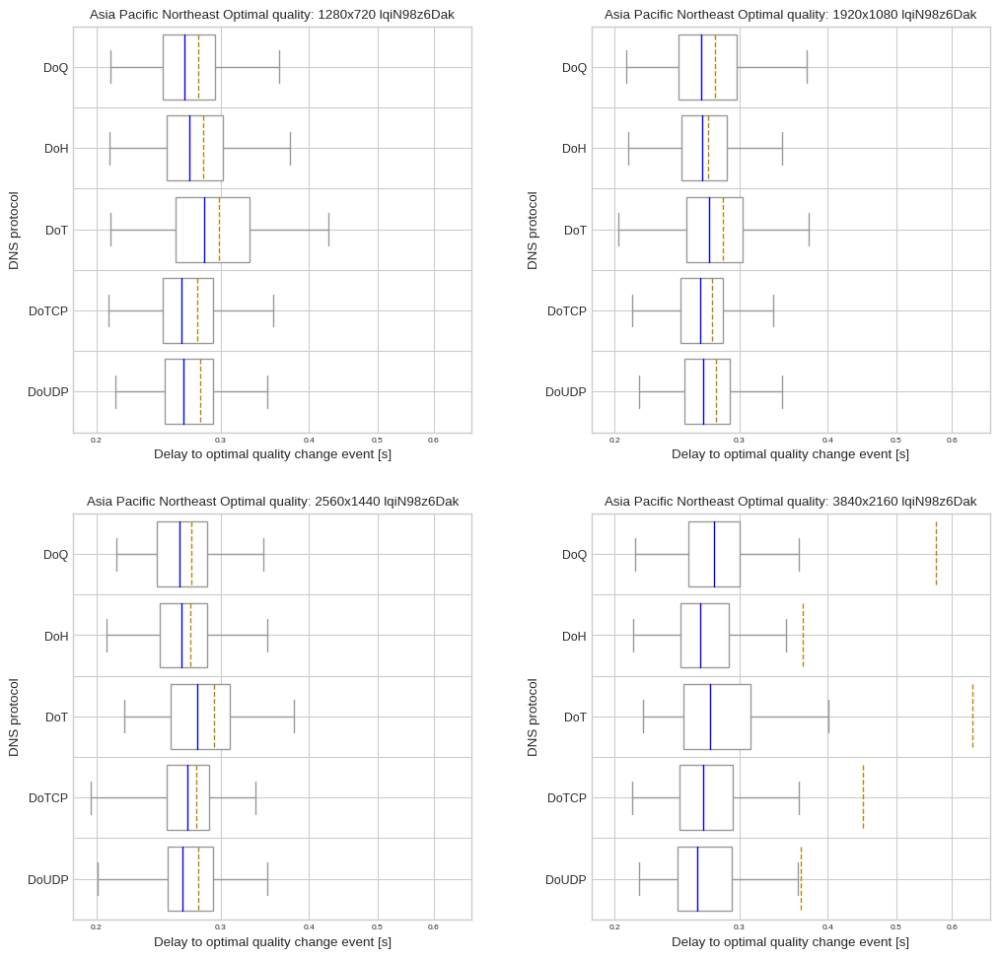

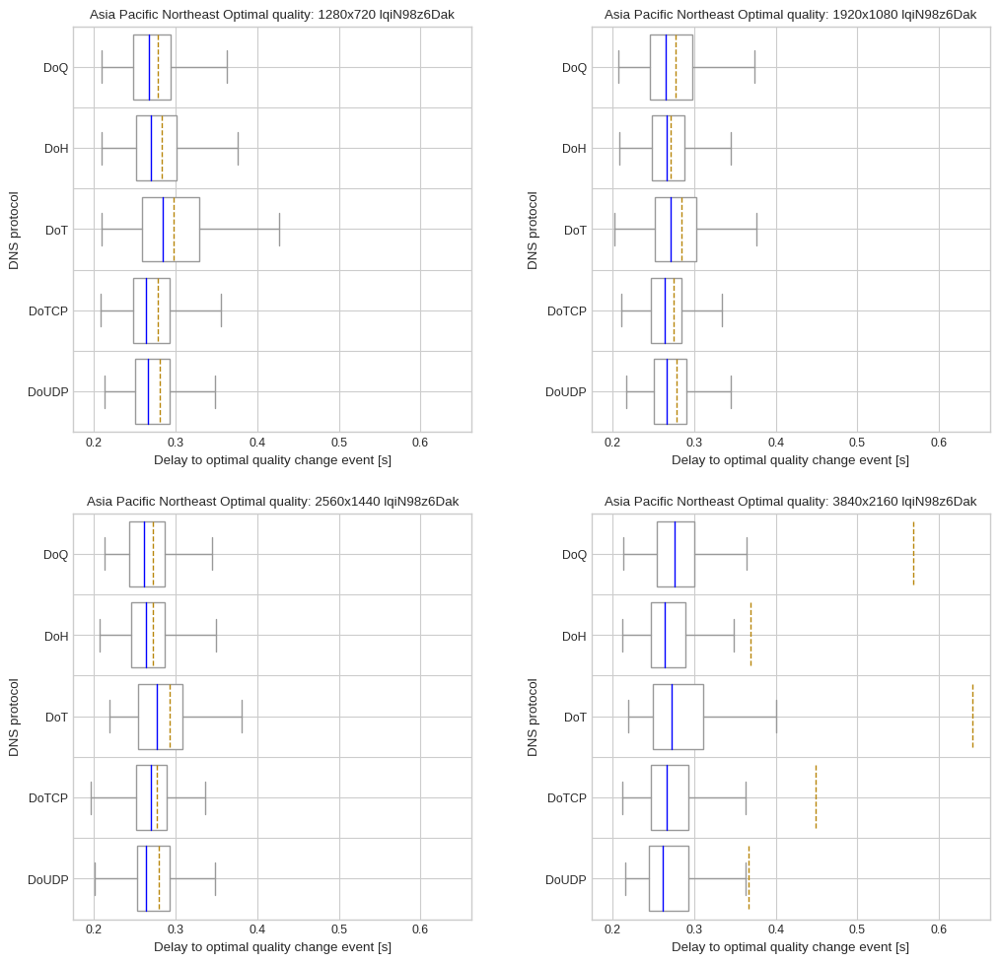

Asia Pacific Southeast


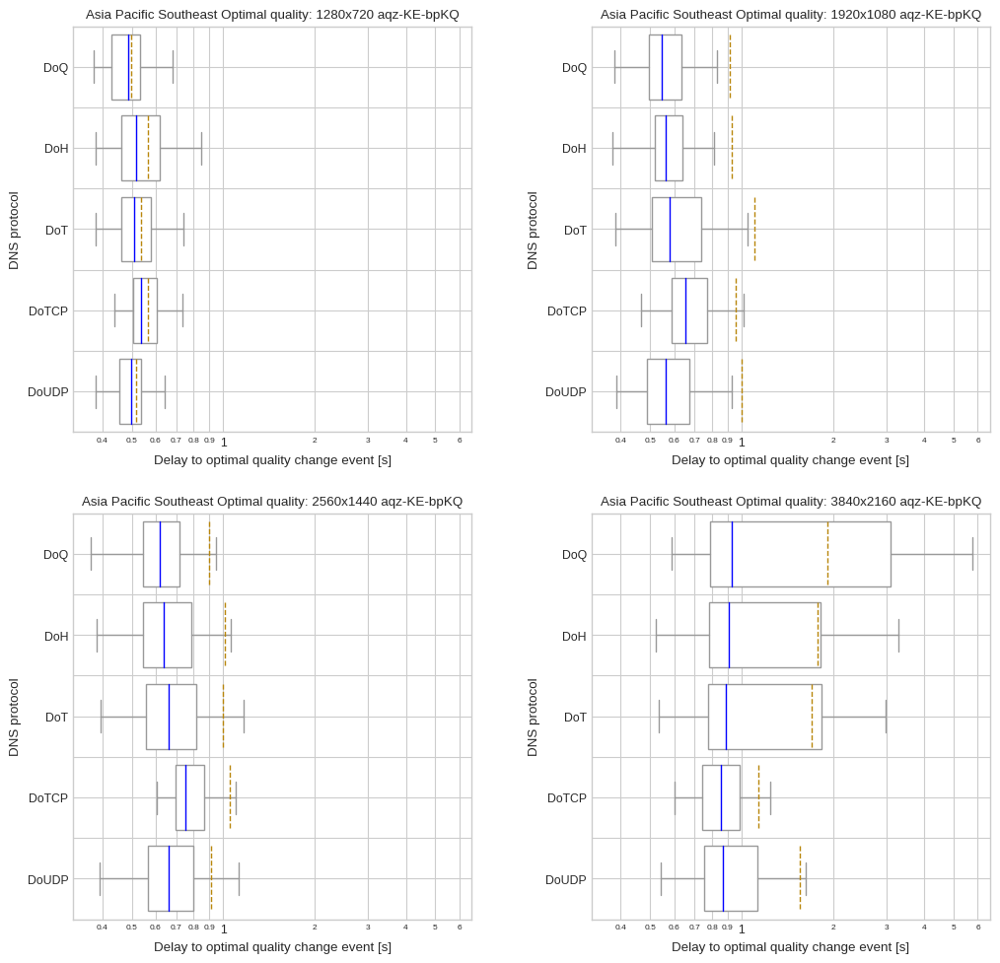

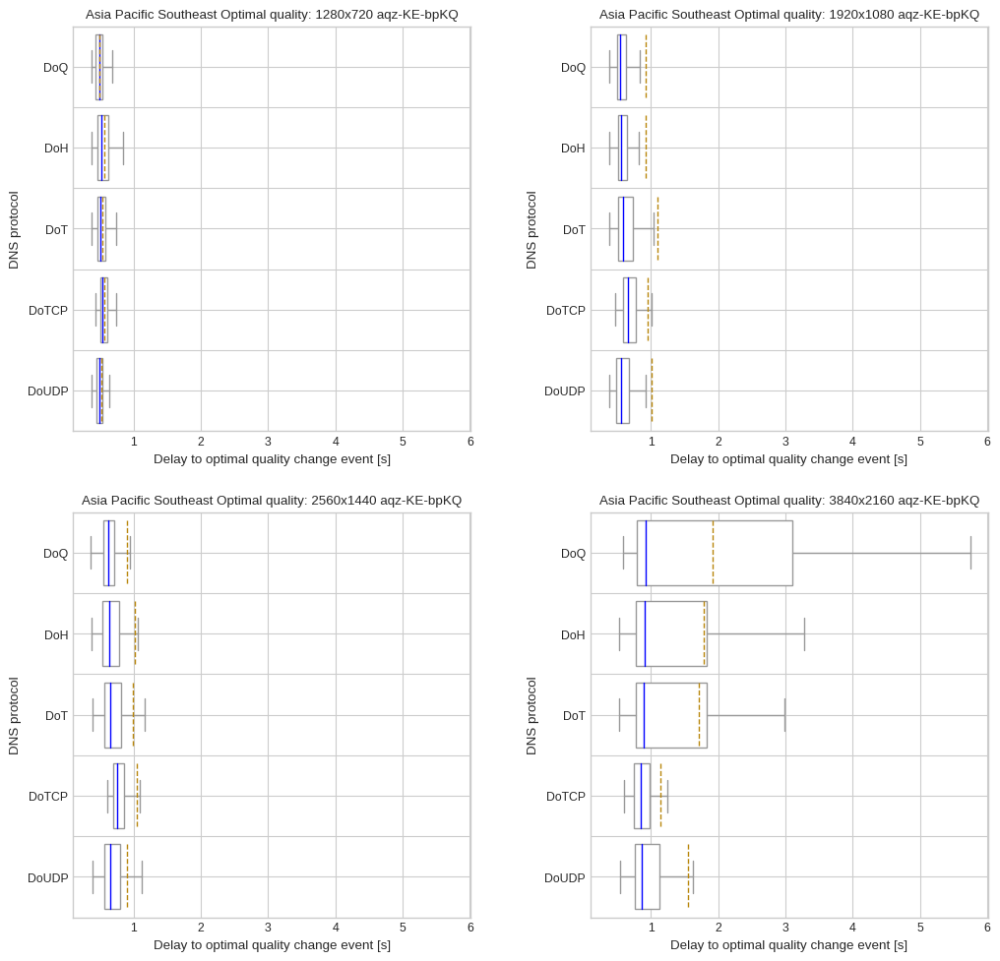

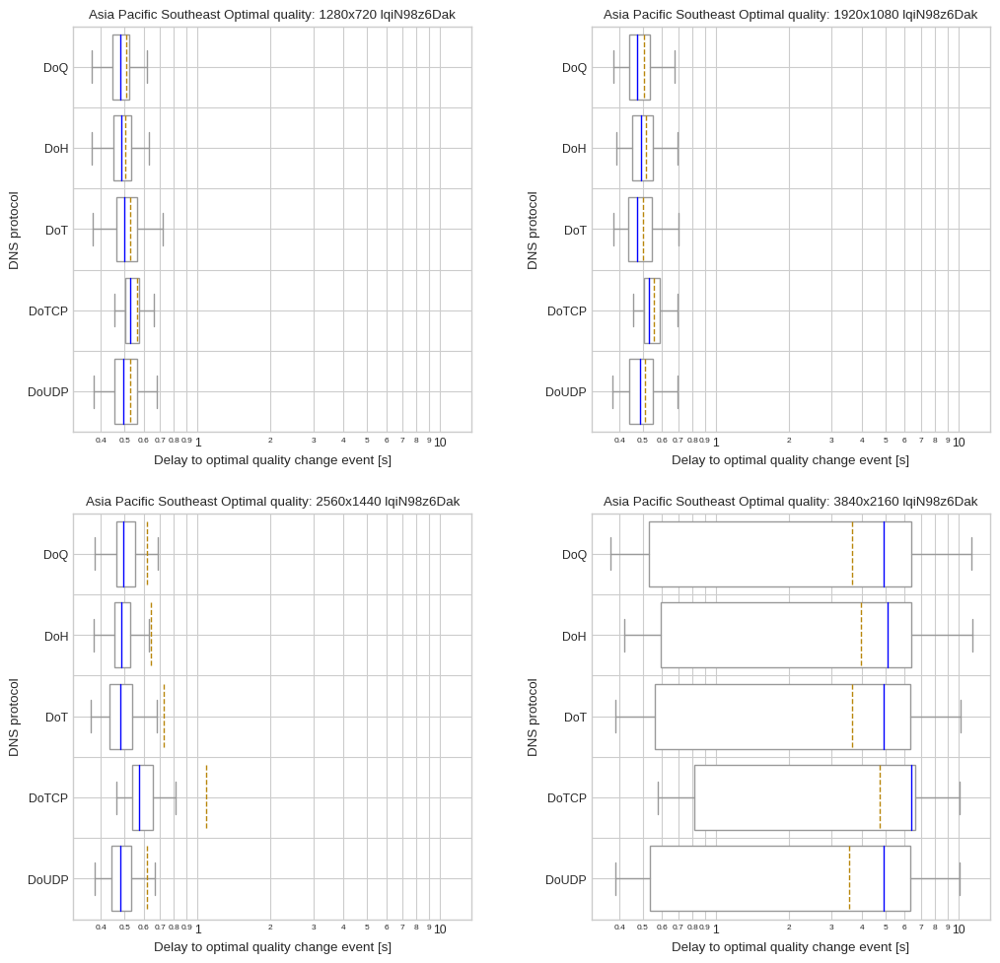

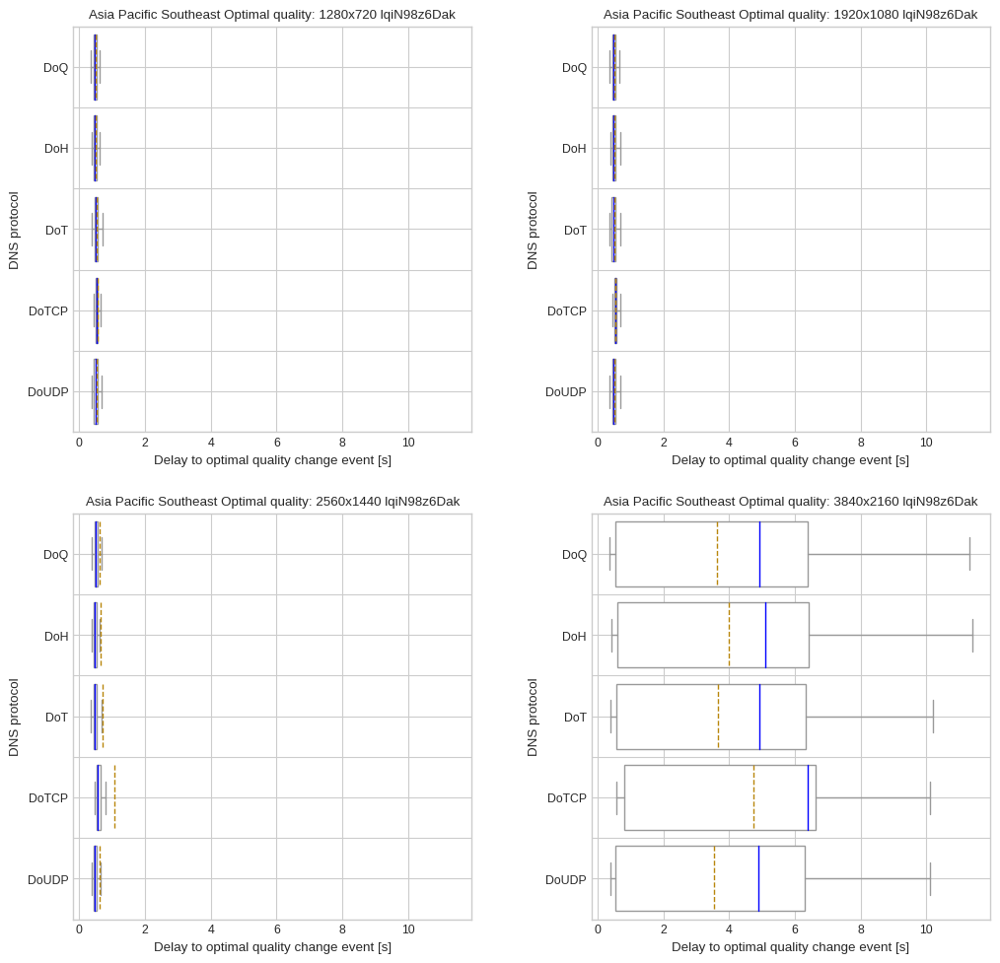

Europe Central


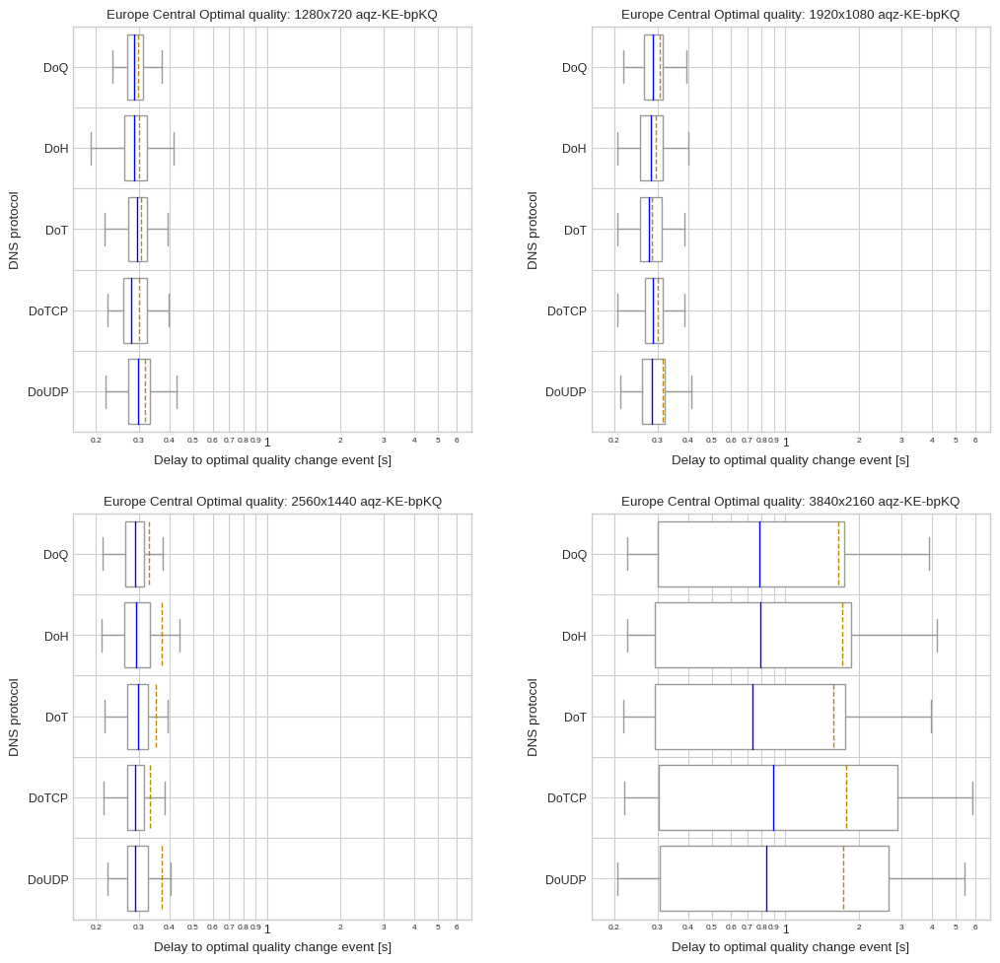

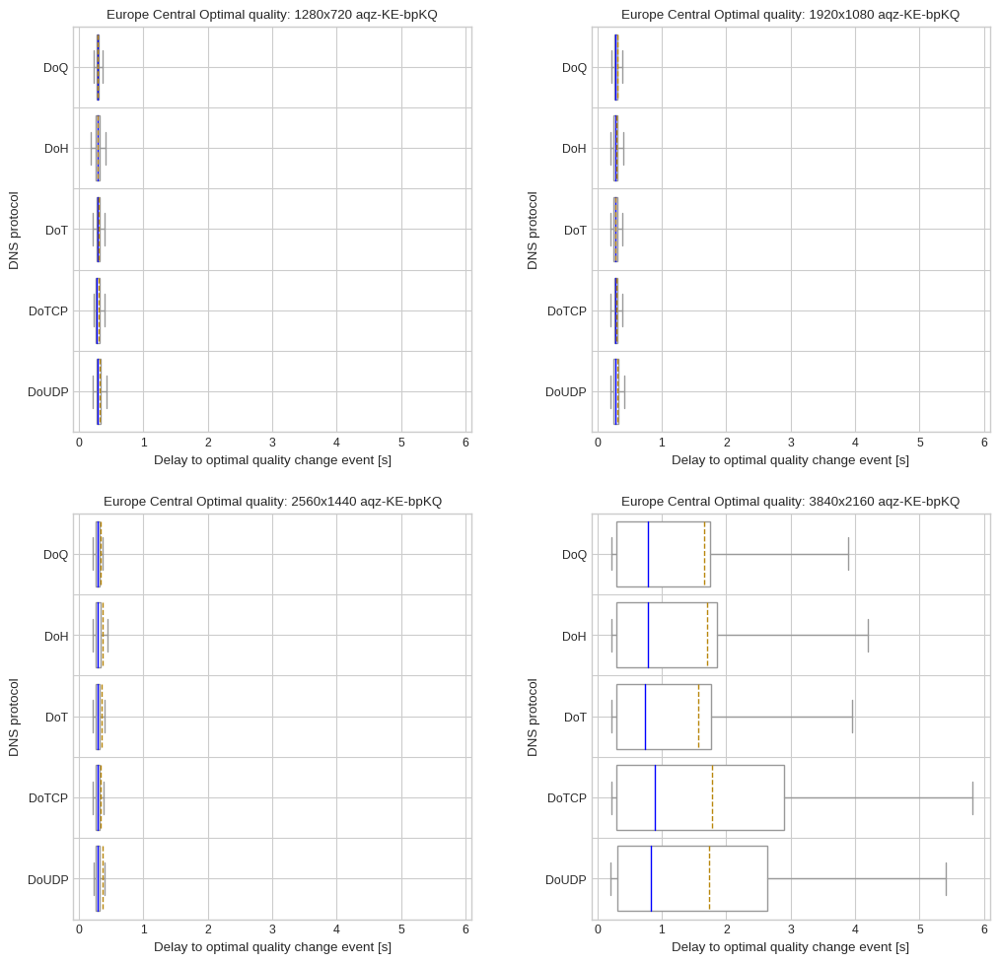

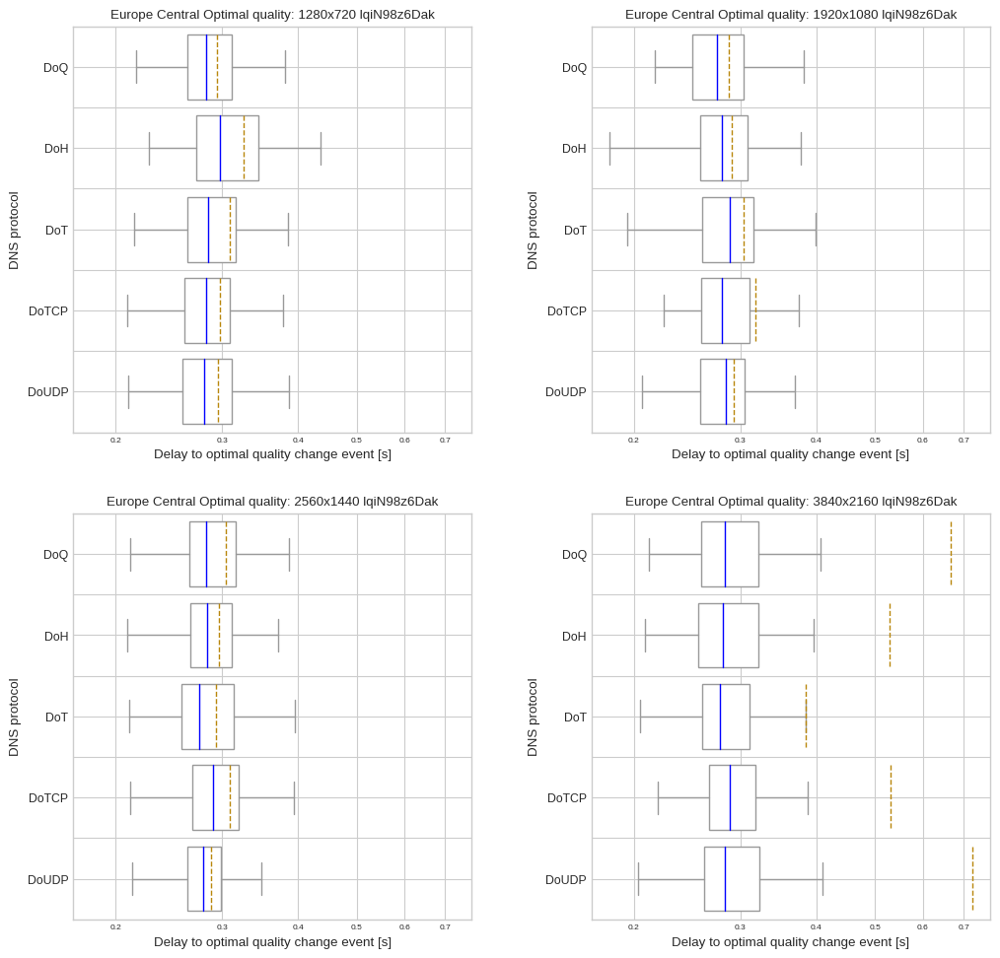

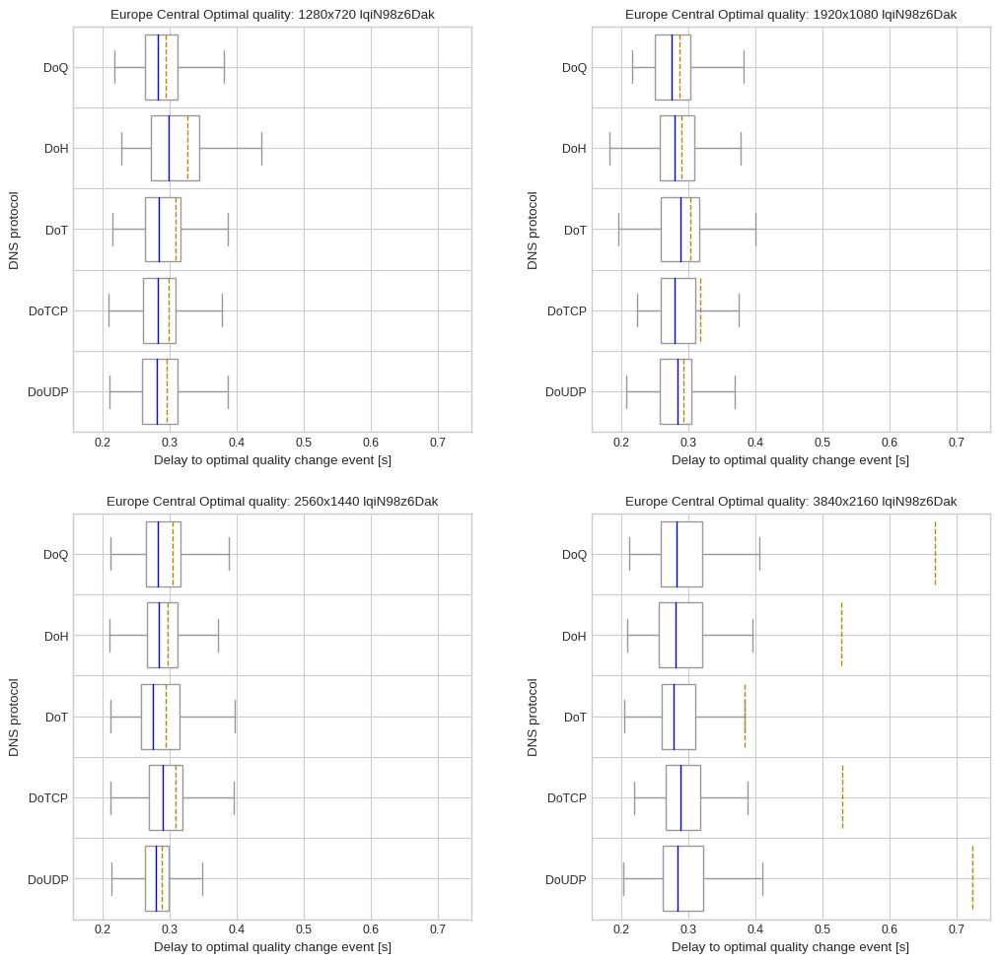

South America East


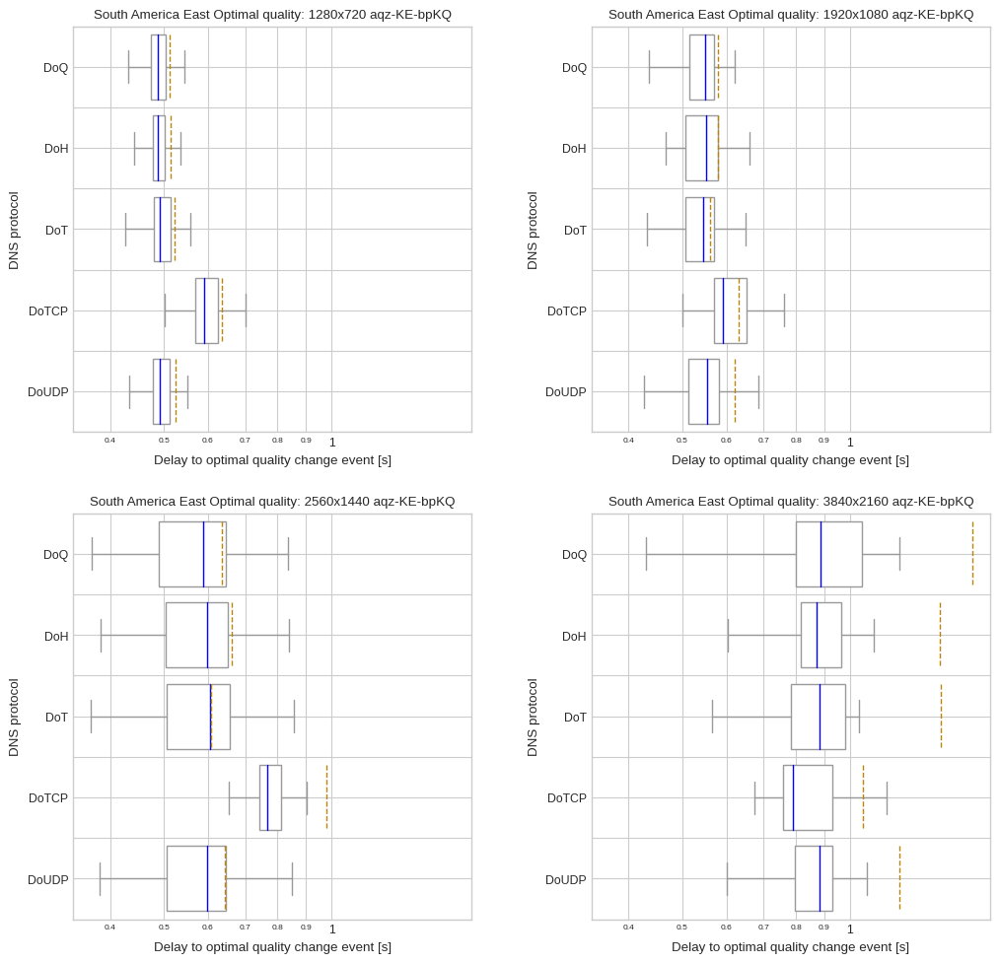

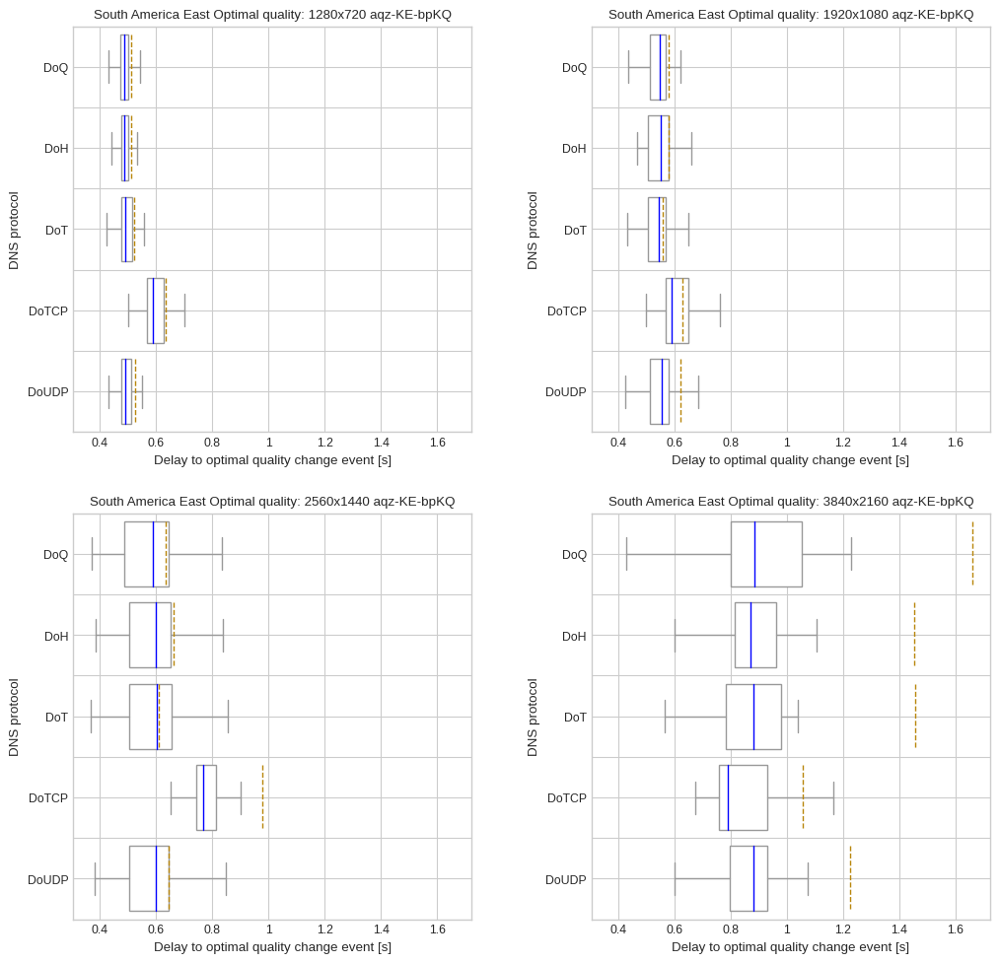

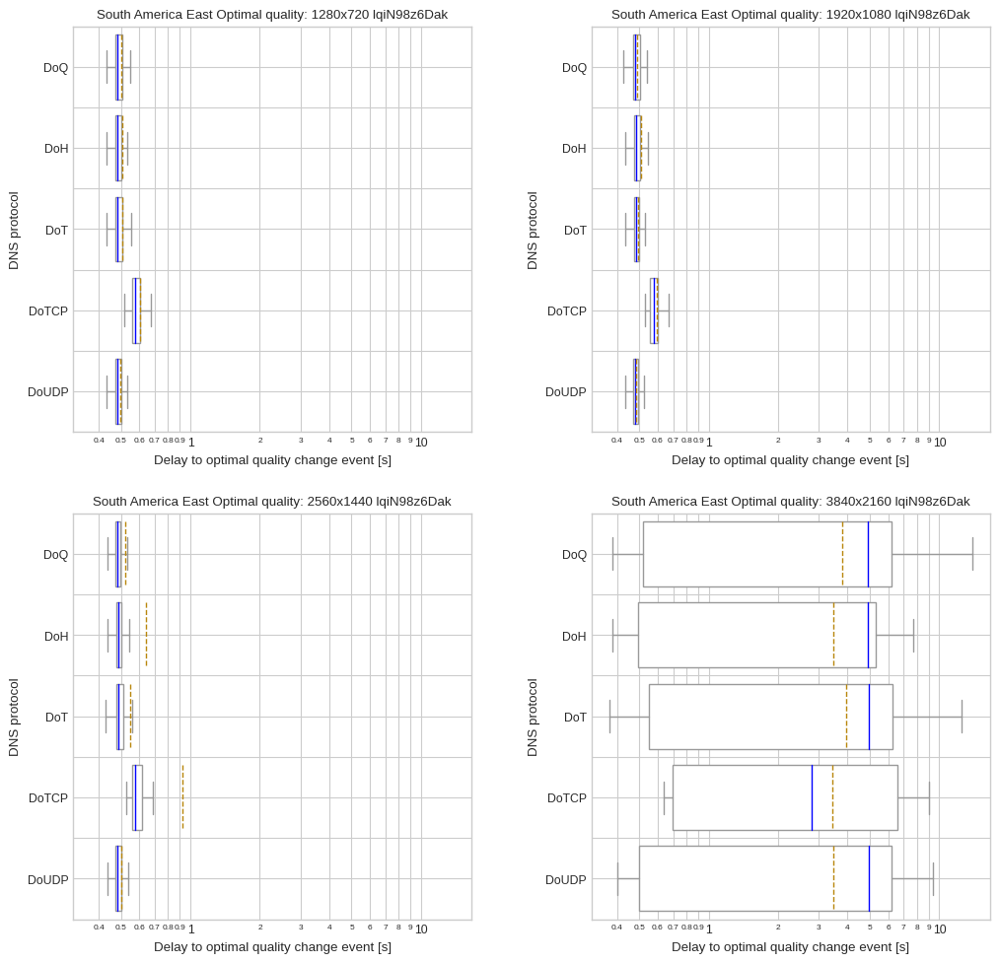

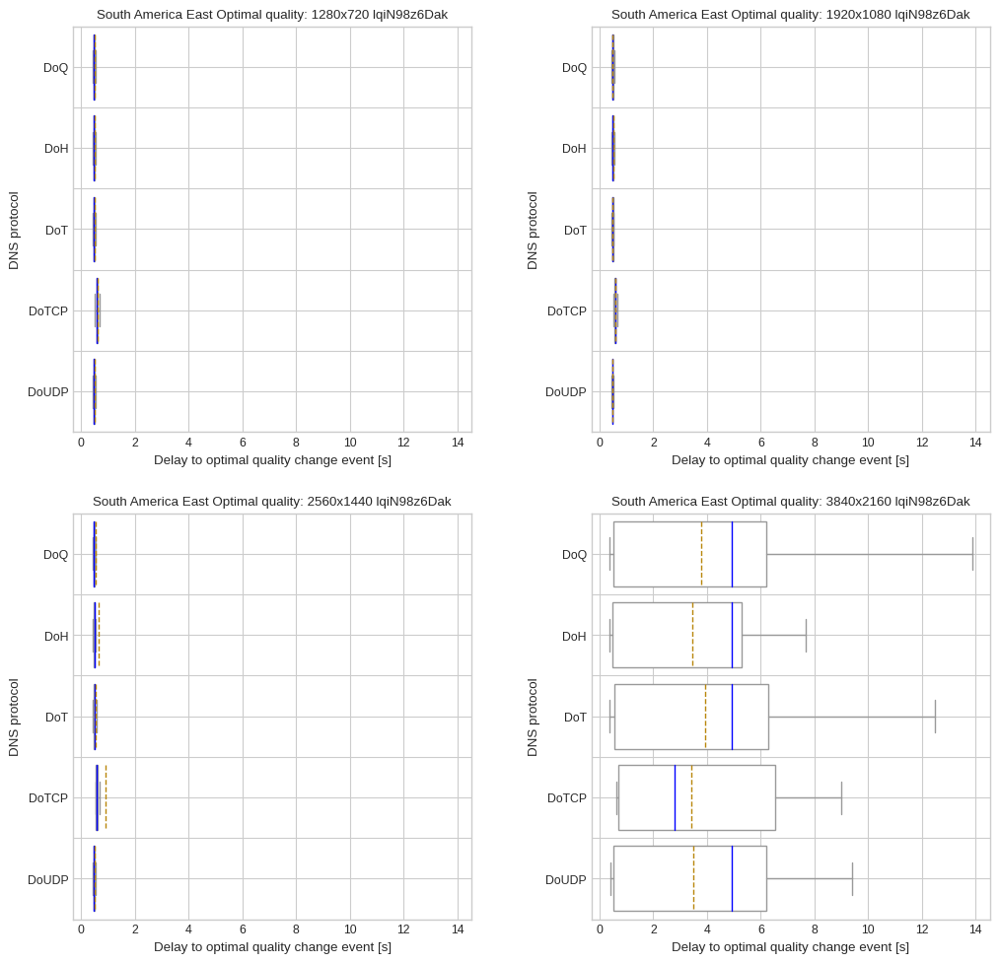

US East


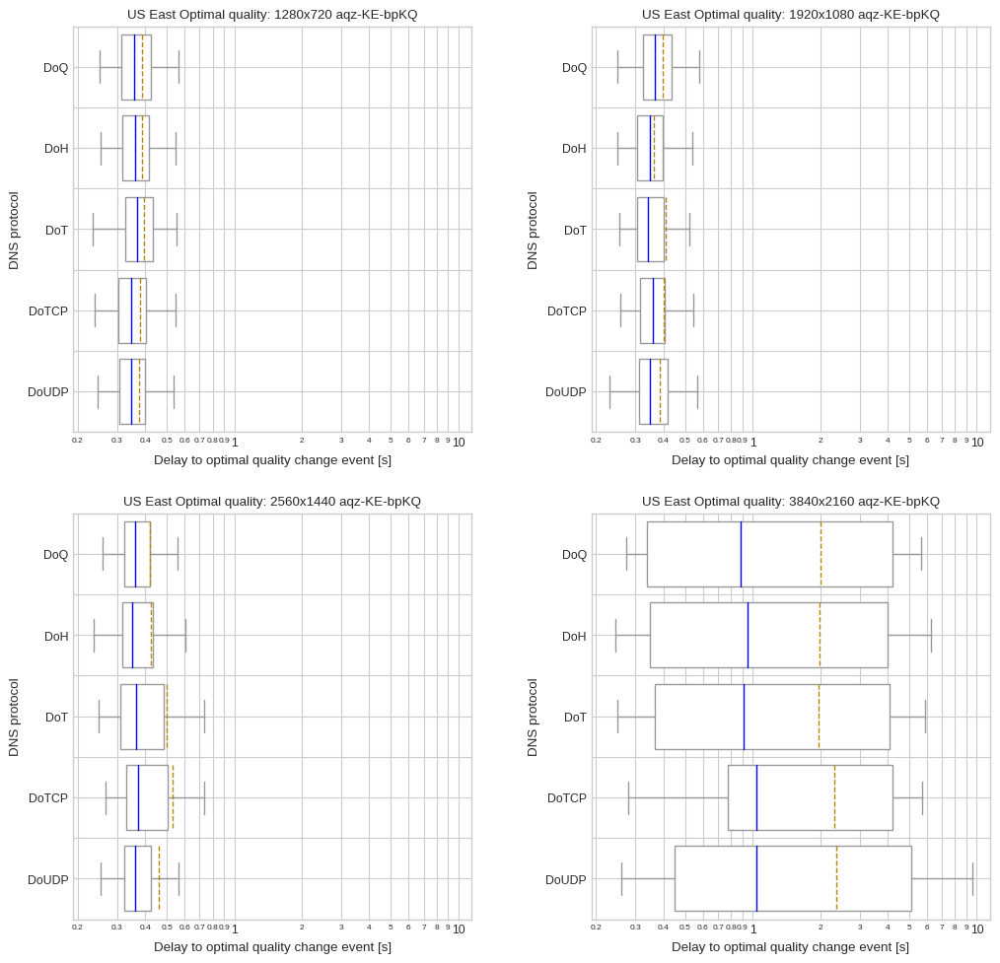

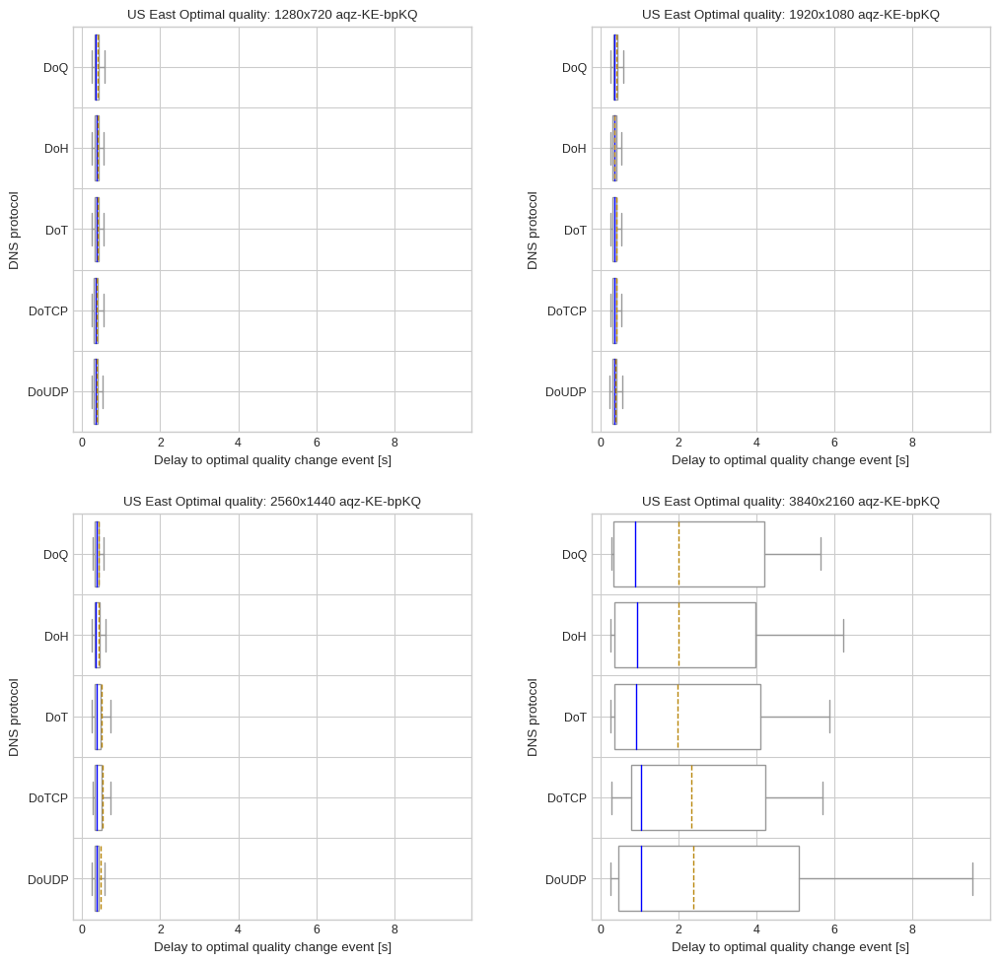

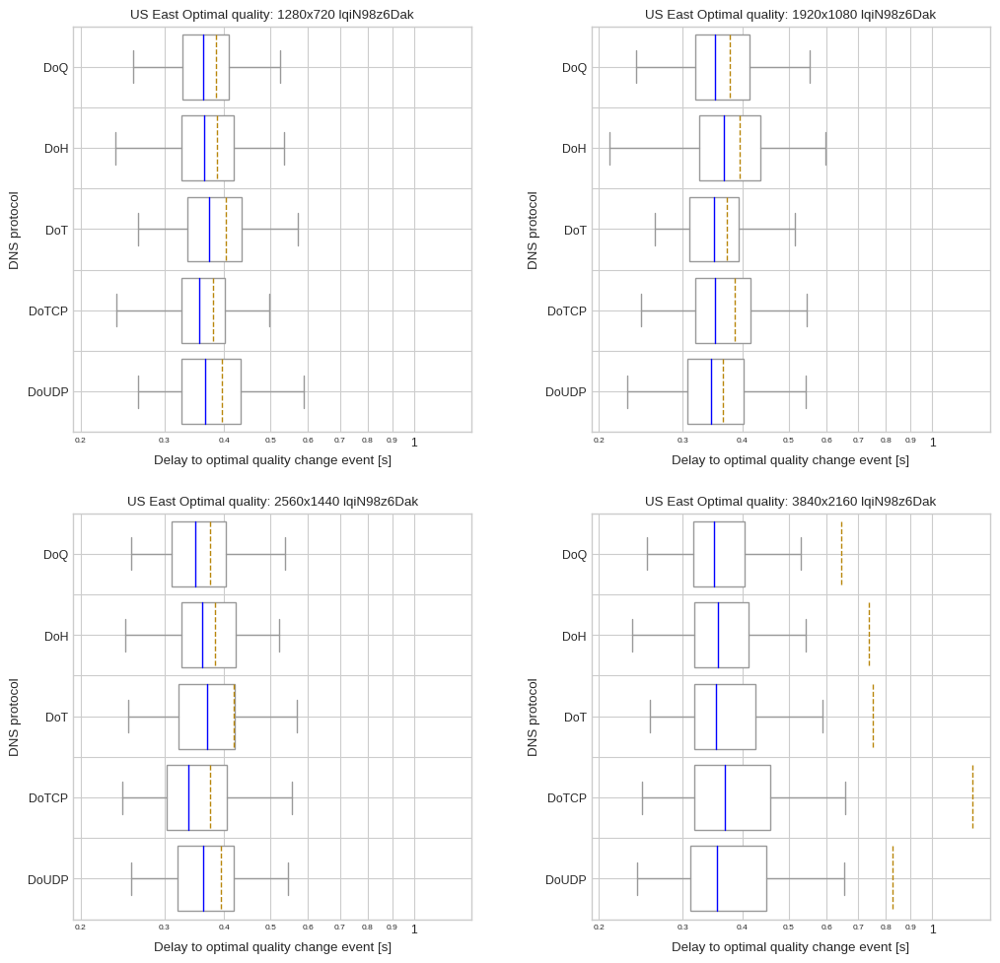

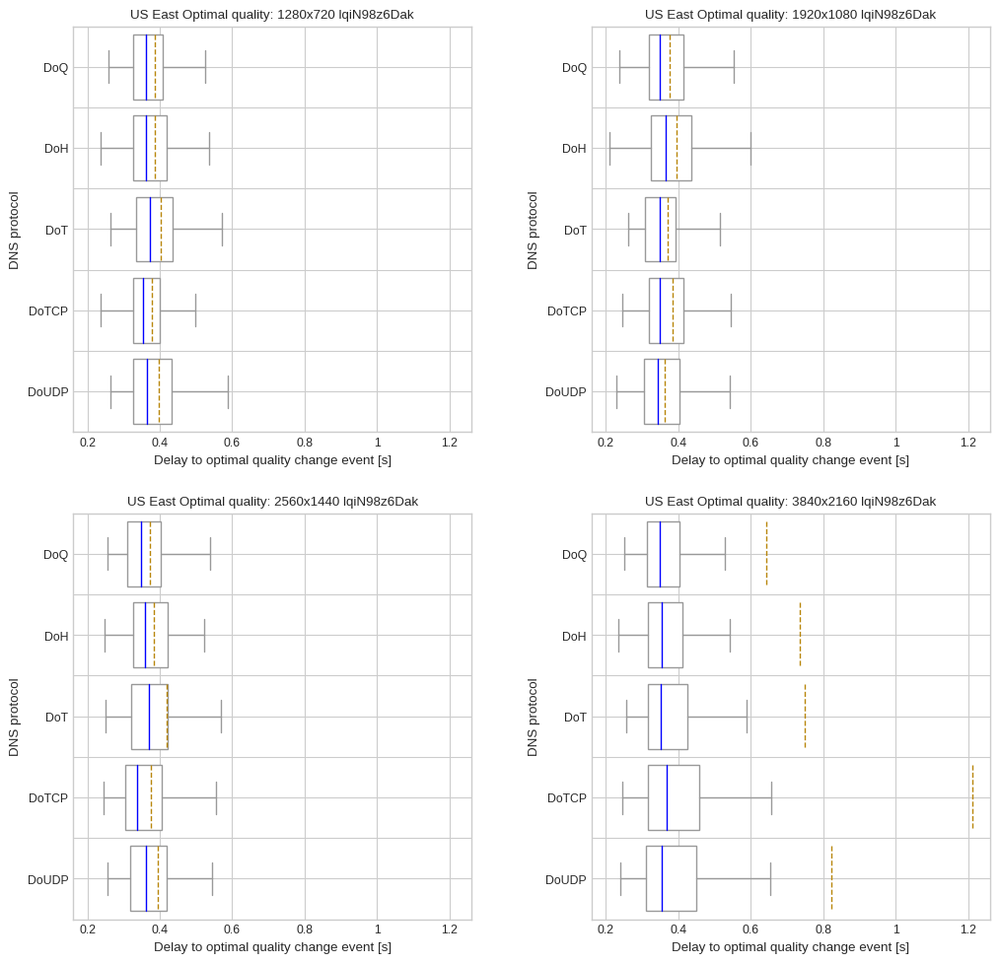

US West


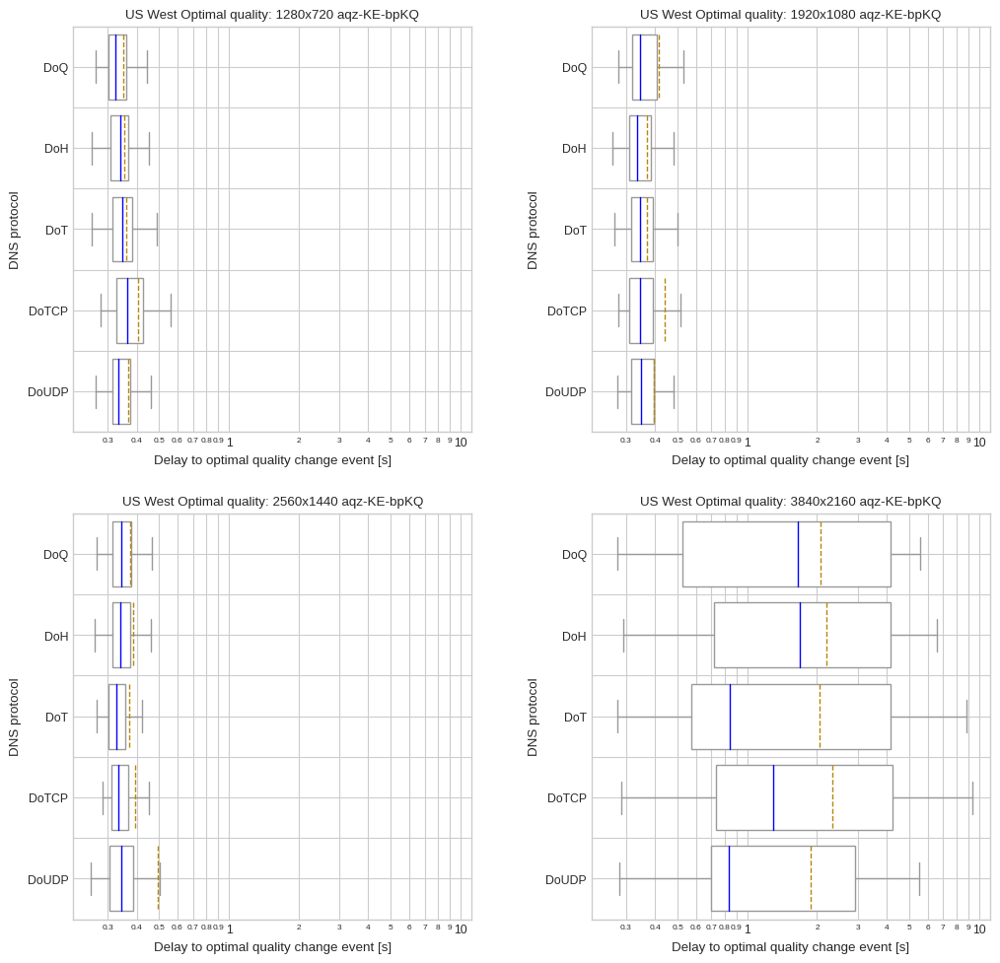

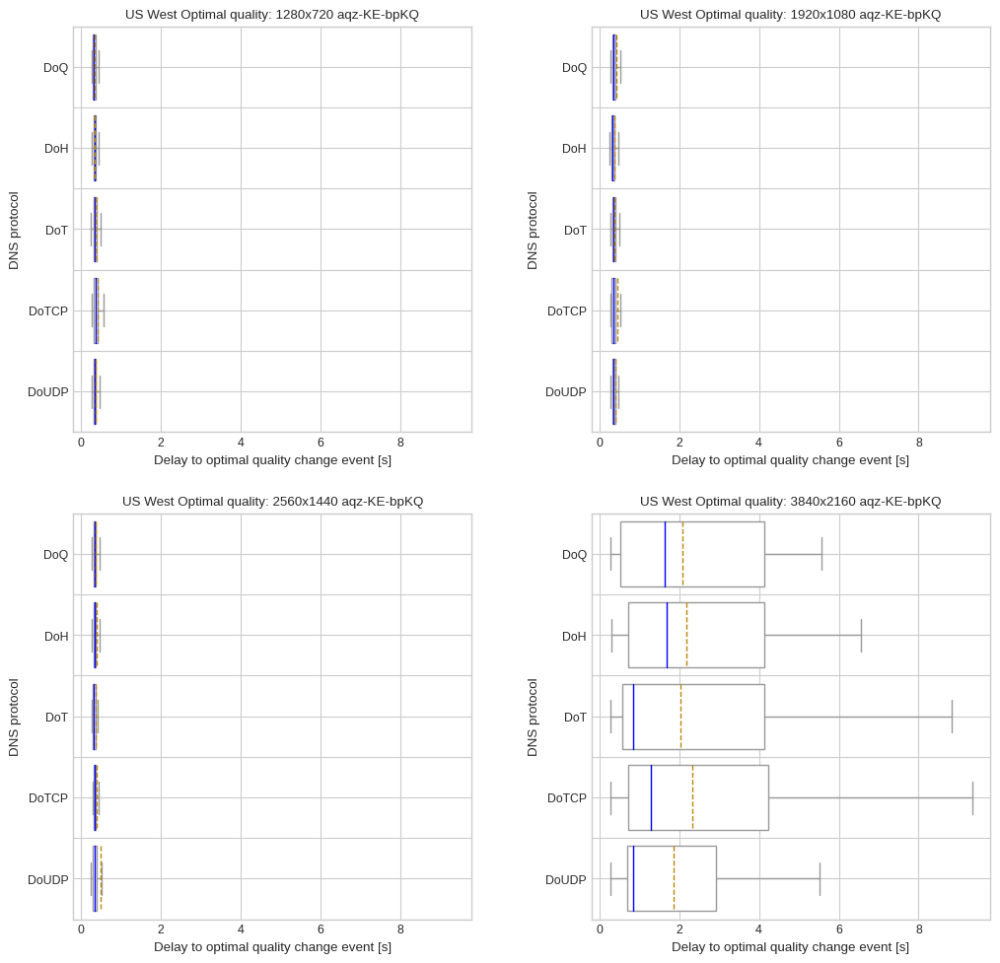

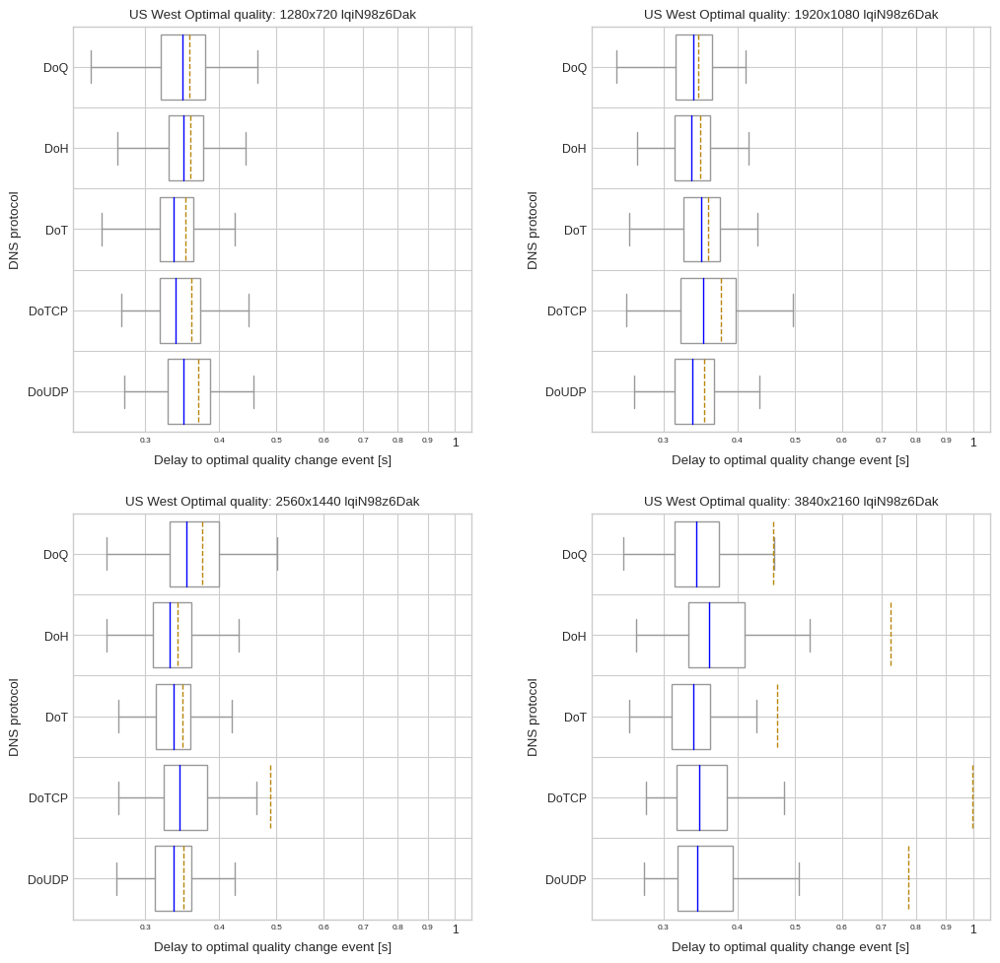

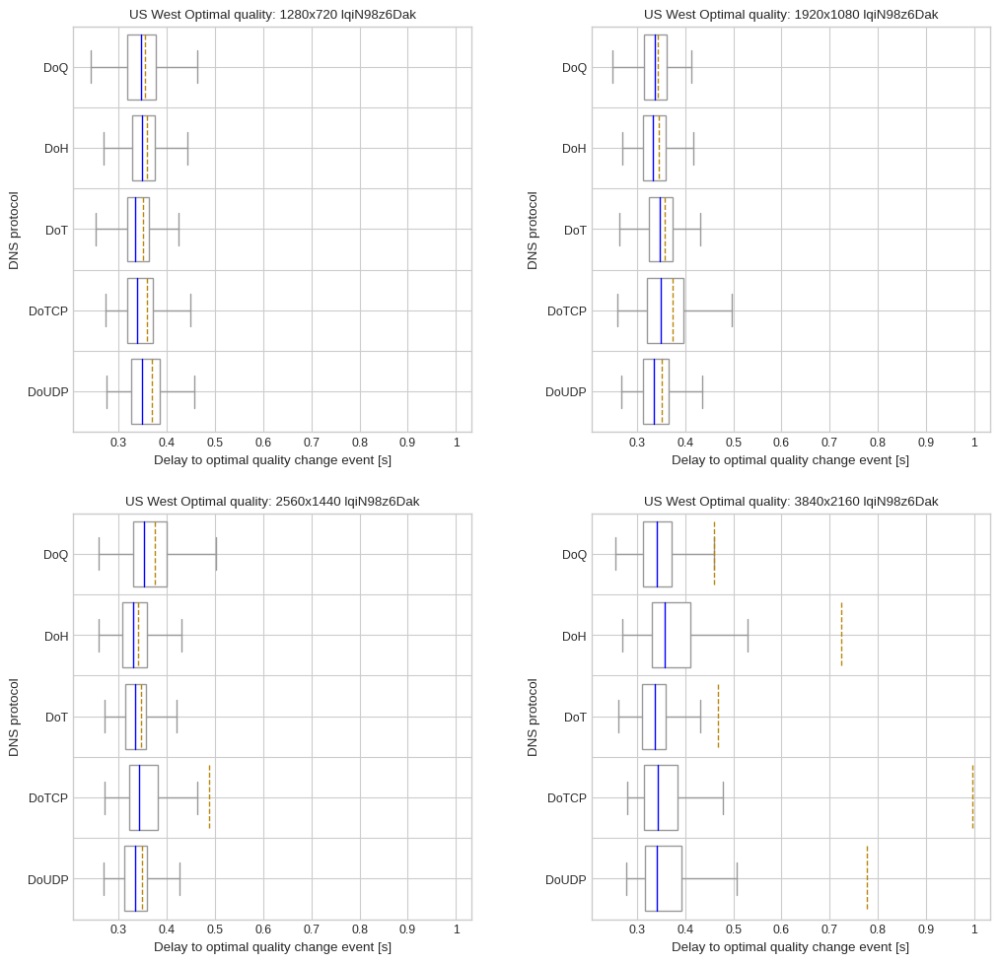

all vantage points


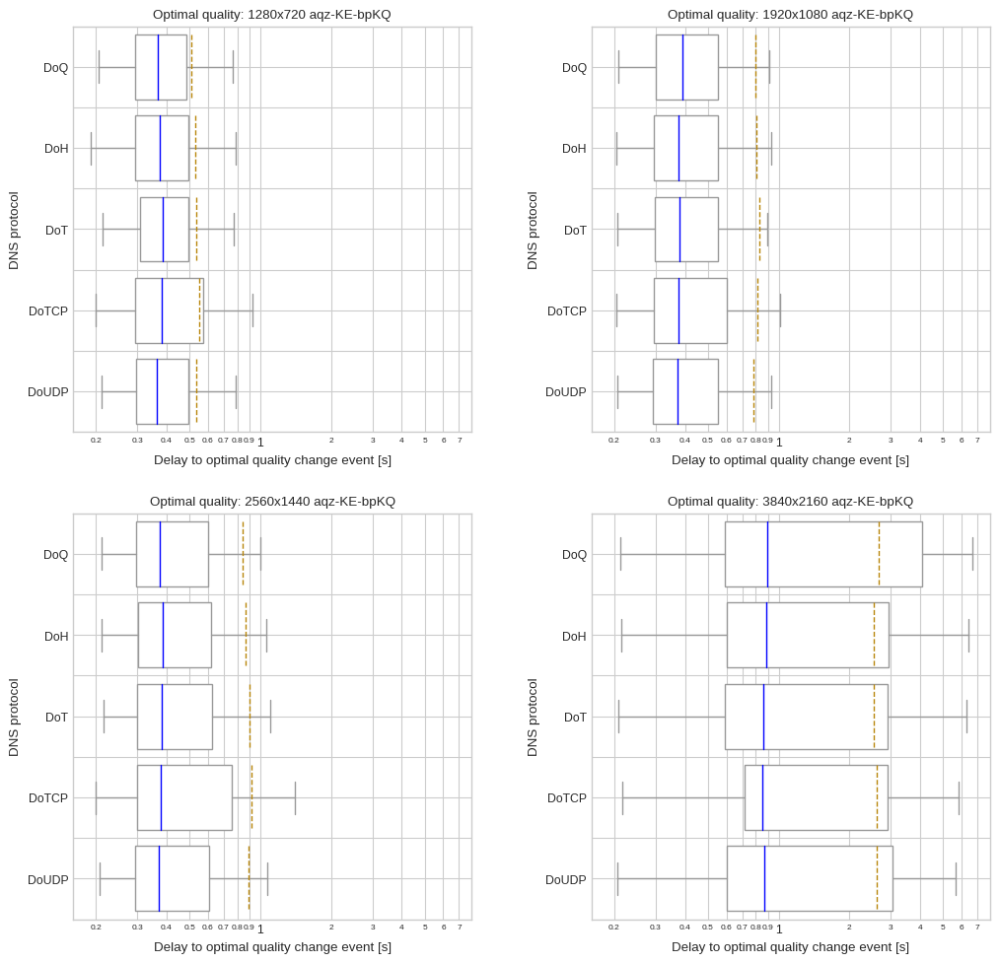

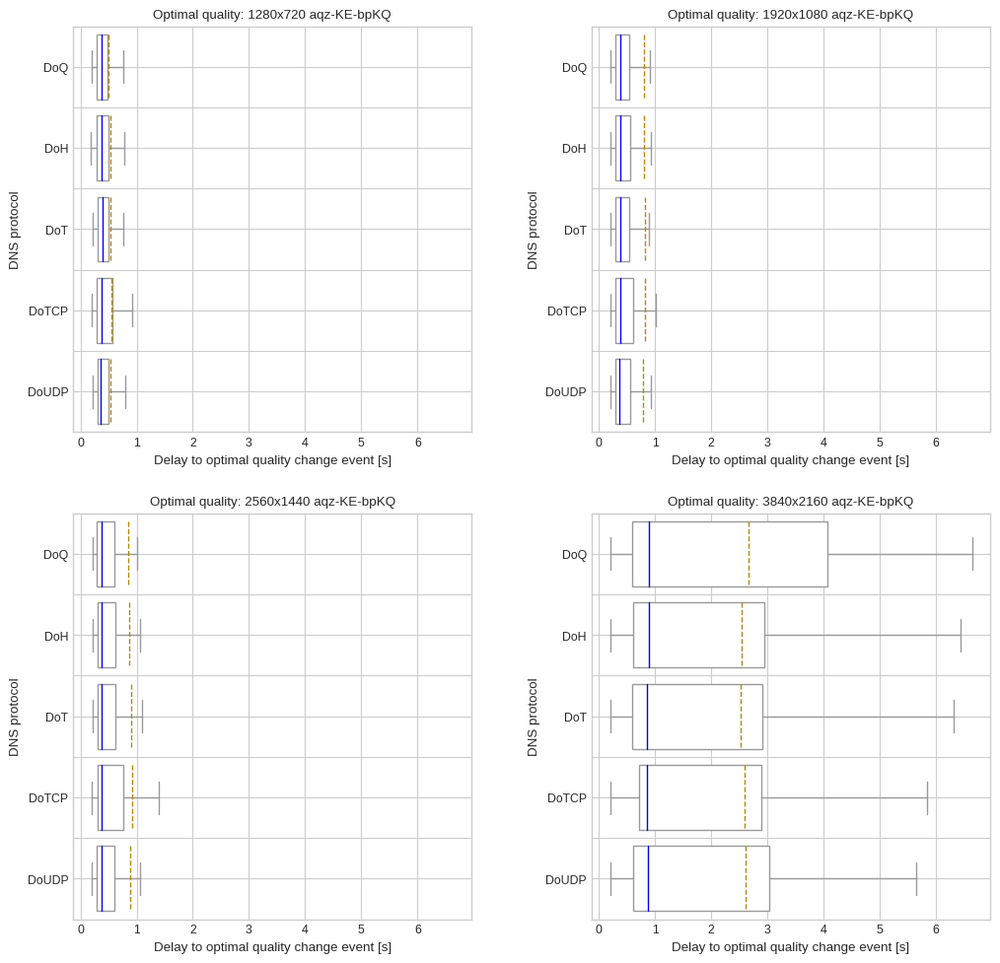

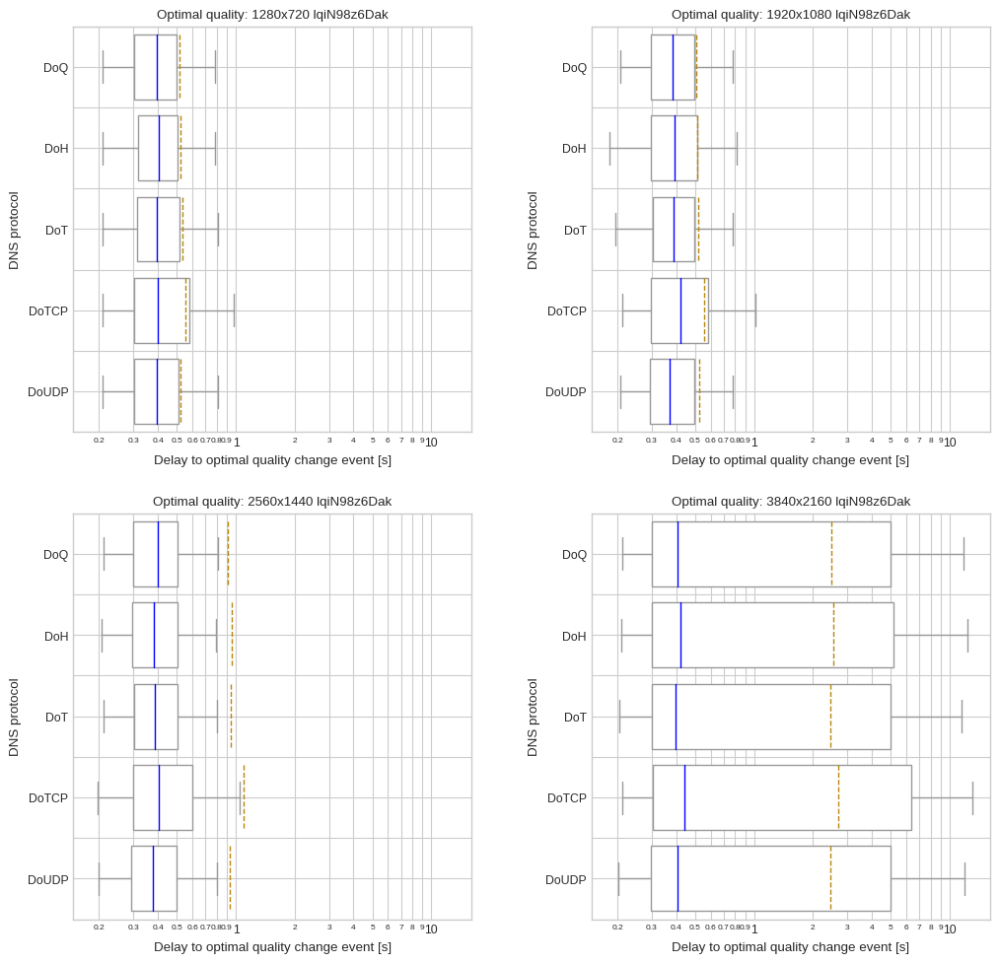

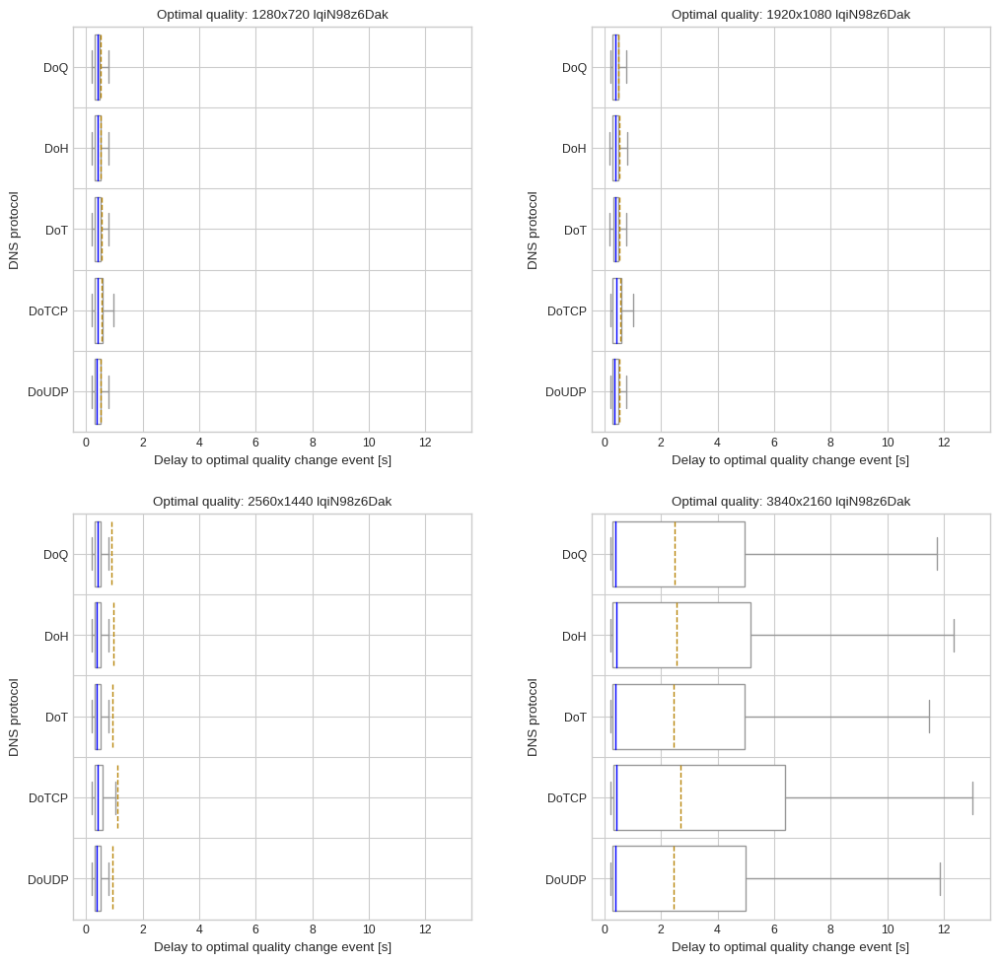

In [533]:
draw_boxplot_grid(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True, False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], "DNS protocol")

## Lookup times

In [333]:
df_resolution_lookups = pd.read_sql_query("SELECT measurement_id as msm_id, elapsed, status, answer, domain as queried_domain FROM lookups", conn)

In [334]:
df_resolution_lookups = df_resolution_lookups[df_resolution_lookups.msm_id.isin(measurements.msm_id.unique())]

In [335]:
df_resolution_lookups.groupby('msm_id', as_index=False).size().sort_values('size')

,msm_id,size
16584,641e5828-011a-b718-1f7c-0d0dd38e5a56,8
31437,be14aade-68a6-43fe-64e9-669f28c4e0e0,8
28634,ad852437-7ecb-528d-2ea0-af7168e4aec1,8
9657,39eefa47-69f0-9e36-037a-3a38a1d88b59,8
11076,42a294ba-006c-687e-2da3-e6dc0661540d,8
...,...,...
26986,a37532f2-3f13-c8aa-2e26-335ca826af45,13
9922,3b822e0e-7500-ce88-96dd-6b631a2d8cac,13
2232,0daccb40-4410-f885-4645-d7f8ae0122b3,13
19613,76b20012-82df-4c96-129c-537ddea8472f,13


In [336]:
df_resolution_lookups[df_resolution_lookups.msm_id == '7e226777-5baf-08ea-90d0-c997c91f91c2']

,msm_id,elapsed,status,answer,queried_domain


In [337]:
df_resolution_lookups[df_resolution_lookups.status == 'NOERROR'].queried_domain.value_counts()

www.google.com.                      42479
www.youtube.com.                     42478
fonts.gstatic.com.                   42475
www.gstatic.com.                     42470
googleads.g.doubleclick.net.         42454
                                     ...  
r2---sn-a5mlrn76.googlevideo.com.        1
r2---sn-1gi7znek.googlevideo.com.        1
r1---sn-5ualdn7s.googlevideo.com.        1
r5---sn-aigl6nsd.googlevideo.com.        1
r2---sn-nx57ynlk.googlevideo.com.        1
Name: queried_domain, Length: 1657, dtype: int64

In [338]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].queried_domain.value_counts()

Series([], Name: queried_domain, dtype: int64)

In [339]:
df_resolution_lookups.elapsed.describe()

count    392984.000000
mean         72.578280
std         104.838634
min           0.603431
25%           3.849300
50%          14.286272
75%         123.760369
max        9595.869112
Name: elapsed, dtype: float64

In [340]:
df_resolution_lookups = pd.merge(measurements[['msm_id', 'protocol', 'server', 'vantagePoint', 'domain', 'player_dimensions']], df_resolution_lookups, on='msm_id')

In [341]:
df_resolution_lookups = pd.merge(df_true_initial_quality[['msm_id', 'true_initial_quality']], df_resolution_lookups, on='msm_id')

In [342]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].groupby('server', as_index=False).agg({'queried_domain':pd.Series.unique})

,server,queried_domain


In [343]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].groupby('msm_id', as_index=False).agg({'queried_domain':pd.Series.unique})

,msm_id,queried_domain


In [344]:
df_resolution_lookups[df_resolution_lookups.status == 'SERVFAIL']['answer'].tolist()

[]

In [345]:
df_resolution_lookups[df_resolution_lookups.status == 'SERVFAIL'].protocol.value_counts()

Series([], Name: protocol, dtype: int64)

In [346]:
df_googlevideo_lookup_time = df_resolution_lookups[df_resolution_lookups.queried_domain.str.endswith('.googlevideo.com.')].groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'elapsed':'median'}).reset_index().copy().dropna()
df_overall_lookup_time = df_resolution_lookups.groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'elapsed':'median'}).reset_index().copy().dropna()

In [347]:
df_googlevideo_lookup_time.rename(columns=lambda x: x.replace('elapsed', 'metric'), inplace=True)
df_googlevideo_lookup_time.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)
df_overall_lookup_time.rename(columns=lambda x: x.replace('elapsed', 'metric'), inplace=True)
df_overall_lookup_time.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)

In [348]:
df_googlevideo_lookup_time['protocol'] = pd.Categorical(df_googlevideo_lookup_time['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])
df_overall_lookup_time['protocol'] = pd.Categorical(df_overall_lookup_time['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

df_start_time, 'player_dimensions', 'protocol', 'startup_delay'

In [349]:
#startup_delay_medians = df_start_time[df_start_time.true_initial_quality.isin(['hd720', 'hd1080', 'hd1440', 'hd2160'])].groupby(['vantagePoint', 'domain', 'true_initial_quality', 'protocol']).agg({'startup_delay':'median'}).reset_index().copy().dropna()
#startup_delay_medians['true_initial_quality'] = startup_delay_medians['true_initial_quality'].map(map_quality_to_res)
#startup_delay_medians.rename(columns=lambda x: x.replace('startup_delay', 'metric'), inplace=True)
#startup_delay_medians.rename(columns=lambda x: x.replace('true_initial_quality', 'resolution'), inplace=True)

In [510]:
startup_delay_medians = df_start_time.groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'startup_delay':'median'}).reset_index().copy().dropna()
startup_delay_medians.rename(columns=lambda x: x.replace('startup_delay', 'metric'), inplace=True)
startup_delay_medians.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)

In [511]:
startup_delay_medians['protocol'] = pd.Categorical(startup_delay_medians['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

In [351]:
#make_quality_column_sortable(startup_delay_medians, 'true_initial_quality')

In [512]:
startup_delay_medians.sort_values(['domain', 'resolution', 'protocol'], inplace=True)

In [513]:
startup_delay_medians['metric'] = startup_delay_medians['metric'] * 1000

In [514]:
startup_delay_medians['resolution'].cat.remove_unused_categories(inplace=True)

/home/quic_net01/.pyenv/versions/3.8.12/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay'

In [357]:
delay_to_opt_medians = df_player_quality_change_event_to_opt.groupby(['vantagePoint', 'domain', 'optimal_res', 'protocol']).agg({'optimal_quality_delay':'median'}).reset_index().copy().dropna()

In [358]:
#make_res_column_sortable(delay_to_opt_medians, 'optimal_res')

In [359]:
delay_to_opt_medians['protocol'] = pd.Categorical(delay_to_opt_medians['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

In [360]:
delay_to_opt_medians.sort_values(['domain', 'optimal_res', 'protocol'], inplace=True)

In [361]:
delay_to_opt_medians['optimal_quality_delay'] = delay_to_opt_medians['optimal_quality_delay'] * 1000

In [362]:
delay_to_opt_medians.rename(columns=lambda x: x.replace('optimal_quality_delay', 'metric'), inplace=True)
delay_to_opt_medians.rename(columns=lambda x: x.replace('optimal_res', 'resolution'), inplace=True)

In [386]:
#delay_to_opt_medians[(delay_to_opt_medians.vantagePoint == "") & (delay_to_opt_medians.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [387]:
#startup_delay_medians[(startup_delay_medians.vantagePoint == "") & (startup_delay_medians.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [388]:
#df_googlevideo_lookup_time[(df_googlevideo_lookup_time.vantagePoint == "") & (df_googlevideo_lookup_time.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [389]:
#df_overall_lookup_time[(df_overall_lookup_time.vantagePoint == "") & (df_overall_lookup_time.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

Africa South


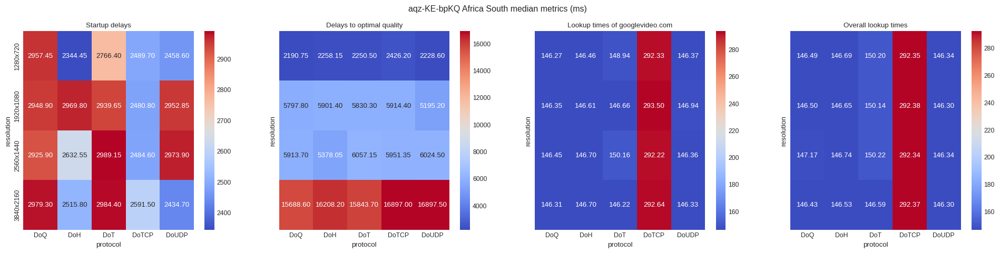

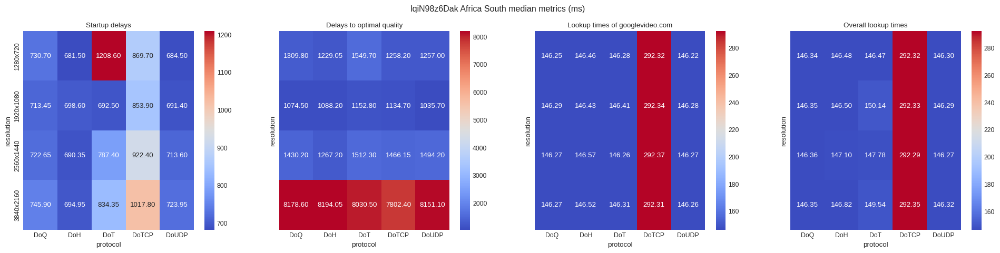

Asia Pacific Northeast


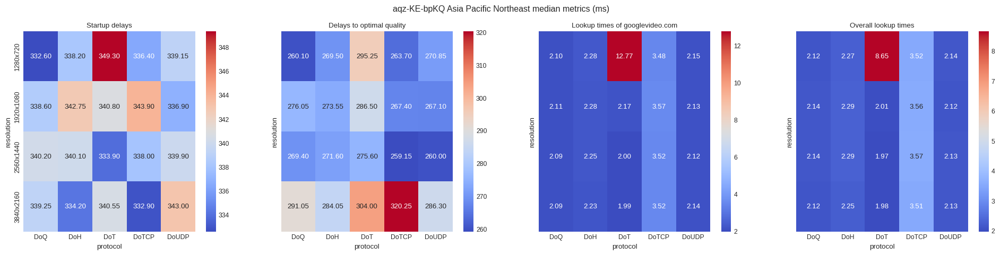

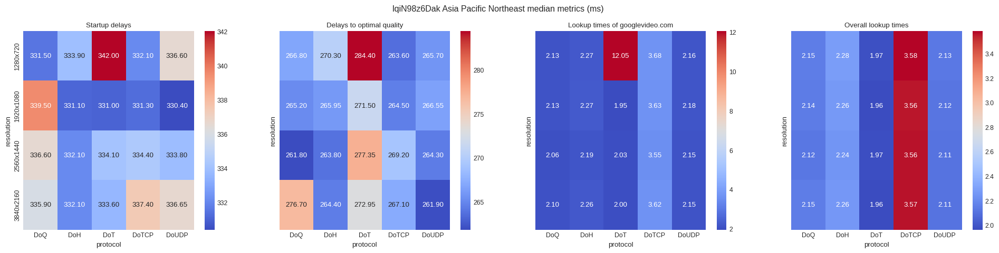

Asia Pacific Southeast


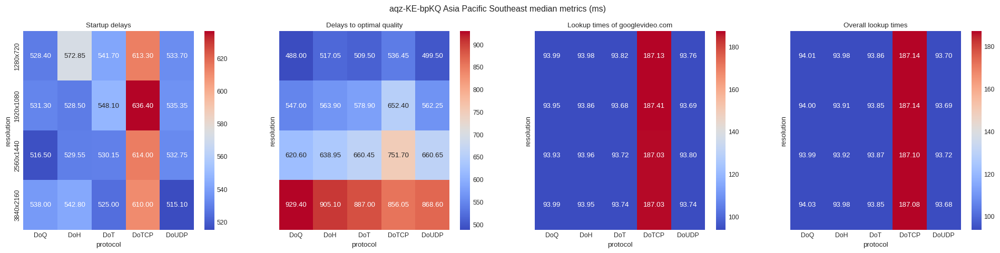

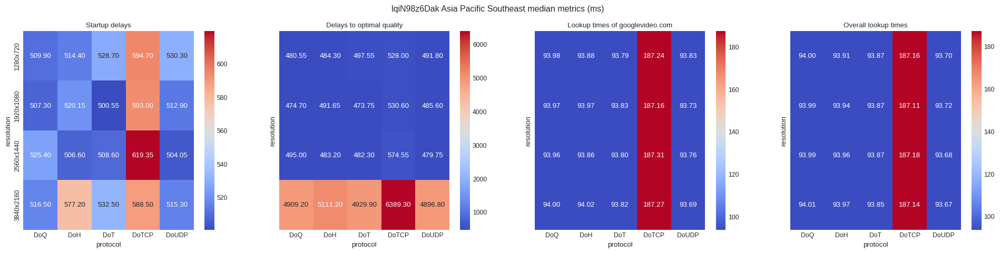

Europe Central


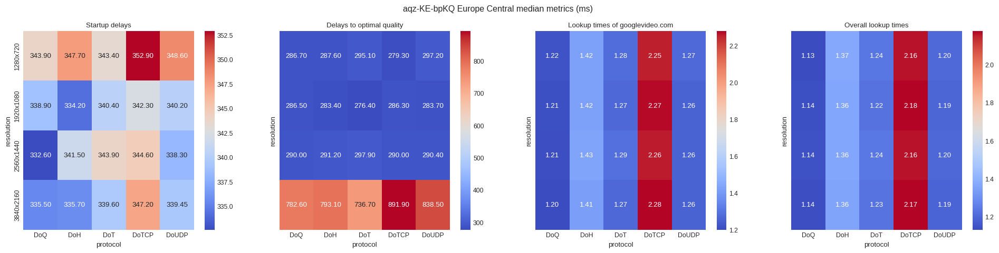

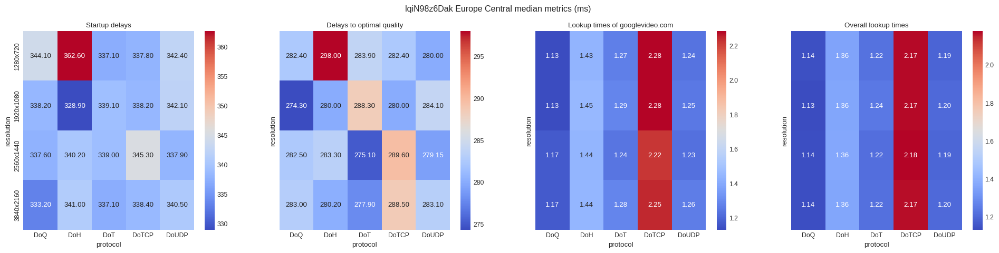

South America East


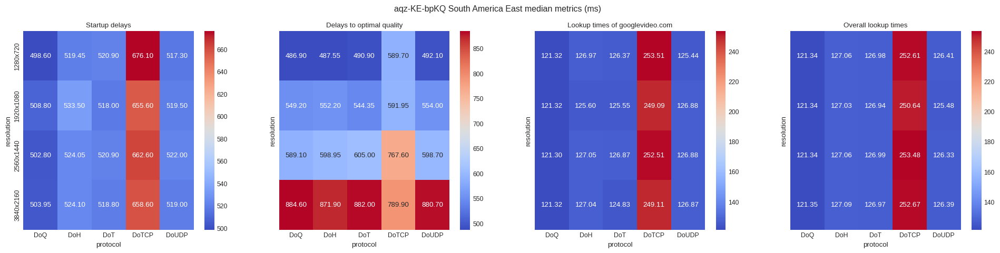

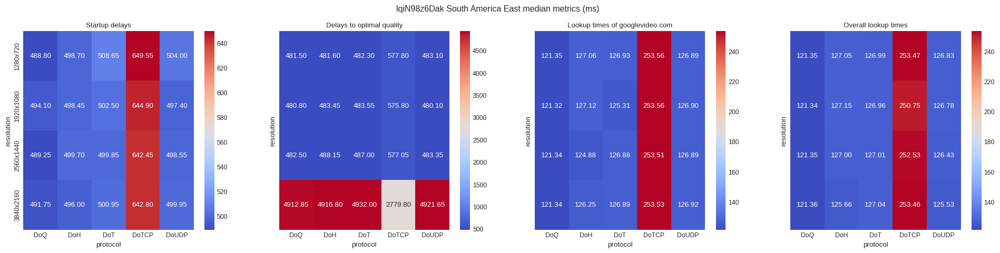

US East


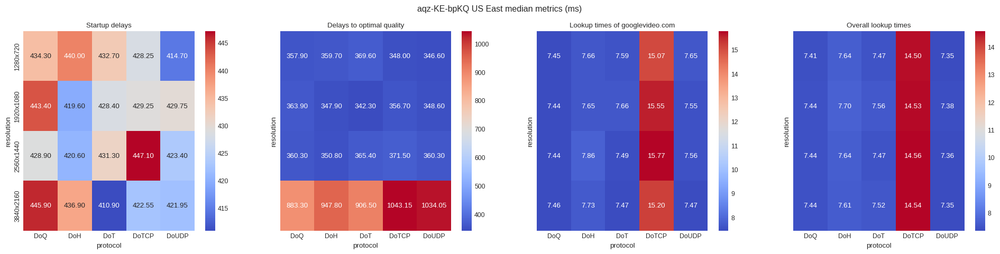

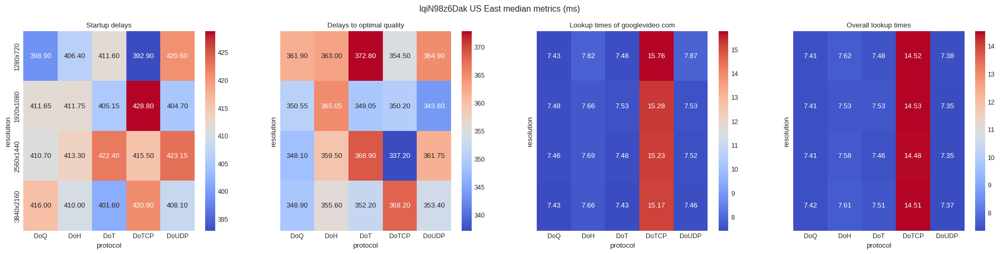

US West


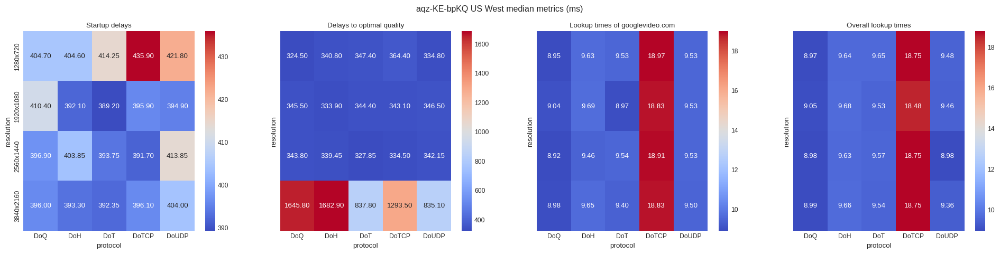

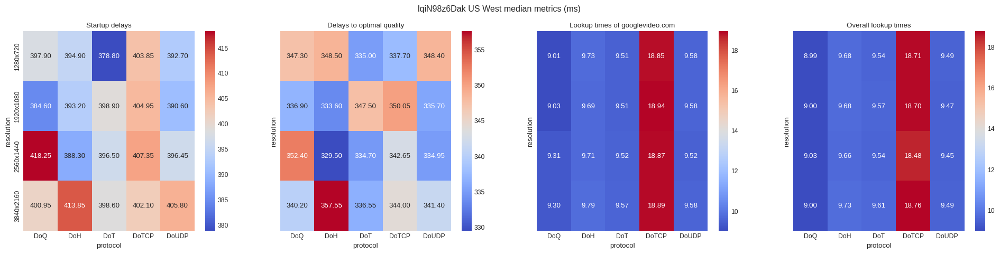

In [517]:
with plt.style.context('seaborn-whitegrid'):
    for vp in sorted(measurements['vantagePoint'].unique().tolist()):
        print(vp)
        for video in measurements['domain'].unique():
            fig, axs = plt.subplots(1, 4, sharex='all', figsize=(24,5), sharey='all')
            #fig.subplots_adjust(hspace=.2, wspace=.3)
            fig.suptitle(video+' '+vp+' median metrics (ms)')
            df_tmp_1 = startup_delay_medians[(startup_delay_medians.vantagePoint == vp) & (startup_delay_medians.domain == video)]
            df_tmp_2 = delay_to_opt_medians[(delay_to_opt_medians.vantagePoint == vp) & (delay_to_opt_medians.domain == video)]
            df_tmp_3 = df_googlevideo_lookup_time[(df_googlevideo_lookup_time.vantagePoint == vp) & (df_googlevideo_lookup_time.domain == video)]
            df_tmp_4 = df_overall_lookup_time[(df_overall_lookup_time.vantagePoint == vp) & (df_overall_lookup_time.domain == video)]

            for df, ax, title in zip(
                [df_tmp_1, df_tmp_2, df_tmp_3, df_tmp_4],
                axs.flat, ['Startup delays', 'Delays to optimal quality', 'Lookup times of googlevideo.com', 'Overall lookup times']):
                sns.heatmap(df.pivot(index='resolution', columns='protocol', values='metric'), ax=ax, cmap="coolwarm", annot=True, fmt='.2f')
                ax.set_title(title)

            plt.show()

In [368]:
df_4k_stall_count = df_stall_times[df_stall_times.player_dimensions == '3840x2160'].groupby('msm_id', as_index=False).agg({'stall_time':'count'})
df_4k_stall_count.stall_time.value_counts()

3    2250
2     991
1     413
Name: stall_time, dtype: int64

In [369]:
one_stall = df_4k_stall_count[df_4k_stall_count.stall_time == 1].msm_id.unique().tolist()
two_stalls = df_4k_stall_count[df_4k_stall_count.stall_time == 2].msm_id.unique().tolist()
three_stalls = df_4k_stall_count[df_4k_stall_count.stall_time == 3].msm_id.unique().tolist()

In [370]:
df_4k_stalls = df_stall_times[df_stall_times.player_dimensions == '3840x2160'].copy().drop_duplicates()

In [371]:
first_stall = df_4k_stalls.loc[df_4k_stalls.groupby('msm_id').time.idxmin()].reset_index(drop=True).drop_duplicates()
latest_stall = df_4k_stalls.loc[df_4k_stalls.groupby('msm_id').time.idxmax()].reset_index(drop=True).drop_duplicates()

In [372]:
#get the second stall out of three by removing all first stalls and all last stalls -> this breaks if there are 4 stalls
#remove single stalls from the first merge because they would then get added in the second merge without getting dropped
second_stall_of_three = pd.concat([df_4k_stalls, first_stall[~first_stall.msm_id.isin(one_stall)]]).drop_duplicates(keep=False)
second_stall_of_three = pd.concat([second_stall_of_three, latest_stall]).drop_duplicates(keep=False)

In [373]:
print(first_stall.msm_id.nunique())
print(second_stall_of_three.msm_id.nunique())
print(latest_stall.msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(one_stall)].msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(two_stalls)].msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(three_stalls)].msm_id.nunique())
print(latest_stall[~latest_stall.msm_id.isin(one_stall+two_stalls+three_stalls)].msm_id.nunique())
print(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)].msm_id.nunique())
print(second_stall_of_three[~second_stall_of_three.msm_id.isin(three_stalls)].msm_id.nunique())

3654
2250
3654
413
991
2250
0
2250
0


In [374]:
first_stall

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain,stall_time
0,2022-03-09 21:16:25.792400128,00135f60-bf34-db54-1290-a57f2eaee2ae,hd2160,2022-03-09 21:16:25.061799936,19.272848,hd2160,3840x2160,DoQ,Asia Pacific Southeast,aqz-KE-bpKQ,0.7306
1,2022-03-08 15:25:18.092600064,0019bce6-153e-8041-6e54-54aacbde8e1a,hd2160,2022-03-08 15:25:13.246500096,17.803340,hd2160,3840x2160,DoQ,US East,aqz-KE-bpKQ,4.8461
2,2022-03-08 12:30:21.525799936,001a4f2e-eac5-ac37-fa6f-0257546fb4db,hd2160,2022-03-08 12:30:19.535800064,28.110590,hd2160,3840x2160,DoQ,US East,aqz-KE-bpKQ,1.9900
3,2022-03-09 22:54:53.156400128,002ea5d3-1ebf-1321-8071-be320d652c80,hd2160,2022-03-09 22:54:52.341900032,19.262204,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ,0.8145
4,2022-03-08 17:55:49.151300096,0051b017-e2a9-edc0-6bfd-af9e4fc775f3,hd2160,2022-03-08 17:55:44.584600064,17.837604,hd2160,3840x2160,DoUDP,US West,aqz-KE-bpKQ,4.5667
...,...,...,...,...,...,...,...,...,...,...,...
3649,2022-03-10 22:14:20.093199872,ffe5d6bd-afea-bb33-852b-2dc3f001c28d,hd2160,2022-03-10 22:14:19.516499968,14.956070,hd2160,3840x2160,DoT,Europe Central,aqz-KE-bpKQ,0.5767
3650,2022-03-10 12:35:11.316199936,ffe65521-24ae-99d7-c807-f491624b0376,hd2160,2022-03-10 12:35:08.547400192,17.844986,hd2160,3840x2160,DoTCP,Asia Pacific Northeast,aqz-KE-bpKQ,2.7688
3651,2022-03-09 18:09:25.674500096,ffeb3d6e-8e58-d05f-61d9-d65852a01042,hd2160,2022-03-09 18:09:23.081899776,17.816993,hd2160,3840x2160,DoT,Asia Pacific Northeast,aqz-KE-bpKQ,2.5926
3652,2022-03-08 14:50:10.927700224,fff66457-a7f8-1f07-7ebf-98bd5e771f35,hd2160,2022-03-08 14:50:06.402600192,17.809466,hd2160,3840x2160,DoQ,US West,aqz-KE-bpKQ,4.5251


Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central


/tmp/ipykernel_29115/1327244453.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6,8))


South America East
US East
US West


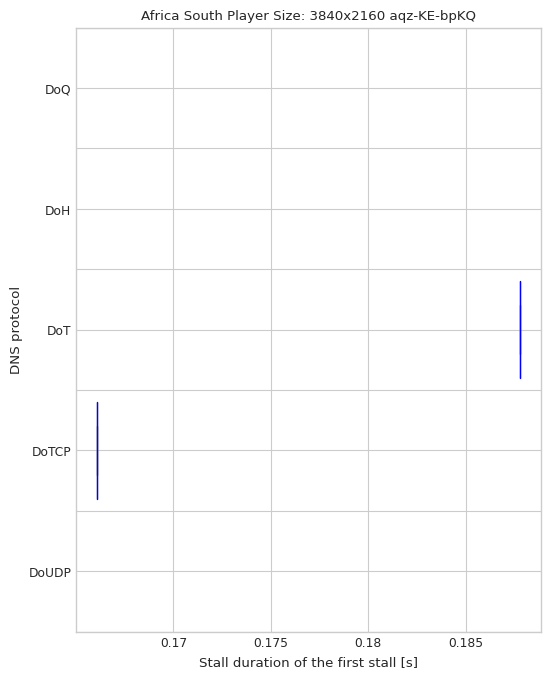

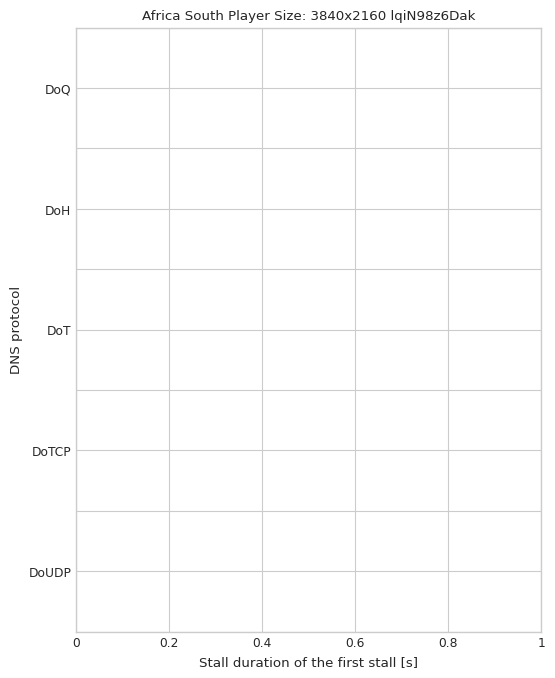

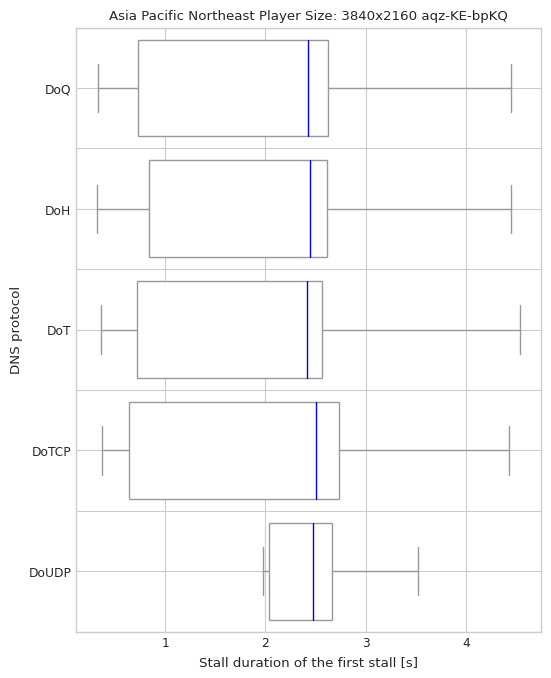

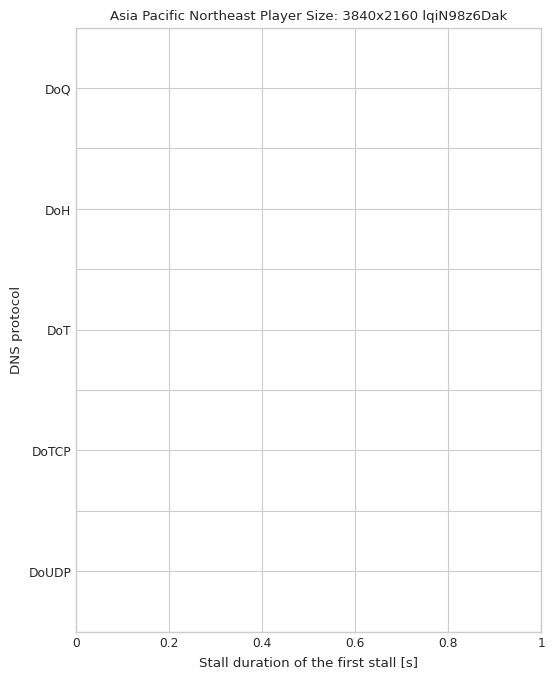

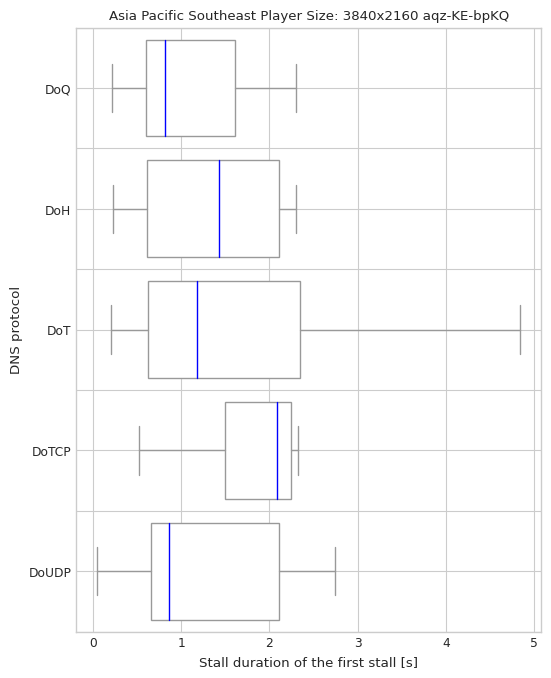

...

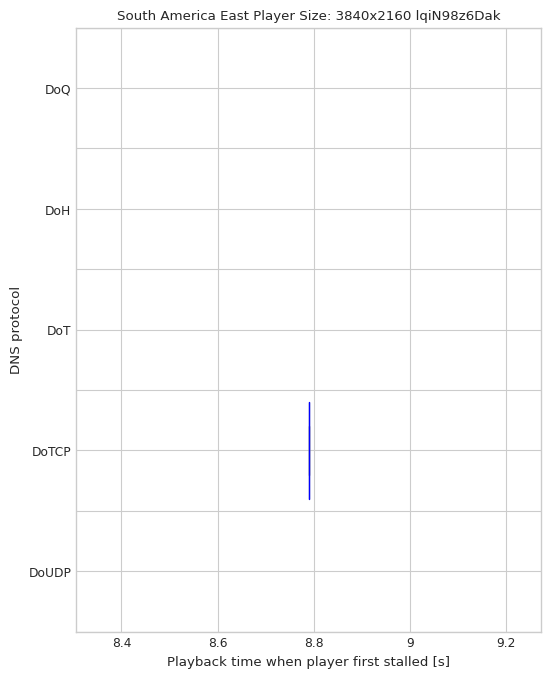

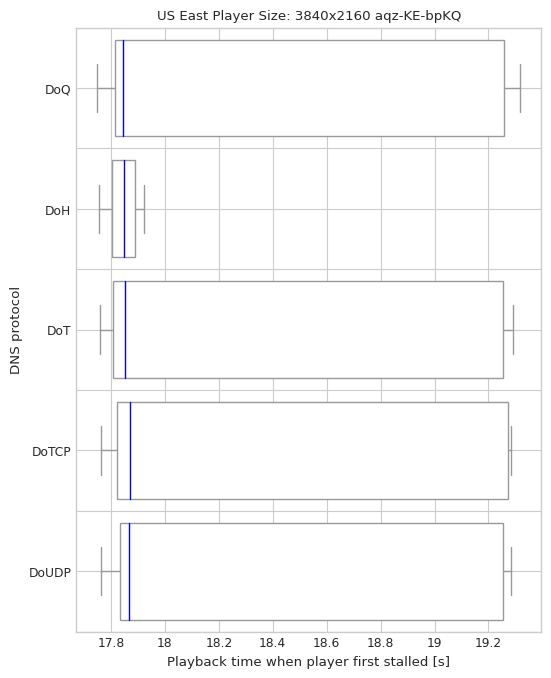

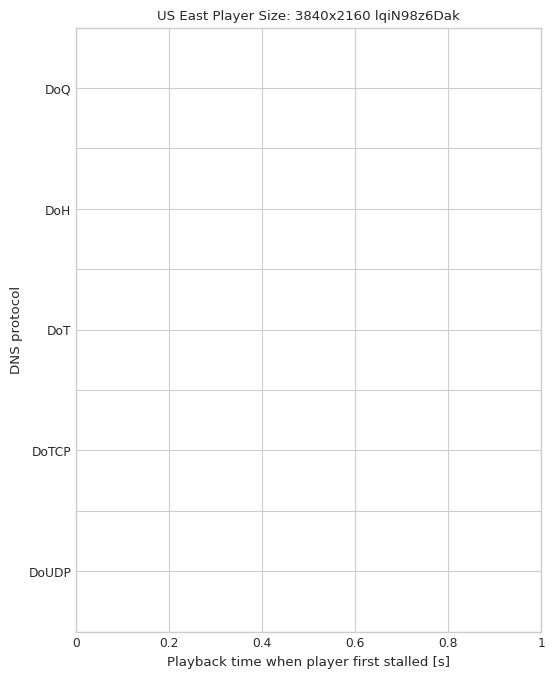

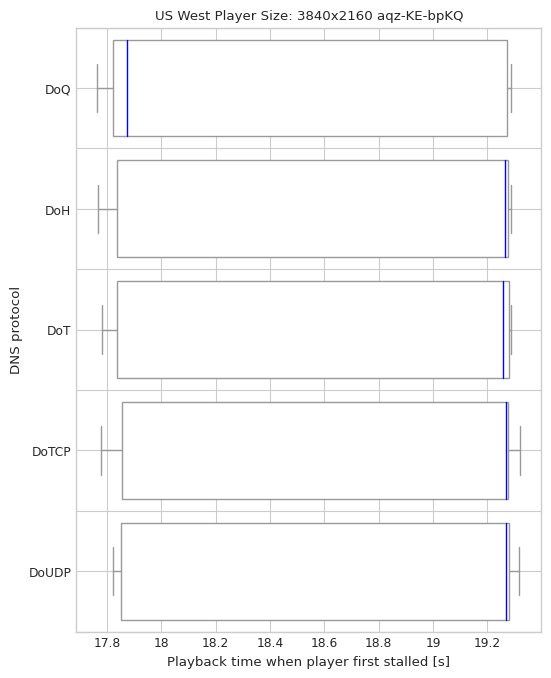

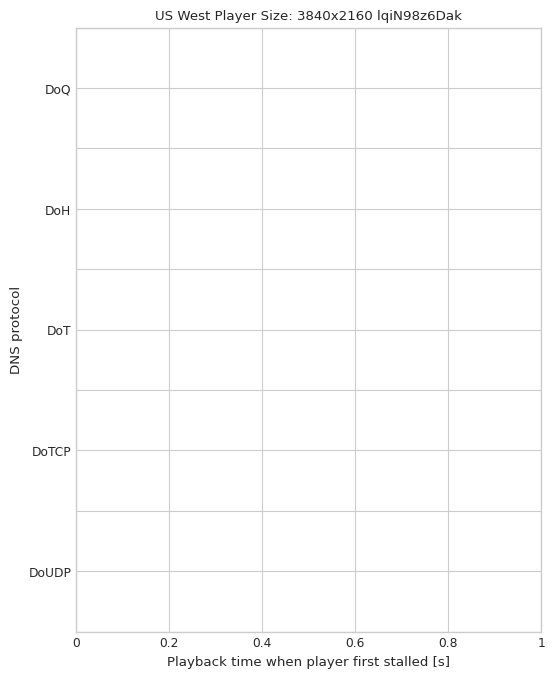

In [534]:
draw_boxplot(first_stall, 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Player Size:', 'first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall, 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Player Size:', 'first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central


/tmp/ipykernel_29115/1327244453.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6,8))


South America East
US East
US West


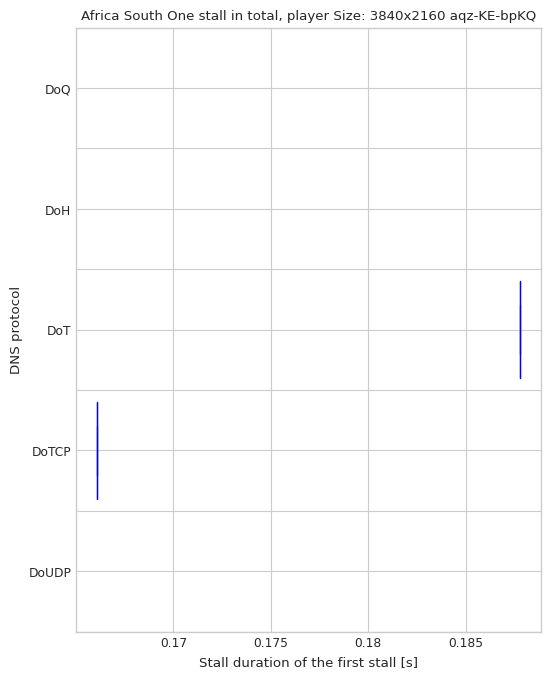

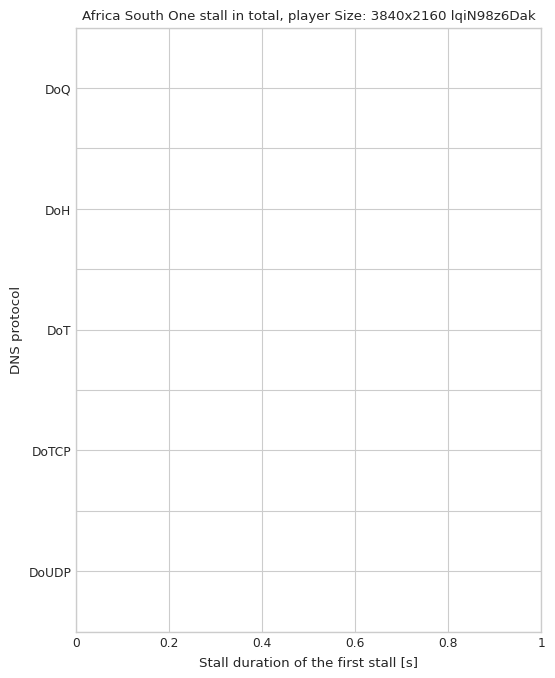

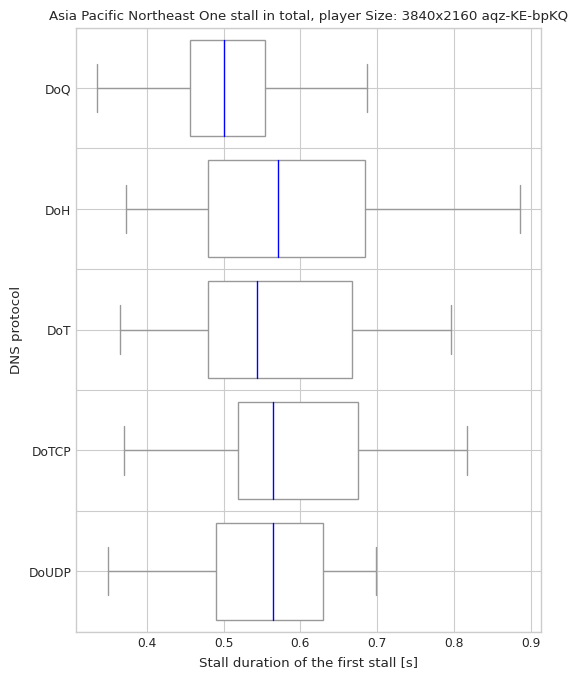

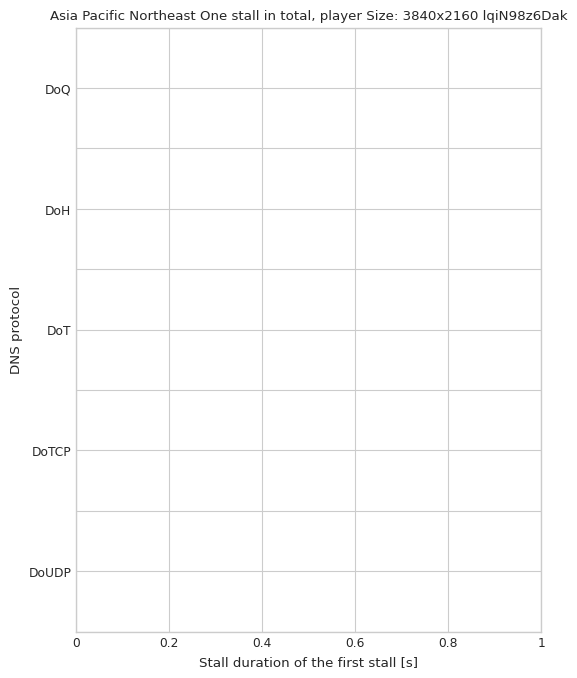

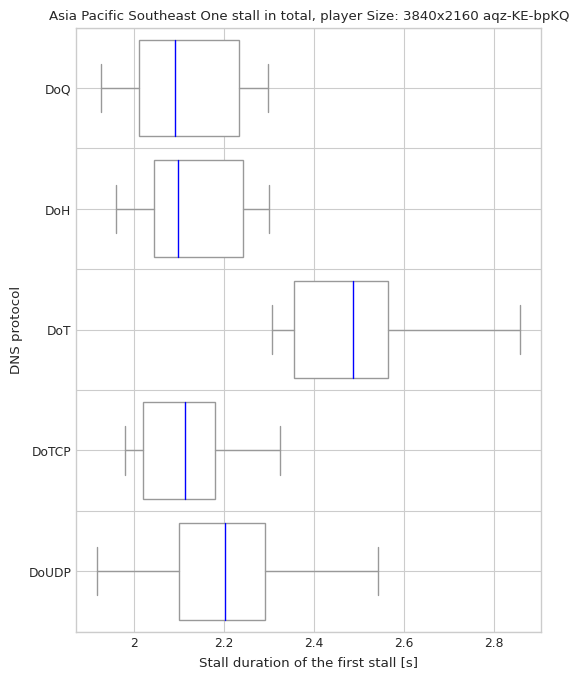

...

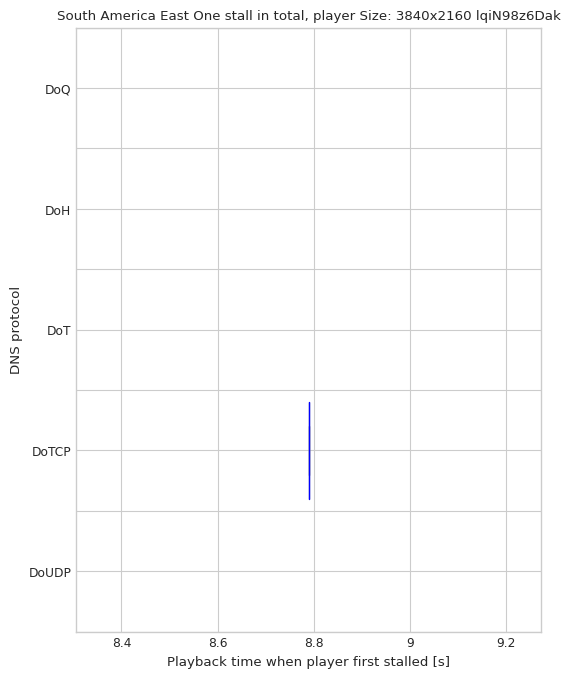

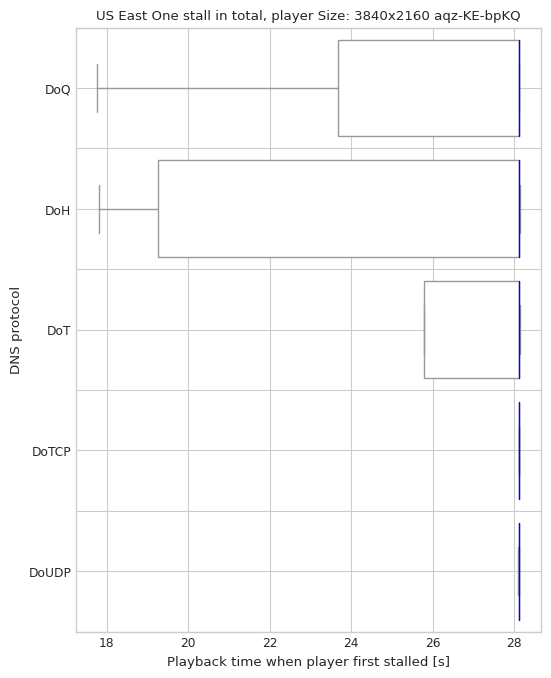

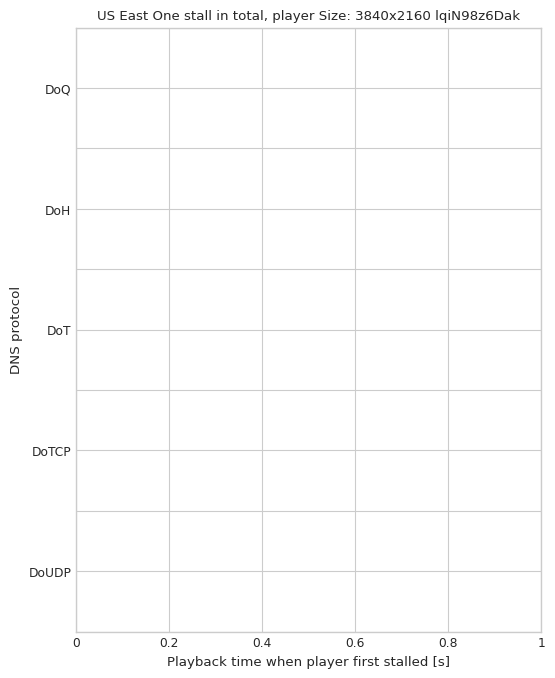

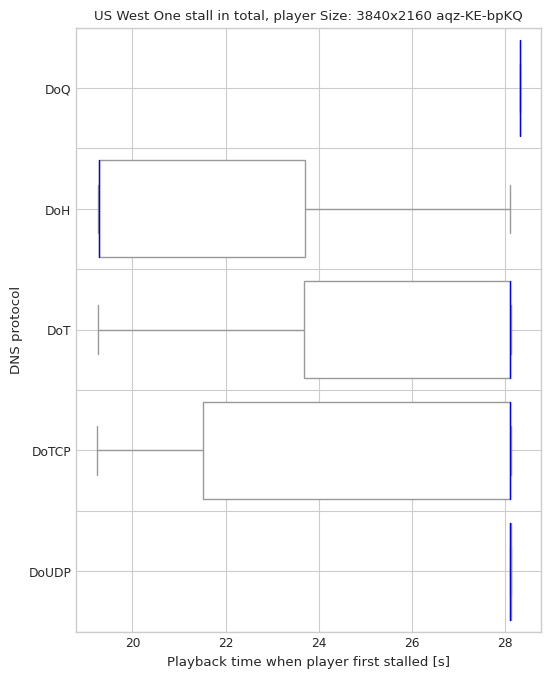

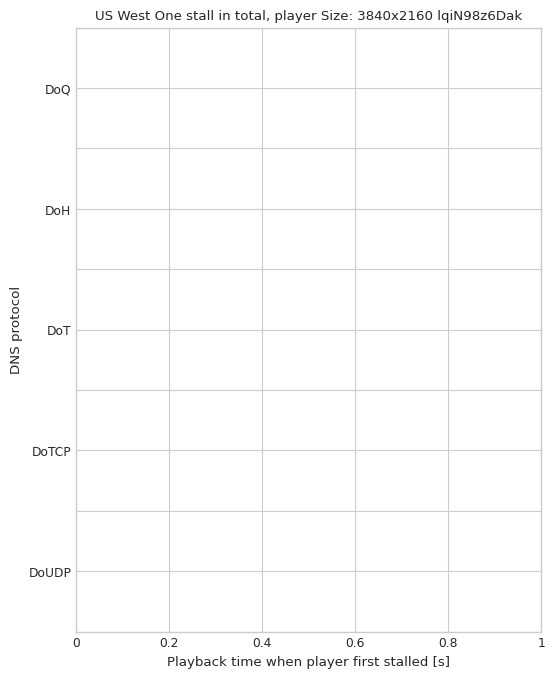

In [535]:
draw_boxplot(first_stall[first_stall.msm_id.isin(one_stall)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'One stall in total, player Size:', 'one-stall-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(one_stall)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'One stall in total, player Size:', 'one-stall-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


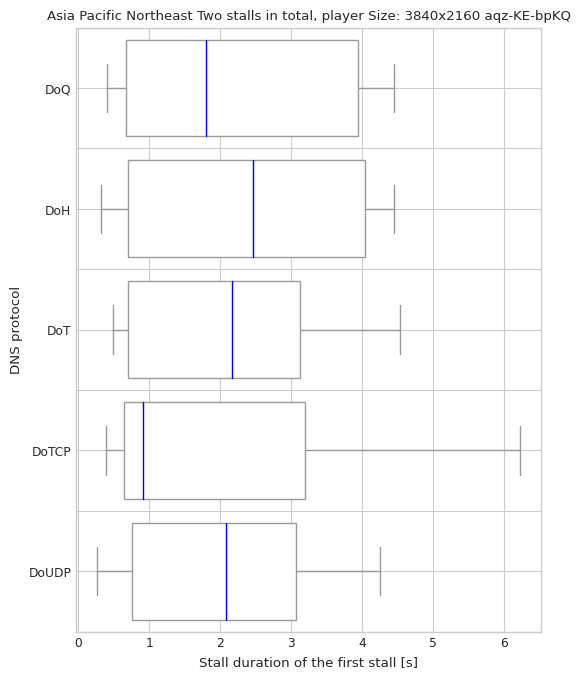

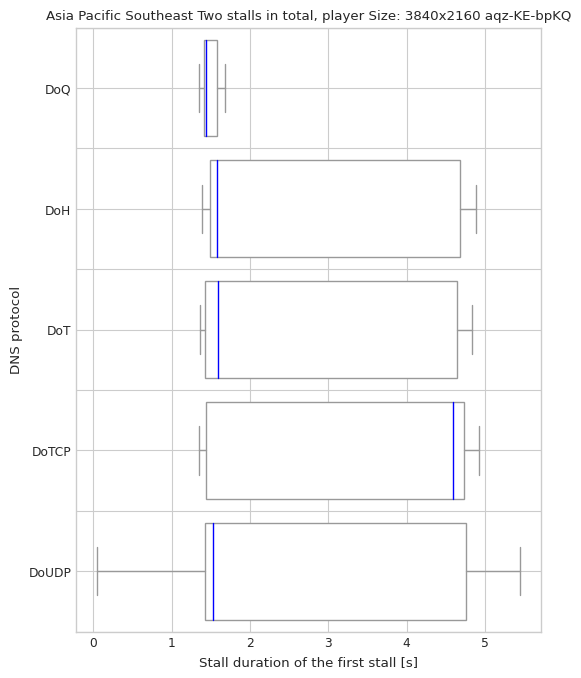

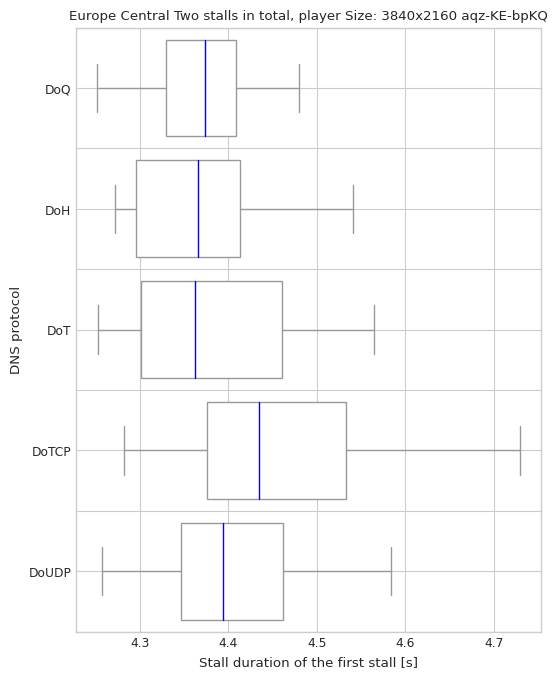

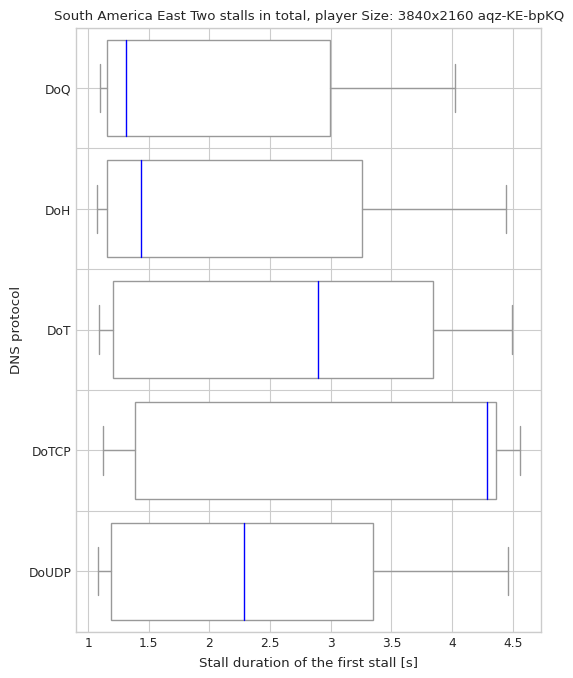

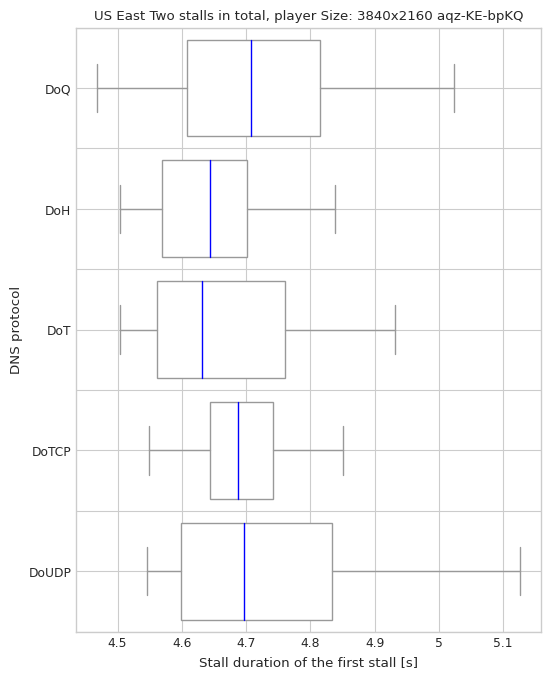

...

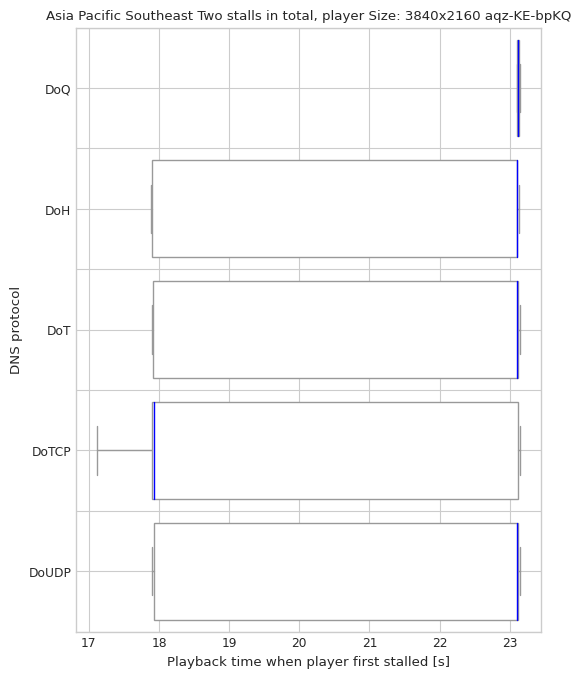

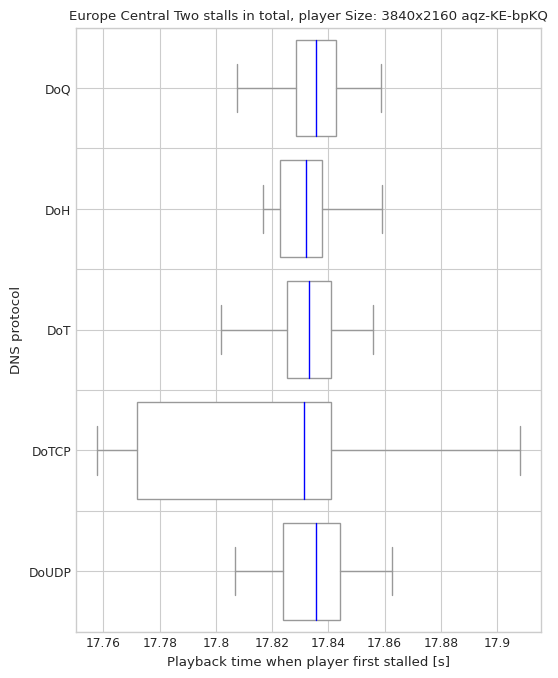

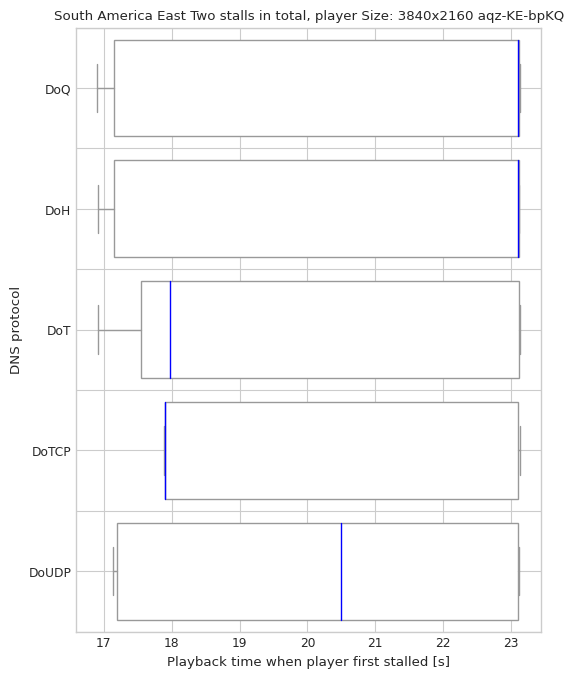

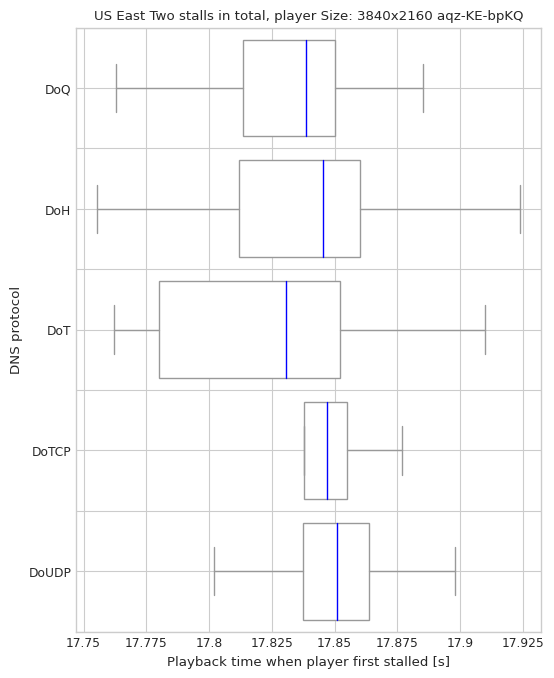

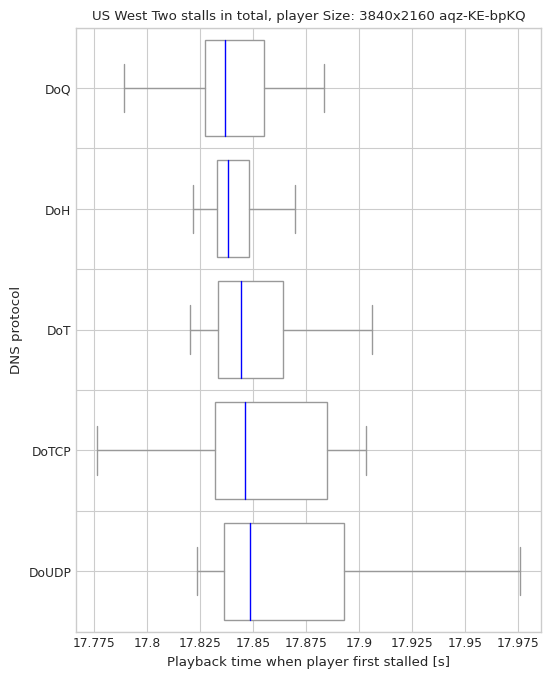

In [536]:
draw_boxplot(first_stall[first_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Two stalls in total, player Size:', 'two-stalls-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Two stalls in total, player Size:', 'two-stalls-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


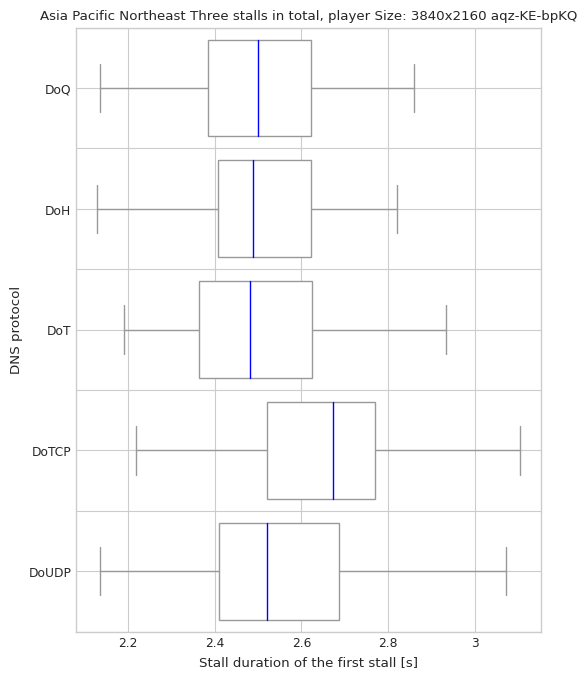

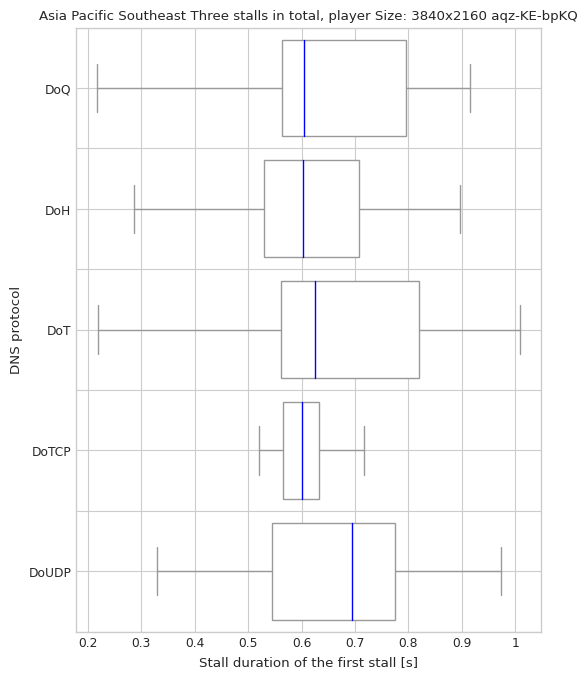

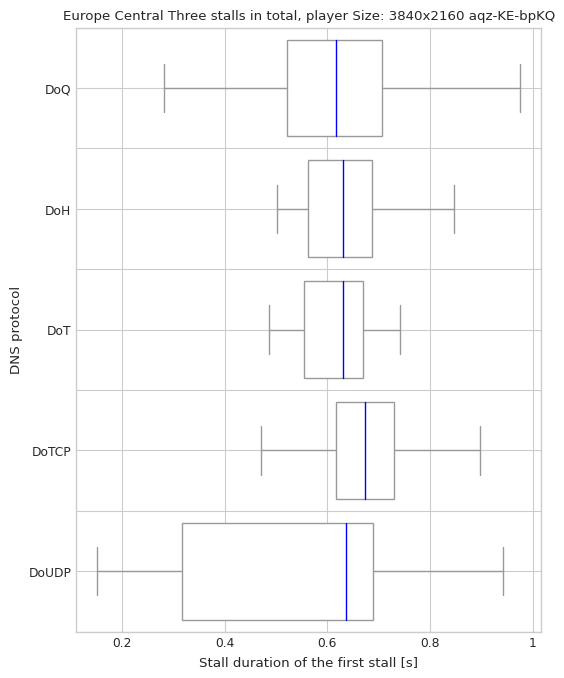

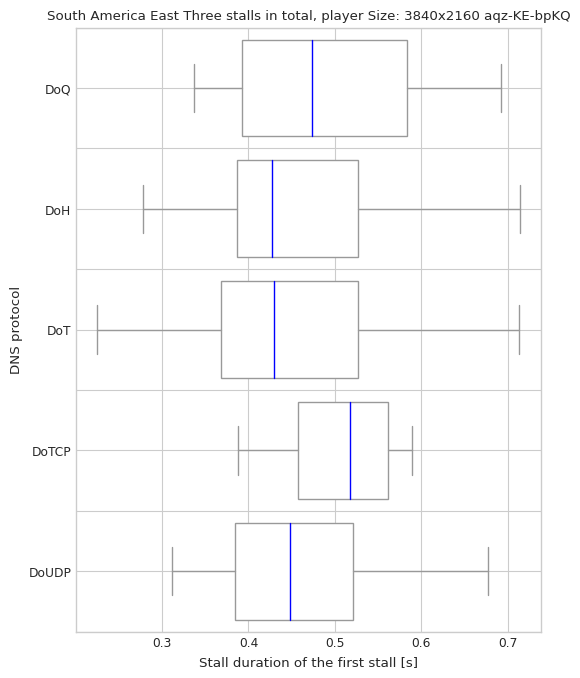

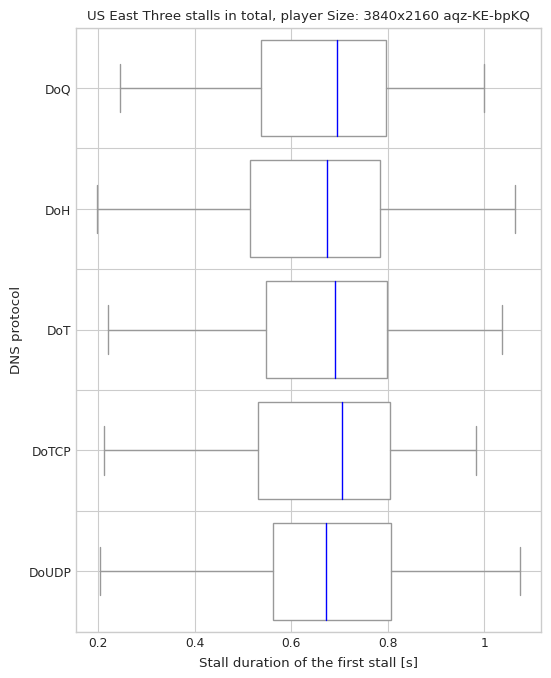

...

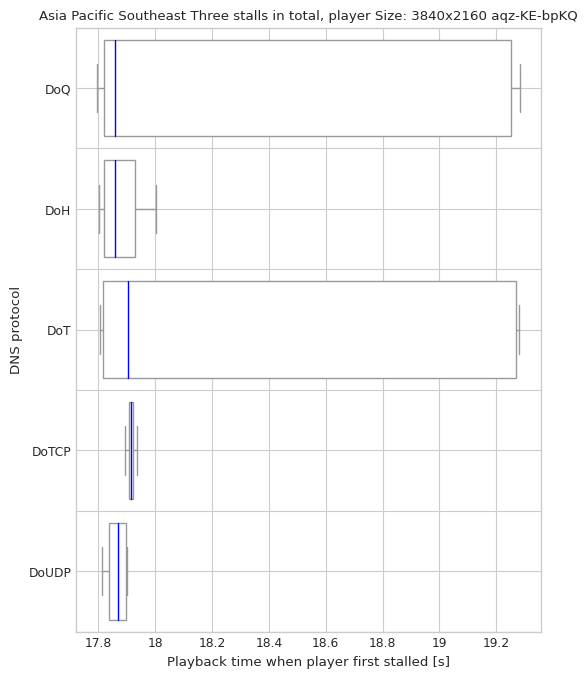

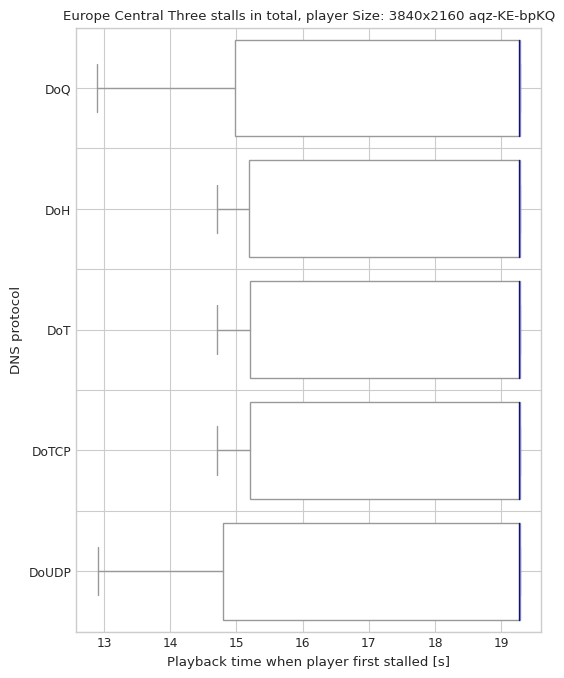

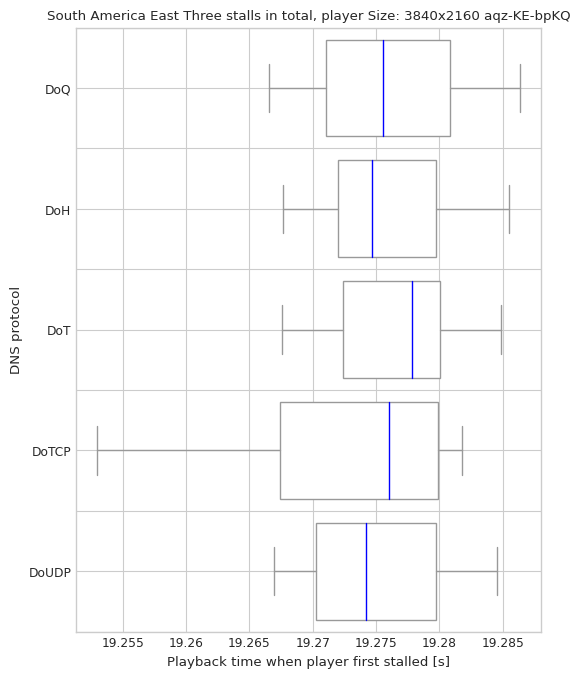

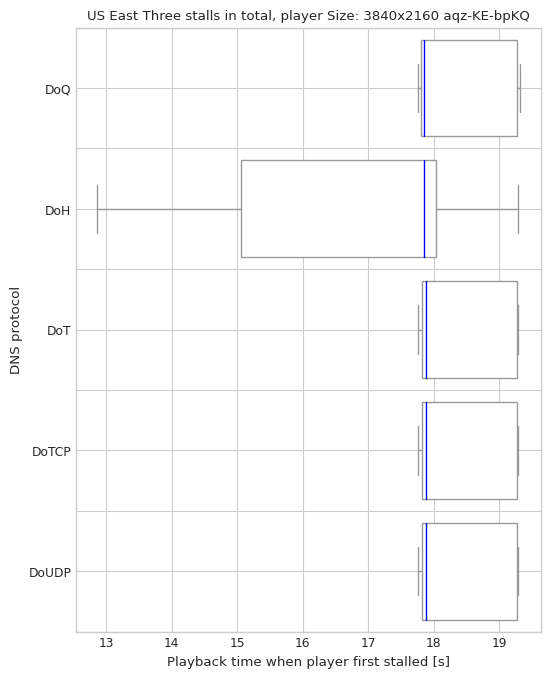

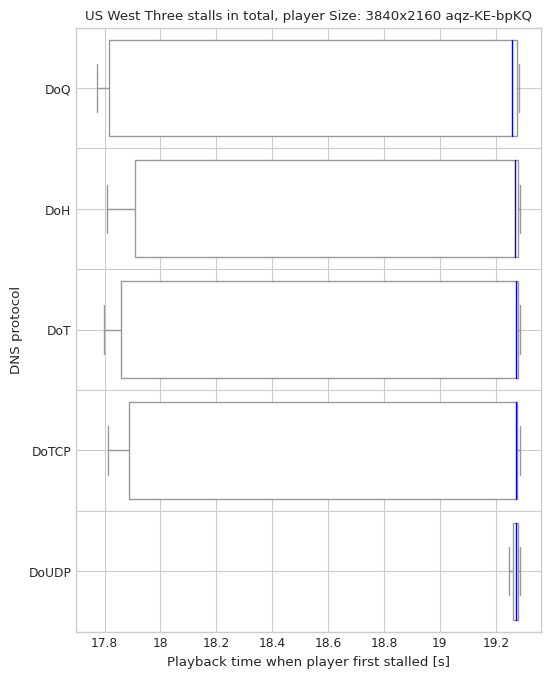

In [537]:
draw_boxplot(first_stall[first_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Three stalls in total, player Size:', 'three-stalls-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Three stalls in total, player Size:', 'three-stalls-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


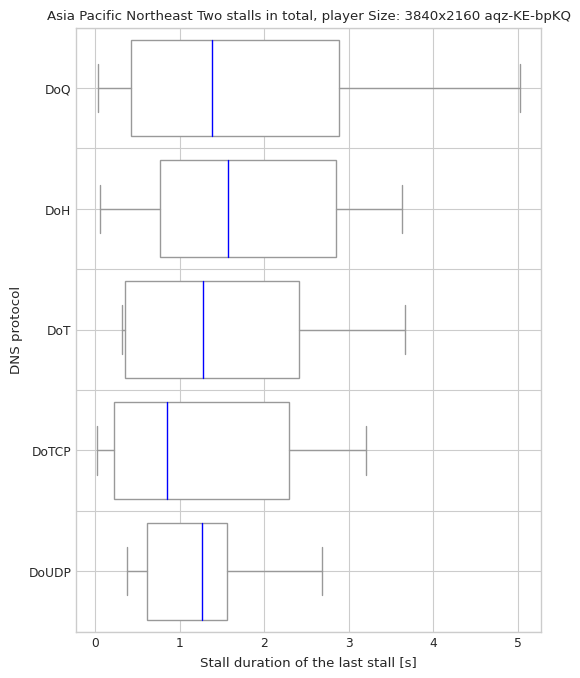

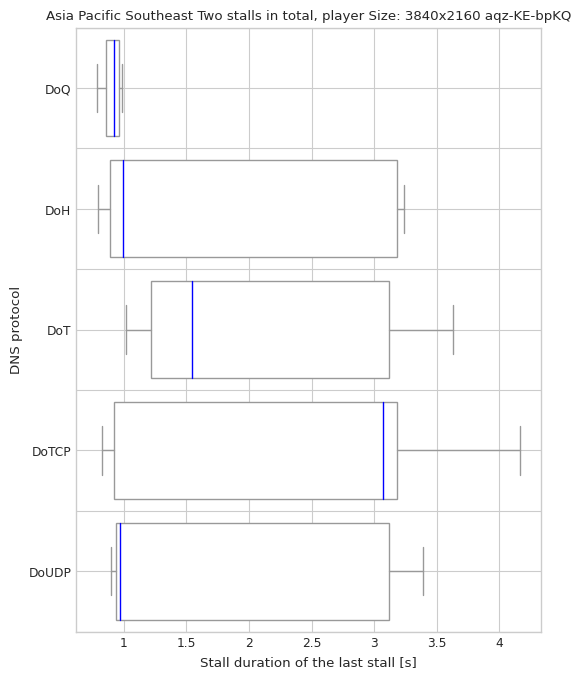

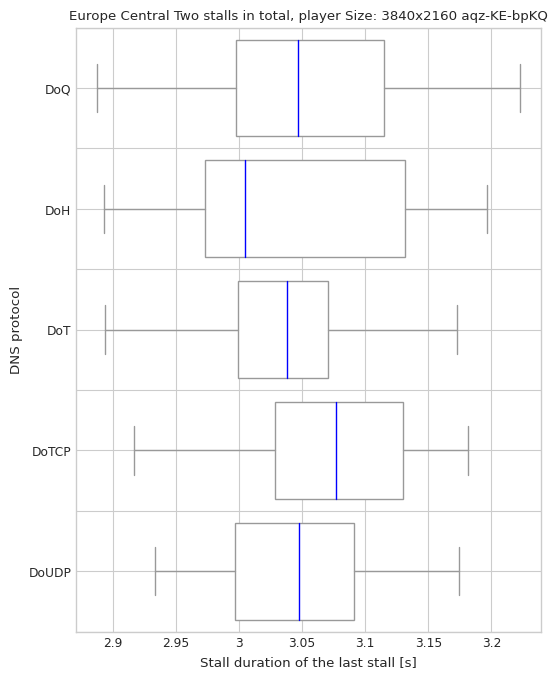

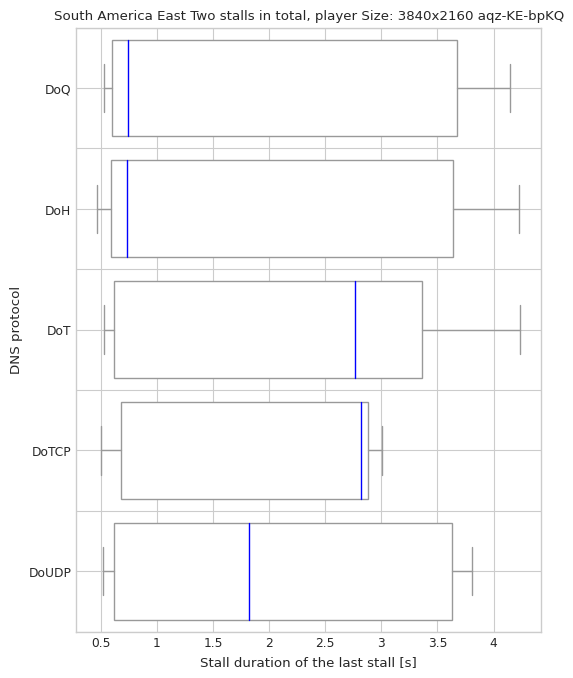

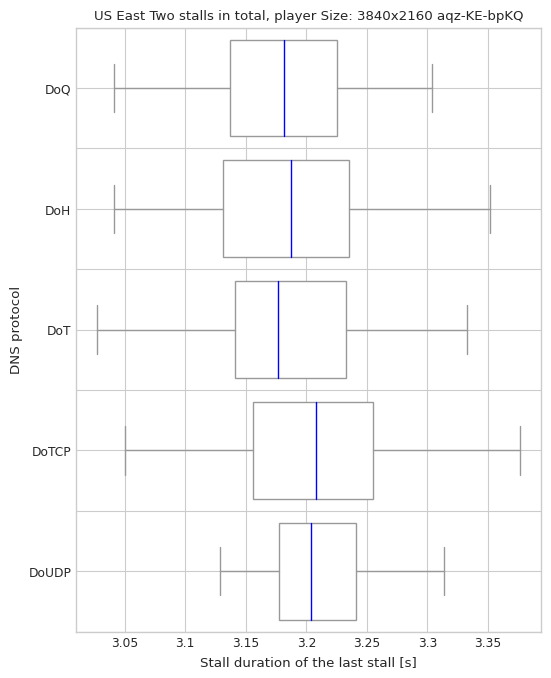

...

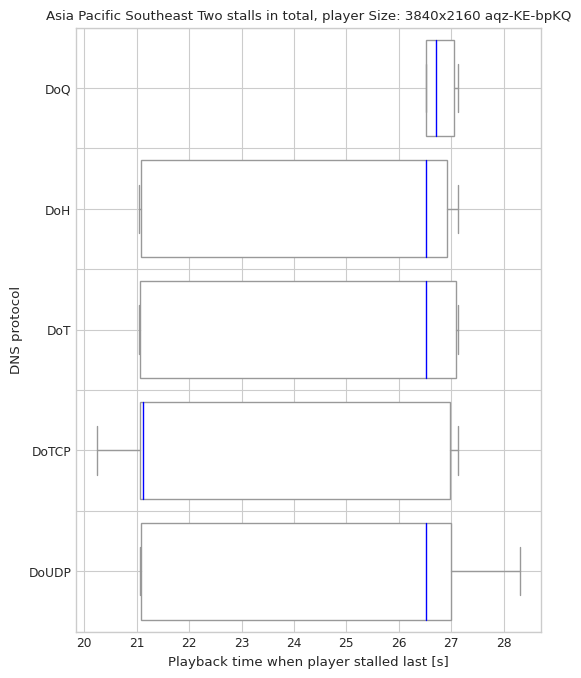

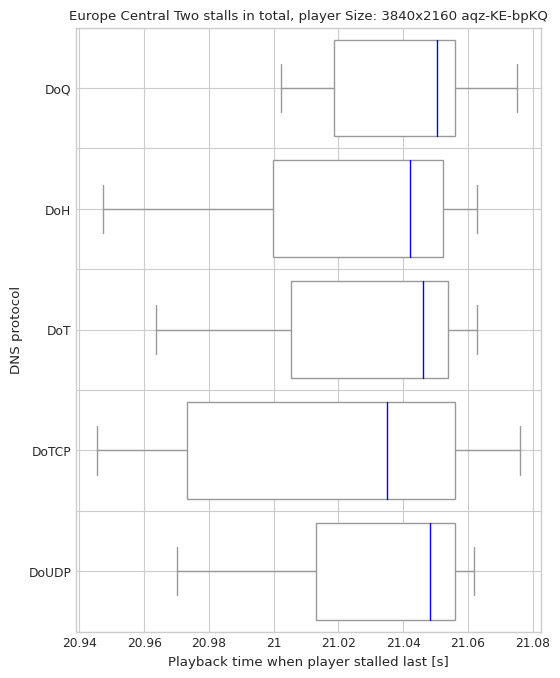

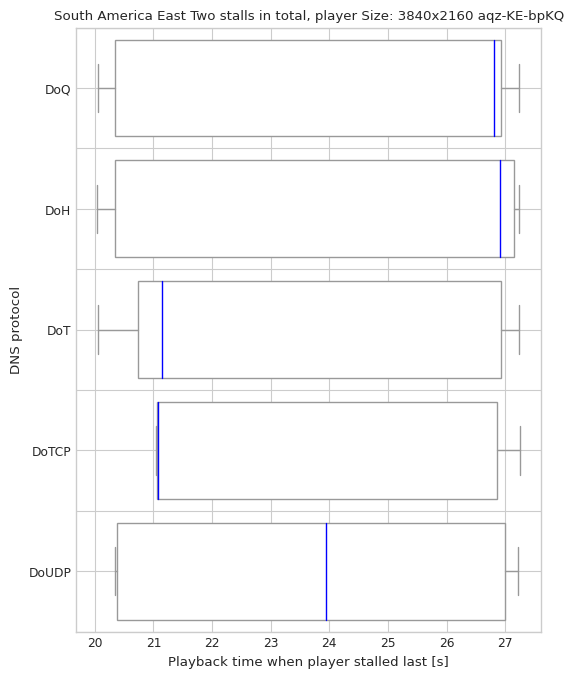

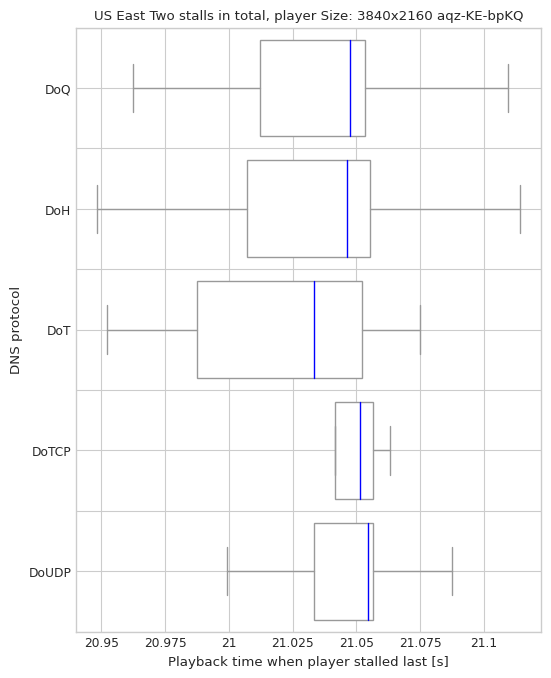

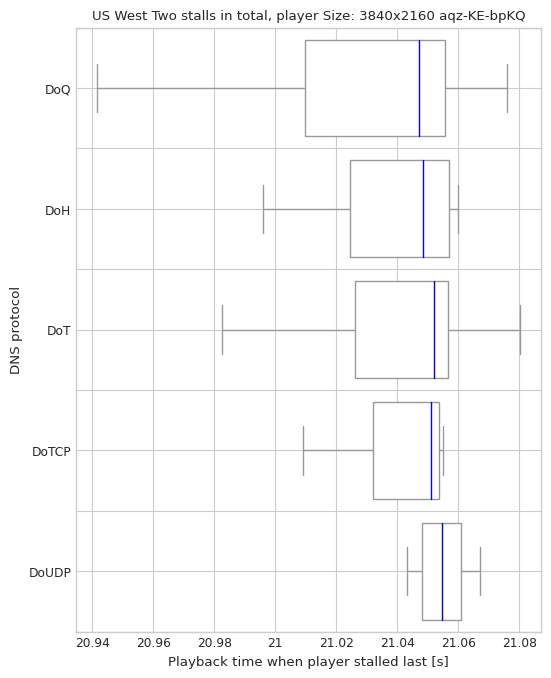

In [538]:
draw_boxplot(latest_stall[latest_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the last stall [s]', 'Two stalls in total, player Size:', 'two-stalls-last-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(latest_stall[latest_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled last [s]', 'Two stalls in total, player Size:', 'two-stalls-last-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


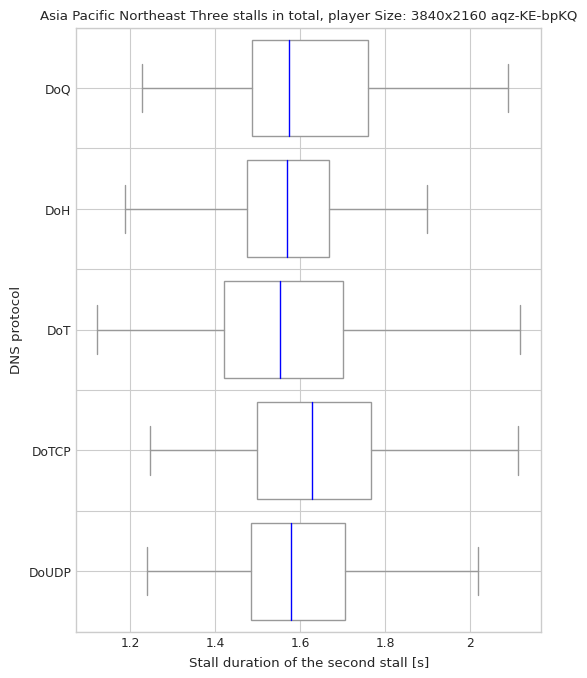

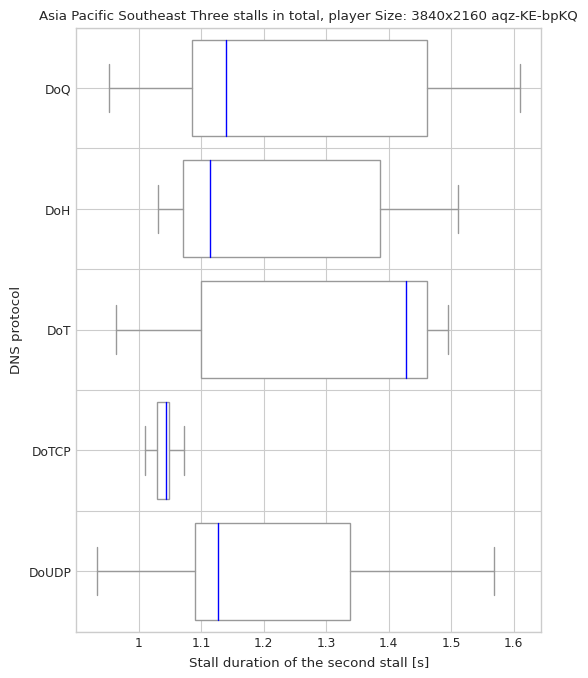

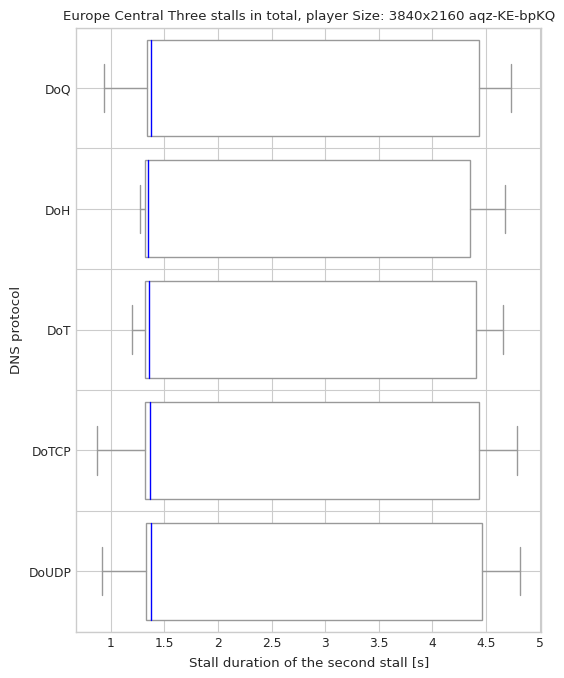

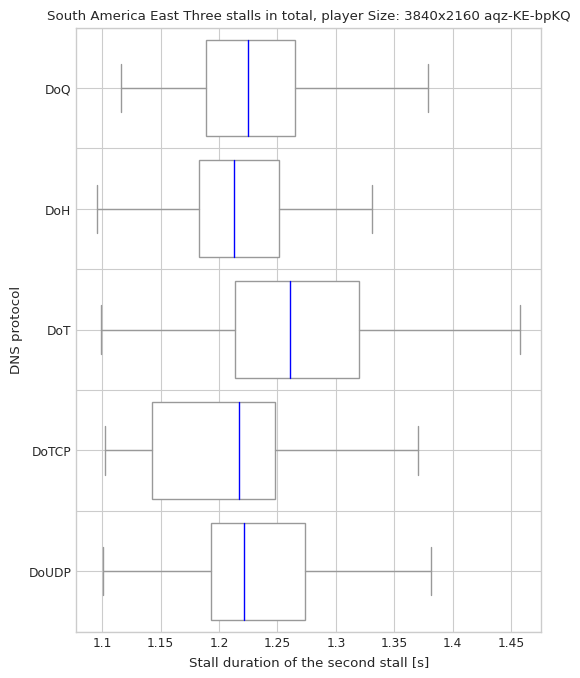

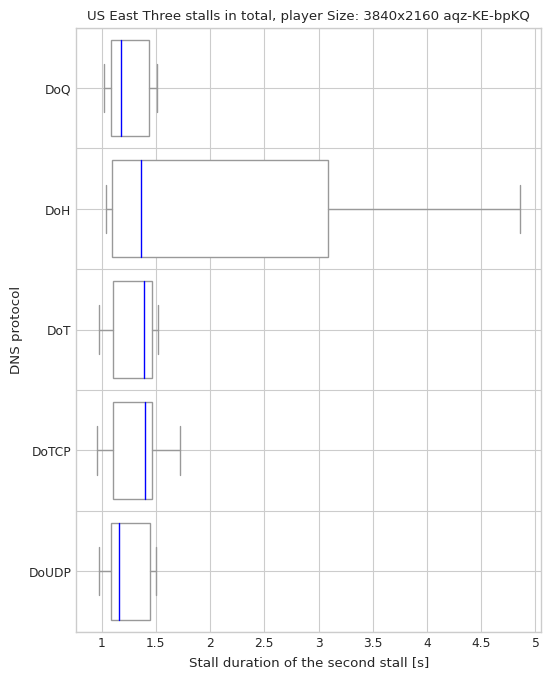

...

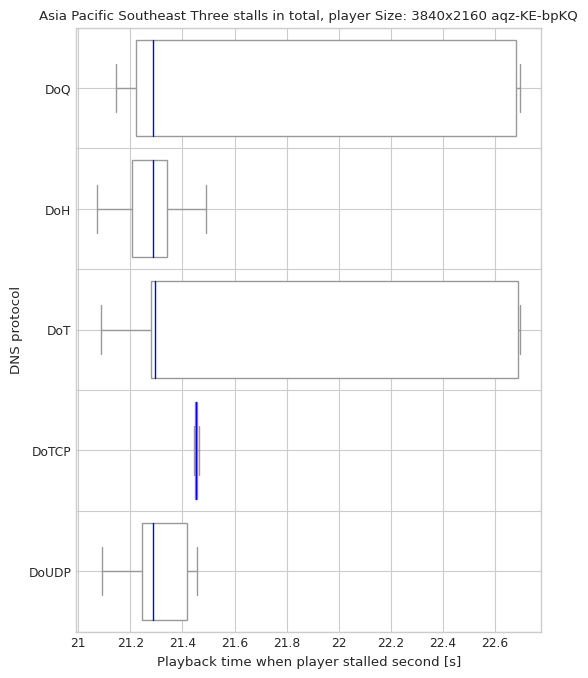

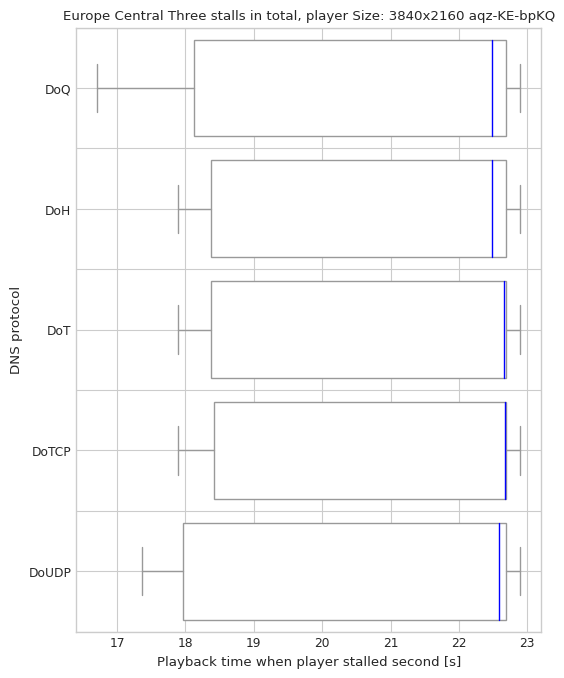

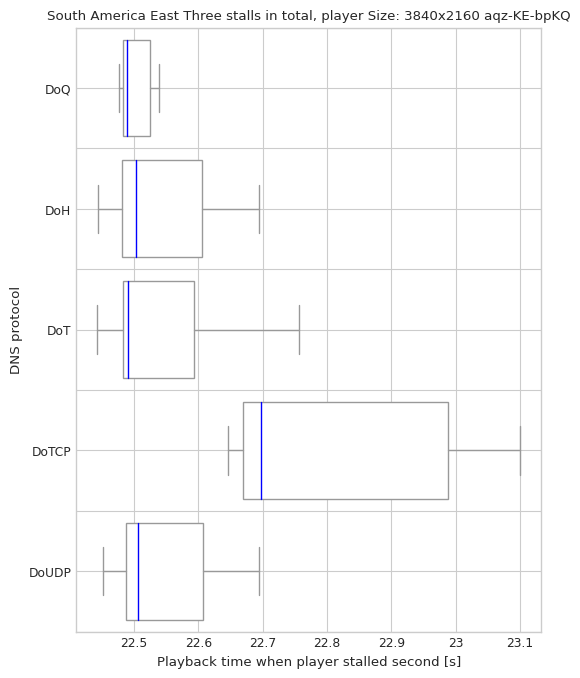

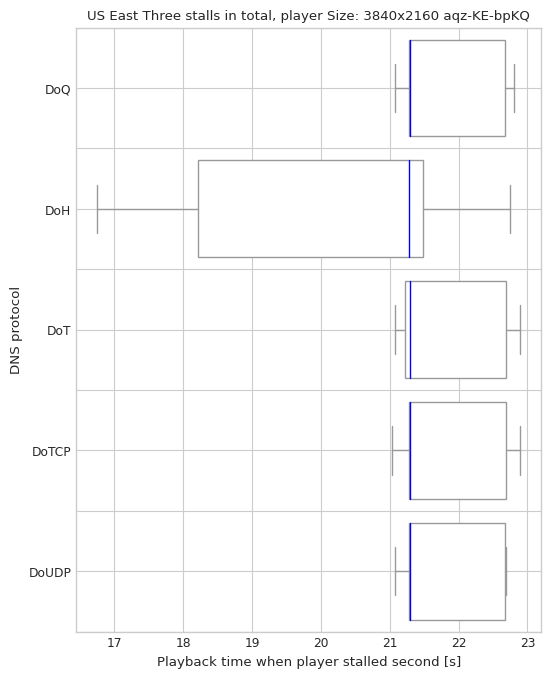

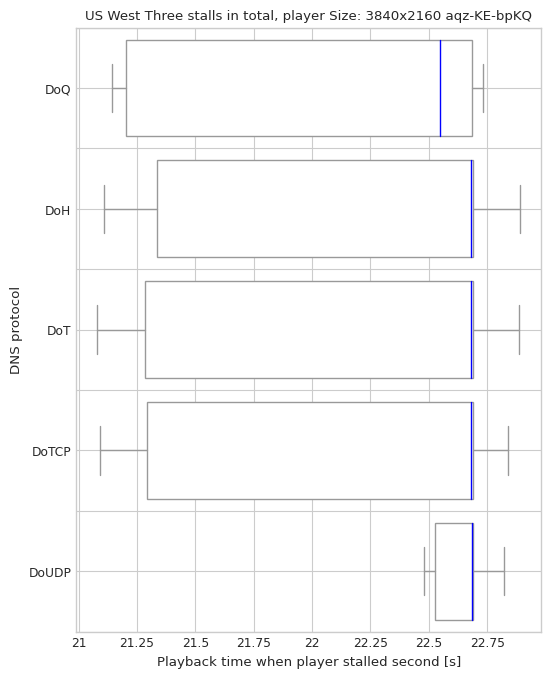

In [539]:
draw_boxplot(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the second stall [s]', 'Three stalls in total, player Size:', 'three-stalls-second-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled second [s]', 'Three stalls in total, player Size:', 'three-stalls-second-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


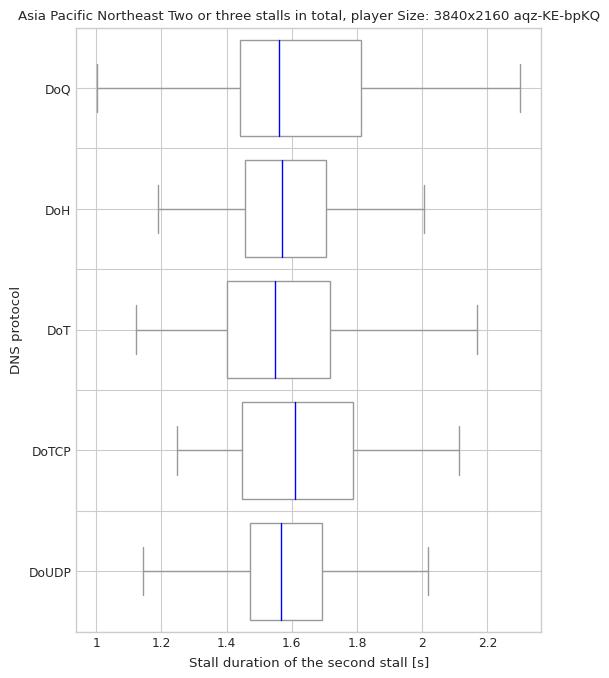

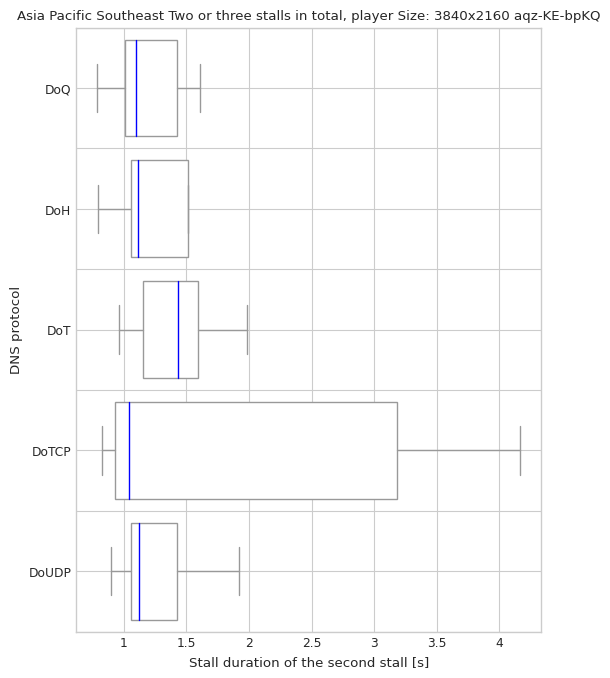

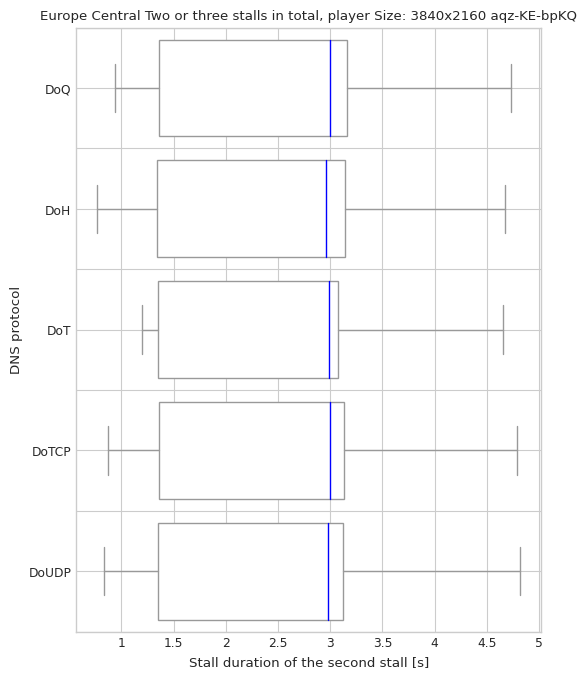

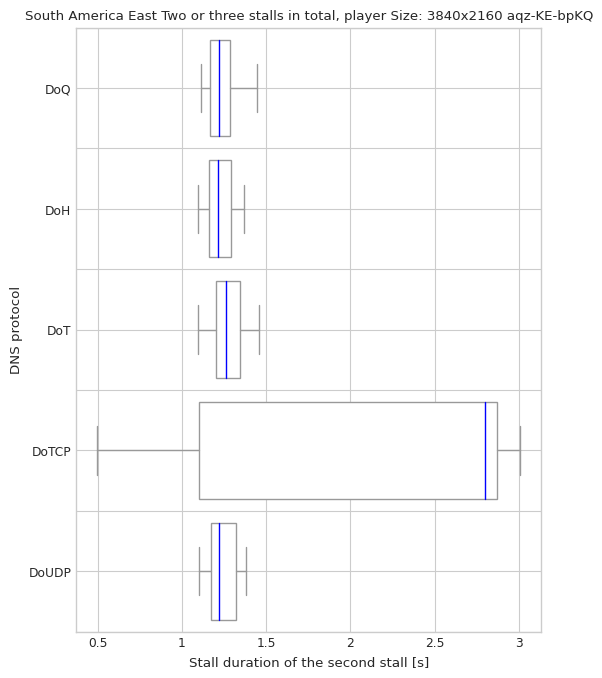

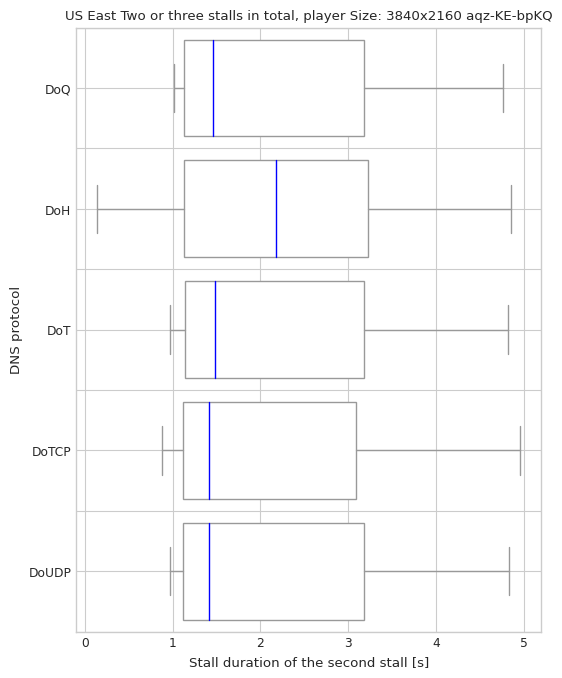

...

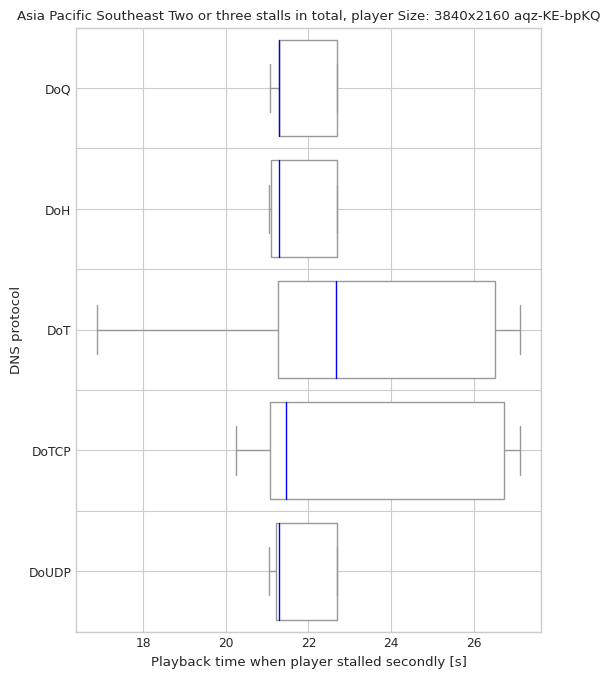

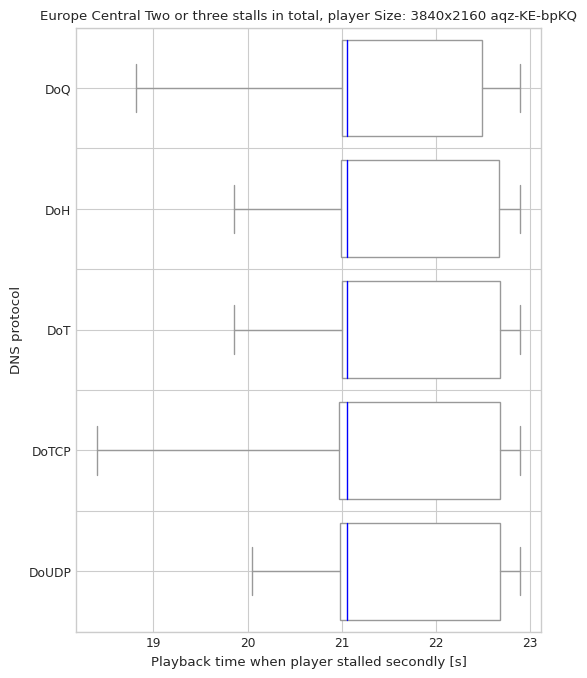

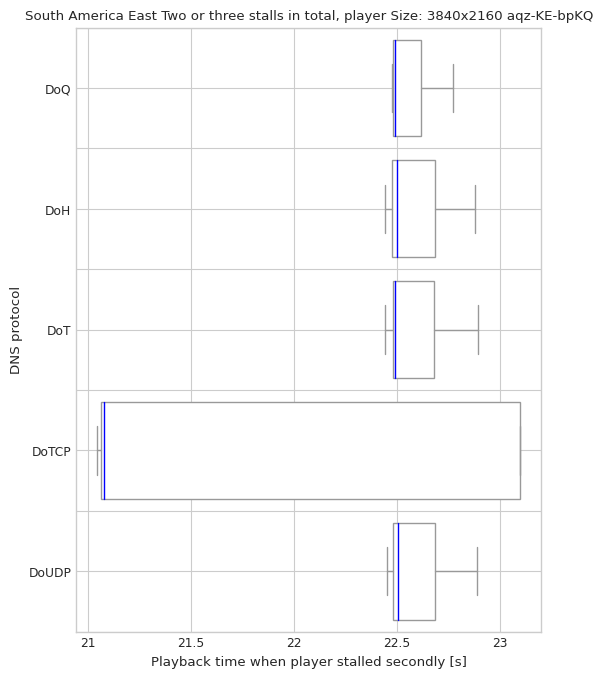

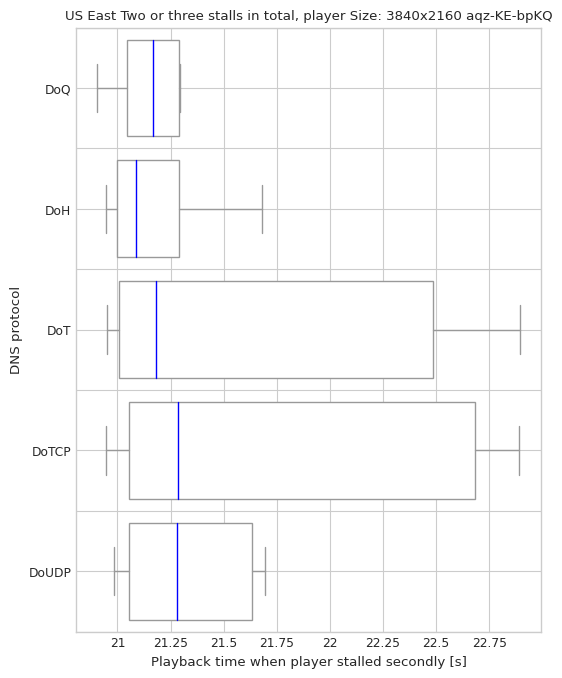

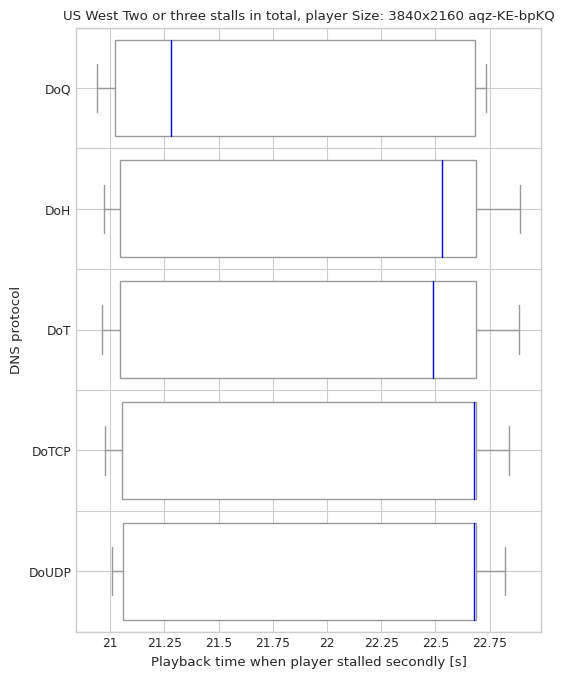

In [540]:
draw_boxplot(pd.concat([latest_stall[latest_stall.msm_id.isin(two_stalls)], second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)]]), 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the second stall [s]', 'Two or three stalls in total, player Size:', 'second-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(pd.concat([latest_stall[latest_stall.msm_id.isin(two_stalls)], second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)]]), 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled secondly [s]', 'Two or three stalls in total, player Size:', 'second-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


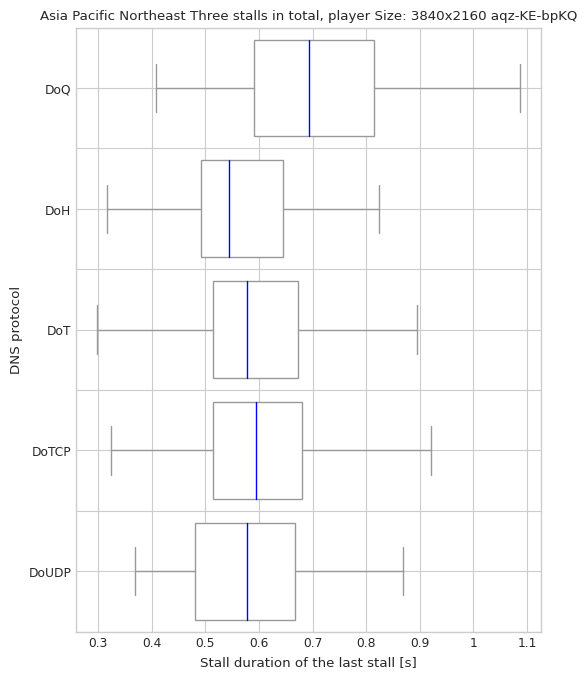

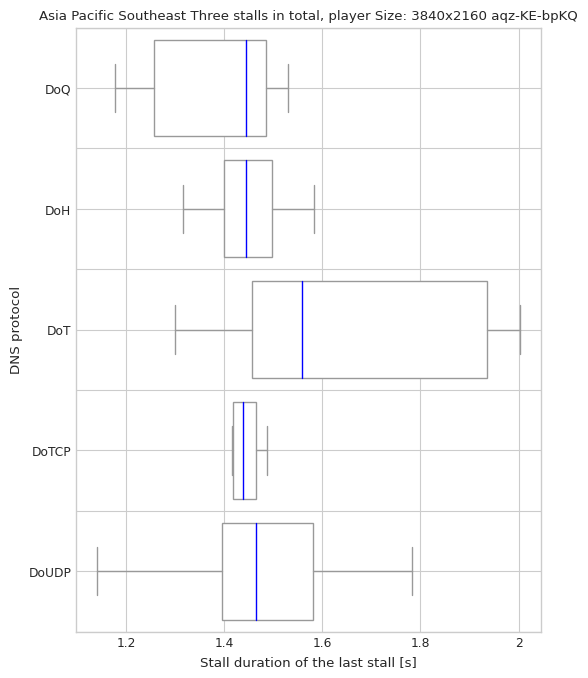

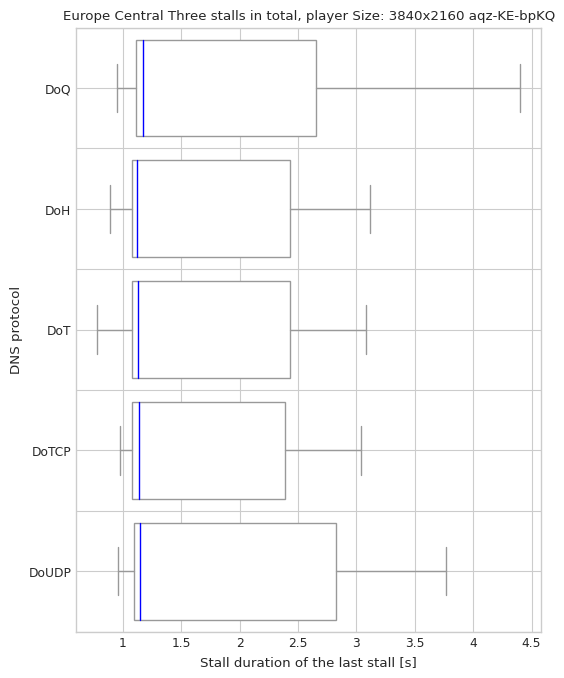

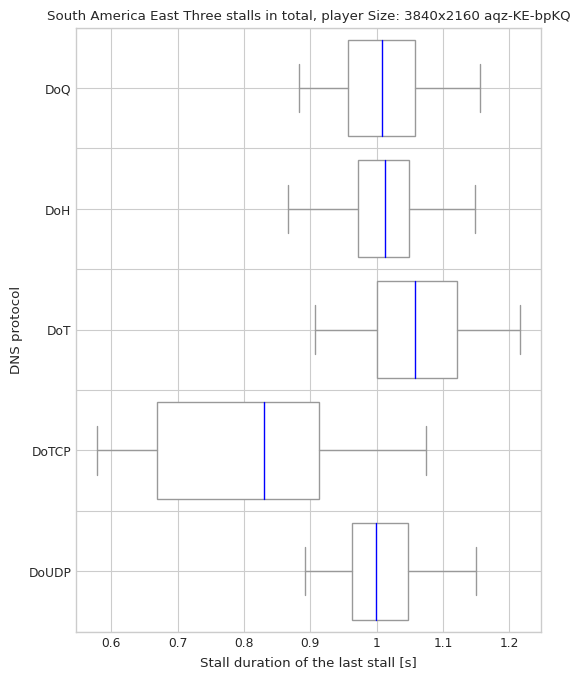

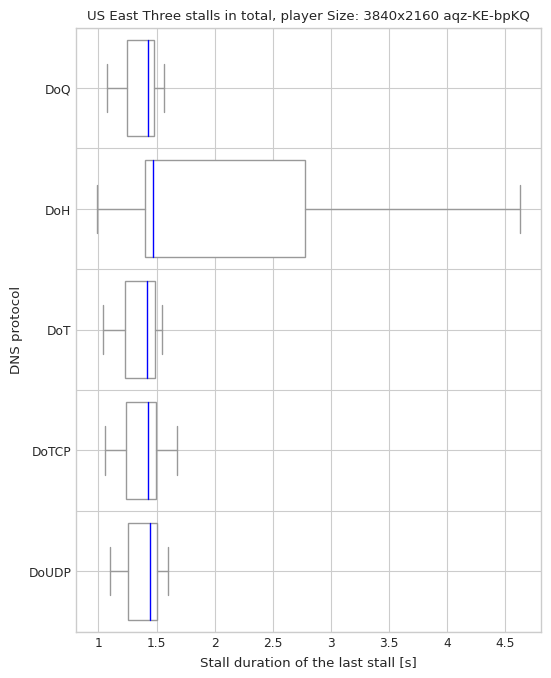

...

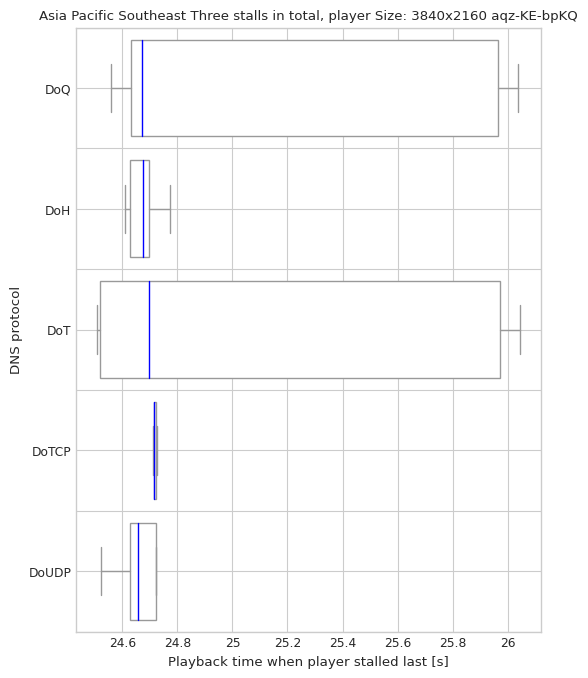

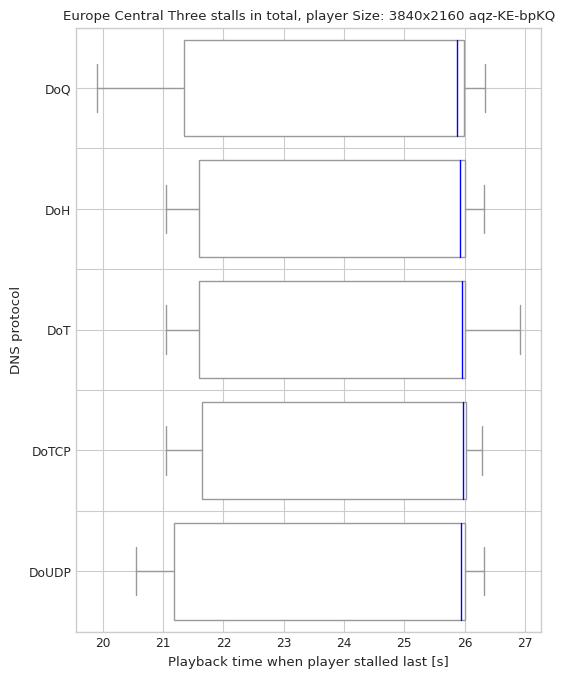

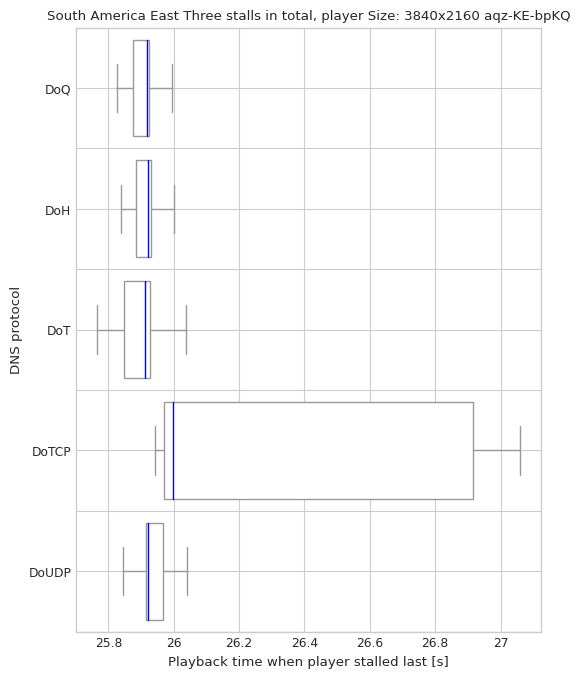

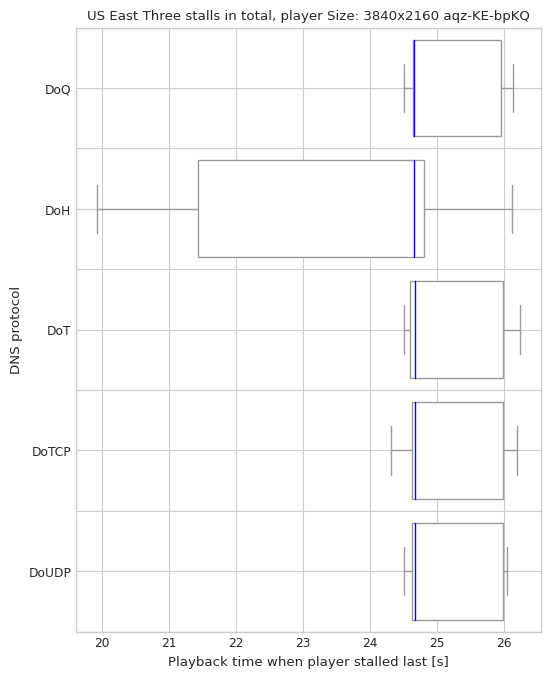

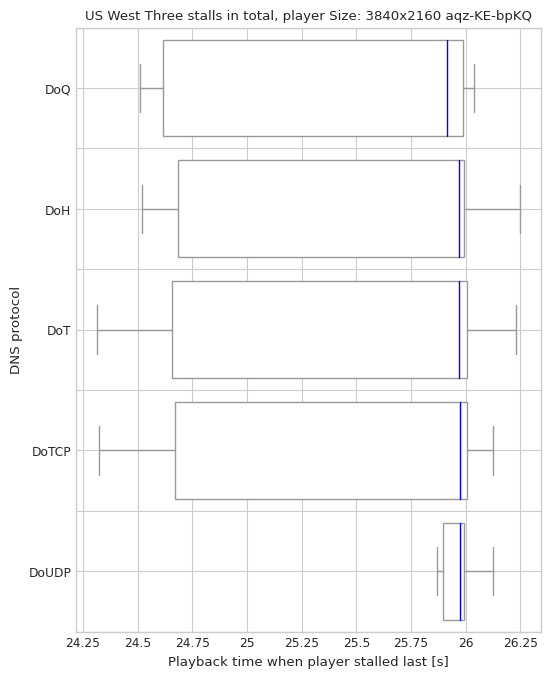

In [541]:
draw_boxplot(latest_stall[latest_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the last stall [s]', 'Three stalls in total, player Size:', 'three-stalls-last-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(latest_stall[latest_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled last [s]', 'Three stalls in total, player Size:', 'three-stalls-last-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)